# Documentation for Hydra Multi-Asset Verification Test
ACTION_LIST = [['test_add', 'test_q_for_r', 'test_r_for_r','test_r_for_q', 'test_remove']]



## Model Description

The methodology for the tests is to create two universes - one for Hydra and one for Uniswap - to subsequently be able to represent sequences of actions on each side. As the Hydra system is unique in its design and has no counterpart yet for approprate comparisons the role of the benchmark will be fulfilled by assembling several Uniswaps together in a way that everything that can be done in Hydra can be accordingly reproduced. This allows next to compare the implications on both systems and ultimately assess the quantitative and qualitative differences of results and impacts on the Hydra system and its agents. 

This approach necessitates the definition and specification of two models:
   - 1 Hydra Omnipool model with one instance that is defined in line with the [Hydra Mathematical Specification](https://hackmd.io/M7OeWimITKGVxBDHGQa6gQ?view)
   - 1 Uniswap model with several instances that each are responsible for a particular mechanism
        - which of 1 instance is used for liquidity provision in asset $R_i$: this is modeled as a Uniswap of $R_i$ and $Q$
        - which of 1 instance is used for liquidity provision in asset $R_j$: this is modeled as a Uniswap of $R_j$ and $Q$
        - which of 1 instance is used for swaps between assets $R_i$ and $R_j$: this is modeled as a Uniswap of $R_i$ and $R_j$
        
![](https://i.imgur.com/yb6Zh3T.png)
        
## Test cases

A variety of testcases can be explored with this model resulting from a combination of the following parameters
   
   - Event: Add Liquidity, Remove Liquidity, Swap Asset, Swap Asset for Base
   - Asset: $R_i$, $R_j$, $R_k$, $Q$
   - Multiple Action Type: Alternating, $i$ only, $j$ only
   - Composite Action Type: Alternating, Trade Bias
   - Enable Symmetric Liquidity: True, False
    
In addition to these settings also a fee structure can be imposed:

   - Fixed Fee

## Test agents

The model specifies a number of eight agents that each have their local balances, can interact with the system and are modeled to be responsible for **one action only**. This allows to track for each testcase how the balances will develop and to show independently which events will trigger changes to local and global states. Most importantly directly and indirectly affected variables can be easily identified.

Two dataframes of agents are initialized identically for both the Uniswap and the Hydra world and then work their way through on each side according to the testcase. Afterwards the effects on both sides can be compared.

![](https://i.imgur.com/r9IAJMr.png)



## Composite Action Tests

Besides being able to test all mechanisms individually also compositions of actions can be performed. This means selecting and combining two from the above testcases and letting the respective agents take the actions repeadetly. A composition action test therefore is defined as two actions which each can be a combination of *event* and *asset* selected from the list of testcases above, for example:
- Add liquidity in $R_i$ and Add liquidity in $R_j$
- Add liquidity in $R_i$ and Swap $R_i$ for $Q$
- Remove liquidity in $R_j$ and Swap $R_i$ for $Q$
- ...

In total there would be 28 composit pairs which can be derived from this decision tree:
selecting any one of the four primitive mechanisms of: **trade in/out** or **add/remove liquidity** of some given asset and then the subsequent action could be the three remaining mechanisms of the same asset or doing anyone of the four mechanisms in another asset.  

These basic combinations can be explored before further proceeding with
- trade sizes,
- trade frequencies,
- randomization,...



## Introduction to Uniswap
>Uniswap is an automated market maker for exchanging ERC20 tokens. Anyone can become a liquidity provider, and invest in the liquidity pool of an ERC20 token. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://uniswap.io/

There are basically eight ways (_mechanisms_) in which an agent can interact with an instance of Uniswap (https://github.com/Uniswap/uniswap-v1/blob/master/contracts/uniswap_exchange.vy):
1. `addLiquidity`: deposit ETH and tokens in the liquidity pool; mint UNI tokens - "shares" of that Uniswap instance - in exchange;
1. `removeLiquidity`: burn UNI tokens; withdraw a proportional amount of ETH and tokens in exchange;
1. `ethToTokenInput`: user specifies an exact amount of ETH they send; receives corresponding amount of tokens
1. `ethToTokenOutput`: user sends some ETH and specifies an exact amount of tokens they want to buy; Uniswap refunds ETH sent in excess
1. `tokenToEthInput`: user specifies an exact amount of tokens they send; receives corresponding amount of ETH
1. `tokenToEthOutput`: user specifies an exact amount of ETH they want to buy; Uniswap takes the corresponding amount of tokens from the user account
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" (effectively a `tokenToEthInput` in instance A combined with a `ethToTokenInput` in instance B)
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Uniswap takes the corresponding amount of "token A" from the user account (effectively a `ethToTokenOutput` in instance B combined with a `tokenToEthOutput` in instance A)

## Limitations and simplifications of this model
* When triggering mechanisms, Uniswap users may include conditions they would like to apply to the transaction. For example, they could define a minimum amount of UNI tokens they wish to receive as a result of adding liquidity to the pool; or the maximum number of tokens they are willing to pay for the amount of ETH requested in a `tokenToEthOutput` operation; or a deadline after which the transaction should not be processed. **This simplified model does not account for this kind conditioning.**

* The `ethToTokenOutput`, `tokenToEthOutput` mechanisms are not implemented. **All swaps are treated as of the "input defined" type.**

* The `tokenToToken` mechanism are not implemented, as they are merely a `tokenToEth` in the context of a single Uniswap instance.

* **User _behavior_ has not been modeled**. User _actions_ are derived from the history of events of the Uniswap instance being analyzed.

## Introduction to Hydra
>Hydra is an automated market maker that generalizes the concept of Uniswap and Balancer to a) an arbitrary number of dimensions and b) a variant weight distaribution of assets in the pool that changes in accordance with action sequences in the pool. Anyone can become a liquidity provider, and invest in the 'Omnipool'. This allows other users to trade that token for other tokens at an exchange rate based on their relative availibility. When a token trade is executed, a small fee is paid to the liquidity providers that enabled the transaction.
https://hydradx.io/

There is a predefined set of (_mechanisms_) in which an agent can interact with an the Hydra Protocol :
1. `addLiquidity`: deposit a risk asset in the omnipool; mint HDX tokens - "shares" of this risk asset - in exchange;
1. `removeLiquidity`: burn HDX tokens; withdraw a proportional amount of the risk asset in exchange;
1. `tokenToTokenInput`: user specifies an exact amount of "token A" they send; receives corresponding amount of "token B" 
1. `tokenToTokenOutput`: user specifies an exact amount of "token B˜ they want to buy; Hydra takes the corresponding amount of "token A" from the user account 



## Model File structure

The folder **model** contains:

 - a file config.py: 

    This file configures the simulation experiments by setting the number of monte carlo runs, the number of timesteps for the simulation and the simulation parameters. It also aggregates the partial states and the initial state variables.
    
    The purpose of this file is to *configure and initialize* the experiment.
    
    
 - a file partial_state_update_block.py

    This file defines each partial state update block individually. This feature allows cadCAD to divide each simulation timestep into several 'blocks' where different state variables are mutated conditioned upon the policy input.
    
    In the current setting 
    - the first block maps the user action to the appropriate mechanism in the uniswap world
    - the second block maps the user action to the appropriate mechanism in the hydra world
    - the third block resolves the quantities of HDX and weights in the hydra world
    - the forth block calculates the metrics: the swap prices in the uniswap world and the pool prices in the hydra world

    This file corresponds to the system specification diagram, where each column is one partial state update block 
    
    The purpose of this file is to *define* the sequence and details of state updates for each simulation timestep. The relevant mechanisms are imported from the files in the **parts** folder
    
    
 - a file plot_utils.py

    This file defines all plot functions that can be called in the jupyter notebook to visualize the results. In general there are three types of plots:
    - plots related to the uniswap world (do not contain the word 'hydra')
    - plots related to the hydra world (contain the word 'hydra')
    - general plots applicable to both worlds (f.e Impermanent Loss)

    It also can be distinguished between plots related to global system variables and local agent variables:
    - global variables (do not contain the word 'agent')
    - local variables (contain the word 'agent')

    The purpose of this file is to *define* the way how particular properties can be plotted over time.
    

 - a file run.py

    This file *defines* the run and postprocessing methods and is used to execute the simulation run:
    - run() is used to execute the simulation and create a dataframe
    - postprocessing is used to extract relevant metrics from the simulation output in the dataframe

     The purpose of this file is to *execute* the simulation and *create* metrics.
     
     
 - a file state_variables.py

    This file *sets* the number of agents and *defines* the local (agent-level) state variables, *sets* the number of assets and *defines* the global (system-state) variables of the system, *computes* the prices of the assets and *defines* the initial state object
    - the agent states describe their holdings of assets that agents have contributed to the pool or still hold outside as well as their quantities of shares they received for their contribution
    - the global states describe the quantities of assets in the system
    - price variables are computed from the states both in the uniswap and hydra world
    - the initial state object consists of 
        - two agent dataframes, one for each world respectively
        - two sets of global variables, one for each world respectively
        - prices for each world (? is pool = prices ?)

    The purpose of this file is to *define* the global and local states of the system.
    
    
 - a file sys_params.py

    This file *contains* the system parameters and allows to select items from a list for them. Following parameters can be defined:
    - trade action type
    - liquidity action type
    - multiple asset action type
    - composite action type
    - liquidity add type (symmetry)

    In addition the following is set
    - initial values for assets 
    - hard coded fee value
    - choice of the system parameters from the list above
    

 - a folder **parts** which itself contains general files relevant for both instances, files related specifically to Uniswap and files related specifically to Hydra 
      - [action.py](model/parts/action.py)
       This is an action dictionary which drives the model. As there are no behavioral assumptions in the model yet, currently actions are prescribed actions in testing mode derived from events. However, action schema respects https://www.kaggle.com/markusbkoch/uniswap-ethdai-exchange as much as possible, allowing for future analysis against uniswap transaction datasets.
        This file contains a function called 'actionDecoder' which takes its inputs from the file sys_params.py and maps those encoded events to agent actions. At first an arbitrary action dictionary is defined which then is adapted according to the choices of system parameters. In particular relevant are the parameter definitions of the asset, the composite and whether there is a trade or liquidity event defined.
        
    - [uniswap.py](model/parts/uniswap.py)
     Reads in action output and directs the action to the appropriate Uniswap mechanism for each corresponding Uniswap instance. Currently there are two instances in place, namely the R_i<>Q pair and the R_j<>Q pair. Both instances have their respective requisite state variables: UNI_Qx, UNI_Rx, and UNI_Sx.

    - [utils.py](model/parts/utils.py)
    Computes the state update for each Uniswap state variable and outputs the updated global state variables.
        
     - [agent_utils.py](model/parts/agent_utils.py)
     Computes the corresponding agent local state for each Uniswap agent resolving their action and outputs the updates local state variables.

      -  [hydra.py](model/prts/hydra.py)
     Reads in action output and directs the action to the appropriate Hydra mechanism for each state variable: Q, Sq, and pool.
    
      - [hydra_utils.py](model/parts/hydra_utils.py)
     Computes the state update for each Hydra state variable

    -  [asset_utils.py](model/parts/asset_utils.py)
     Computes the state update for each Reserve Asset in a Hydra Omnipool

    -  [hydra_agent_utils_class.py](model/parts/hydra_agent_utils_class.py)
     Computes the corresponding agent local state for each Hydra agent resolving their action and outputs the updates local state variables.
     
     #### The interrelations between the files are shown here:
     
    ![](https://i.imgur.com/mNhfQE4.png)



# Testcase Definition

#### Simulation Settings
- There are 100 timesteps for each simulation run
- Each testcase has 100 MC runs with different randomized variables
- Block 1 randomizes starting liquidity balances (explained below in section 'Block 1')



#### Agent Activities - Action Sequence

There are two agents acting during the simulation. The trading agent performs "R-for-R" trades of equal size but varying direction over most simulation timesteps. The liquidity agent provides liquidity to the pool at timestep 10 and removes the liquidity from the pool at timestep 90.

##### Trading agent

- One Agent performs random "R-for-R" trades during the simulation. 
- The direction of the trade is a random coin flip for each timestep.
- The size of the trade is fixed at $1000$ for each timestep.
- The agent does not act at timestep 10 nor timestep 90.

##### Liquidity agent

- One Agent provides liquidity in Asset "i" to the pool 
- He provides the liquidity at timestep 10
- He removes the liquidity at timestep 90
- He does not act at other timesteps

#### Block 1:

| #   |   Run   | a  | $\mu_i$ |          $\sigma_i$          | $\mu_j$ |          $\sigma_j$          | $\mu$ | $\sigma$ | Total runs         |
| --- |:-------:|:-------:|:-------:|:----------------------------:|:-------:|:----------------------------:| ----- | -------- | ------------------ |
| 1   | 001-100 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 2   | 101-200 |   0.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 3   | 201-300 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 4   | 301-400 |    1    |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$  | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |
| 5   | 401-500 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 2$  |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 2$  | $1.000$ | $0$      | $100$ |
| 6   | 501-600 |   1.5   |   $100.000$   | $\frac{\mu_i}{\sigma_i}= 50$ |   $100.000$   | $\frac{\mu_j}{\sigma_j}= 50$ | $1.000$ | $0$      | $100$ |

All tests in block 1 are performed as 100 **MonteCarlo Experiments** with the following randomization:
- The initial balances of the liquidity pools are drawn randomly for each MC run from the same lognormal distribution with $\mu_i$ and $\mu_j$ fixed at $100000$
    - The underlying mean for the lognormal liquidity draw is $\log{100000}$
    - The underlying standard deviation for the lognormal liquidity draw is $\sqrt{\log{1 + \frac{2000^2}{100000^2}}}$
- The action sequence of the agents is randomized in that sense that:
    - For each individual MC run the sequence is identical for the Uniswap and Hydra side of the model. For each timestep of the simulation exactly the same event takes place on both sides.
    - For each individual MC run the trading directions are randomized for each timestep. Therefore the event sequence for each run will be different.
    - For all MC runs the trading amount is always equal to $1000$




# Testcase in this notebook


This notebook documents the results of the following experiment:
- Settings from Block 1 as outlined above
- Testcases **2**, **4** and **6**
- Sweep over three values for $a \in \{0.5, 1, 1.5 \}$ with a fixed $\mu$-to-$\sigma$-ratio of $50$.

The experiment result dataframe is saved into a pickle file and analyzed throughout this notebook.

## Run Model

The following command lines import all packages, experiments and run the model 

This is the execution of cadcad. This writes the config object, does the execution and returns the rdf - which is a data object that shows the rows and columns of results in a dataframe

Here is one additional option as well. The postprocessing causes the index of the results to be every forth because of the cadcad architecture where the partial state updates are the substeps. With this option selected we see only the end of each timestep - the last substep. Therefore only final results are shown. To get a line for each substep the postprocessing needs to be deactivated. 

In [1]:
from model.config_wrapper import ConfigWrapper

from model import run_wrapper
from cadCAD import configs

# parametric_experiment = ConfigWrapper()
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']
# parametric_experiment.get_config()

running file: config_wrapper.py
end of file: config_wrapper.py
running file: run_wrapper.py
end of file: run_wrapper.py


In [2]:
# import model as model


In [3]:
# parametric_experiment = ConfigWrapper(model)


In [4]:
# del configs[:]

# parametric_experiment.append()

In [5]:
# get_keys = parametric_experiment.get_config()
# get_keys[0]['M']

In [6]:
# Dependences
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Experiments
from model import run
from model.parts.utils import *
from model.plot_utils import *

pd.options.display.float_format = '{:.2f}'.format

%matplotlib inline

# df = run.run()
# rdf = run.postprocessing(df)
# rdf = df # debugging substeps
# pd.set_option("mode.chained_assignment", None)


running file: run.py
running file: state_variables.py
running file: initialize_liquidity.py
end of file: initialize_liquidity.py
running file: asset_utils.py
end of file: asset_utils.py
end of file: state_variables.py
running file: partial_state_update_block.py
end of file: action_list.py
end of file: partial_state_update_block.py
running file: sim_setup.py
end of file: sim_setup.py
[100998.27887305  99723.88095634 101303.67223198 103092.61280875
  99532.83469866  99532.86737755 103208.50728239 101546.55324918
  99065.53858503 101090.91919622  99077.5383033   99072.95740148
 100485.04873236  96246.09556884  96609.32594441  98881.83582563
  97994.91492509 100630.41060507  98200.52092999  97215.18620668
 102974.38116142  99549.51030708 100135.13413065  97190.99577765
  98917.24782412 100222.06920894  97724.53133637 100754.1504107
  98806.02781904  99418.36888778  98803.91770933 103773.6459511
  99973.01189183  97907.00331514 101658.52873405  97588.11897026
 100418.55894768  96156.8490052

Omni_P_RQi ================== 0.10046935797896117
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99532.83469865563, 'S': 10000, 'W': 10000, 'P': 0.10046935797896117, 'dP': 0}, 'j': {'R': 99677.98042562776, 'S': 10000, 'W': 10000, 'P': 0.10032305989045646}, 'k': {'R': 99677.98042562776, 'S': 10000, 'W': 10000, 'P': 0.10032305989045646}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.10046932499260029
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99532.86737754548, 'S': 10000, 'W': 10000, 'P': 0.10046932499260029, 'dP': 0}, 'j': {'R': 100811.29422038043, 'S': 10000, 'W': 10000, 'P': 0.09919523479322974}, 'k': {'R': 100811.29422038043, 'S': 10000, 'W': 10000, 'P': 0.09919523479322974}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10046932499260029
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asse

Omni_P_RQi ================== 0.10390031866640598
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 96246.09556884154, 'S': 10000, 'W': 10000, 'P': 0.10390031866640598, 'dP': 0}, 'j': {'R': 105049.33561649351, 'S': 10000, 'W': 10000, 'P': 0.09519336739555664}, 'k': {'R': 105049.33561649351, 'S': 10000, 'W': 10000, 'P': 0.09519336739555664}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10390031866640598
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 96246.09556884154, 'S': 10000, 'W': 10000, 'P': 0.10390031866640598, 'dP': 0}, 'j': {'R': 105049.33561649351, 'S': 10000, 'W': 10000, 'P': 0.09519336739555664}, 'k': {'R': 105049.33561649351, 'S': 10000, 'W': 10000, 'P': 0.09519336739555664}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10390031866640598
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asse

Omni_P_RQi ================== 0.10045252828620312
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99549.51030708376, 'S': 10000, 'W': 10000, 'P': 0.10045252828620312, 'dP': 0}, 'j': {'R': 98197.84354310772, 'S': 10000, 'W': 10000, 'P': 0.10183523017600804}, 'k': {'R': 98197.84354310772, 'S': 10000, 'W': 10000, 'P': 0.10183523017600804}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10045252828620312
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99549.51030708376, 'S': 10000, 'W': 10000, 'P': 0.10045252828620312, 'dP': 0}, 'j': {'R': 98197.84354310772, 'S': 10000, 'W': 10000, 'P': 0.10183523017600804}, 'k': {'R': 98197.84354310772, 'S': 10000, 'W': 10000, 'P': 0.10183523017600804}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09986504823524137
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>:

Omni_P_RQi ================== 0.10213773950176336
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97907.0033151395, 'S': 10000, 'W': 10000, 'P': 0.10213773950176336, 'dP': 0}, 'j': {'R': 100951.58925445436, 'S': 10000, 'W': 10000, 'P': 0.09905738061036778}, 'k': {'R': 100951.58925445436, 'S': 10000, 'W': 10000, 'P': 0.09905738061036778}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10213773950176336
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 97907.0033151395, 'S': 10000, 'W': 10000, 'P': 0.10213773950176336, 'dP': 0}, 'j': {'R': 100951.58925445436, 'S': 10000, 'W': 10000, 'P': 0.09905738061036778}, 'k': {'R': 100951.58925445436, 'S': 10000, 'W': 10000, 'P': 0.09905738061036778}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10213773950176336
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'

Omni_P_RQi ================== 0.10060396373390862
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99399.6620893526, 'S': 10000, 'W': 10000, 'P': 0.10060396373390862, 'dP': 0}, 'j': {'R': 100369.91329494095, 'S': 10000, 'W': 10000, 'P': 0.09963145002043197}, 'k': {'R': 100369.91329494095, 'S': 10000, 'W': 10000, 'P': 0.09963145002043197}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10060396373390862
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99399.6620893526, 'S': 10000, 'W': 10000, 'P': 0.10060396373390862, 'dP': 0}, 'j': {'R': 100369.91329494095, 'S': 10000, 'W': 10000, 'P': 0.09963145002043197}, 'k': {'R': 100369.91329494095, 'S': 10000, 'W': 10000, 'P': 0.09963145002043197}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.10300089416360234
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'

Omni_P_RQi ================== 0.10077306036147303
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99232.87001635153, 'S': 10000, 'W': 10000, 'P': 0.10077306036147303, 'dP': 0}, 'j': {'R': 100695.23274396057, 'S': 10000, 'W': 10000, 'P': 0.09930956736975984}, 'k': {'R': 100695.23274396057, 'S': 10000, 'W': 10000, 'P': 0.09930956736975984}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10077306036147303
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99232.87001635153, 'S': 10000, 'W': 10000, 'P': 0.10077306036147303, 'dP': 0}, 'j': {'R': 100695.23274396057, 'S': 10000, 'W': 10000, 'P': 0.09930956736975984}, 'k': {'R': 100695.23274396057, 'S': 10000, 'W': 10000, 'P': 0.09930956736975984}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.1013629127664546
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset

config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99383.54500623034, 'S': 10000, 'W': 10000, 'P': 0.10062027873299449, 'dP': 0}, 'j': {'R': 100952.0747645891, 'S': 10000, 'W': 10000, 'P': 0.09905690421241044}, 'k': {'R': 100952.0747645891, 'S': 10000, 'W': 10000, 'P': 0.09905690421241044}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09933972880854477
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100664.6597482944, 'S': 10000, 'W': 10000, 'P': 0.09933972880854477, 'dP': 0}, 'j': {'R': 97645.78559626229, 'S': 10000, 'W': 10000, 'P': 0.1024109738985272}, 'k': {'R': 97645.78559626229, 'S': 10000, 'W': 10000, 'P': 0.1024109738985272}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09933972880854477
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 100664.6597482944, 'S': 10000, 'W': 10000, 'P': 0.0

Omni_P_RQi ================== 0.09732424123902556
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 102749.32403983799, 'S': 10000, 'W': 10000, 'P': 0.09732424123902556, 'dP': 0}, 'j': {'R': 100828.89579036595, 'S': 10000, 'W': 10000, 'P': 0.09917791840933247}, 'k': {'R': 100828.89579036595, 'S': 10000, 'W': 10000, 'P': 0.09917791840933247}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.10014410958246224
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 99856.09779440539, 'S': 10000, 'W': 10000, 'P': 0.10014410958246224, 'dP': 0}, 'j': {'R': 101657.54325364155, 'S': 10000, 'W': 10000, 'P': 0.0983694832664745}, 'k': {'R': 101657.54325364155, 'S': 10000, 'W': 10000, 'P': 0.0983694832664745}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10014410958246224
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Ass

Omni_P_RQi ================== 0.10537862848121245
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 94895.9019881613, 'S': 10000, 'W': 10000, 'P': 0.10537862848121245, 'dP': 0}, 'j': {'R': 100554.85994974764, 'S': 10000, 'W': 10000, 'P': 0.09944820175770229}, 'k': {'R': 100554.85994974764, 'S': 10000, 'W': 10000, 'P': 0.09944820175770229}}}
config_param a value =============  1.5
Omni_P_RQi ================== 0.09836979340598924
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 101657.22274853483, 'S': 10000, 'W': 10000, 'P': 0.09836979340598924, 'dP': 0}, 'j': {'R': 101667.95875871566, 'S': 10000, 'W': 10000, 'P': 0.09835940567797358}, 'k': {'R': 101667.95875871566, 'S': 10000, 'W': 10000, 'P': 0.09835940567797358}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.09836979340598924
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.As

Omni_P_RQi ================== 0.10162996689498066
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98396.17492283059, 'S': 10000, 'W': 10000, 'P': 0.10162996689498066, 'dP': 0}, 'j': {'R': 99554.11613913682, 'S': 10000, 'W': 10000, 'P': 0.1004478808894652}, 'k': {'R': 99554.11613913682, 'S': 10000, 'W': 10000, 'P': 0.1004478808894652}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.10162996689498066
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98396.17492283059, 'S': 10000, 'W': 10000, 'P': 0.10162996689498066, 'dP': 0}, 'j': {'R': 99554.11613913682, 'S': 10000, 'W': 10000, 'P': 0.1004478808894652}, 'k': {'R': 99554.11613913682, 'S': 10000, 'W': 10000, 'P': 0.1004478808894652}}}
config_param a value =============  1
Omni_P_RQi ================== 0.10162996689498066
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'p

Omni_P_RQi ================== 0.101413867692922
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98605.84383074398, 'S': 10000, 'W': 10000, 'P': 0.101413867692922, 'dP': 0}, 'j': {'R': 100429.06252755571, 'S': 10000, 'W': 10000, 'P': 0.09957277055390416}, 'k': {'R': 100429.06252755571, 'S': 10000, 'W': 10000, 'P': 0.09957277055390416}}}
config_param a value =============  0.5
Omni_P_RQi ================== 0.101413867692922
Initial Q HDX: 20000
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'pool': {'i': {'R': 98605.84383074398, 'S': 10000, 'W': 10000, 'P': 0.101413867692922, 'dP': 0}, 'j': {'R': 100429.06252755571, 'S': 10000, 'W': 10000, 'P': 0.09957277055390416}, 'k': {'R': 100429.06252755571, 'S': 10000, 'W': 10000, 'P': 0.09957277055390416}}}
config_param a value =============  1
Omni_P_RQi ================== 0.101413867692922
Initial Q HDX: 20000.0
config_init_state  <class 'model.parts.asset_utils.Asset'>: {'poo

In [7]:
(data, tensor_field, sessions) = run_wrapper.run(drop_midsteps=True)

experiments = data



                  ___________    ____
  ________ __ ___/ / ____/   |  / __ \
 / ___/ __` / __  / /   / /| | / / / /
/ /__/ /_/ / /_/ / /___/ ___ |/ /_/ /
\___/\__,_/\__,_/\____/_/  |_/_____/
by cadCAD

Execution Mode: local_proc
Configuration Count: 100
Dimensions of the first simulation: (Timesteps, Params, Runs, Vars) = (100, 16, 3, 22)
Execution Method: local_simulations
SimIDs   : [0, 0, 0, 1, 1, 1, 2, 2, 2, 3, 3, 3, 4, 4, 4, 5, 5, 5, 6, 6, 6, 7, 7, 7, 8, 8, 8, 9, 9, 9, 10, 10, 10, 11, 11, 11, 12, 12, 12, 13, 13, 13, 14, 14, 14, 15, 15, 15, 16, 16, 16, 17, 17, 17, 18, 18, 18, 19, 19, 19, 20, 20, 20, 21, 21, 21, 22, 22, 22, 23, 23, 23, 24, 24, 24, 25, 25, 25, 26, 26, 26, 27, 27, 27, 28, 28, 28, 29, 29, 29, 30, 30, 30, 31, 31, 31, 32, 32, 32, 33, 33, 33, 34, 34, 34, 35, 35, 35, 36, 36, 36, 37, 37, 37, 38, 38, 38, 39, 39, 39, 40, 40, 40, 41, 41, 41, 42, 42, 42, 43, 43, 43, 44, 44, 44, 45, 45, 45, 46, 46, 46, 47, 47, 47, 48, 48, 48, 49, 49, 49, 50, 50, 50, 51, 51, 51, 52, 52, 52, 53, 

0 130000.00 180000.00 160000.00  delta_Ri = 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109398.48 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109271.38 110000.00 138000.00 170000.00 150000.00 0.00 129229.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = 
delta_Ri =  9293.337573983988
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9293.337573983988 from reserve 99851.23382117473
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90500.28 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  1000
1000
q_sold = delta_Ri = delta_Ri = H_ch

 delta_Ri = 1000

1000
H_chosen_agentH_chosen_agent H_chosen_agent q_sold =  1000
 addliq - Sq delta Sq   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129383.07 110000.00 132000.00 170000.00 150000.00 0.00 149073.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    -5620.905348663296H_chosen_agentaddliq - Sq delta Sq6865.023959169317
addliq - Sq delta S 6865.023959169316
POOL ADD LIQUIDITY Timestep ===  10 delta W  9954.284740795509

  8949.238760330412
addliq - Sq delta S 8949.238760330412
POOL ADD LIQUIDITY Timestep ===  10 delta W  12976.396202479098
delta_Ri =  4860.103722981406
H_agent r out =  129383.07303784603
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4860.103722981406 from reserve 71707.8461583749
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70813.63 110000.00 133000.00 170000.00 150000.00 

delta_Ri =  -3917.0113956727496
H_agent r out =  56607.987516224995
**********
Q ADDED INTO POOL: 1000 to existing amount 41809.07317955921
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3917.0113956727496 from reserve 107606.26638927737
**********


89858.82152900615H_chosen_agentH_agent r out =  148848.23999345745
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4765.63930759572 from reserve 70314.08171382471
**********
H_chosen_agent 
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70813.63 110000.00 128000.00 170000.00 150000.00 0.00 75487.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53359.34 110000.00 127000.00 170000.00 150000.00 0.00 85928.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149803.05 110000.00 121000.00 170000.00 150000.00 0.00 170647.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  3867.29937411277
H_agent r out =  142572.01491220293
**********
Q ADDED INTO POOL: 1000 to existing amount 43898.86951399811
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3867.29937411277 from reserve 107151.86604413927
**********
q_sold = 
delta_Ri =  2376.7167777758777
H_agent r out = 
  1000
 170647.0243384136
**********
Q ADDED INTO POOL: 1000 to existing amount 50219.52623493388
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2376.7167777758777 from reserve 49204.20948276113
**********
q_sold =  1000
-3395.0912317727852q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43276.38 110000.00 121000.00 170000.00 150000.00 0.00 74741.46 130000.00   

        q_j       s_j  
0 180000.

H_chosen_agent q_sold = q_sold =  1000 1000

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36724.52 110000.00 118000.00 170000.00 150000.00 0.00 73002.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  
delta_Ri =  -2621.0037087341334
H_agent r out =  36724.51756231625
**********
Q ADDED INTO POOL: 1000 to existing amount 51809.07317955921
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2621.0037087341334 from reserve 87722.79643536864
**********
 POOL RESERVE ONE REMOVING ASSET j in amount 1795.1078803113605 from reserve 42801.13487413872
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36658.67 110000.00 120000.00 170000.00 150000.00 0.00 81385.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30372.42 110000.00 115000.00 170000.00 150000.00 0.00 7323

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29304.25 110000.00 111000.00 170000.00 150000.00 0.00 64114.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -2202.30329196621
H_agent r out = q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2082.6530182496576 from reserve 82873.18672418923
**********
 H_chosen_agent q_sold = q_sold = 10001000
   1000
  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30244.36 110000.00 111000.00 170000.00 150000.00 0.00 62700.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22953.88 110000.00 109000.00 170000.00 150000.00 0.00 67449.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2179.2035647206194
H_agent r out =  30244.36118447036
delta_Ri =  -2473.8596196586436
H_agent r o

H_agent r out = H_chosen_agent  1000
H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172609.14 110000.00 105000.00 170000.00 150000.00 0.00 182767.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =  1000 -2085.1758356823348
H_agent r out =  27101.94725678986
**********
Q ADDED INTO POOL: 1000 to existing amount 63809.07317955921
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2085.1758356823348 from reserve 78100.22612984224
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164827.09 110000.00 112000.00 170000.00 150000.00 0.00 178507.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1645.253791909006
H_agent r out =  178507.92134097958
**********
Q ADDED INTO POOL: 1000 to existing amount 57898.86951399811
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1645.253791909006 from reserve 40654.40036

 1000
H_chosen_agentq_sold =  1000
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17681.79 110000.00 98000.00 170000.00 150000.00 0.00 54343.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16745.52 110000.00 99000.00 170000.00 150000.00 0.00 55493.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173171.45 110000.00 100000.00 170000.00 150000.00 0.00 189267.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000


delta_Ri =  934.5298777824632   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32001.74 110000.00 102000.00 170000.00 150000.00 0.00 50456.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = 

delta_Ri = 
delta_Ri =  -879.123

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175120.16 110000.00 96000.00 170000.00 150000.00 0.00 191908.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167274.51 110000.00 103000.00 170000.00 150000.00 0.00 188760.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000-1511.4845631810495
delta_Ri =  2312.004296975756
H_agent r out =  167274.5069148357
**********
Q ADDED INTO POOL: 1000 to existing amount 66898.8695139981
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2312.004296975756 from reserve 82449.37404150648
**********
 H_chosen_agent

H_chosen_agent  1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12753.63 110000.00 95000.00 170000.00 150000.00 0.00 53808.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1131.3371022546085
H_agent 

q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 745.9660300575299 from reserve 27389.055976322223
**********
H_chosen_agent46525.12165806445    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8007.89 110000.00 88000.00 170000.00 150000.00 0.00 50206.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
1000H_chosen_agent 1000
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16232.65 110000.00 94000.00 170000.00 150000.00 0.00 51031.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
H_chosen_agent
delta_Ri =  -998.2842219735799
H_agent r out =  51031.75431310363
**********
Q ADDED INTO POOL: 1000 to existing amount 77503.20855754559
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 998.2842219735799 from reserve 31548.132254549062
**********
 
Q ADDED INTO POOL: 1000 to existing amount 76706.40839500603 H_chosen_agent de

q_sold = q_sold = H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5898.44 110000.00 82000.00 170000.00 150000.00 0.00 46172.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   H_chosen_agentq_sold =  1000
 1000
 H_chosen_agentH_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1552.75 110000.00 80000.00 170000.00 150000.00 0.00 48825.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3279.33 110000.00 80000.00 170000.00 150000.00 0.00 48309.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188645.56 110000.00 83000.00 170000.00 150000.00 0.00 194168.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -678.60846965

0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3929.04 110000.00 78000.00 170000.00 150000.00 0.00 44495.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


q_sold = delta_Ri =  706.8133154880962
H_agent r out =  194168.20427411573
**********
Q ADDED INTO POOL: 1000 to existing amount 95976.3962024791
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 706.8133154880962 from reserve 26643.089946264692
**********
**********
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1062.12 110000.00 75000.00 170000.00 150000.00 0.00 47223.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000
H_chosen_agent
q_sold = delta_Ri =  -936.3019020399706
H_agent r out =  3929.040666217307
**********
Q ADDED INTO POOL: 1000 to existing amount 96054.82293400988
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amo


 
H_agent r out =  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182735.96 110000.00 84000.00 170000.00 150000.00 0.00 196585.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent  -1708.4393343627353H_agent r out =  1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2086.60 110000.00 75000.00 170000.00 150000.00 0.00 43724.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  19685.883775246944
**********
Q ADDED INTO POOL: 1000 to existing amount 88706.40839500603
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1708.4393343627353 from reserve 70989.55600722323
**********
-566.3460186302784
delta_Ri =  -877.3434043684598
H_agent r out =  2086.5999523522537
**********
Q ADDED INTO POOL: 1000 to existing amount 99054.82293400988
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 877.3434043684598 f

q_sold = 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13312.94 110000.00 76000.00 170000.00 150000.00 0.00 40710.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
H_chosen_agent1000
delta_Ri =  754.0475072304728
H_agent r out =  199924.35969134595
**********
Q ADDED INTO POOL: 1000 to existing amount 103976.3962024791
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 754.0475072304728 from reserve 49608.50768619953
**********
H_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188479.84 110000.00 78000.00 170000.00 150000.00 0.00 197594.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190321.17 110000.00 73000.00 170000.00 150000.00 0.00 199517.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 -1418.095

********** delta_Ri =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10537.77 110000.00 70000.00 170000.00 150000.00 0.00 39195.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agentdelta_Ri =  -1300.304078931704
H_agent r out =  10537.771143434475
**********
Q ADDED INTO POOL: 1000 to existing amount 99706.40839500603
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1300.304078931704 from reserve 61841.443375410774
**********
 q_sold = q_sold =  1000

 
 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1035.68 110000.00 68000.00 170000.00 150000.00 0.00 42145.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent-775.1391810864147POOL RESERVE ONE REMOVING ASSET i in amount 1146.3547527808994 from reserve 59577.518897184964
H_agent r out =  -1263.1711643163553
**********
Q ADDED INTO POOL: 1000 to existing amount 108054.82293400988


1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4159.11 110000.00 62000.00 170000.00 150000.00 0.00 41795.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5590.84 110000.00 59000.00 170000.00 150000.00 0.00 39858.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -767.8428543643964   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193316.47 110000.00 64000.00 170000.00 150000.00 0.00 201533.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  -652.0705639803535
H_agent r out =  -5590.837803950917
**********
Q ADDED INTO POOL: 1000 to existing amount 115054.82293400988
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 652.0705639803535 from reserve 47617.66947843662
**********
H_agent r out = q_sold = H_chosen_agent -576.6046081930356
**********
Q ADDED 

0 180000.00 160000.00  1000
delta_Ri =  -287.1767225651194
H_agent r out = H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 670.2554715019552 from reserve 43968.952517554324q_sold = 
 37597.04850045736
**********
Q ADDED INTO POOL: 1000 to existing amount 109706.40839500603
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 287.1767225651194 from reserve 16914.031234302012
**********
q_sold =   
1000
 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196471.35 110000.00 58000.00 170000.00 150000.00 0.00 202449.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  284.42903019936887
H_agent r out =  202449.2125372601
H_chosen_agent**********q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205975.31 110000.00 53000.00 170000.00 150000.00 0.00 199416.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in    

 H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198707.50 110000.00 54000.00 170000.00 150000.00 0.00 203324.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4845.58 110000.00 54000.00 170000.00 150000.00 0.00 39347.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
delta_Ri =  888.3223018247363
H_agent r out =  198707.49879082473
**********
Q ADDED INTO POOL: 1000 to existing amount 117219.52623493387
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 888.3223018247363 from reserve 52383.42040539615
**********

  
delta_Ri =  -639.4801123577079
H_agent r out =  37378.96821361137
**********
Q ADDED INTO POOL: 1000 to existing amount 103469.13144072331
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 434.4580808820122 from reserve 21223.005539

0 180000.00 160000.00  10001000 
delta_Ri =  -692.9911795056634
H_agent r out =  -6130.06958857128
**********
Q ADDED INTO POOL: 1000 to existing amount 95589.64814831974
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 692.9911795056634 from reserve 29244.321288536106
**********
 1000

1000 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210118.06 110000.00 43000.00 170000.00 150000.00 0.00 200312.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201694.92 110000.00 47000.00 170000.00 150000.00 0.00 203780.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  241.04073835637934
H_agent r out =  203780.43500101968
**********
Q ADDED INTO POOL: 1000 to existing amount 100423.78224205202
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 241.04073835637934 from reser

 q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -305.92 110000.00 46000.00 170000.00 150000.00 0.00 35322.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10321.52 110000.00 43000.00 170000.00 150000.00 0.00 38190.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -495.32367668357415
H_agent r out =  -10321.52372022923
**********
Q ADDED INTO POOL: 1000 to existing amount 104456.71481752177
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 495.32367668357415 from reserve 25300.556191453587
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9334.57 110000.00 43000.00 170000.00 150000.00 0.00 38193.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 H_chosen_agent H_chosen_agentH_chosen_agentdelta_Ri = 1000   m 

 delta_Ri =  6560.236201512962
H_agent r out =  117174.87855692953
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6560.236201512962 from reserve 83823.40031612282
**********

 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7715.225749485528 from reserve 91800.76158903669
**********
q_sold = 
delta_Ri =  -8025.828970495981
H_agent r out =  90303.28572282824
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8025.828970495981 from reserve 93395.89853158181
**********
delta_Ri =  -5678.896644123235
H_agent r out =  75885.61227530007
**********
 q_sold = Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5678.896644123235 from reserve 77432.16552448338
**********
10001000 1000
H_chosen_agent
1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_ou

0 180000.00 160000.00   H_chosen_agentq_sold =  1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61031.72 110000.00 131000.00 170000.00 150000.00 0.00 96145.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  addliq - Sq delta Sq

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141420.44 110000.00 130000.00 170000.00 150000.00 0.00 143698.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =   -6761.611346869414
H_agent r out =  82277.45675233226
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6761.611346869414 from reserve 85370.06956108584
**********
5891.942301805244
addliq - Sq delta S 5891.942301805243
POOL ADD LIQUIDITY Timestep ===  10 delta W  8543.316337617603

q_sold = q_sold = delta_Ri =  -3821.6449858784604
H_agent r out =  61031.72342817172
**********
Q ADDED INTO POOL: 1000 to ex

H_chosen_agent q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148175.20 110000.00 125000.00 170000.00 150000.00 0.00 158413.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  3725.190307428612
H_agent r out =  158413.25702196304
**********
Q ADDED INTO POOL: 1000 to existing amount 48035.22660765219
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3725.190307428612 from reserve 62103.12091948241
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69746.68 110000.00 131000.00 170000.00 150000.00 0.00 86359.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
q_sold = 
delta_Ri =  -5062.280930371067
H_agent r out =  69746.68292168014
**********
Q ADDED INTO POOL: 1000 to existing amount 38610.19725658229
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5062.280930371067 from reserve 122839.29573043372
**********
   m 

 H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 3592.815535092297 from reserve 103561.04419642451    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65938.68 110000.00 125000.00 170000.00 150000.00 0.00 69679.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47009.19 110000.00 120000.00 170000.00 150000.00 0.00 69199.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129106.93 110000.00 123000.00 170000.00 150000.00 0.00 176948.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
q_sold = 
delta_Ri =  -4563.839572356027
H_agent r out =  65938.67889764637
**********
Q ADDED INTO POOL: 1000 to existing amount 44725.621513933154
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4563.839572356027 from reser

0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49596.37 110000.00 119000.00 170000.00 150000.00 0.00 65141.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
delta_Ri =  -3395.5738176292775
H_agent r out =  49596.36709982518
**********
Q ADDED INTO POOL: 1000 to existing amount 50725.621513933154
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3395.5738176292775 from reserve 100687.2862960461
**********
q_sold =  1000



delta_Ri =  -2443.0580377727943
H_agent r out = delta_Ri = delta_Ri =  35597.019982453014
**********
Q ADDED INTO POOL: 1000 to existing amount 54880.881737259915
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2443.0580377727943 from reserve 85129.88735999847
**********
 2556.796059108165
H_agent r out = Q ADDED INTO POOL: 1000 to existing amount 48543.3163376176q_sold =  166909.64520974117
**********
Q ADDED INTO POOL: 1000 to existing 

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37261.61 110000.00 113000.00 170000.00 150000.00 0.00 61364.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent**********q_sold = H_chosen_agent  1000

 
delta_Ri =  -1660.5574703350997
H_agent r out =  61364.27039986896
**********
Q ADDED INTO POOL: 1000 to existing amount 56725.621513933154
**********
 delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35469.83 110000.00 115000.00 170000.00 150000.00 0.00 67678.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172286.54 110000.00 107000.00 170000.00 150000.00 0.00 179389.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 
3740.5329015222082q_sold =  1000

delta_Ri =  1791.6131303573068
H_agent r out =  172286.5388655967

-1862.7664060702923q_sold = q_sold = H_chosen_agent 
q_sold = 1000
H_agent r out =  24501.907246420174
**********
Q ADDED INTO POOL: 1000 to existing amount 60866.689190422636
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1862.7664060702923 from reserve 74225.78820276243
**********
 H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163442.00 110000.00 110000.00 170000.00 150000.00 0.00 179137.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22779.82 110000.00 106000.00 170000.00 150000.00 0.00 60786.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
 10003238.909272932598
delta_Ri = 

H_agent r out =  154639.6755467531
**********
Q ADDED INTO POOL: 1000 to existing amount 56543.3163376176
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3238.90927293259

1000
H_chosen_agent1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17573.53 110000.00 105000.00 170000.00 150000.00 0.00 65527.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 
 1000H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169410.92 110000.00 104000.00 170000.00 150000.00 0.00 183261.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184605.94 110000.00 95000.00 170000.00 150000.00 0.00 185333.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23548.59 110000.00 103000.00 170000.00 150000.00 0.00 55437.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent1000
H_chosen_agent   m  r_i_out    r_i_in

q_sold = 49746.69498123487q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 66610.1972565823
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 813.0363451670693 from reserve 28155.102710450385
**********
 H_chosen_agent 1000
  q_sold = H_chosen_agent1000 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177536.13 110000.00 99000.00 170000.00 150000.00 0.00 189063.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23899.03 110000.00 101000.00 170000.00 150000.00 0.00 53337.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13169.78 110000.00 98000.00 170000.00 150000.00 0.00 58589.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i    

  1000
H_chosen_agentq_sold = 1000 1000
H_chosen_agent

 H_chosen_agent
 1000q_sold =  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188264.86 110000.00 89000.00 170000.00 150000.00 0.00 188773.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10686.56 110000.00 90000.00 170000.00 150000.00 0.00 50319.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18917.19 110000.00 96000.00 170000.00 150000.00 0.00 51136.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10751.70 110000.00 91000.00 170000.00 150000.00 0.00 51000.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent
delta_Ri =  -940


q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189393.90 110000.00 86000.00 170000.00 150000.00 0.00 190715.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentq_sold = delta_Ri = 
delta_Ri =  1087.973527176822
H_agent r out =  189393.90000789872
**********
Q ADDED INTO POOL: 1000 to existing amount 87035.22660765219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1087.973527176822 from reserve 59671.63857713608
**********
1000 q_sold =   1000
1000

 H_chosen_agent 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7132.00 110000.00 85000.00 170000.00 150000.00 0.00 48477.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181963.05 110000.00 89000.00 170000.00 150000.00 0.00 190110.26   

     r_j_in       q_j       s_j  
0 130000.00 180000

0 180000.00 160000.00  q_sold = 
-1234.2222106442969
H_agent r out =  11931.346906950712
**********
Q ADDED INTO POOL: 1000 to existing amount 86783.98898909744
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1234.2222106442969 from reserve 63477.900156134034
**********
delta_Ri =  -2005.4272073183847
H_agent r out =  23575.15970167623
**********
Q ADDED INTO POOL: 1000 to existing amount 79610.1972565823
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2005.4272073183847 from reserve 76667.77251042982
**********
q_sold = H_chosen_agentH_chosen_agent   1000
1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3706.71 110000.00 82000.00 170000.00 150000.00 0.00 48341.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -787.477679485109
H_agent r out =  48341.49598236532
**********
Q ADDED INTO POOL: 1000 to existing amount 87725.62151393315
**********
**********
POOL 

delta_Ri = q_sold = q_sold =   1000
 
delta_Ri =  -941.1299941939608
H_agent r out =  H_chosen_agent**********1000
POOL RESERVE ONE REMOVING ASSET i in amount 1013.9405179950714 from reserve 54559.18093973369
**********
-987.6821866448212q_sold = 2997.078097150328
H_agent r out =  5182.376009335435
**********
Q ADDED INTO POOL: 1000 to existing amount 93783.98898909744
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 987.6821866448212 from reserve 56728.92925851875
**********
q_sold =  q_sold =  1000
H_chosen_agent H_chosen_agent 
 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188020.33 110000.00 77000.00 170000.00 150000.00 0.00 194658.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197112.07 110000.00 75000.00 170000.00 150000.00 0.00 193220.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


1000
delta_Ri

0 180000.00 160000.00     
 519.7880804819582
H_agent r out =  H_chosen_agentdelta_Ri =  -908.7666547887887
H_agent r out =  1902.6581420757
**********
Q ADDED INTO POOL: 1000 to existing amount 94866.68919042264
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 908.7666547887887 from reserve 51626.539098417954
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199515.31 110000.00 71000.00 170000.00 150000.00 0.00 193965.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   10003240.806046894344 q_sold = 
delta_Ri =  752.4178235953863
H_agent r out =  199515.3082743648
**********
Q ADDED INTO POOL: 1000 to existing amount 102035.22660765219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 752.4178235953863 from reserve 49550.23031067004
**********
196944.33990351966H_chosen_agent
  

**********
Q ADDED INTO POOL: 1000 to existing amount 91543.31633761761
**********
**********
POOL RESERVE ONE REM

0 180000.00 160000.00  q_sold =  
delta_Ri =  -519.2690056805078
H_agent r out =  43592.767785701566
**********
Q ADDED INTO POOL: 1000 to existing amount 100866.68919042264
**********
**********H_chosen_agent-553.1639331593841 1000

H_agent r out =  42873.57192104747
**********
Q ADDED INTO POOL: 1000 to existing amount 99880.88173725992
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 553.1639331593841 from reserve 23684.866141427898
**********
 q_sold = H_chosen_agent 
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2318.98 110000.00 71000.00 170000.00 150000.00 0.00 42810.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195056.00 110000.00 73000.00 170000.00 150000.00 0.00 198435.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  

-2342.8149273575677-862.368879549943

delta_Ri =  417.5540768677826
H_agent r out =  199325.38138144105
**********
Q ADDED INTO POOL: 1000 to existing amount 99543.31633761761
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 417.5540768677826 from reserve 20352.599044186667
**********
q_sold = H_agent r out =  39931.37516390632
**********
Q ADDED INTO POOL: 1000 to existing amount 95610.1972565823
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 348.4185747320644 from reserve 18339.782893121843
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 105866.68919042264
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 766.6973932966155 from reserve 47381.066028984686
**********
H_chosen_agent H_agent r out =  1427.6201048765638
**********
Q ADDED INTO POOL: 1000 to existing amount 105783.98898909744
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 862.368879549943 from reserve 52974.17335405987
**********
H_cho

0 180000.00 160000.00  delta_Ri = 
 H_chosen_agent 1000
H_chosen_agent H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205553.56 110000.00 55000.00 170000.00 150000.00 0.00 198219.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  581.326139643412
H_agent r out =  205553.55522285856
**********
Q ADDED INTO POOL: 1000 to existing amount 118035.22660765219
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 581.326139643412 from reserve 43511.98336217627
**********
 -824.8137013963246
H_agent r out =  -1899.5279499919864
**********
Q ADDED INTO POOL: 1000 to existing amount 106725.621513933151000q_sold = 
-718.4045731957516   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200966.20 110000.00 64000.00 170000.00 150000.00 0.00 199742.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  

**********
**********
POOL RESERVE O

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5764.47 110000.00 55000.00 170000.00 150000.00 0.00 39465.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  
delta_Ri =  -701.178819106372
H_agent r out =   -5764.465860380478
**********
Q ADDED INTO POOL: 1000 to existing amount 114725.62151393315
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 701.178819106372 from reserve 45326.45333584043
**********
delta_Ri = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204241.54 110000.00 59000.00 170000.00 150000.00 0.00 200143.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4765.34 110000.00 58000.00 170000.00 150000.00 0.00 40779.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m   r_i_out    r_i_in        h       q_i       s_i  s_

q_sold =  delta_Ri =  -261.8765097302182
H_agent r out =  37471.24006060409
**********
Q ADDED INTO POOL: 1000 to existing amount 109610.1972565823
 q_sold = 1000H_chosen_agent1000
 
 **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7057.12 110000.00 50000.00 170000.00 150000.00 0.00 38303.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent
delta_Ri =  -595.5278340632331
H_agent r out =  -7057.120106769268
**********
Q ADDED INTO POOL: 1000 to existing amount 97354.86545373063
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 595.5278340632331 from reserve 27516.83695869308
**********

 **********
POOL RESERVE ONE REMOVING ASSET j in amount 261.8765097302182 from reserve 15879.647789819624
**********
1000H_chosen_agent H_chosen_agent
1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206421.95 110000.00 54000.00 170000.00 150000.00 0.00 200899.06   

     r_

H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6093.76 110000.00 51000.00 170000.00 150000.00 0.00 38691.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -368.82357796745134
H_agent r out =  38691.98716274875
**********
Q ADDED INTO POOL: 1000 to existing amount 100440.9691894609
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 368.82357796745134 from reserve 19041.718016621002
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207743.43 110000.00 47000.00 170000.00 150000.00 0.00 202553.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =  296.32772391801484
H_agent r out =  202553.19373552513
**********
Q ADDED INTO POOL: 1000 to existing amount 98596.49296825803
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 296.32772391801484 from reserve 17124.786690102585
********

 H_chosen_agent delta_Ri = 1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70287.98 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out = 96521.74027649168  83010.20047837985
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6522.165378916679 from reserve 84008.4793514322
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0 -9782.042654108442
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5555.798992247481 from reserve 77038.11821793714
**********


   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82963.83 110000.00 136000.00 170000.00 150000.00 0.00 103444.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_agent r out = 
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_

q_sold = 
delta_Ri =  -5810.7989779569925
H_agent r out =  95307.21814204151
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5810.7989779569925 from reserve 79151.25546799718
**********
   1000
q_sold =  102893.7378049702-317.2401413648973 1000
addliq - Sq delta Sqq_sold =  1000
 7930.732939512757
addliq - Sq delta S 7930.732939512756
POOL ADD LIQUIDITY Timestep ===  10 delta W  11499.562762293497
1000H_chosen_agent 
-4744.765828278946H_agent r out =  37297.709371849356
**********
Q ADDED INTO POOL: 1000 to existing amount 108440.9691894609
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 317.2401413648973 from reserve 17647.440225721613
**********


   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58581.19 110000.00 128000.00 170000.00 150000.00 0.00 86124.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4227.36593386663
H_a

  1000
delta_Ri = -4418.694502600155
H_agent r out =  64744.68346622915
**********
Q ADDED INTO POOL: 1000 to existing amount 42037.00932564771
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4418.694502600155 from reserve 117953.19074861667
**********
q_sold =  q_sold =  1000
 addliq - Sq delta Sq H_chosen_agent 10047.856831222287
addliq - Sq delta S 10047.856831222287
POOL ADD LIQUIDITY Timestep ===  10 delta W  14569.392405272316
-3941.9958425912937    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57322.09 110000.00 128000.00 170000.00 150000.00 0.00 85995.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4189.7020720125265
H_agent r out =  85995.2135806702
**********
1000

q_sold =  1000
H_agent r out = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109584.57 110000.00 135000.00 170000.00 150000.00 0.00 148611.17   

     r_j_in       q_j       s_j  
0 130

   q_sold = 1000 H_agent r out = -2615.474142299043q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45532.73 110000.00 124000.00 170000.00 150000.00 0.00 80090.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
1000 
1000

delta_Ri =  -3853.8495615796064
H_agent r out =  80090.45126083399
**********
Q ADDED INTO POOL: 1000 to existing amount 47037.00932564771
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3853.8495615796064 from reserve 63934.488586789645
**********
H_chosen_agentq_sold = 86242.66600261045H_agent r out =    

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134387.14 110000.00 129000.00 170000.00 150000.00 0.00 158300.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   71944.3428518827
**********
Q ADDED INTO POOL: 1000 to existing amount 49812.509067427796
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2615.474142299043

 delta_Ri =   2592.2674689134874
H_agent r out =  167202.96648284415
**********
Q ADDED INTO POOL: 1000 to existing amount 38015.25215085029
**********
**********
68641.93546241189
**********
Q ADDED INTO POOL: 1000 to existing amount 51499.5627622935
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2077.1408920423296 from reserve 44877.462978532734
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45532.73 110000.00 120000.00 170000.00 150000.00 0.00 67038.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -3115.752665899382
H_agent r out =  45532.73440534591
**********
Q ADDED INTO POOL: 1000 to existing amount 51037.00932564771
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3115.752665899382 from reserve 98741.24168773345
**********

POOL RESERVE ONE REMOVING ASSET j in amount 2592.2674689134874 from reserve 51205.44124637135   m  r_i_out    r_i_in         h       q_i       s

0 130000.00 180000.00 160000.00  q_sold = 1000


H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42416.98 110000.00 117000.00 170000.00 150000.00 0.00 62327.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36470.05 110000.00 113000.00 170000.00 150000.00 0.00 62871.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39153.89 110000.00 114000.00 170000.00 150000.00 0.00 64671.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 55569.392405272316
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2151.205074096847 from reserve 46868.14036999232
**********

delta_Ri =  -2510.0459934784158
H_agent r out =  39153.89283510393
 delta_Ri = q_sold = 
 1775.

0 130000.00 180000.00 160000.00    
delta_Ri =  4321.9495889823465
H_agent r out =  146089.89292850497
**********
Q ADDED INTO POOL: 1000 to existing amount 50015.25215085029
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4321.9495889823465 from reserve 107002.71988024861
**********
 27794.11106551343q_sold = 1000

**********
Q ADDED INTO POOL: 1000 to existing amount 65812.5090674278
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1907.3958526407985 from reserve 79097.7832974897
**********
 1000
q_sold = q_sold = 1000H_chosen_agentq_sold = ********** 1000
 1000
 1000

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39491.27 110000.00 113000.00 170000.00 150000.00 0.00 56698.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_chosen_agentq_sold = q_sold =   
delta_Ri =  -1583.0285901190384
H_agent r out =  56698.19392319527
**********
Q ADDED INTO POOL: 1000 to existing amo

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22335.18 110000.00 102000.00 170000.00 150000.00 0.00 56526.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  58277.08192378464
**********
Q ADDED INTO POOL: 1000 to existing amount 72367.96595445245
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1277.2873512622693 from reserve 35486.305650832575
**********
q_sold = delta_Ri =  1000q_sold = delta_Ri = q_sold = 
delta_Ri =  -1298.777687711096
H_agent r out =  -2448.386724605191
H_agent r out =  34144.509691586136
**********
Q ADDED INTO POOL: 1000 to existing amount 63037.00932564771
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2448.386724605191 from reserve 87353.01697397367
**********
 56526.76635948405
**********
Q ADDED INTO POOL: 1000 to existing amount 70812.5090674278
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1298.777687711096 from reserve 35843.749093

delta_Ri = H_chosen_agent -897.1161200510162
H_agent r out =  53023.10317994644
**********
Q ADDED INTO POOL: 1000 to existing amount 71499.5627622935
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 897.1161200510162 from reserve 29258.63069606729
**********
H_chosen_agentq_sold =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173482.06 110000.00 101000.00 170000.00 150000.00 0.00 188610.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19787.04 110000.00 96000.00 170000.00 150000.00 0.00 54702.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

delta_Ri =  1954.1519842353448
H_agent r out =  173482.06462509106
**********
Q ADDED INTO POOL: 1000 to existing amount 70167.4586738593
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1954.1519842353448 from reserve 78064.48862409224
**********


 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23136.06 110000.00 97000.00 170000.00 150000.00 0.00 45843.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -1876.9950241107058
H_agent r out =  23136.055795658518
**********
Q ADDED INTO POOL: 1000 to existing amount 74037.00932564771
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1876.9950241107058 from reserve 76344.56307804605
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23886.70 110000.00 97000.00 170000.00 150000.00 0.00 51968.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15650.42 110000.00 91000.00 170000.00 150000.00 0.00 52694.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = H_chosen_agentdelta_Ri =   
H_chosen_agent1000
delta_Ri =  -1273.593057940783
H_a

   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19165.87 110000.00 89000.00 170000.00 150000.00 0.00 48355.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000 46041.85071421
q_sold = H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 84812.5090674278
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 656.7286160091081 from reserve 25358.833448054662
**********
H_chosen_agent q_sold =  1000 1000
H_chosen_agent1000

delta_Ri =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20860.51 110000.00 92000.00 170000.00 150000.00 0.00 49159.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent
delta_Ri =  -1421.7483003771836
H_agent r out = 
 1000
  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19472.06 110000.00 93000.00 170000.00 150000.00 0.00 44175.95 130000.00   

        

0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183930.09 110000.00 90000.00 170000.00 150000.00 0.00 194250.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent

delta_Ri =  -782.2659656200118
H_agent r out =  48331.28341960898
**********
Q ADDED INTO POOL: 1000 to existing amount 86569.39240527232
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 782.2659656200118 from reserve 28009.263845236754
**********
delta_Ri = delta_Ri = 1000
 -615.6476681859175
H_agent r out =  47298.823549544715
**********
Q ADDED INTO POOL: 1000 to existing amount 95367.96595445245
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 615.6476681859175 from reserve 24508.047276592653
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16207.24 110000.00 84000.00 170000.00 150000.00 0.00 46539.60 130000.00   

        q_j       s_j  
0 180000.00 160

H_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17768.74 110000.00 84000.00 170000.00 150000.00 0.00 39037.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri =  -1222.7148529948745
H_agent r out =  12221.121533897829
**********
Q ADDED INTO POOL: 1000 to existing amount 93499.5627622935
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1222.7148529948745 from reserve 61298.65983719675
**********

H_agent r out = H_chosen_agent delta_Ri = H_chosen_agentH_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187498.95 110000.00 86000.00 170000.00 150000.00 0.00 195407.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13111.97 110000.00 81000.00 170000.00 150000.00 0.00 45444.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 H_chosen_agentdelta_Ri =  -571.372991585205
H_agent r out =  44213.248556279745
**********
Q ADDED INTO POOL: 1000 to existing amount 98569.39240527232
********** H_agent r out = -1484.7481810846532delta_Ri = delta_Ri =  -772.727982327323
H_agent r out =  -109.52147601309866
**********
Q ADDED INTO POOL: 1000 to existing amount 102396.80967167483
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 772.727982327323 from reserve 48956.01710902169
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192211.06 110000.00 82000.00 170000.00 150000.00 0.00 195945.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
  

delta_Ri =  513.3816883852576
H_agent r out =  195945.7361430617
**********
Q ADDED INTO POOL: 1000 to existing amount 85015.25215085028
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 513.3816883852576 from reserve 22462.67158615386
**********
 H_agent r out =  14590.38126741323

1000q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197532.76 110000.00 75000.00 170000.00 150000.00 0.00 197418.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  1188.0230341576969
H_agent r out =  197532.76209616105
**********
Q ADDED INTO POOL: 1000 to existing amount 92015.25215085028
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1188.0230341576969 from reserve 55559.850712592524
**********
delta_Ri = 
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4406.78 110000.00 61000.00 170000.00 150000.00 0.00 43060.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -643.8473868377331
H_agent r out =  -4406.779596871764
**********
Q ADDED INTO POOL: 1000 to existing amount 110396.80967167483
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 643.8473868377331 from reserve 44658.75898816303
******

**********q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 722.3677884853303 from reserve 50061.57928261583
**********

 1000
q_sold = 
 H_agent r out = delta_Ri =  456.48781902202177
H_agent r out =  199024.40557288897
**********
Q ADDED INTO POOL: 1000 to existing amount 107167.4586738593
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 456.48781902202177 from reserve 21325.325280983317
**********
H_chosen_agent   42080.80394072689
**********
Q ADDED INTO POOL: 1000 to existing amount 107569.39240527232
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 474.92347640029664 from reserve 21758.784366354656
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -875.92 110000.00 58000.00 170000.00 150000.00 0.00 39528.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 q_sold = delta_Ri =  -502.36993210682664
H_agent r out =  41983.58866746848
**********
Q ADDED INTO P

40540.96996307981
**********
Q ADDED INTO POOL: 1000 to existing amount 97115.87147715408
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 439.9374055234716 from reserve 21057.347904525268
**********
-315.8722906393253
H_chosen_agent

H_agent r out =  41017.81966097368
**********
Q ADDED INTO POOL: 1000 to existing amount 112499.5627622935
**********
**********q_sold = Q ADDED INTO POOL: 1000 to existing amount 118812.5090674278**********  1000
H_chosen_agent q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 419.37235924178754 from reserve 20431.506961129184H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3040.15 110000.00 51000.00 170000.00 150000.00 0.00 41150.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204902.96 110000.00 63000.00 170000.00 150000.00 0.00 199486.68   

     r_j_in       q_j       s_j  


q_sold = 
delta_Ri = **********q_sold = 
 1000 -401.0255615051214
H_agent r out =  40297.67150532268
**********
Q ADDED INTO POOL: 1000 to existing amount 118569.39240527232
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 401.0255615051214 from reserve 19975.651930950444
**********
q_sold =  1000
1000Q ADDED INTO POOL: 1000 to existing amount 110037.00932564771   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4320.46 110000.00 48000.00 170000.00 150000.00 0.00 40802.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 
delta_Ri =  -334.30981745466835
H_agent r out =  1000

q_sold =  -283.5561636011495
H_agent r out =  40103.681562175116
**********
Q ADDED INTO POOL: 1000 to existing amount 117499.5627622935
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 283.5561636011495 from reserve 16339.209078295962
**********
 1000



H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  

POOL REMOVE LIQUIDITY Timestep === H_chosen_agent 
**********H_chosen_agent  H_chosen_agent206130.82335598522   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82621.57 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
 
delta_Ri =  -9401.645095462904
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9401.645095462904 from reserve 99851.23382117473
**********
90   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4320.46 110000.00 45000.00 170000.00 150000.00 0.00 39835.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -604.1260240446263
H_agent r out =  -4320.4621999877145
**********
Q ADDED INTO POOL: 1000 to existing amount 108317.96746085281
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 604.1260240

 delta_Ri = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117226.81 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2437.06 110000.00 48000.00 170000.00 150000.00 0.00 38443.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  6580.072703592692
H_agent r out =  117226.81106419733
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6580.072703592692 from reserve 84076.86116777894
**********
 
delta_Ri =  -330.15688129091086
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4100.14 110000.00 52000.00 170000.00 150000.00 0.00 33783.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
 
delta_Ri =  -779.973010586254
H_agent 

 10001000q_sold = 1000


 1000H_chosen_agent 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90667.97 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentq_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =   1000
 1000
delta_Ri =  -7749.99959075345
H_agent r out =  90667.97006445158
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7749.99959075345 from reserve 92214.5233136349
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70726.75 110000.00 132000.00 170000.00 150000.00 0.00 90898.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_

H_chosen_agentq_sold = q_sold =  
   1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90525.89 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentq_sold = 1000
delta_Ri =  -7867.99434853265
H_agent r out =  90525.88868768002
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7867.99434853265 from reserve 93618.5014964336
**********
  
q_sold = 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56563.07 110000.00 125000.00 170000.00 150000.00 0.00 74665.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -3921.41363099524
H_agent r out =  56563.07447653519
**********
Q ADDED INTO POOL: 1000 to existing amount 44801.03082075647
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3921.41363099524 from reserve 10765

0 130000.00 180000.00 160000.00  H_chosen_agent


    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70792.90 110000.00 131000.00 170000.00 150000.00 0.00 85536.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = delta_Ri = q_sold = 
 -3874.2337862654986
H_agent r out =  57134.57379255145
**********
Q ADDED INTO POOL: 1000 to existing amount 46936.03598326946
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3874.2337862654986 from reserve 106858.45474889368
**********
delta_Ri =  2914.4328516623627 **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7963.312162523624 from reserve 93613.15853277779
**********

1000
H_agent r out =  164815.26121290596
**********
Q ADDED INTO POOL: 1000 to existing amount 45741.792571053855
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2914.4328516623627 from reserve 54501.72152093865
**********
H_chosen_agentdelta_Ri =  q_sold =   H_chosen_agent 

 H_chosen_agentq_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154195.67 110000.00 118000.00 170000.00 150000.00 0.00 174857.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  H_chosen_agent 1000

H_chosen_agent10001000
delta_Ri =  3180.6303276149397
H_agent r out =  154195.66752863946
H_chosen_agent      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56981.50 110000.00 125000.00 170000.00 150000.00 0.00 75004.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148847.84 110000.00 124000.00 170000.00 150000.00 0.00 160265.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53360.22 110000.00 125000.00 170000.00 150000.00 0.00 77542.46 130000.00   

        q_j       s_j  
0 180000.00

H_chosen_agentq_sold = q_sold =    1000
1000
 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40218.90 110000.00 118000.00 170000.00 150000.00 0.00 69462.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49397.31 110000.00 119000.00 170000.00 150000.00 0.00 64852.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1980.0765103695453
H_agent r out =  64852.98285477039
**********
Q ADDED INTO POOL: 1000 to existing amount 50680.53915248119
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1980.0765103695453 from reserve 45202.713708642674
**********

delta_Ri =  -2360.4269510015083
H_agent r out =  69462.37880440235
**********
Q ADDED INTO POOL: 1000 to existing amount 51936.03598326946
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2360.4269510015083 from reserve 48624.7005116

 H_chosen_agent1647.1663227132779
 H_chosen_agent1000
1000
H_agent r out =  178608.40289290162
**********
Q ADDED INTO POOL: 1000 to existing amount 56741.792571053855
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1647.1663227132779 from reserve 40708.57984094298
**********

 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57214.69 110000.00 125000.00 170000.00 150000.00 0.00 75775.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165531.73 110000.00 116000.00 170000.00 150000.00 0.00 172679.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2448.498509792067
H_agent r out =  165531.7338546939
**********
Q ADDED INTO POOL: 1000 to existing amount 54988.83383610033
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2448.498509792067 from reserve 87676.77342769364
**********
H_chos

H_chosen_agentH_chosen_agentq_sold =   H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19303.01 110000.00 101000.00 170000.00 150000.00 0.00 54916.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25860.40 110000.00 106000.00 170000.00 150000.00 0.00 58067.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** 
delta_Ri =  -1958.853371159828
H_agent r out =  25860.404829000043
**********
Q ADDED INTO POOL: 1000 to existing amount 63936.03598326946
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1958.853371159828 from reserve 75584.28578534228
**********
H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29553.67 110000.00 110000.00 170000.00 150000.00 0.00 61059.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00     

H_chosen_agent
q_sold = -1668.2575014915212q_sold = 
H_chosen_agent 1000
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38526.37 110000.00 113000.00 170000.00 150000.00 0.00 62113.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2516.0443722962145
H_agent r out =  38526.368602703056
**********
Q ADDED INTO POOL: 1000 to existing amount 59464.89804073729
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2516.0443722962145 from reserve 91618.98141145665
**********
H_agent r out = delta_Ri = 
 q_sold =  27339.669268465237
**********
Q ADDED INTO POOL: 1000 to existing amount 63680.53915248119
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2097.244109240937 from reserve 78886.22251764855
**********
1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18590.61 110000.00 100000.00 170000.00 150000.00 0.00 55369.50 130000.00   

        q_j       s_j 

0 180000.00 160000.00  q_sold =  1000
186827.771562191981000
 1468.9746247514515
H_agent r out =  184631.33994034107
**********
Q ADDED INTO POOL: 1000 to existing amount 67988.83383610033
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1468.9746247514515 from reserve 39212.69738561453
**********
q_sold =  1000
delta_Ri =  -1538.2648190957698
H_agent r out =  58564.78971710239
**********
Q ADDED INTO POOL: 1000 to existing amount 65953.67687562338
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1538.2648190957698 from reserve 39376.08393748281
**********
q_sold = H_chosen_agent

q_sold =   1000
**********
Q ADDED INTO POOL: 1000 to existing amount 69741.79257105385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1057.683549463448 from reserve 32489.2111716526
**********
 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186219.07 110000.00 97000.00 170000.00 150000.00 0.00 179883.38   

     r_j_in   

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16234.72 110000.00 97000.00 170000.00 150000.00 0.00 52723.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  
delta_Ri =  -1073.3822482129544
H_agent r out =  52723.29162381384
**********
Q ADDED INTO POOL: 1000 to existing amount 72680.53915248119
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1073.3822482129544 from reserve 33073.02247768613
**********
1000
 H_chosen_agent q_sold = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33626.11 110000.00 103000.00 170000.00 150000.00 0.00 51926.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1602.5908946029895
H_agent r out =  18738.97851205848
**********
Q ADDED INTO POOL: 1000 to existing amount 71953.67687562338
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1602.5908946029895 from reserve 68271.84588960398
**********
   m

 1177.5651093226265
H_agent r out =  188720.00597349094
**********
Q ADDED INTO POOL: 1000 to existing amount 83452.89119327447
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1177.5651093226265 from reserve 60357.53232980797
**********
Q ADDED INTO POOL: 1000 to existing amount 73464.89804073729   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189376.37 110000.00 92000.00 170000.00 150000.00 0.00 191019.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 
delta_Ri =  1035.5354695441968
H_agent r out =  191019.12652368893
**********
Q ADDED INTO POOL: 1000 to existing amount 78988.83383610033
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1035.5354695441968 from reserve 32824.91080226667
**********
186909.738734722251000q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 79741.79257105385
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1414.5175246101671 from reserve 6

delta_Ri =  1115.659929048757
H_agent r out =  194306.47383074282
**********
Q ADDED INTO POOL: 1000 to existing amount 84988.83383610033
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1115.659929048757 from reserve 58902.03345164471
**********
q_sold =  -773.6790623168225**********
q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1243.1826430882345 from reserve 60329.188832512926
**********
 1000
188516.38958154857
**********
Q ADDED INTO POOL: 1000 to existing amount 89452.89119327447
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 799.00364783378 from reserve 27719.137934572234
**********
q_sold = H_chosen_agentq_sold =  H_chosen_agent
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12749.70 110000.00 89000.00 170000.00 150000.00 0.00 47185.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  

H_agent r out =  193718.53674410825
**********
Q ADDED INTO POOL: 1000 to existing amount 86741.79257105385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 661.1031824104236 from reserve 25598.44598973636
**********
q_sold = q_sold =  1000
  1000
q_sold =  1000
1000H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7868.74 110000.00 83000.00 170000.00 150000.00 0.00 45726.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1202.02 110000.00 71000.00 170000.00 150000.00 0.00 42159.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -493.37836830375505
H_agent r out =  42159.82756040178
**********
Q ADDED INTO POOL: 1000 to existing amount 98801.03082075647
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 493.37836830375505 from reserve 22011.06138157653
**********
 
  

0 180000.00 160000.00  H_chosen_agentdelta_Ri = H_agent r out =  199558.19957208337
**********
Q ADDED INTO POOL: 1000 to existing amount 101452.89119327447
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 795.4069294912327 from reserve 49519.33873121553
**********

delta_Ri =  -1105.92235318048
H_agent r out =  5520.096466206856
**********
Q ADDED INTO POOL: 1000 to existing amount 90680.53915248119
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1105.92235318048 from reserve 57066.64971539016
**********
 
 q_sold = q_sold = 1193.44790667878
H_agent r out =  192217.66604255157
**********
Q ADDED INTO POOL: 1000 to existing amount 91741.79257105385
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1193.44790667878 from reserve 59086.00618942469
**********
Q ADDED INTO POOL: 1000 to existing amount 102801.03082075647-693.3022426100489delta_Ri = q_sold =    1000
 1000
 -667.3303416555267
H_agent r out =  44952.66522677564
**********
Q AD

delta_Ri = -550.565825741673
delta_Ri =  524.6192016321965
H_agent r out =  193834.84486021593
**********
Q ADDED INTO POOL: 1000 to existing amount 106452.89119327447
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 524.6192016321965 from reserve 22400.682655904904
**********
 
H_agent r out = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4331.44 110000.00 68000.00 170000.00 150000.00 0.00 45529.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********H_chosen_agent-414.7270649884766 
POOL RESERVE ONE REMOVING ASSET j in amount 633.6272407042501 from reserve 25096.62910550052
**********


 H_agent r out =  43233.412169087576
**********
Q ADDED INTO POOL: 1000 to existing amount 94680.53915248119
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 550.565825741673 from reserve 23583.143022959866
**********
H_chosen_agentdelta_Ri = 
196386.62270264706 q_sold =  -623.5668679634952
H_agent r o

 H_chosen_agent1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2325.84 110000.00 70000.00 170000.00 150000.00 0.00 41175.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197738.68 110000.00 70000.00 170000.00 150000.00 0.00 198196.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
 -382.2793884832291
H_agent r out =  39497.931900827774
**********
Q ADDED INTO POOL: 1000 to existing amount 109801.03082075647
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 382.2793884832291 from reserve 19349.165722002523
**********

-537.8061678105607delta_Ri =  -986.9333976929612
H_agent r out = 1000
q_sold = delta_Ri =  451.9403409801216
H_agent r out =  198196.90013336978
**********
Q ADDED INTO POOL: 1000 to existing amount 99741.79257105385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 451.

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6407.74 110000.00 59000.00 170000.00 150000.00 0.00 42207.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent593.8611795328196
H_agent r out =  199086.06596019067
**********
Q ADDED INTO POOL: 1000 to existing amount 108988.83383610033
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 593.8611795328196 from reserve 24757.971365764974
**********

q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   644.64 110000.00 70000.00 170000.00 150000.00 0.00 41929.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198721.40 110000.00 65000.00 170000.00 150000.00 0.00 199895.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_

 
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1068.07 110000.00 65000.00 170000.00 150000.00 0.00 40433.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = -773.515046350395

H_agent r out =  -3897.7654280402176
**********
Q ADDED INTO POOL: 1000 to existing amount 108680.53915248119
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 773.515046350395 from reserve 47648.78782114308
**********
 q_sold = H_agent r out =  
40860.89865534772
**********
Q ADDED INTO POOL: 1000 to existing amount 115936.03598326945
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 411.9579052365734 from reserve 20023.22036262984
**********
 delta_Ri =  -813.2335170990358
H_agent r out =  -1068.0679242261845
**********
Q ADDED INTO POOL: 1000 to existing amount 104953.67687562338
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 813.2335170990358 from reserve 48464.79945331931
*********

H_chosen_agent     q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210113.41 110000.00 53000.00 170000.00 150000.00 0.00 202267.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208721.73 110000.00 47000.00 170000.00 150000.00 0.00 197054.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7529.20 110000.00 54000.00 170000.00 150000.00 0.00 39447.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent
delta_Ri =  502.1697060102437
H_agent r out =  208721.72907520866
**********
Q ADDED INTO POOL: 1000 to existing amount 102196.6726720501
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 502.1697060102437 from reserve 27096.110830739803
**********
    m   r_i_out    r_i_in        h       q_i  

 q_sold = delta_Ri =  -713.4085671411493
H_agent r out =  -4165.213017685501
**********
Q ADDED INTO POOL: 1000 to existing amount 113953.67687562338
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 713.4085671411493 from reserve 45367.654359860004
**********

q_sold = 1000
H_chosen_agentH_chosen_agent   delta_Ri =  1000
H_chosen_agent -6381.367911170921
H_agent r out =  83333.30496666692
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6381.367911170921 from reserve 82410.84326996583
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211854.57 110000.00 50000.00 170000.00 150000.00 0.00 202267.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8828.09 110000.00 50000.00 170000.00 150000.00 0.00 38684.10 130000.00   

        q_j       s_j  


0 180000.00 160000.00  q_sold = H_agent r out = delta_Ri =  -356.6954612153737
H_agent r out =  37963.73790548054
**********
Q ADDED INTO POOL: 1000 to existing amount 96455.87182249046
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 356.6954612153737 from reserve 18775.032125860955
**********
H_chosen_agent
 
 

delta_Ri =  415.98475026163436
H_agent r out =  203152.90004804317
**********
Q ADDED INTO POOL: 1000 to existing amount 102584.35301861804
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 415.98475026163436 from reserve 20691.13727791249
**********
1000102776.22049669156delta_Ri = 
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6565.7150149928 from reserve 82896.74144133063
**********
q_sold =  1000
delta_Ri = delta_Ri = 
 6251.563169691356
H_agent r out =  116366.7640817049
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL R

q_sold =  H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta W  8483.520283868851
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7575.22 110000.00 44000.00 170000.00 150000.00 0.00 38581.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -586.2190600840173
H_agent r out =  -7575.218560066208
**********
Q ADDED INTO POOL: 1000 to existing amount 107444.13563786278
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 586.2190600840173 from reserve 30071.644429500084
**********
H_chosen_agent delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208807.42 110000.00 45000.00 170000.00 150000.00 0.00 202290.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  100

H_chosen_agent  H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66531.32 110000.00 135000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129232.36 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90314.41 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = addliq - Sq delta Sq 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90975.47 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -3160.0218730521524delta_Ri =  H_chosen_agent
delta_Ri =  -

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59585.44 110000.00 127000.00 170000.00 150000.00 0.00 82258.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_Ri = 2655.7210989726063 1000

delta_Ri =  -3578.7664571523687
H_agent r out =  59585.44130166499
**********
Q ADDED INTO POOL: 1000 to existing amount 44690.11426292265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3578.7664571523687 from reserve 106194.76724607787
**********
 1000H_chosen_agent
 q_sold =  1000
-6622.77471981103
H_agent r out =  102718.5997229833
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6622.77471981103 from reserve 85030.33258637607
**********
H_chosen_agent
H_agent r out =  -9462.78145990588    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129232.36 110000.00 133000.00 170000.00 150000.00 0.00 143031.99   

    

H_chosen_agentq_sold =   delta_Ri =  164061.8980623318
**********
Q ADDED INTO POOL: 1000 to existing amount 55415.73202822249
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3453.8551271493025 from reserve 60987.43755416172
**********
 q_sold =   4112.487301199692H_chosen_agentq_sold =  1000
 1000
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 69779.88 110000.00 131000.00 170000.00 150000.00 0.00 85272.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62849.39 110000.00 128000.00 170000.00 150000.00 0.00 81206.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
45227.71951554317-2942.6223124043863H_agent r out =  153179.43788654788
**********
Q ADDED INTO POOL: 1000 to existing amount 41268.20774482936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4112.487301199692 from reserve 

 1000
q_sold = H_chosen_agent
delta_Ri =  -4658.423846299731
H_agent r out =  64721.18134611451
**********
Q ADDED INTO POOL: 1000 to existing amount 43621.42959451827
**********
**********H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34907.28 110000.00 109000.00 170000.00 150000.00 0.00 60326.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
 q_sold = 
delta_Ri =  -2249.7957498896735
H_agent r out =  34907.27510569978
**********
Q ADDED INTO POOL: 1000 to existing amount 62390.83527036558
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2249.7957498896735 from reserve 83984.81340899869
**********
1000

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51899.65 110000.00 117000.00 170000.00 150000.00 0.00 59009.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -3775.9940256799487
H_agent r out =  51899.65152378666
**********
Q 

 H_chosen_agent q_sold = H_agent r out = -2132.88458765363931000
H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155866.83 110000.00 121000.00 170000.00 150000.00 0.00 164124.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44615.96 110000.00 113000.00 170000.00 150000.00 0.00 56069.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
90522.41826080311 10002068.9586827358103 
delta_Ri =  2867.051840750721
H_agent r out =  164124.74469162605
**********
Q ADDED INTO POOL: 1000 to existing amount 50268.20774482936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2867.051840750721 from reserve 53565.23209924852
**********


32657.47935581011
**********1000
**********
Q ADDED INTO POOL: 1000 to existing amount 59740.1896226935
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4837.3877045119

H_agent r out =  delta_Ri = -1411.9944019549218
H_agent r out = 
 58259.32863464777
**********
Q ADDED INTO POOL: 1000 to existing amount 60690.11426292265
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1411.9944019549218 from reserve 37875.38412793429
**********

delta_Ri =  -2496.079184542455
H_agent r out =  40298.62751218492
**********
Q ADDED INTO POOL: 1000 to existing amount 56495.6083370592
**********
**********
 q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 2496.079184542455 from reserve 88499.14844217966
**********

q_sold = **********
POOL RESERVE ONE REMOVING ASSET j in amount 3706.0107313672747 from reserve 61400.067550349224
**********
  -2675.5031470855774q_sold = q_sold =  1000
 1000
H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176903.00 110000.00 103000.00 170000.00 150000.00 0.00 182100.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 100026576.270874321435
Q A

q_sold = 
delta_Ri =  1000
  1000
 -2831.5654902424594
H_agent r out =  38367.215185932626
**********
Q ADDED INTO POOL: 1000 to existing amount 58621.42959451827
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2831.5654902424594 from reserve 91341.59634735616
**********
q_sold = 
delta_Ri = H_chosen_agent  H_chosen_agentq_sold = 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19749.74 110000.00 96000.00 170000.00 150000.00 0.00 54393.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -2630.0239791066256q_sold = 
H_agent r out =  71550.09640343489
**********
Q ADDED INTO POOL: 1000 to existing amount 67740.18962269349
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2630.0239791066256 from reserve 51480.70389262141
**********
  1000
H_chosen_agent 1000
  delta_Ri =  -1518.2325700191639
H_agent r out =  19749.737983510924
**********
Q ADDED INTO POOL: 1000 to existing amount 75390.83527036558
*****


 delta_Ri =  -2010.9150596296968
H_agent r out =  31092.672214169288
**********
Q ADDED INTO POOL: 1000 to existing amount 66495.60833705921
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2010.9150596296968 from reserve 79293.19314416402
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14054.41 110000.00 91000.00 170000.00 150000.00 0.00 53430.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30368.35 110000.00 105000.00 170000.00 150000.00 0.00 51399.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -2232.212598895344
H_agent r out =  27890.959019737653
**********
Q ADDED INTO POOL: 1000 to existing amount 68483.52028386886
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2232.212598895344 from reserve 78376.00775209565
**********
delta_Ri =  -904.

  -1228.780419839934
H_agent r out =  12774.69352266239
**********
Q ADDED INTO POOL: 1000 to existing amount 83390.83527036558
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1228.780419839934 from reserve 61852.2318259613
**********

q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 75690.11426292265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1714.42288538967 from reserve 73042.54417385512
**********
1000H_chosen_agent 1000

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25288.81 110000.00 102000.00 170000.00 150000.00 0.00 58982.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentq_sold =  
H_chosen_agent q_sold = H_chosen_agent1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14547.42 110000.00 93000.00 170000.00 150000.00 0.00 48534.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =   

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9229.46 110000.00 84000.00 170000.00 150000.00 0.00 50873.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
********** 

delta_Ri =  -757.1781339521124
H_agent r out =  50873.3052392501
**********
Q ADDED INTO POOL: 1000 to existing amount 87390.83527036558
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 757.1781339521124 from reserve 27108.83275537095
**********



q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17431.07 110000.00 93000.00 170000.00 150000.00 0.00 49234.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = delta_Ri =   189236.63716472167
**********
Q ADDED INTO POOL: 1000 to existing amount 89415.7320282225
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 996.1101101256295 from reserve 57009.458404119825
**********
delta_Ri = 1000
 delta_Ri =  -1383.

H_chosen_agent -905.0018422714286
H_agent r out =  48272.92246474769
**********
Q ADDED INTO POOL: 1000 to existing amount 84495.60833705921
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 905.0018422714286 from reserve 30584.655328140474
**********
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184661.55 110000.00 95000.00 170000.00 150000.00 0.00 185772.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3957.19 110000.00 82000.00 170000.00 150000.00 0.00 46186.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
q_sold =  

delta_Ri =  -1086.0680242724595
H_agent r out =  3957.1862688861265
**********
Q ADDED INTO POOL: 1000 to existing amount 86483.52028386886
**********
**********delta_Ri =  1039.6766811028879
H_agent r out =  185772.9350490498
**********
Q ADDED INTO POOL: 1000 to existing 


q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 80268.20774482936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 860.0137128225942 from reserve 28989.038017852352
**********
 H_chosen_agentH_agent r out = q_sold =  1000
q_sold = 10001000
H_chosen_agent
 H_chosen_agentq_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17943.69 110000.00 88000.00 170000.00 150000.00 0.00 42465.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18596.25 110000.00 85000.00 170000.00 150000.00 0.00 44947.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   
delta_Ri =  -1369.9963325293427
H_agent r out =  18596.248845388698
**********
Q ADDED INTO POOL: 1000 to existing amount 86690.11426292265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1369.9963325293427 from reserve 65205.57478980158
**********



 q_sold = 1000

 1000
H_agent r out = H_chosen_agentq_sold = q_sold =  H_chosen_agentq_sold =    1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4144.77 110000.00 71000.00 170000.00 150000.00 0.00 45807.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -502.99292507669054
H_agent r out =  45807.082513386515
**********
Q ADDED INTO POOL: 1000 to existing amount 100390.83527036558
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 502.99292507669054 from reserve 22042.61002950736
**********
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16224.30 110000.00 83000.00 170000.00 150000.00 0.00 40308.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11419.06 110000.00 82000.00 170000.00 150000.00 0.00 49429.43 130000.00   

        q_j       s_j

q_sold =  q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9602.24 110000.00 77000.00 170000.00 150000.00 0.00 46954.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -867.3931513944526
H_agent r out =  9602.244261515949
**********
Q ADDED INTO POOL: 1000 to existing amount 101740.18962269349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 867.3931513944526 from reserve 57597.159186610195
**********
 -1164.1196647210306   1000q_sold = -794.3828017962719
H_agent r out =  1409.4817613011585
**********
Q ADDED INTO POOL: 1000 to existing amount 101495.60833705921
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 794.3828017962719 from reserve 49610.00269129586
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193364.86 110000.00 79000.00 170000.00 150000.00 0.00 193194.13   

     r_j_in       q_j       s_j  
0 130000.00 1

 1000
q_sold = 1000H_chosen_agent 1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8742.44 110000.00 73000.00 170000.00 150000.00 0.00 38102.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11157.18 110000.00 69000.00 170000.00 150000.00 0.00 40019.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 

delta_Ri =  -1078.2121701944036
H_agent r out = 
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3231.81 110000.00 62000.00 170000.00 150000.00 0.00 42338.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  delta_Ri =   q_sold = q_sold = -389.02261411643576
H_agent r out =  38102.00327157172
**********
Q ADDED INTO POOL: 1000 to existing amount 96621.42959451827
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 389.02261411643576 from r

0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  485.0746574211983
H_agent r out = -1001.3268145331442
H_agent r out =  37339.036189103594
**********
Q ADDED INTO POOL: 1000 to existing amount 99621.42959451827
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 359.73560184119543 from reserve 18933.52027807745
**********


H_agent r out =  9040.19663995841
********** **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 704.2954607663052 from reserve 43754.318812873076
**********
q_sold =  1000
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200603.46 110000.00 53000.00 170000.00 150000.00 0.00 204572.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1000
H_chosen_agent 
delta_Ri =  640.9682515965668
H_agent r out =  200603.45560476085
**********
Q ADDED INTO POOL: 1000 to existing amount 120415.7320282225
**********H_chosen_agent -825.1441484929875
H_agent r out =  1496.6657839908107
**

0 180000.00 160000.00  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204116.93 110000.00 46000.00 170000.00 150000.00 0.00 204976.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri =  -900.4449633205389
H_agent r out =  6140.671840043649
**********
Q ADDED INTO POOL: 1000 to existing amount 110690.11426292265
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 900.4449633205389 from reserve 52749.99778445653 1000

**********
Q ADDED INTO POOL: 1000 to existing amount 115740.18962269349
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 708.8523358151199 from reserve 52028.42485186697
**********

H_chosen_agentH_chosen_agentq_sold =  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8117.02 110000.00 55000.00 170000.00 150000.00 0.00 39292.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i

  H_chosen_agentq_sold = 1000
200040.52041260173
**********
Q ADDED INTO POOL: 1000 to existing amount 110268.20774482936
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 828.765680709246 from reserve 50589.89019247046
**********

delta W H_chosen_agent 1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2326.63 110000.00 48000.00 170000.00 150000.00 0.00 40091.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -666.268008069783
H_agent r out =  -2326.634980697074
**********
Q ADDED INTO POOL: 1000 to existing amount 101112.00249820718
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 666.268008069783 from reserve 29271.447530159538
**********
H_agent r out =  q_sold =   -8777.751979824254
**********
Q ADDED INTO POOL: 1000 to existing amount 94732.67752107703
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 637.4445516633293 from reserve 26992.278926260336
**********
 10

0 130000.00 180000.00 160000.00  
delta_Ri =  -4596.766298592684
H_agent r out =  72284.1586999196
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4596.766298592684 from reserve 68530.25426876114
**********
 
delta_Ri = q_sold = 
 -554.9896204974841
H_agent r out =  -10603.871198868655
**********
Q ADDED INTO POOL: 1000 to existing amount 100732.67752107703
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 554.9896204974841 from reserve 25166.159707215935
**********
Q ADDED INTO POOL: 1000 to existing amount 105112.00249820718 q_sold = delta_Ri = 154949.0H_chosen_agent1000
 1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202447.87 110000.00 55000.00 170000.00 150000.00 0.00 199699.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
H_chosen_agent
delta_Ri =  752.3678147884071
H_agent r out =  202447.86567239204
**********
Q 

-4779.1176786525475q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   445.01 110000.00 46000.00 170000.00 150000.00 0.00 36472.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63667.94 110000.00 131000.00 170000.00 150000.00 0.00 95470.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
643.1896672948859  H_agent r out = 1000
delta_Ri =  -259.7174711377725
H_agent r out =  36472.26058796931
**********
Q ADDED INTO POOL: 1000 to existing amount 102935.37842151734
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 259.7174711377725 from reserve 16088.316081255807
**********
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2676145801232808
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2676145801232808
10001000 


155335.0H_agent r out =  205305.67523074133
**********
Q ADDED INTO POOL: 1000 to exis

0 130000.00 180000.00 160000.00    
delta_Ri =  -2949.800694442391
H_agent r out =  55077.17924327069
**********
Q ADDED INTO POOL: 1000 to existing amount 46620.45667408636
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2949.800694442391 from reserve 104150.13664475462
**********

-755.0159515948759   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56656.63 110000.00 127000.00 170000.00 150000.00 0.00 84546.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000**********
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76919.79 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 
delta_Ri =  -5432.669309401833
H_agent r out =  76919.79270517967
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5432.669309401833 from reserve 

 addliq - Sq delta Sq    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70978.41 110000.00 132000.00 170000.00 150000.00 0.00 90471.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53475.79 110000.00 123000.00 170000.00 150000.00 0.00 72786.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49340.17 110000.00 127000.00 170000.00 150000.00 0.00 96168.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  5836.468874053217
addliq - Sq delta S 5836.468874053217
POOL ADD LIQUIDITY Timestep ===  10 delta W  8462.879867377165



addliq - Sq delta Sqdelta_Ri =  9208.26856281264
addliq - Sq delta S 9208.26856281264
POOL ADD LIQUIDITY Timestep ===  10 delta W  13351.989416078328
 delta_Ri = delta_Ri = H_chosen_agent -326.91662520422483
H_a

H_chosen_agent q_sold = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143769.59 110000.00 125000.00 170000.00 150000.00 0.00 165104.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
H_chosen_agent
delta_Ri =  2940.306779151596
H_agent r out =  165104.83732933764
**********
Q ADDED INTO POOL: 1000 to existing amount 43462.87986737717
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2940.306779151596 from reserve 55015.68361530143
**********
  -3662.373172647029H_chosen_agentH_chosen_agent q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46701.23 110000.00 121000.00 170000.00 150000.00 0.00 74516.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66203.21 110000.00 130000.00 170000.00 150000.00 0.00 85600.26 130000.00   

        q_j       s_j  
0 180

 H_agent r out = addliq - Sq delta S q_sold =  7741.80606962294
POOL ADD LIQUIDITY Timestep ===  10  1000
delta W  11225.618800953263
-2375.1279480101157
H_agent r out =  68954.71400871853
**********
Q ADDED INTO POOL: 1000 to existing amount 58620.45667408636
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2375.1279480101157 from reserve 48901.70561386317
**********
q_sold =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40118.99 110000.00 115000.00 170000.00 150000.00 0.00 64433.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000delta_Ri = 
delta_Ri =  -2252.958663139013
H_agent r out =  40118.99136190787
**********
Q ADDED INTO POOL: 1000 to existing amount 58352.46383411628
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2252.958663139013 from reserve 86365.08693074941
**********
q_sold =  129300.72502692863
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********

q_sold = q_sold = q_sold = 
 1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166927.66 110000.00 115000.00 170000.00 150000.00 0.00 173075.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    delta_Ri = q_sold =   1000

delta_Ri =  2168.0211692343332
H_agent r out =  173075.06253738917
**********
Q ADDED INTO POOL: 1000 to existing amount 53462.87986737717
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2168.0211692343332 from reserve 47045.458407249906
**********
1000 H_chosen_agentq_sold = 10002679.470478745983
H_agent r out =  168729.84745642464
**********
Q ADDED INTO POOL: 1000 to existing amount 42024.14227985097
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2679.470478745983 from reserve 52864.636632549205
**********
1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39568.42 110000.00 112000.00 170000.00 150000.00 0.00 6

H_agent r out =  53344.31006557597
**********
Q ADDED INTO POOL: 1000 to existing amount 69352.46383411628
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1381.3301474612538 from reserve 38393.64568206948
**********
 1000

 H_agent r out = 
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169440.12 110000.00 110000.00 170000.00 150000.00 0.00 180692.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57894.37 110000.00 123000.00 170000.00 150000.00 0.00 70740.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
delta_Ri =  -3720.840463381622
H_agent r out =  57894.365536605525
**********
Q ADDED INTO POOL: 1000 to existing amount 48225.61880095326
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3720.840463381622 from reserve 108524.77614167766
*****

H_chosen_agent H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174038.97 110000.00 105000.00 170000.00 150000.00 0.00 184959.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157992.93 110000.00 115000.00 170000.00 150000.00 0.00 181553.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1000H_chosen_agent10001000
delta_Ri =  3418.3083625999952
H_agent r out =  157992.9252939342
**********
Q ADDED INTO POOL: 1000 to existing amount 52024.14227985097
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3418.3083625999952 from reserve 94981.45586748932
**********
delta_Ri = q_sold = 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28159.26 110000.00 99000.00 170000.00 150000.00 0.00 48358.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent

0 180000.00 160000.00  q_sold = H_chosen_agentH_chosen_agent q_sold = 
delta_Ri =  -927.7675850660994 
1000
H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36671.90 110000.00 108000.00 170000.00 150000.00 0.00 55125.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000


delta_Ri =  -2150.9337315363614
H_agent r out =  36671.89649260291
**********
Q ADDED INTO POOL: 1000 to existing amount 65351.98941607833  
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168473.28 110000.00 111000.00 170000.00 150000.00 0.00 173158.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = q_sold =   46322.2677135449
**********
Q ADDED INTO POOL: 1000 to existing amount 79352.46383411628
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 927.7675850660994 from reserve 31371.60333003841
**********
**********
   m  r_i_out    r_i_in         h      

 H_chosen_agent H_agent r out = Q ADDED INTO POOL: 1000 to existing amount 66523.38439575868H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 180036.06 110000.00 100000.00 170000.00 150000.00 0.00 187325.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170292.58 110000.00 107000.00 170000.00 150000.00 0.00 179086.14   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
10001000 
delta_Ri =  1654.9770326697312
H_agent r out =  179086.1427589677
**********
Q ADDED INTO POOL: 1000 to existing amount 67888.13886295422
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1654.9770326697312 from reserve 40844.46473021877
**********
q_sold = 
44519.78874871655
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28682.81 110000.00 103000.00 170000.00 150000.00 0.00 53798.35 13000

50336.65734061373
**********
Q ADDED INTO POOL: 1000 to existing amount 74351.98941607833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1007.756958104084 from reserve 31851.735739389846
**********
H_agent r out =  
 185886.63044847726
**********
Q ADDED INTO POOL: 1000 to existing amount 63024.14227985097
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1243.114584906045 from reserve 35707.8536404966
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 83620.45667408637
**********

q_sold = -1196.7031415728916q_sold = **********
POOL RESERVE ONE REMOVING ASSET i in amount 1331.875980140959 from reserve 69625.06507343876
**********
H_agent r out =  delta_Ri =  
 -701.1887967127459
H_agent r out =  42173.92929424692
**********
Q ADDED INTO POOL: 1000 to existing amount 88352.46383411628
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 701.1887967127459 from reserve 27223.264910740432
**********
1000
H_chosen_agent  q_sold

delta_Ri =  187129.7450333833

POOL RESERVE ONE REMOVING ASSET i in amount 2045.6544558896605 from reserve 80094.96678827175
**********
H_chosen_agent
********************
Q ADDED INTO POOL: 1000 to existing amount 67024.14227985096
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1159.7003730037598 from reserve 34464.73905559056
**********
q_sold = H_chosen_agent
    POOL RESERVE ONE REMOVING ASSET j in amount 1411.6219656254723 from reserve 37663.67440059126q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16703.75 110000.00 89000.00 170000.00 150000.00 0.00 49451.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  10001000
delta_Ri =  -1189.9389220031314
H_agent r out =  16703.748312080083
**********
Q ADDED INTO POOL: 1000 to existing amount 87620.45667408637
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1189.9389220031314 from reserve 65776.70571356399

   m  r_i_out    r_i_in        h 


 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 824.4663140460823 from reserve 28523.22396909235
**********
-1943.8370721439733    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22541.34 110000.00 97000.00 170000.00 150000.00 0.00 49985.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

-747.7855694840689
 delta_Ri =  -938.0827223973544
H_agent r out =  49985.63345417249
**********
Q ADDED INTO POOL: 1000 to existing amount 74523.38439575868
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 938.0827223973544 from reserve 30590.489755214316
**********
q_sold = H_chosen_agent
 1000
**********H_chosen_agent1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14366.14 110000.00 85000.00 170000.00 150000.00 0.00 47751.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
H_agent r out = 
delta_Ri =  -1107.6035183300855
H_agent r out =    m 

delta_Ri =     -735.6129440910987
H_agent r out =  46973.63657925451
**********
Q ADDED INTO POOL: 1000 to existing amount 95620.45667408637
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22081.91 110000.00 89000.00 170000.00 150000.00 0.00 44408.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
q_sold = 1000**********
POOL RESERVE ONE REMOVING ASSET j in amount 735.6129440910987 from reserve 26920.628184399167
**********

q_sold = 
 H_chosen_agent delta_Ri =  -671.3445132343468
H_agent r out =  44408.53952276572
**********
Q ADDED INTO POOL: 1000 to existing amount 84351.98941607833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 671.3445132343468 from reserve 25923.617921541834
**********
H_chosen_agentq_sold = -978.5417183185685    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10974.24 110000.00 74000.00 170000.00 150000.00 0.00 38995.12 130000.00   

     

  
q_sold = delta_Ri =  1357.8933620535324
H_agent r out =  193501.7506340067
**********
Q ADDED INTO POOL: 1000 to existing amount 79024.14227985096
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1357.8933620535324 from reserve 59472.63052741683
**********
-1413.3378852676362   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193456.63 110000.00 83000.00 170000.00 150000.00 0.00 194281.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  18580.565114047695 q_sold = 

delta_Ri =  1182.13790742309
H_agent r out =  193456.62570601533
**********
Q ADDED INTO POOL: 1000 to existing amount 85462.87986737717
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1182.13790742309 from reserve 57028.42302634259
**********
 1000q_sold = 1000


 1000
H_chosen_agent**********H_chosen_agent
  H_agent r out = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178269.79 110000.00 95000.00 1

1000H_chosen_agent1000
H_chosen_agentH_agent r out = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19193.82 110000.00 82000.00 170000.00 150000.00 0.00 41366.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  36941.38193969544  
delta_Ri =  -1355.682301623314
H_agent r out =  19193.821457361322
**********
Q ADDED INTO POOL: 1000 to existing amount 91351.98941607833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1355.682301623314 from reserve 66409.00766404187
**********
H_chosen_agent827.508468840104H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14178.40 110000.00 92000.00 170000.00 150000.00 0.00 52468.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14969.03 110000.00 85000.00 170000.00 150000.00 0.00 44440.00 130000.00   

        q_j       s_j  
0 18

 1000q_sold = 

 1000
delta_Ri = 
q_sold = -545.31620772514631403.563063263322 H_chosen_agent
H_agent r out = 
 178269.79311874104
**********
Q ADDED INTO POOL: 1000 to existing amount 84888.13886295422
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1403.563063263322 from reserve 69725.1218063532
**********
q_sold =  1000
q_sold = 
 573.7021799225904 delta_Ri = q_sold = H_agent r out = 1000
q_sold = 
H_chosen_agent  H_agent r out =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14178.40 110000.00 89000.00 170000.00 150000.00 0.00 49869.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15286.37 110000.00 78000.00 170000.00 150000.00 0.00 40842.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8077.79 110000.00 6600

delta_Ri =  -1173.4218924947022 **********
 
POOL RESERVE ONE REMOVING ASSET i in amount 1202.2649910748746 from reserve 62501.554582827695delta_Ri = 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6304.41 110000.00 63000.00 170000.00 150000.00 0.00 36040.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_agent r out = 1000
-825.278496190732 11150.106422166507
**********
Q ADDED INTO POOL: 1000 to existing amount 93523.38439575868
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1173.4218924947022 from reserve 60031.942247795865
**********

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14178.40 110000.00 87000.00 170000.00 150000.00 0.00 48372.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
delta_Ri =  -688.9137414400525
H_agent r out = 
H_chosen_agent**********   m   r_i_out    r_i_in        h       q_i       s_i  s_

1000 1200.1990760214353H_chosen_agent
delta_Ri =  -406.57133229350086
H_agent r out = 1000

delta_Ri =  -1114.0068282445081
H_agent r out =  

 35617.59595295835
**********
Q ADDED INTO POOL: 1000 to existing amount 113352.46383411628
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 406.57133229350086 from reserve 20666.931569451863
**********
H_chosen_agentH_agent r out = 
 q_sold =   **********12927.214268509857 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3993.08 110000.00 64000.00 170000.00 150000.00 0.00 41541.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199882.99 110000.00 70000.00 170000.00 150000.00 0.00 198325.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********H_chosen_agent183564.2054705609


delta_Ri =  476.59472463017863
H_agent r out =  198325.85840892032delta_Ri =  -4

H_agent r out = -432.0359249032791
H_agent r out =  197284.89739140336
**********
Q ADDED INTO POOL: 1000 to existing amount 91024.14227985096
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 582.5889211005494 from reserve 24309.586697570467
**********
 
1000 q_sold = 40618.91572263676
**********
Q ADDED INTO POOL: 1000 to existing amount 116620.45667408637
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 432.0359249032791 from reserve 20565.907327781395
**********
q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3851.44 110000.00 57000.00 170000.00 150000.00 0.00 34820.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 delta_Ri = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185920.66 110000.00 82000.00 170000.00 150000.00 0.00 194256.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000-404.2351070068281
H_agent r out 

 H_agent r out =   201715.44829189565
**********
Q ADDED INTO POOL: 1000 to existing amount 103462.87986737717
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 867.292988779701 from reserve 48769.60044046225
**********

H_chosen_agent39772.63277819169   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10739.64 110000.00 67000.00 170000.00 150000.00 0.00 37750.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189149.01 110000.00 78000.00 170000.00 150000.00 0.00 194920.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
  H_chosen_agent-744.4058087661381
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2893.05 110000.00 67000.00 170000.00 150000.00 0.00 40596.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********

    m  r_i_out    r_i_in        h       q_i  

q_sold = q_sold =  1000
 1000
H_chosen_agent
 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203419.69 110000.00 62000.00 170000.00 150000.00 0.00 200114.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3789.95 110000.00 74000.00 170000.00 150000.00 0.00 45819.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -562.1820983972626
H_agent r out =  45819.36652397925
**********
Q ADDED INTO POOL: 1000 to existing amount 97225.61880095326q_sold = H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1171.95 110000.00 65000.00 170000.00 150000.00 0.00 40596.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 delta_Ri = 
delta_Ri =  -454.8725434436456
H_agent r out =  40596.53128084248
**********
Q ADDED INTO POOL: 1000 to existing amount 106523.3

 H_agent r out =  353.5922784648682
********** 1000206525.9350305513q_sold = 
 q_sold = q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1617.23 110000.00 52000.00 170000.00 150000.00 0.00 34081.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********
 
delta_Ri =  -348.4125713687603
H_agent r out =  34081.95264109899
**********
Q ADDED INTO POOL: 1000 to existing amount 99099.98028747214
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 348.4125713687603 from reserve 19131.28825759251
**********
1000
Q ADDED INTO POOL: 1000 to existing amount 109523.3843957586810001000q_sold = H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 101024.14227985096
**********
H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET i in amount 832.4462193411214 from reserve 46448.44613087222
**********



 delta_Ri =  q_sold =   1000
H_chosen_agent1000
 **********   m  r_i_out    r_i_in        h       q_i       s_i  

207358.38124989244 1000q_sold = Q ADDED INTO POOL: 1000 to existing amount 110523.38439575868    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205008.94 110000.00 56000.00 170000.00 150000.00 0.00 201632.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   



delta_Ri =  755.062765744152
H_agent r out =  205008.93839344312
**********
Q ADDED INTO POOL: 1000 to existing amount 112462.87986737717
POOL RESERVE ONE REMOVING ASSET j in amount 339.7451602740097 from reserve 18220.193843142675**********
Q ADDED INTO POOL: 1000 to existing amount 103024.14227985096
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 803.1398366108738 from reserve 45615.99991153109
1000**********H_chosen_agent

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   251.60 110000.00 48000.00 170000.00 150000.00 0.00 33397.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m  r_i_out    r_i_in       

0 130000.00 180000.00 160000.00   **********delta_Ri =  -400.9837334778402
H_agent r out = 323.80273346200283 q_sold =  
**********
POOL RESERVE ONE REMOVING ASSET i in amount 871.1566809889293 from reserve 53123.64249980077
**********
 1918.1956084118415q_sold = 
q_sold = 39288.07597816712
**********
Q ADDED INTO POOL: 1000 to existing amount 112523.38439575868
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 400.9837334778402 from reserve 19892.93227920897
**********
 10001000delta_Ri = 
 

q_sold = 
H_chosen_agent**********1000
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1002.19 110000.00 45000.00 170000.00 150000.00 0.00 33073.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** 1000
 599.1894195088671
H_agent r out =  195550.25227681227
**********
Q ADDED INTO POOL: 1000 to existing amount 106888.13886295422
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 599.1894195088671 from res

 q_sold =  
197841.78308038623  
********** 1000
32760.437269093243
**********
Q ADDED INTO POOL: 1000 to existing amount 108099.98028747214
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 302.35496744614693 from reserve 17809.772885586754
**********
**********
1000H_chosen_agent**********
**********
 

Q ADDED INTO POOL: 1000 to existing amount 108888.13886295422
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 730.0244514884613 from reserve 50153.131844708
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -980.22 110000.00 47000.00 170000.00 150000.00 0.00 37606.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 288.71498009249837 from reserve 16925.24292917896

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206494.38 110000.00 52000.00 170000.00 150000.00 0.00 202307.89   

     r_j_in       q_j       s_j  
0 130000.

 
delta_Ri =  392.46237165327165
H_agent r out = 
**********  201684.62577805095
**********
Q ADDED INTO POOL: 1000 to existing amount 109024.14227985096
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 392.46237165327165 from reserve 19909.858310922846
**********
q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 293.82678920999257 from reserve 16933.198160208132
**********
H_chosen_agent1000delta_Ri = H_chosen_agent
1000      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200639.61 110000.00 62000.00 170000.00 150000.00 0.00 196149.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent1000H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83391.99 110000.00 137000.00 170000.00 150000.00 0.00 110620.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
   

delta_Ri =  -7761.758584358389
H_agent r out =  110620.4984784153
**

Q ADDED INTO POOL: 1000 to existing amount 97590.84362559307
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 668.0075724356177 from reserve 26917.655100133765
**********
209685.9257494726delta_Ri = **********
 616.6757821014259
H_agent r out =  201924.54965987703
**********
Q ADDED INTO POOL: 1000 to existing amount 115888.13886295422
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 616.6757821014259 from reserve 46070.365265217166
**********
q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 260.94058319191674 from reserve 16087.809052329818 1000
H_chosen_agent 

H_agent r out = ********** 

**********
Q ADDED INTO POOL: 1000 to existing amount 114225.61880095326
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 754.3821123263243 from reserve 48387.3987415048
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       

H_agent r out = q_sold =  37432.94993644849
**********
Q ADDED INTO POOL: 1000 to existing amount 99245.72639726062
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 330.13767505787587 from reserve 18037.806237490335
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208500.87 110000.00 45000.00 170000.00 150000.00 0.00 203519.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
 1000H_chosen_agent
H_chosen_agent 
 q_sold =  1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109210.86 110000.00 137000.00 170000.00 150000.00 0.00 137013.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3728.58 110000.00 54000.00 170000.00 150000.00 0.00 40829.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  

delta W  -324.7350359609868 
H_agent r out =  40142.196721445755
**********
Q ADDED INTO POOL: 1000 to existing amount 98346.09070561816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 324.7350359609868 from reserve 17832.173512320314
**********
H_chosen_agent1000POOL RESERVE ONE REMOVING ASSET j in amount 3275.4536427232874 from reserve 57652.47545455853H_chosen_agent

H_chosen_agent**********    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1000
q_sold =   21449.215640662183q_sold = delta_Ri =  -9234.478698103403
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9234.478698103403 from reserve 100485.04873235802
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 

H_agent r out =  39817.46168548477
**********
Q ADDED INTO POOL: 1000 to existing amount 101346.09070561816
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 313.1462101617646 from reserve 17507.438476359326
**********
 q_sold = 
H_chosen_agent 1000
 q_sold = q_sold = 1000 1000
H_chosen_agentH_chosen_agent**********-2369.1900074896753    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5777.19 110000.00 47000.00 170000.00 150000.00 0.00 39504.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116531.56 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141461.20 110000.00 129000.00 170000.00 150000.00 0.00 149106.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


1000

H_agent r out =  205016.08061040047
**********
Q ADDED INTO POOL: 1000 to existing amount 99328.8038437644
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 272.6580828543129 from reserve 16578.403478573327
**********
q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148212.35 110000.00 126000.00 170000.00 150000.00 0.00 153937.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58992.82 110000.00 122000.00 170000.00 150000.00 0.00 66844.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  4213.9919808553095
H_agent r out = 
q_sold =   153937.4729030651
**********
Q ADDED INTO POOL: 1000 to existing amount 47042.76501675568
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4213.9919808553095 from reserve 66009.51870207953
**********
   m  r_i_out    r_i_in         h       q_i

 1000H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116829.53 110000.00 132000.00 170000.00 150000.00 0.00 158303.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  10q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52054.85 110000.00 118000.00 170000.00 150000.00 0.00 62734.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82677.78 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -9365.528230681855
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9365.528230681855 from reserve 101594.48408897384
**********
H_chosen_agentaddliq - Sq delta Sq
H_chosen_agent 
 H_chosen_agentdelta

q_sold = q_sold = q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151280.74 110000.00 119000.00 170000.00 150000.00 0.00 173092.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agentH_chosen_agentH_chosen_agent  1000
H_chosen_agent1000 

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38136.02 110000.00 113000.00 170000.00 150000.00 0.00 62734.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri =  -2325.1014821189838
H_agent r out =  38136.016117418156     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90994.36 110000.00 138000.00 170000.00 150000.00 0.00 110801.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65437.87 110000.00 132000.00 170000.00 150000.00 0.00 96265.86 

H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154170.65 110000.00 116000.00 170000.00 150000.00 0.00 177220.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  H_chosen_agent 
delta_Ri =  1802.4446070603624
H_agent r out =  177220.74355993338
**********
Q ADDED INTO POOL: 1000 to existing amount 57042.76501675568
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1802.4446070603624 from reserve 42726.248045211214
**********
   2879.244720436427
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56964.64 110000.00 128000.00 170000.00 150000.00 0.00 85751.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50766.28 110000.00 123000.00 170000.00 150000.00 0.00 75100.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out   

 1000
 1000
delta_Ri = H_chosen_agentH_chosen_agentq_sold = q_sold =  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149756.32 110000.00 122000.00 170000.00 150000.00 0.00 165930.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  2719.3541567264297
H_agent r out =  149756.32414732373
**********
Q ADDED INTO POOL: 1000 to existing amount 53007.4315375424
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2719.3541567264297 from reserve 97458.86205935685
**********
 100010001000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159466.99 110000.00 112000.00 170000.00 150000.00 0.00 180679.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -1980.8993016668062

delta_Ri =  1527.4662862324303
H_agent r out =  180679.6121211265
**********
Q ADDED INTO POOL: 1000 to existing amount 61042.76501675568
**********
**********
POOL RESERVE 

H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44477.53 110000.00 115000.00 170000.00 150000.00 0.00 61176.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  
 1000
H_chosen_agentq_sold = 1000
delta_Ri =  -2862.4615049983513
H_agent r out = 
H_agent r out =  44477.53363533181
**********
Q ADDED INTO POOL: 1000 to existing amount 56243.26665196919
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2862.4615049983513 from reserve 94962.58236768981
**********
H_chosen_agent 175523.011397984
**********
Q ADDED INTO POOL: 1000 to existing amount 50597.7037553378  1000q_sold = q_sold =  1000
 1000
H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164204.04 110000.00 107000.00 170000.00 150000.00 0.00 184930.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 

 
    m   r_i_out    r_i_in         h       q_i  

q_sold = H_chosen_agent********** 
Q ADDED INTO POOL: 1000 to existing amount 61767.75710036163
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1936.7979886576254 from reserve 84138.57541877369
**********
 179323.7011058063q_sold =  1000 1000
H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19488.90 110000.00 98000.00 170000.00 150000.00 0.00 55062.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold =   
delta_Ri =  -1422.979709131546
H_agent r out =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34001.26 110000.00 114000.00 170000.00 150000.00 0.00 70429.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52004.49 110000.00 124000.00 170000.00 150000.00 0.00 78424.45 130000.00   

        q_j       s_j  
0 180

 1000
q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31705.98 110000.00 107000.00 170000.00 150000.00 0.00 56556.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45848.65 110000.00 120000.00 170000.00 150000.00 0.00 72208.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
   -2079.4765255145226
H_agent r out =  27998.963365057913
**********
Q ADDED INTO POOL: 1000 to existing amount 59962.94878161421
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2079.4765255145226 from reserve 80973.34452648145
**********
1000

delta_Ri = 1974.7883636551705   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12938.41 110000.00 93000.00 170000.00 150000.00 0.00 55062.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

 q_sold = H_agent r out = delta_Ri =  -2635.9

0 130000.00 180000.00 160000.00  **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27070.04 110000.00 105000.00 170000.00 150000.00 0.00 59247.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10668.06 110000.00 90000.00 170000.00 150000.00 0.00 53849.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  1829.7339442985854
H_agent r out =  178191.76864716466
**********
Q ADDED INTO POOL: 1000 to existing amount 66007.4315375424
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1829.7339442985854 from reserve 43323.30975161146
**********
Q ADDED INTO POOL: 1000 to existing amount 61597.7037553378q_sold = 
H_chosen_agent


delta_Ri =  -1554.042900282745
H_agent r out =  27070.039527361645
**********
Q ADDED INTO POOL: 1000 to existing amount 71767.75710036163
**********
**********
POOL RESERVE ONE REMOVING



**********q_sold =   1000
H_chosen_agent 
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22065.57 110000.00 103000.00 170000.00 150000.00 0.00 55556.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********************   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25569.60 110000.00 100000.00 170000.00 150000.00 0.00 51795.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 24024.79115053738

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8564.37 110000.00 86000.00 170000.00 150000.00 0.00 51661.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = POOL RESERVE ONE REMOVING ASSET i in amount 2208.5409114154445 from reserve 78109.912274904551000
 


delta_Ri =  -994.9298584657447
H_agent r out =  8564.372313264703
**********
Q ADDED INTO POOL: 1000 to existing amount 85794.14090901555
**********
******

 
 q_sold = 
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31218.86 110000.00 107000.00 170000.00 150000.00 0.00 58054.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 1628.9941741464427 from reserve 71542.83334239296   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174725.23 110000.00 101000.00 170000.00 150000.00 0.00 184687.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
1000


delta_Ri =  1330.2474685543948
H_agent r out =  184687.08178888093
**********
Q ADDED INTO POOL: 1000 to existing amount 74007.4315375424
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1330.2474685543948 from reserve 36827.99660989521
**********
q_sold = H_chosen_agent **********
  1000H_chosen_agent delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177042.37 110000.00 100000.00 170000.00 15


delta_Ri =  -1160.373731355685
H_agent r out =  52976.14524788013
**********
Q ADDED INTO POOL: 1000 to existing amount 74962.9487816142
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1160.373731355685 from reserve 34570.629336853955
**********
delta_Ri = H_agent r out = 1000 q_sold =  -705.8441972183631
H_agent r out =  46597.13077540705
**********
Q ADDED INTO POOL: 1000 to existing amount 79243.2666519692
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 705.8441972183631 from reserve 26717.651720046106
**********
H_chosen_agent
      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 177694.85 110000.00 96000.00 170000.00 150000.00 0.00 188408.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000179021.49960637858H_chosen_agent47267.753104554955
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13894.72 110000.00 95000.00 170000.00 150000.00 0.00 518

-1141.3806730751119 q_sold = 
H_agent r out =  16206.983119216568
**********
Q ADDED INTO POOL: 1000 to existing amount 86767.75710036163
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1141.3806730751119 from reserve 64407.50404921134
**********
 q_sold = 
delta_Ri =  892.2148621499913
H_agent r out =  191446.6427791456
**********
Q ADDED INTO POOL: 1000 to existing amount 83007.4315375424
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 892.2148621499913 from reserve 30068.43561963055
**********
 -1603.4307317791322
H_agent r out =  20281.40345189208
**********
Q ADDED INTO POOL: 1000 to existing amount 83243.2666519692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1603.4307317791322 from reserve 70766.45218425008
**********
q_sold =  10001000 1000
1000

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25488.69 110000.00 101000.00 170000.00 150000.00 0.00 54097.89 130000.00   



**********q_sold = q_sold = 
1000Q ADDED INTO POOL: 1000 to existing amount 85962.9487816142
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1161.7026018825898 from reserve 60302.56148008735
**********
  
H_chosen_agent
1000
H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2279.15 110000.00 69000.00 170000.00 150000.00 0.00 43956.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agentH_chosen_agent 
delta_Ri =  -782.8994141062901
H_agent r out =  2279.14787227436
**********
Q ADDED INTO POOL: 1000 to existing amount 102794.14090901555
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 782.8994141062901 from reserve 48888.473816687256
**********
delta_Ri =    
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13963.96 110000.00 84000.00 170000.00 150000.00 0.00 46030.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00     

********** H_chosen_agent1219.0891995786626  H_chosen_agent

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3972.27 110000.00 80000.00 170000.00 150000.00 0.00 45460.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 1290.6087455361414 from reserve 63416.48438997746100010001000q_sold = 
delta_Ri =  -1037.109551096028
H_agent r out =  3972.273167012434
**********
Q ADDED INTO POOL: 1000 to existing amount 90962.9487816142
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1037.109551096028 from reserve 56946.65432843595
**********


  
H_agent r out = **********
 185915.68736092423
**********
Q ADDED INTO POOL: 1000 to existing amount 97042.76501675567
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1219.0891995786626 from reserve 63157.27004055975
**********
1000H_chosen_agentH_chosen_agentq_sold = 
 1000
 
 H_chosen_agent q_sold =  1000
H_chosen_agent    m  

0 180000.00 160000.00  H_chosen_agentH_chosen_agentq_sold = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187485.24 110000.00 80000.00 170000.00 150000.00 0.00 195434.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri =   -1381.9107365056575
H_agent r out =  17579.181805210465
**********
Q ADDED INTO POOL: 1000 to existing amount 81522.41733043035
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1381.9107365056575 from reserve 65574.09673030477
**********
q_sold = q_sold =   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9915.67 110000.00 77000.00 170000.00 150000.00 0.00 43769.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000

 delta_Ri = 1088.0237362770927
H_agent r out =  189436.97756012357
**********
Q ADDED INTO POOL: 1000 to existing amount 101042.76501675567
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 10

0 180000.00 160000.00  1000H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189516.60 110000.00 77000.00 170000.00 150000.00 0.00 196108.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  964.7082697042734
H_agent r out =  189516.5993166084
**********
Q ADDED INTO POOL: 1000 to existing amount 98007.4315375424
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 964.7082697042734 from reserve 57698.58689007204
**********
H_chosen_agent 

  delta_Ri =  -900.0006012939488
H_agent r out =  38.611005484572615
**********
Q ADDED INTO POOL: 1000 to existing amount 98962.9487816142
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 900.0006012939488 from reserve 53012.99216690809
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14872.10 110000.00 85000.00 170000.00 150000.00 0.00 45999.96 130000.00   

        q_j       s_j  
0 

delta_Ri = 1000H_agent r out = 

H_chosen_agent 196748.17543777288
**********
Q ADDED INTO POOL: 1000 to existing amount 102007.4315375424
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 608.5560321217955 from reserve 24766.90296100328
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12379.43 110000.00 81000.00 170000.00 150000.00 0.00 44697.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  ********************-951.49916382047
H_agent r out =  3895.96661855216
**********
Q ADDED INTO POOL: 1000 to existing amount 103243.2666519692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 951.49916382047 from reserve 54381.015350910166
**********

Q ADDED INTO POOL: 1000 to existing amount 90597.7037553378
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 458.2038829100933 from reserve 21423.417282063136

q_sold = H_chosen_agent
 1000
q_sold = **********Q ADDED INTO POO

delta_Ri =  -1086.4845992097953
H_agent r out =  10076.995946224146
**********
Q ADDED INTO POOL: 1000 to existing amount 92522.41733043035
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1086.4845992097953 from reserve 58071.91087131845
**********
 1000H_chosen_agent1000


H_chosen_agent H_chosen_agent delta_Ri =  853.7511747287675
-763.6614868671764
H_agent r out =  -4175.404208261501
 H_chosen_agent**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189712.17 110000.00 74000.00 170000.00 150000.00 0.00 200499.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1138.01 110000.00 64000.00 170000.00 150000.00 0.00 40454.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

H_agent r out = q_sold = q_sold = delta_Ri =  404.04233453157383
H_agent r out =  200499.61707882042
**********
Q ADDED INTO POOL: 1000 to exist


delta_Ri =  -426.6697956286336
H_agent r out =  39235.61177486375
**********
Q ADDED INTO POOL: 1000 to existing amount 112962.9487816142
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 426.6697956286336 from reserve 20830.09586383758
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7943.91 110000.00 75000.00 170000.00 150000.00 0.00 43520.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -1008.8662276308521
H_agent r out =  7943.91379097243
**********
Q ADDED INTO POOL: 1000 to existing amount 96522.41733043035
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1008.8662276308521 from reserve 55938.82871606673
**********
delta_Ri =  **********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198782.33 110000.00 56000.00 170000.00 150000.00 0.00 201533.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********

delta_Ri = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192212.38 110000.00 68000.00 170000.00 150000.00 0.00 202023.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -520.0071789478748
q_sold = 40179.564705359791000155224.0H_agent r out =  -5655.2109083775695
**********
Q ADDED INTO POOL: 1000 to existing amount 102192.67010033468
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 520.0071789478748 from reserve 26946.36887904307
**********


q_sold = delta_Ri =  345.60073098160177
H_agent r out =  202023.78652534296
**********
Q ADDED INTO POOL: 1000 to existing amount 100597.7037553378
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 345.60073098160177 from reserve 18581.06977569899
**********

 H_chosen_agent
 q_sold = 1000
  1000**********POOL REMOVE LIQUIDITY Timestep === 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6935.05 110000.00 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3615.81 110000.00 53000.00 170000.00 150000.00 0.00 38507.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_agent r out =  193384.9086320146
**********
Q ADDED INTO POOL: 1000 to existing amount 104597.7037553378
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1124.9829486248298 from reserve 55496.9271936148
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7093.47 110000.00 52000.00 170000.00 150000.00 0.00 37627.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6175.22 110000.00 44000.00 170000.00 150000.00 0.00 38579.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202396.99 110000.00 48000.00 170000.00 150000.

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4994.22 110000.00 49000.00 170000.00 150000.00 0.00 37828.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -321.02613818201934
H_agent r out =  37828.783638529705
**********
Q ADDED INTO POOL: 1000 to existing amount 100335.72465794653
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 321.02613818201934 from reserve 17949.30458316875
**********
delta_Ri =  299.0077881174448
H_agent r out = q_sold = 
delta_Ri = delta_Ri = H_chosen_agent -406.7710496062708
H_agent r out =  37865.643017526025
**********
Q ADDED INTO POOL: 1000 to existing amount 119767.75710036163
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 406.7710496062708 from reserve 20177.375880918797
**********
q_sold =     1000
1000
-337.1135711388279
H_agent r out =  36914.59910256307
**********
Q ADDED INTO POOL: 1000 to existing amount 100398.18892684956
*********


H_chosen_agent
delta_Ri =  5371.004924910264
H_agent r out = delta_Ri =  -372.2673064718066
**********

H_chosen_agent36692.64535471161 Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7561.215568115894 from reserve 89968.24852963064
**********
delta_Ri =  
122732.67329800582  288.84384203054174
H_agent r out =  203632.13045405858
**********
Q ADDED INTO POOL: 1000 to existing amount 111597.7037553378
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 288.84384203054174 from reserve 16972.725846983354
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5371.004924910264 from reserve 73876.65264640706
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9027.68 110000.00 45000.00 170000.00 150000.00 0.00 36252.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_a


   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 132746.75 110000.00 131000.00 170000.00 150000.00 0.00 148979.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********delta_Ri = 
delta_Ri =  4129.358504274545
H_agent r out =  132746.74828251812
**********
Q ADDED INTO POOL: 1000 to existing amount 40743.966928029375
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4129.358504274545 from reserve 113862.57766189477
**********
H_chosen_agent
 q_sold = H_chosen_agent 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71494.75 110000.00 134000.00 170000.00 150000.00 0.00 103098.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  591.182423992147********** 
delta_Ri =  -4733.431205717315
H_agent r out =  71494.7467236545
**********


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1090.84 110000.00 50000.00 17000

-4811.954487051103

delta_Ri =  244.71089384618617
H_agent r out =  204983.98298362567
**********
Q ADDED INTO POOL: 1000 to existing amount 94520.49248809947
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 244.71089384618617 from reserve 15620.873317416233
**********
H_chosen_agent1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82886.55 110000.00 137000.00 170000.00 150000.00 0.00 110754.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_agent r out = q_sold = H_agent r out =  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199513.27 110000.00 50000.00 170000.00 150000.00 0.00 205228.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  885.4772373507801
H_agent r out =  199513.27395611219
**********
Q ADDED INTO POOL: 1000 to existing amount 95520.49248809947
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 885.477

0 180000.00 160000.00  1000
delta_Ri =  -655.0459469961874
H_agent r out =  -2141.327906467946
**********
Q ADDED INTO POOL: 1000 to existing amount 99150.31766179443
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 655.0459469961874 from reserve 29467.816217740696
**********



H_agent r out = 

q_sold = delta_Ri =  -4190.9964302394355
H_agent r out =  65990.38189312058
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4190.9964302394355 from reserve 65539.89220020434
**********
delta_Ri =  91066.0185024256
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7430.491843219924 from reserve 88281.20470910615
**********
   -5877.386649680316
H_agent r out = q_sold = 1000H_chosen_agent
H_chosen_agent q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109129.75 110000.00 139000.00 17000

H_chosen_agentH_chosen_agent delta_Ri = H_chosen_agent H_chosen_agent H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62665.21 110000.00 128000.00 170000.00 150000.00 0.00 79652.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140717.92 110000.00 122000.00 170000.00 150000.00 0.00 172880.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
-626.6346856063458 delta_Ri =  -4041.13206445708
H_agent r out =  62665.20779504204
**********
Q ADDED INTO POOL: 1000 to existing amount 42293.026885221065
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4041.13206445708 from reserve 108911.30336388358
**********
q_sold =  
78393.81062216751   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116699.12 110000.00 135000.00 170000.00 150000.00 0.00 144086.04   

     r_j_in       q_j       s


q_sold = 1000H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3423.01 110000.00 44000.00 170000.00 150000.00 0.00 36745.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45283.30 110000.00 122000.00 170000.00 150000.00 0.00 78601.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 

addliq - Sq delta Sq delta_Ri = delta_Ri =  -2732.262396670109
H_agent r out =  45283.29878875091
**********
Q ADDED INTO POOL: 1000 to existing amount 51040.16950850585
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2732.262396670109 from reserve 94832.80909583469
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76978.37 110000.00 136000.00 170000.00 150000.00 0.00 110739.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 -278.3042819512

q_sold = q_sold = 66796.5902302305q_sold = 
q_sold =  1000
 
 delta_Ri =   q_sold = 1000
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4129.1548719249 from reserve 65678.42605585986
 -2267.4575605398063
H_agent r out =  63950.23942345864
**********
Q ADDED INTO POOL: 1000 to existing amount 49293.026885221065
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2267.4575605398063 from reserve 48999.575039952135
**********
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 153739.19 110000.00 114000.00 170000.00 150000.00 0.00 180444.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000H_chosen_agent1000

delta_Ri =  2769.8280816770794
H_agent r out =  
H_chosen_agent
1000H_chosen_agent  addliq - Sq delta SqH_chosen_agent
q_sold =  153739.1897915347    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 12866

delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62667.44 110000.00 127000.00 170000.00 150000.00 0.00 78103.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 
-1972.9241652166859-1737.931071855606
delta_Ri =  -3301.6240386304307
H_agent r out =  78103.01797988759
**********
Q ADDED INTO POOL: 1000 to existing amount 45997.71686344206
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3301.6240386304307 from reserve 58707.87428092941
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7844.934315764711 from reserve 91165.28684259625
**********
q_sold = 

171820.97997689078H_agent r out =  57723.72559489158
**********
Q ADDED INTO POOL: 1000 to existing amount 55293.026885221065
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1737.931071855606 from reserve 42773.06121138507
**********
 
**********
Q ADDED INTO POOL: 1000 to existing amount 43654.34865333533
**********10001000H_chosen_ag

H_agent r out =  62182.41873518771H_chosen_agent H_chosen_agent
1000q_sold =   H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 54618.51942300658
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1834.5706142391662 from reserve 43697.497133963814
**********
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146761.84 110000.00 121000.00 170000.00 150000.00 0.00 174256.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
1307.6020818741688
H_agent r out =  183376.7821194784
**********
Q ADDED INTO POOL: 1000 to existing amount 63743.966928029375   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82689.94 110000.00 132000.00 170000.00 150000.00 0.00 82507.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32648.00 110000.00 109000.00 170000.00 150000.00 0.

1000delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 64040.16950850585
 
1000
H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146761.84 110000.00 119000.00 170000.00 150000.00 0.00 178485.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 -1555.5192761708593**********-2176.903747806969 q_sold = 
H_agent r out = q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1496.8936833679782 from reserve 38321.28254924015
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60323.07 110000.00 126000.00 170000.00 150000.00 0.00 75669.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
H_chosen_agent
delta_Ri =  -4417.013109128989
H_agent r out =  60323.074315723046
**********H_agent r out =  delta_Ri =  1846.529641214682
H_agent r out =  66807.76556593546
**********
Q ADDED INTO POOL: 1000 to existing amount 56997.71686344206
**********
*****

H_agent r out = 1000H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34034.33 110000.00 111000.00 170000.00 150000.00 0.00 62644.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1818.6368342541725
H_agent r out =  62644.95533001811
**********
Q ADDED INTO POOL: 1000 to existing amount 61997.71686344206
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1818.6368342541725 from reserve 43249.81163105993
**********
1000H_chosen_agent 55305.12242194047
**********
Q ADDED INTO POOL: 1000 to existing amount 70392.24247099948
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1223.9925339866559 from reserve 35252.11402708514
**********

H_chosen_agent **********
 H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 69743.96692802937
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 932.645305035343 from reserve 30526.834876681238
**********
q_sold =  H_chosen_age


delta_Ri =  -921.1856617009902
H_agent r out =  45920.435946818136
**********
Q ADDED INTO POOL: 1000 to existing amount 70293.02688522107
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 921.1856617009902 from reserve 30969.77156331163
**********
**********q_sold = q_sold =  q_sold = 

  1000
H_chosen_agent1000 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 166112.06 110000.00 98000.00 170000.00 150000.00 0.00 192506.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
1000
delta_Ri =  2090.7567451145933
H_agent r out =  166112.0599951444
**********
Q ADDED INTO POOL: 1000 to existing amount 73743.96692802937
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2090.7567451145933 from reserve 80497.26594926845
**********
q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 1451.977356980436 from reserve 67300.86614137788
**********
   q_sold =    m  r_i_out    r_i_in         h  

160097.69395570623**********

**********
Q ADDED INTO POOL: 1000 to existing amount 75293.02688522107
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1817.0631473958322 from reserve 72546.56843102472
**********


 ********************
Q ADDED INTO POOL: 1000 to existing amount 56654.34865333533
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2803.4304207404457 from reserve 88102.82697428855
**********

q_sold = delta_Ri =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22970.45 110000.00 101000.00 170000.00 150000.00 0.00 56185.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1000POOL RESERVE ONE REMOVING ASSET j in amount 1000.4812874114381 from reserve 31818.064921008**********H_chosen_agent-860.4202368973391
H_agent r out =  50720.24287352092
**********
Q ADDED INTO POOL: 1000 to existing amount 77040.16950850585
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 

delta_Ri =  -832.7180216377053
H_agent r out =  49047.66394869877
**********
Q ADDED INTO POOL: 1000 to existing amount 80392.24247099948
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 832.7180216377053 from reserve 28994.655553843437
**********


q_sold =  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19910.10 110000.00 97000.00 170000.00 150000.00 0.00 53629.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out = q_sold = 
delta_Ri =  -1434.277711070291
H_agent r out =  19910.102761676615
**********
Q ADDED INTO POOL: 1000 to existing amount 75997.71686344207 -810.8381846970234
H_agent r out =  49859.822636623576
**********
Q ADDED INTO POOL: 1000 to existing amount 84040.16950850585
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 810.8381846970234 from reserve 28057.666179731314
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1434.277711070291

 -1007.0514480372274    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12262.54 110000.00 85000.00 170000.00 150000.00 0.00 48283.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 

delta_Ri =  -723.4549817231895
H_agent r out =  48283.6803373927
**********
Q ADDED INTO POOL: 1000 to existing amount 88040.16950850585
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 723.4549817231895 from reserve 26481.52388050044
**********

 -1334.1071509851547
H_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 1642.3430583832064 from reserve 71477.23658747735
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175582.49 110000.00 87000.00 170000.00 150000.00 0.00 196402.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =  delta_Ri = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174606.00 110000.00 10500

H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180203.80 110000.00 99000.00 170000.00 150000.00 0.00 188807.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1681.4052686856476
H_agent r out =    180203.80275317622
**********
Q ADDED INTO POOL: 1000 to existing amount 69654.34865333533
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1681.4052686856476 from reserve 67996.71817681851
**********
 q_sold = -1088.1908504879684
H_agent r out =  9959.866828842114
**********
Q ADDED INTO POOL: 1000 to existing amount 93040.16950850585
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1088.1908504879684 from reserve 59509.3771359259
**********
H_chosen_agent-1280.2760528800377
H_agent r out =  14049.989212887423
**********
Q ADDED INTO POOL: 1000 to existing amount 88392.24247099948
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1280.2760528800377 from

q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12676.50 110000.00 79000.00 170000.00 150000.00 0.00 38654.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

q_sold = 
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3977.91 110000.00 73000.00 170000.00 150000.00 0.00 45609.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000

delta_Ri =  -881.9630812338473
H_agent r out =  3977.9060373905345
**********
Q ADDED INTO POOL: 1000 to existing amount 100040.16950850585
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 881.9630812338473 from reserve 53527.41634447432
**********
1022.0884850869705q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180266.30 110000.00 77000.00 170000.00 150000.00 0.00 199735.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 1000
 1000
H_

0 180000.00 160000.00  q_sold =  
delta_Ri =  -499.1213536406168
H_agent r out =  42432.107175808305
**********
Q ADDED INTO POOL: 1000 to existing amount 98392.24247099948
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 499.1213536406168 from reserve 22379.09878095298
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6853.89 110000.00 78000.00 170000.00 150000.00 0.00 46184.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  383.8251357159388 1000
q_sold = 
delta_Ri =  -945.3682905128023
H_agent r out =  6853.893259804889
**********
Q ADDED INTO POOL: 1000 to existing amount 94997.71686344207
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 945.3682905128023 from reserve 55735.72908543426
**********
H_agent r out = q_sold = H_chosen_agent
 1000
1000q_sold =  
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7076.47 11


H_agent r out =  187854.6310745506
**********
Q ADDED INTO POOL: 1000 to existing amount 82654.34865333533
**********
**********
 **********
POOL RESERVE ONE REMOVING ASSET j in amount 437.8350714914751 from reserve 20945.66243275246
**********

delta_Ri = -378.45394829797584   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189113.55 110000.00 68000.00 170000.00 150000.00 0.00 200519.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -443.6021548522002
H_agent r out =  42476.713271705434
**********
Q ADDED INTO POOL: 1000 to existing amount 110040.16950850585
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 443.6021548522002 from reserve 20674.556814813157
**********


 POOL RESERVE ONE REMOVING ASSET i in amount 1328.4500030534841 from reserve 60345.88985544419delta_Ri = H_agent r out = 1000
H_chosen_agentH_agent r out = H_chosen_agent 
 369.0452214901579
H_agent r out =  200519.0611274599
**********
Q ADDED INTO POO


delta_Ri =  681.7494834882764
H_agent r out =  195913.69541133102
**********
Q ADDED INTO POOL: 1000 to existing amount 86654.34865333533
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 681.7494834882764 from reserve 26398.037452061726
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8525.40 110000.00 65000.00 170000.00 150000.00 0.00 37738.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -364.1866159113009
H_agent r out =  37738.41071778127
**********
Q ADDED INTO POOL: 1000 to existing amount 106618.51942300658
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 364.1866159113009 from reserve 19253.48911655735
**********
H_chosen_agent  q_sold =  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1489.84 110000.00 62000.00 170000.00 150000.00 0.00 40140.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

H_chosen_agent38978.41484757729 
**********
Q ADDED INTO POOL: 1000 to existing amount 113392.24247099948
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 358.12861095763657 from reserve 18925.40645272196
**********
 
delta_Ri =  285.61560602160563
H_agent r out =  202833.7760709663
**********
Q ADDED INTO POOL: 1000 to existing amount 112743.96692802937
**********
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2427.65 110000.00 66000.00 170000.00 150000.00 0.00 41902.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4247.39 110000.00 62000.00 170000.00 150000.00 0.00 34521.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


POOL RESERVE ONE REMOVING ASSET j in amount 285.61560602160563 from reserve 16782.279422320284
**********
-1545.4939400968337

H_agent r out =  14433.061015696903
**********
Q ADDED INTO

H_chosen_agent-320.327867515774  155335.0 q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   103.56 110000.00 57000.00 170000.00 150000.00 0.00 34521.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000q_sold =  

 1000
POOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7376.39 110000.00 79000.00 170000.00 150000.00 0.00 44369.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent 90 delta W  22734.884745016283 delta S  5335
POOL REMOVE LIQUIDITY share fraction of pool = 0.18986246512678845
POOL REMOVE LIQUIDITY share fraction of reserve = 0.38701650456922837
POOL REMOVE LIQUIDITY weight fraction of pool = 0.38701650456922837
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5617.03 110000.00 56000.00 170000.00 150000.00 0.00 35742.22 130000.00   

        q_j       s_j  
0 180000.00 160000

H_chosen_agent 37622.88926241134   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3703.09 110000.00 51000.00 170000.00 150000.00 0.00 40073.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
1000
delta_Ri =  -347.1530230795618
H_agent r out =  40073.11072423773
**********
Q ADDED INTO POOL: 1000 to existing amount 100339.68941367706
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 347.1530230795618 from reserve 18270.954267345445
**********
**********q_sold =  1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197463.56 110000.00 48000.00 170000.00 150000.00 0.00 203920.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 


delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1348.34 110000.00 58000.00 170000.00 150000.00 0.00 40459.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00    Q ADDED 

 H_chosen_agent**********delta_Ri = 

**********
POOL RESERVE ONE REMOVING ASSET j in amount 321.9733315623332 from reserve 17589.601463812283
**********
 delta_Ri = q_sold = delta_Ri = H_chosen_agent 1000
 -698.5088134855257
H_agent r out =  -1369.5230213853542q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198897.18 110000.00 43000.00 170000.00 150000.00 0.00 204647.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3832.19 110000.00 70000.00 170000.00 150000.00 0.00 41647.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  466.12412679450165H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2361.77 110000.00 47000.00 170000.00 150000.00 0.00 36728.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
**********
Q ADDED INTO POOL: 1000 to existing amount 99030.47355

 q_sold = q_sold = H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3846.65 110000.00 50000.00 170000.00 150000.00 0.00 34627.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2068.03 110000.00 44000.00 170000.00 150000.00 0.00 31346.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent  

1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2707.76 110000.00 51000.00 170000.00 150000.00 0.00 38427.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent H_agent r out = 1000
delta_Ri = delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in       


**********
Q ADDED INTO POOL: 1000 to existing amount 101132.52891578324
1000
 ********************H_chosen_agent 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1507.36 110000.00 45000.00 170000.00 150000.00 0.00 34122.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207221.73 110000.00 54000.00 170000.00 150000.00 0.00 201873.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109255.17 110000.00 135000.00 170000.00 150000.00 0.00 148549.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  7700.3602378383775
H_agent r out =  109255.16989249532
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7700.3602378383775 from reserve 90

 H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5703.17 110000.00 44000.00 170000.00 150000.00 0.00 37721.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

delta_Ri =  -532.4481734029692
H_agent r out =  -5703.168901807224
**********
Q ADDED INTO POOL: 1000 to existing amount 107132.52891578324
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 532.4481734029692 from reserve 28755.269322071916
**********
-2963.4150875614414H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 111472.97594701391
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 834.7865728957448 from reserve 47666.995517510695
**********
q_sold = delta_Ri =   -4274.610137848615
H_agent r out =  66403.61428264313
**********
Q ADDED INTO POOL: 1000 to existing amount 40271.62770392798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4274.610137848615 from reserve 116538.74841329589
**

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138352.37 110000.00 128000.00 170000.00 150000.00 0.00 157406.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  4159.927142038973
H_agent r out =  138352.3650411061
**********
Q ADDED INTO POOL: 1000 to existing amount 41919.430905230285
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4159.927142038973 from reserve 111197.14526597767
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47770.60 110000.00 125000.00 170000.00 150000.00 0.00 85307.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -4327.663922994508
H_agent r out =  85307.72968369244
**********
Q ADDED INTO POOL: 1000 to existing amount 46271.62770392798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4327.663922994508 from reserve 68152.75712230787
**********
q_sold = 100097162.2834

0 180000.00 160000.00  q_sold = 1000 1000H_chosen_agent

delta_Ri =  -2970.120422953224
H_agent r out =  74069.27646978809
**********
Q ADDED INTO POOL: 1000 to existing amount 46017.59293711781
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2970.120422953224 from reserve 55249.78697884905
**********



H_chosen_agent 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76530.35 110000.00 134000.00 170000.00 150000.00 0.00 96194.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47770.60 110000.00 121000.00 170000.00 150000.00 0.00 70777.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent
  q_sold = delta_Ri =  -5527.17854230548
H_agent r out =  76530.35429543798
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amoun

q_sold = 
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162132.39 110000.00 117000.00 170000.00 150000.00 0.00 169757.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  H_chosen_agent -3718.8951887329163
H_agent r out =  62073.98133807163
**********
Q ADDED INTO POOL: 1000 to existing amount 42140.60249129601
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3718.8951887329163 from reserve 110880.00915710666
**********
q_sold =  
-658.8552100095486   1000

H_agent r out =  -6805.238798894322
**********
Q ADDED INTO POOL: 1000 to existing amount 100636.66781821437
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 658.8552100095486 from reserve 25849.896010711866
**********
delta_Ri =  2591.5189656370253
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41878.63 110000.00 117000.00 170000.00 150000.00 0.00 65618.22 130000.00 

10001000 1000
-4852.821384834207


H_agent r out =  90569.35870374751
**********
Q ADDED INTO POOL: 1000 to existing amount 45140.60249129601
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4852.821384834207 from reserve 70768.84020811689
**********
H_chosen_agentH_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39188.89 110000.00 113000.00 170000.00 150000.00 0.00 59509.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173714.41 110000.00 112000.00 170000.00 150000.00 0.00 169757.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37938.46 110000.00 117000.00 170000.00 150000.00 0.00 68431.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1000 
   m  r_i_out    r_i_in    

0 180000.00 160000.00  
H_chosen_agentq_sold = 
delta_Ri =  -8949.189403532026
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8949.189403532026 from reserve 96946.57155312526
**********
q_sold =  1000
 delta_Ri =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175671.83 110000.00 110000.00 170000.00 150000.00 0.00 172100.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2126.383999994863
H_agent r out =  172100.6297848721
**********
Q ADDED INTO POOL: 1000 to existing amount 59919.430905230285
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2126.383999994863 from reserve 46097.21375823561
**********
q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45056.15 110000.00 120000.00 170000.00 150000.00 0.00 70698.90 130000.00   

        

 10001000 **********

q_sold =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148972.49 110000.00 126000.00 170000.00 150000.00 0.00 153629.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161214.74 110000.00 113000.00 170000.00 150000.00 0.00 181675.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1732.2968027183715
H_agent r out =  181675.14776852127
**********
Q ADDED INTO POOL: 1000 to existing amount 58316.79109190074
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1732.2968027183715 from reserve 42802.684608852505
**********
 q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 2668.271870499624 from reserve 83600.1020530213   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29838.28 110000.00 105000.00 170000.00 150000.00 0.00 53417.70 13

0 130000.00 180000.00 160000.00  q_sold = 
1000

q_sold = 
delta_Ri =  -1941.5088650589055
H_agent r out =  66230.12358726568
**********
Q ADDED INTO POOL: 1000 to existing amount 55385.69319836588
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1941.5088650589055 from reserve 44268.73941626761
**********
delta_Ri =  1000
q_sold = ********** H_chosen_agent
1000q_sold =    1000
 1000
delta_Ri = 1370.56813452449
H_agent r out =  186482.07098509747
**********
Q ADDED INTO POOL: 1000 to existing amount 61316.79109190074
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1370.56813452449 from reserve 37995.76139227628
**********

POOL RESERVE ONE REMOVING ASSET j in amount 1630.6483564895423 from reserve 40257.15184951663

**********
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35676.37 110000.00 113000.00 170000.00 150000.00 0.00 64346.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  266

q_sold = H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24043.17 110000.00 107000.00 170000.00 150000.00 0.00 60876.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 **********
delta_Ri =  -1507.5709898453997
H_agent r out =  60876.874093321756
**********
Q ADDED INTO POOL: 1000 to existing amount 60385.69319836588
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1507.5709898453997 from reserve 38915.48992232368
**********

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33498.88 110000.00 110000.00 170000.00 150000.00 0.00 60570.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
POOL RESERVE ONE REMOVING ASSET i in amount 4220.717736582619 from reserve 115633.01759103617
**********
1000q_sold = H_chosen_agent 1000


 q_sold = delta_Ri =  -2068.1137330169026
H_agent r out =  33498.877169464366
**********
Q ADDED INTO POOL: 1

H_chosen_agentq_sold =  q_sold = H_agent r out =  46127.60461313695
**********
Q ADDED INTO POOL: 1000 to existing amount 81271.62770392798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 808.726171781713 from reserve 28972.632051752385
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17585.52 110000.00 98000.00 170000.00 150000.00 0.00 52817.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20196.99 110000.00 103000.00 170000.00 150000.00 0.00 57974.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
q_sold = 1000
delta_Ri =  -1522.9057420877764
H_agent r out =  17585.516042909156
**********
Q ADDED INTO POOL: 1000 to existing amount 72017.59293711782  
1000
H_chosen_agentH_chosen_agent 1000delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165605.66 110000.00 114000.00 

 H_chosen_agent 
H_agent r out = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14607.87 110000.00 95000.00 170000.00 150000.00 0.00 51668.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13246.24 110000.00 85000.00 170000.00 150000.00 0.00 43829.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -1288.4334400946377
H_agent r out =  13246.236359259085
**********
Q ADDED INTO POOL: 1000 to existing amount 86271.62770392798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1288.4334400946377 from reserve 63381.37048991184
**********
delta_Ri = H_chosen_agent1000 
delta_Ri = H_chosen_agent25806.358534321622
**********
  920.0761664863452   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11957.80 110000.00 84000.00 170000.00 150000.00 0.00 43829.70 1300

**********
Q ADDED INTO POOL: 1000 to existing amount 91271.62770392798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 652.5878040584832 from reserve 25987.547512520214
**********
q_sold =  1000
H_chosen_agentH_chosen_agentH_chosen_agentH_chosen_agent   
 H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165605.66 110000.00 109000.00 170000.00 150000.00 0.00 181629.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13216.82 110000.00 93000.00 170000.00 150000.00 0.00 50595.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12172.37 110000.00 95000.00 170000.00 150000.00 0.00 54350.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1382.4604635591602
H_agent r out =  1217

48396.13591288238delta_Ri = H_chosen_agentq_sold =  
 q_sold = H_chosen_agent 1000
H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 56427.17533838382
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3004.9269519660634 from reserve 97200.05362220776
**********
694.7991292303268 H_chosen_agent19428.20791190351 q_sold = 
H_agent r out =  197560.46312692855
**********
Q ADDED INTO POOL: 1000 to existing amount 79316.79109190074
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 694.7991292303268 from reserve 26917.3692504452
**********
  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169994.28 110000.00 105000.00 170000.00 150000.00 0.00 184326.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1000
**********
delta_Ri =  1207.5214229463077
H_agent r out =  184326.33012582338
**********
Q ADDED INTO POOL: 1000 to existing amount 66405.26784496466
**********
**********
POOL RESERVE ON

H_chosen_agentq_sold =   H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184389.69 110000.00 86000.00 170000.00 150000.00 0.00 198255.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 2653.46901115819
-1021.26128320583981000

delta_Ri =  660.015391206096
H_agent r out =  198255.26225615887
**********
Q ADDED INTO POOL: 1000 to existing amount 85316.79109190074
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 660.015391206096 from reserve 26222.570121214874
**********
 
**********
H_agent r out =  6229.551621569599
**********
Q ADDED INTO POOL: 1000 to existing amount 97271.62770392798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1021.2612832058398 from reserve 56364.68575222236
**********

H_chosen_agentq_sold = H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16631.07 110000.00 90000.00 170000.00 150000.00 0.00 48436.45 

 q_sold = 1000H_chosen_agent1000 1000

H_chosen_agent H_chosen_agent
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35026.30 110000.00 106000.00 170000.00 150000.00 0.00 56089.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4223.44 110000.00 70000.00 170000.00 150000.00 0.00 39664.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agentdelta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11672.82 110000.00 85000.00 170000.00 150000.00 0.00 47608.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194241.99 110000.00 77000.00 170000.00 150000.00 0.00 194754.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  

0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -179.74 110000.00 80000.00 170000.00 150000.00 0.00 50516.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1083.2727925830102delta_Ri = 


delta_Ri =  -874.8697602375681
H_agent r out =  -179.73715136089652
**********
Q ADDED INTO POOL: 1000 to existing amount 87385.69319836589
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 874.8697602375681 from reserve 47544.79418501136
**********
 -970.4984258125983
H_agent r out = H_chosen_agentq_sold = H_agent r out =  H_chosen_agent
delta_Ri =  1000
 1000
 1589.3677848519721
H_agent r out =  179189.05039699402
**********
Q ADDED INTO POOL: 1000 to existing amount 77405.26784496466
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1589.3677848519721 from reserve 70229.31849078933
**********
   H_agent r out = q_sold = 53946.722735756965
**********
Q ADDED INTO POOL: 1000 to exist

 1140.303517647163
H_agent r out =  190833.2193749942
**********
Q ADDED INTO POOL: 1000 to existing amount 97316.79109190074
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1140.303517647163 from reserve 59388.849833944885
**********
delta_Ri = 1000 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   610.75 110000.00 62000.00 170000.00 150000.00 0.00 37820.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -414.65294901385755
H_agent r out =  37820.34324559172
**********
Q ADDED INTO POOL: 1000 to existing amount 109271.62770392798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 414.65294901385755 from reserve 20665.37068420716
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8420.77 110000.00 79000.00 170000.00 150000.00 0.00 45390.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 

1000delta_Ri =  -1007.6776981635

 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1021.46 110000.00 57000.00 170000.00 150000.00 0.00 36624.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
3714.057441826889
**********
Q ADDED INTO POOL: 1000 to existing amount 99140.60249129601
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 849.8979915524112 from reserve 52520.08526086194
**********
H_chosen_agentq_sold = q_sold = 1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23147.46 110000.00 94000.00 170000.00 150000.00 0.00 50399.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
  
 
delta_Ri =  -1660.1741886016225
H_agent r out =  23147.45538980863
**********
Q ADDED INTO POOL: 1000 to existing amount 77427.17533838382
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1660.1741886016225 from reserve 71951.37309913403
**********
 1000
100010001000delta_Ri = q_sold =  -77

0 180000.00 160000.00  

1000delta_Ri =  -711.2003365030135
H_agent r out =  -3640.033345363471
**********
Q ADDED INTO POOL: 1000 to existing amount 109017.59293711782
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 711.2003365030135 from reserve 45277.21447875779
**********



delta_Ri = -598.4564857917582
H_agent r out =  44097.69863260598
**********
Q ADDED INTO POOL: 1000 to existing amount 102140.60249129601
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 598.4564857917582 from reserve 24297.180136975356
**********
 q_sold = delta_Ri = 386.92852726873275
H_agent r out =  204457.7242422239
**********
Q ADDED INTO POOL: 1000 to existing amount 106316.79109190074
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 386.92852726873275 from reserve 20020.108135149825
**********
 1000
H_chosen_agentH_chosen_agent H_chosen_agent H_chosen_agent-732.707098838117   
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j

5142H_agent r out = q_sold = 
POOL REMOVE LIQUIDITY share fraction of pool = 0.18514026934334152
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3383090334178247
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3383090334178247

 155142.0H_agent r out =  196500.58300832403
**********
Q ADDED INTO POOL: 1000 to existing amount 92405.26784496466
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 514.4172745424788 from reserve 22497.61812895189
**********

 -6356.756494940913   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198214.35 110000.00 63000.00 170000.00 150000.00 0.00 199375.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
H_agent r out = q_sold =  1000

delta_Ri =  363.78509565211147
H_agent r out =  199375.692301185
**********
Q ADDED INTO POOL: 1000 to existing amount 106919.43090523029
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 363.78509565211147 from reserve 18822.1512419

0 130000.00 180000.00 160000.00  1000     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7686.97 110000.00 61000.00 170000.00 150000.00 0.00 44511.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1226.3538096413627


delta_Ri =  -622.3438192328236
H_agent r out =  -7686.970238083981
**********
Q ADDED INTO POOL: 1000 to existing amount 106385.69319836589
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 622.3438192328236 from reserve 40037.56109828827
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1003.81 110000.00 61000.00 170000.00 150000.00 0.00 41373.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = POOL REMOVE LIQUIDITY Timestep === H_chosen_agentH_chosen_agentH_agent r out =  H_agent r out =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5918.70 110000.00 48000.00 170000.00 150000.00 0.00 35901.16 



-470.3660860799573 
H_agent r out =  43505.055431428715
**********
Q ADDED INTO POOL: 1000 to existing amount 112385.69319836589
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 470.3660860799573 from reserve 21543.67126043063
**********
H_chosen_agentq_sold =  1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200838.84 110000.00 57000.00 170000.00 150000.00 0.00 200426.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  324.6493811168982
H_agent r out =  200426.44111000805
**********
Q ADDED INTO POOL: 1000 to existing amount 112919.43090523029
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 324.6493811168982 from reserve 17771.40243309961
**********
 1000q_sold = 
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194462.15 110000.00 70000.00 170000.00 150000.00 0.00 197976.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9842.75 110000.00 45000.00 170000.00 150000.00 0.00 37665.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ********** 1000

delta_Ri =  -507.8017392464997
H_agent r out =  -9842.74835369219
**********
Q ADDED INTO POOL: 1000 to existing amount 102290.09170454911
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 507.8017392464997 from reserve 25854.398654191955
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4330.95 110000.00 51000.00 170000.00 150000.00 0.00 39199.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -601.4974454934132
H_agent r out =  -4330.952403213441
**********
Q ADDED INTO POOL: 1000 to existing amount 100411.35352456698
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 601.4974454934132 from reserve 30699.349101403823
*********

 1000 1000
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6067.41 110000.00 46000.00 170000.00 150000.00 0.00 38447.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -354.34250745016436
H_agent r out =  38447.66327367723
**********
Q ADDED INTO POOL: 1000 to existing amount 105411.35352456698
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 354.34250745016436 from reserve 18647.144778046608
**********


q_sold = **********
POOL RESERVE ONE REMOVING ASSET j in amount 7579.452986244376 from reserve 88080.15182643189
**********
q_sold =  1000
 1000
delta_Ri =  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -12146.35 110000.00 46000.00 170000.00 150000.00 0.00 41344.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
H_chosen_agent 
delta_Ri =  -467.80142131590446
H_agent r out =  -12146.348696602854
*********

0 180000.00 160000.00  
delta_Ri =  -943.1267602309678
H_agent r out = H_chosen_agent 
 q_sold = H_agent r out =  41344.27913174773
**********
Q ADDED INTO POOL: 1000 to existing amount 100622.11596383606
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 380.99783830470807 from reserve 19382.894960749647
**********
 H_chosen_agentq_sold = 5268.917664343808 1000
 
**********
Q ADDED INTO POOL: 1000 to existing amount 104427.17533838382
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 943.1267602309678 from reserve 54072.835373669186
**********
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109186.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202439.94 110000.00 47000.00 170000.00 150000.00 0.00 202727.95   

     r_j_in       q_j       s_j  
0 130000.00 1800

0 180000.00 160000.00  6429.109224130466
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3414.87 110000.00 62000.00 170000.00 150000.00 0.00 41792.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


 
delta_Ri =  -880.1601253228586
H_agent r out =  3414.874220308863
**********
Q ADDED INTO POOL: 1000 to existing amount 109427.17533838382
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 880.1601253228586 from reserve 52218.791929634244
**********
delta_Ri = H_agent r out = 1000H_chosen_agentdelta_Ri =  -6602.582925622453
H_agent r out =  82675.53811728643
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6602.582925622453 from reserve 83429.68852798702
**********
 -4077.3075450647734
H_agent r out = 90   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133640.22 110000.00 128000.00 170000.00 150000.00 0.00 162293.7

 89724.82422892253 q_sold =  1000 6888.642753145397
addliq - Sq delta S
**********
Q ADDED INTO POOL: 1000 to existing amount 42815.62582799047
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5030.478711383013 from reserve 74202.65660629632
**********
q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76842.14 110000.00 136000.00 170000.00 150000.00 0.00 110935.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1000
6888.6427531453965 
delta_Ri =  -5491.423492052481
H_agent r out =  76842.14385072363
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5491.423492052481 from reserve 76391.6541578074
**********
q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203579.35 110000.00 49000.00 170000.00 150000.00 0.00 201748.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold

0 180000.00 160000.00  H_chosen_agentq_sold =  1000

addliq - Sq delta Sq161913.64696832577H_chosen_agentq_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 41988.53199206082
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3291.7786968390637 from reserve 58285.83453604357
**********
   8899.538239226782
addliq - Sq delta S 8899.53823922678
POOL ADD LIQUIDITY Timestep ===  10 delta W  12904.330446878832
q_sold =  1000
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54899.77 110000.00 124000.00 170000.00 150000.00 0.00 73014.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3306.6603338142854
H_agent r out =  54899.76558082541
**********
Q ADDED INTO POOL: 1000 to existing amount 48815.62582799047
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3306.6603338142854 from reserve 105121.83478976447
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_ou

q_sold = delta_Ri =  -3064.6838314542556
H_agent r out =  73014.93548866316
**********
Q ADDED INTO POOL: 1000 to existing amount 52815.62582799047
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3064.6838314542556 from reserve 57492.76786603695
**********
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57259.82 110000.00 124000.00 170000.00 150000.00 0.00 72183.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1451.40 110000.00 50000.00 170000.00 150000.00 0.00 39815.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000

 q_sold = delta_Ri =  -2604.4094413268876
H_agent r out =  72183.57889813557
**********
Q ADDED INTO POOL: 1000 to existing amount 47306.54748002728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2604.4094413268876 from reserve 51057.48511515476
**********
1000 

90863.54814695149H_chosen_agentdelta_Ri =  q_sold = q_sold =  
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7643.237003287828 from reserve 90281.91703473487
**********
 -270.2121303013814
H_agent r out =  1000
H_chosen_agentq_sold = ********** 
Q ADDED INTO POOL: 1000 to existing amount 56193.037226610715
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2099.7852573364285 from reserve 45348.9919723014
**********
q_sold = 159055.5152462758   1000
100039246.20016980172
**********
Q ADDED INTO POOL: 1000 to existing amount 104097.34158793036
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 270.2121303013814 from reserve 16192.77172292696
**********

**********1000 

q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48831.67 110000.00 123000.00 170000.00 150000.00 0.00 79063.60 130000.00   

        q_j       s_j  
0 180000.00 160

 1000
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45929.61 110000.00 121000.00 170000.00 150000.00 0.00 75838.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 37260.522551566384
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5954.244777837032 from reserve 126060.11017840091
**********
delta_Ri = q_sold =  -2736.1144695379767
H_agent r out =  45929.61293593792
**********
Q ADDED INTO POOL: 1000 to existing amount 51904.330446878834
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2736.1144695379767 from reserve 95479.12324302166
**********
 1000
 q_sold = 1153.1451708014224 1000
q_sold =  1000
q_sold =  q_sold = H_chosen_agent
 1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164269.66 110000.00 112000.00 170000.00 150000.00 0.00 179123.65   

     r_j_in       q_j       s_j  
0 130

q_sold = H_chosen_agent  1000
  -2402.7050001139182 H_chosen_agent H_chosen_agent
72836.51922099653 82160.38105709551
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173218.14 110000.00 108000.00 170000.00 150000.00 0.00 179123.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000H_agent r out =  35628.59952741259
**********
Q ADDED INTO POOL: 1000 to existing amount 61306.54748002728
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2402.7050001139182 from reserve 86382.7499381132
**********
**********
q_sold = 
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31124.14 110000.00 109000.00 170000.00 150000.00 0.00 58503.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1994.5116745926969
H_agent r out =  31124.140528101176
**********
Q ADDED INTO POOL: 1000 to existing amount 63815.62582799047
**********
**********
POOL RESERVE ONE REMOVING ASSET i i

q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20440.61 110000.00 101000.00 170000.00 150000.00 0.00 57883.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 1759.638899722444 from reserve 71788.82473989331000
delta_Ri = 
H_chosen_agentH_chosen_agentH_chosen_agentq_sold =     **********1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171281.43 110000.00 100000.00 170000.00 150000.00 0.00 191084.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26758.50 110000.00 105000.00 170000.00 150000.00 0.00 56830.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51592.37 110000.00 121000.00 170000.00 150000.00 0

H_agent r out = q_sold = H_chosen_agentH_chosen_agentH_chosen_agent  1000
40835.33223582168
**********
Q ADDED INTO POOL: 1000 to existing amount 50260.522551566384
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3092.527458839682 from reserve 90253.70112360506
**********
H_chosen_agent   q_sold =       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29576.37 110000.00 105000.00 170000.00 150000.00 0.00 57677.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14539.66 110000.00 95000.00 170000.00 150000.00 0.00 55428.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1890.3596881119229
H_agent r out =  29576.37421699181
**********
Q ADDED INTO POOL: 1000 to existing amount 67904.33044687883
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1890.3596881119229 from reserve 79125.88452407555
******

0 180000.00 160000.00  1524.0825155371208q_sold =  1000

H_agent r out =  182049.27476388923
**********
Q ADDED INTO POOL: 1000 to existing amount 68988.53199206083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1524.0825155371208 from reserve 66756.7530551458
**********
H_chosen_agent

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59765.00 110000.00 124000.00 170000.00 150000.00 0.00 68955.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -2381.594891737479
H_agent r out =  68955.3862582144
**********
Q ADDED INTO POOL: 1000 to existing amount 45546.28641922968
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2381.594891737479 from reserve 49092.592540009624
**********
delta_Ri = delta_Ri = delta_Ri = H_chosen_agent -966.0513488206956 -1200.9250873884848
H_agent r out = 
  H_chosen_agent H_chosen_agentH_agent r out =  -1510.9351472800931    m   r_i_out    r_i_in         h       q_

q_sold = q_sold =  

1000
Q ADDED INTO POOL: 1000 to existing amount 75815.62582799047
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1192.2109864421618 from reserve 35515.26462521582
**********
 delta_Ri = q_sold = H_chosen_agent 1000H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55429.15 110000.00 119000.00 170000.00 150000.00 0.00 60640.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4017.753430893679
H_agent r out =  55429.14950135939
**********
Q ADDED INTO POOL: 1000 to existing amount 50546.28641922968
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4017.753430893679 from reserve 109202.79545246094
**********
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32152.96 110000.00 112000.00 170000.00 150000.00 0.00 61964.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000674.085124008079   m  r_

0 180000.00 160000.00    Q ADDED INTO POOL: 1000 to existing amount 88193.03722661072POOL RESERVE ONE REMOVING ASSET j in amount 608.6265748164619 from reserve 24793.593559617395
 
delta_Ri =  -1572.2443732033337
H_agent r out =  22519.045681119813
**********
Q ADDED INTO POOL: 1000 to existing amount 77904.33044687883
**********
**********
delta_Ri = 1000 191431.46792630825

**********
POOL RESERVE ONE REMOVING ASSET i in amount 1572.2443732033337 from reserve 72068.55598820353
**********

q_sold =  -1528.2764609596657
H_agent r out = 
**********q_sold =  17940.999034586293
**********
Q ADDED INTO POOL: 1000 to existing amount 78306.54748002728
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1528.2764609596657 from reserve 68695.1494452869
**********
 47678.11726090613 1000
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16115.60 110000.00 93000.00 170000.00 150000.00 0.00 48730.53 130000.00   

        q_j       s_j  
0 1800

 H_chosen_agent12210.591223922325H_agent r out = 
  186283.21295076745
**********
Q ADDED INTO POOL: 1000 to existing amount 81988.53199206083
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1142.756339429615 from reserve 33916.268553601854
**********

**********-980.9454440533237   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17999.21 110000.00 90000.00 170000.00 150000.00 0.00 49432.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37916.58 110000.00 109000.00 170000.00 150000.00 0.00 53516.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -994.6784290691007q_sold = **********


delta_Ri =  -2849.4127027328855
H_agent r out =  37916.58143041034
**********
Q ADDED INTO POOL: 1000 to existing amount 60546.28641922968
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2849.4127027328855 from reserve 91690.

 
 -924.0656873050001
H_agent r out =  4409.428684618803
**********
Q ADDED INTO POOL: 1000 to existing amount 94193.03722661072
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 924.0656873050001 from reserve 51600.424462265655
**********
 1000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187888.41 110000.00 78000.00 170000.00 150000.00 0.00 199157.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold = H_chosen_agent 1000

 delta_Ri = q_sold = H_chosen_agent  -728.8043798929535
H_agent r out =  47805.80195805189
**********
Q ADDED INTO POOL: 1000 to existing amount 85306.54748002728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 728.8043798929535 from reserve 26679.70817507109
**********
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3485.36 110000.00 75000.00 170000.00 150000.00 0.00 46966.31 130000.00   

        q_j       s_j  
0

0 180000.00 160000.00  H_chosen_agent
H_chosen_agent

H_agent r out =  191569.36554626105
**********
Q ADDED INTO POOL: 1000 to existing amount 96982.3500430173
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1130.202260441569 from reserve 57347.882277860255
**********
********** 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 785.7783703281098 from reserve 28049.52095822178
**********
delta_Ri =   delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17196.35 110000.00 97000.00 170000.00 150000.00 0.00 51670.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -920.7163859588453   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9689.61 110000.00 82000.00 170000.00 150000.00 0.00 45732.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -1179.8644991914632
H_agent r out =  12787.174031894894
**********
Q ADDED INTO POOL: 1000 to existing amount 90904.3304468788

H_chosen_agent1000H_chosen_agent
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193786.03 110000.00 69000.00 170000.00 150000.00 0.00 200965.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0    97.92 110000.00 67000.00 170000.00 150000.00 0.00 44694.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri = delta_Ri =  406.39153877977134
H_agent r out =  200965.00617557715
**********
Q ADDED INTO POOL: 1000 to existing amount 100982.3500430173
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 406.39153877977134 from reserve 20215.504333483856
**********


q_sold = delta_Ri =  -777.2682623703258
H_agent r out =  97.92216704190685
**********
Q ADDED INTO POOL: 1000 to existing amount 103193.03722661072
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 777.2682623703258 from reserve 47288.91794468876


H_agent r out =  200213.3443569218
**********
Q ADDED INTO POOL: 1000 to existing amount 96988.53199206083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 812.6747680402449 from reserve 48592.683462113244
**********
q_sold = ********************q_sold =  
Q ADDED INTO POOL: 1000 to existing amount 97306.54748002728
**********
********** 1000

POOL RESERVE ONE REMOVING ASSET j in amount 502.9271105397462 from reserve 21929.575758546645
**********
q_sold = 1000
 1000
H_chosen_agentq_sold =  1000
q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 511.2516540617413 from reserve 22296.771675693075H_chosen_agent 
**********
  q_sold = H_chosen_agent1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10471.16 110000.00 76000.00 170000.00 150000.00 0.00 44270.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   514.36 110000.00 72000.00 1

 H_chosen_agent 
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3548.65 110000.00 59000.00 170000.00 150000.00 0.00 43251.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  736.3165857957086H_chosen_agent  

q_sold = delta_Ri =  -662.8488778065462
H_agent r out =  -3548.653941439409
**********
Q ADDED INTO POOL: 1000 to existing amount 111193.03722661072
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8320.66 110000.00 72000.00 170000.00 150000.00 0.00 43268.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = ********** 
delta_Ri =  -1018.4645931904937
H_agent r out =  8320.659596466992
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 662.8488778065462 from reserve 43642.341836207444
**********
1000 202572.46356177726
**********

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4211.50 11

H_chosen_agentH_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 105815.62582799047
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 736.6254615445373 from reserve 49194.06219856854
**********
  
q_sold = 155276.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4189.31 110000.00 71000.00 170000.00 150000.00 0.00 42423.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
1000
H_chosen_agent

delta_Ri =  -982.0880678434455
H_agent r out = delta_Ri =  -1167.5577547100168
H_agent r out =  5653.983808202663
**********
Q ADDED INTO POOL: 1000 to existing amount 85260.52255156639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1167.5577547100168 from reserve 55072.352695986054
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25243.00 110000.00 97000.00 170000.00 150000.00 0.00 46903.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_agent r out =  1000Q ADDED INTO POOL: 1000 to existing amount 102306.547480027282294.045604575622721102.914018143805
**********
Q ADDED INTO POOL: 1000 to existing amount 76546.28641922967
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1911.3877463017232 from reserve 74876.55996924537
**********



**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 446.86795623707525 from reserve 20830.276591220612
**********
q_sold = 
q_sold = H_chosen_agent********** 1000
H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 89260.52255156639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1030.6262354829666 from reserve 51712.414492359014
**********
q_sold =   1000
 Q ADDED INTO POOL: 1000 to existing amount 100904.33044687883   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194831.45 110000.00 64000.00 170000.00 150000.00 0.00 202498.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 1000q_

0 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 102988.53199206083q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6319.01 110000.00 70000.00 170000.00 150000.00 0.00 43268.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =  -468.3869669375809
H_agent r out =  43268.11975389065
**********
Q ADDED INTO POOL: 1000 to existing amount 102904.33044687883
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 468.3869669375809 from reserve 21465.96329699835
**********
q_sold = 
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195838.05 110000.00 62000.00 170000.00 150000.00 0.00 202845.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 

delta_Ri =  334.8766438636722
H_agent r out =   H_chosen_agent q_sold = 202845.61481318882
**********q_sold = 1000-914.9376210019907**********
Q ADDED INTO POOL: 1000 to existing amount 1079

0 180000.00 160000.00  H_chosen_agent-569.6433449668928**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1764.63 110000.00 58000.00 170000.00 150000.00 0.00 36916.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  



H_chosen_agentH_agent r out = delta_Ri = H_agent r out = 
Q ADDED INTO POOL: 1000 to existing amount 90260.52255156639
  204022.02217919976
**********
Q ADDED INTO POOL: 1000 to existing amount 105988.53199206083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 691.2048404190493 from reserve 44784.005639835304
**********
 43575.530226628
**********
Q ADDED INTO POOL: 1000 to existing amount 81546.28641922967
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 569.6433449668928 from reserve 23712.736508423215
**********
H_chosen_agentH_chosen_agentdelta_Ri =      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196807.95 110000.00 58000.00 170000.00 150000.00 

 1000
H_chosen_agent
 H_chosen_agent1000
q_sold =  H_agent r out = H_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 1646.1222316049132 from reserve 69420.65785345665  460.74383703362025
**********
Q ADDED INTO POOL: 1000 to existing amount 111306.54748002728    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205383.40 110000.00 61000.00 170000.00 150000.00 0.00 197405.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  650.116598376779
H_agent r out =  205383.40111366444
**********
Q ADDED INTO POOL: 1000 to existing amount 108988.53199206083
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 650.116598376779 from reserve 43422.62670537065
**********

 
-10696.971975841765H_chosen_agent**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1764.63 110000.00 56000.00 170000.00 150000.00 0.00 36057.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00 

0 180000.00 160000.00  
delta_Ri =  -395.4748641133157
H_agent r out = q_sold = q_sold =  41509.77945411803
**********
Q ADDED INTO POOL: 1000 to existing amount 110904.33044687883
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 395.4748641133157 from reserve 19707.622997225728
**********
q_sold =  1000
q_sold = 1000q_sold =   delta_Ri = H_chosen_agent1000  
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201164.86 110000.00 51000.00 170000.00 150000.00 0.00 204405.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    1000H_chosen_agent
delta_Ri =  765.2130932544302
H_agent r out =  201164.85574080434
**********
Q ADDED INTO POOL: 1000 to existing amount 96241.09460279986
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 765.2130932544302 from reserve 29029.480117440613
**********
1000

-799.7038355199167 1000
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i 

H_chosen_agent
 q_sold = 
delta_Ri =  delta_Ri = 1000 689.4846088443957
H_agent r out = H_chosen_agentq_sold = H_chosen_agent    
202655.91855460676
**********
Q ADDED INTO POOL: 1000 to existing amount 99241.09460279986
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 689.4846088443957 from reserve 27538.417303638184
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2476.59 110000.00 51000.00 170000.00 150000.00 0.00 34531.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2704.11 110000.00 59000.00 170000.00 150000.00 0.00 40369.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -831.8920729324586
H_agent r out =  2704.108415189594
**********
Q ADDED INTO POOL: 1000 to existing amount 113904.33044687883
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 831.8920729324586 from reser

0 180000.00 160000.00  **********q_sold = 

**********
POOL RESERVE ONE REMOVING ASSET j in amount 312.67042309858476 from reserve 17397.717641365452
**********
q_sold =  
**********H_chosen_agentdelta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207872.09 110000.00 52000.00 170000.00 150000.00 0.00 199794.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000POOL RESERVE ONE REMOVING ASSET i in amount 5403.698630108189 from reserve 74326.34530846908
 q_sold =  
H_chosen_agent 1066.3897846241466-333.84276950741344

Q ADDED INTO POOL: 1000 to existing amount 102241.094602799861000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5705.53 110000.00 64000.00 170000.00 150000.00 0.00 42777.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********

 

delta_Ri = 
delta_Ri =  -475.16498051668253
H_agent r out =  42777.85877819906
**********
Q ADDED INTO POOL: 1000 to existing amo


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9499.73 110000.00 76000.00 170000.00 150000.00 0.00 40090.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = Q ADDED INTO POOL: 1000 to existing amount 104241.09460279986 -7158.207534341539
**********
Q ADDED INTO POOL: 1000 to existing amount 106260.52255156639
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 690.6734651626266 from reserve 42260.16135344185
**********
q_sold =  1000

H_chosen_agentdelta_Ri = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 254.15079025091447 from reserve 15960.22536582716
**********

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 132936.79 110000.00 131000.00 170000.00 150000.00 0.00 148294.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold =  1000
delta_Ri =  
1000q_sold = -730.877369140782
H_agent r out =  -471.73639362450103
**********
Q 

0 180000.00 160000.00  

delta_Ri =  -281.2262224064685
H_agent r out =  37618.35533278703
**********
Q ADDED INTO POOL: 1000 to existing amount 101378.87259054756
**********
**********
q_sold = 

POOL RESERVE ONE REMOVING ASSET j in amount 401.7619129034172 from reserve 19985.94006724071
**********


H_chosen_agentdelta_Ri =  -641.5280345402952
H_agent r out =  -2571.0838543131085
**********
Q ADDED INTO POOL: 1000 to existing amount 103262.52786081654
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 641.5280345402952 from reserve 30862.163876450282
**********
H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 281.2262224064685 from reserve 16492.26154980624H_agent r out =    delta_Ri = q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154022.86 110000.00 125000.00 170000.00 150000.00 0.00 148294.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000    m  r_i_out    r_i_in        h       q_i       s_

**********
**********H_chosen_agentq_sold = H_chosen_agent delta_Ri = 


  POOL RESERVE ONE REMOVING ASSET j in amount 282.51456928139737 from reserve 16641.98974159369
**********
POOL RESERVE ONE REMOVING ASSET i in amount 453.72034853846867 from reserve 24493.750905509332    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90909.60 110000.00 134000.00 170000.00 150000.00 0.00 86024.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9164.71 110000.00 55000.00 170000.00 150000.00 0.00 40993.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-7607.920231710357
POOL RESERVE ONE REMOVING ASSET i in amount 690.8714432538738 from reserve 30388.283860519336
**********

**********
H_chosen_agent
q_sold = 
 1000
H_chosen_agentq_sold = delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 11

q_sold = q_sold = q_sold =  155104.01000 


H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 49672.38730297379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3608.229472467403 from reserve 60133.58521667352
**********
delta_Ri =  
1000 -4221.229299094725
H_agent r out =  86024.87661710937
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4221.229299094725 from reserve 67205.38712617033
**********
q_sold = 
 1000 1000
H_chosen_agentH_chosen_agent
 q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -6363.880513709308POOL REMOVE LIQUIDITY Timestep ===     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156802.04 110000.00 121000.00 170000.00 150000.00 0.00 160710.15   

     r_j

0 130000.00 180000.00 160000.00  H_chosen_agentH_agent r out =  
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11544.92 110000.00 50000.00 170000.00 150000.00 0.00 40592.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164229.43 110000.00 118000.00 170000.00 150000.00 0.00 160710.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  addliq - Sq delta Sq
38168.57144910012
delta_Ri =  3200.2601861705143
H_agent r out =  10354.603680919794
addliq - Sq delta S 10354.603680919794
POOL ADD LIQUIDITY Timestep ===  10 delta W  15014.175337333701
********** delta_Ri = 


H_chosen_agentdelta_Ri = Q ADDED INTO POOL: 1000 to existing amount 24000.0 
160710.15365867436 **********    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 58888.63 110000.00 131000.00 170000.00 150000.00 0.00 103116.65   

     r_j_in  

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164229.43 110000.00 116000.00 170000.00 150000.00 0.00 166766.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent65449.296299159745Q ADDED INTO POOL: 1000 to existing amount 107546.28641922967H_chosen_agent76209.01109725739
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5602.982026502374 from reserve 76344.14522791014
**********
 


    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 62726.90 110000.00 132000.00 170000.00 150000.00 0.00 103055.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46942.10 110000.00 126000.00 170000.00 150000.00 0.00 96662.02 130000.00   

        q_j       s_j  
0 1

H_chosen_agent**********166766.80314906454delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 55795.86 110000.00 130000.00 170000.00 150000.00 0.00 103055.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 **********
Q ADDED INTO POOL: 1000 to existing amount 57672.38730297379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2565.9531864875826 from reserve 50468.70625381596
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41919.27 110000.00 122000.00 170000.00 150000.00 0.00 86410.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -4137.720231254719
H_agent r out =  86410.24360831239
**********
-2970.601382559454H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109367.17 110000.00 133000.00 170000.00 150000.00 0.00 157630.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.

H_chosen_agentH_agent r out = q_sold = **********H_agent r out =  39602.38675730885 
POOL RESERVE ONE REMOVING ASSET i in amount 1030.4345816651025 from reserve 54783.43981826326
**********
1917.075019766725     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57505.30 110000.00 127000.00 170000.00 150000.00 0.00 80496.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  164510.4533637841000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60525.00 110000.00 123000.00 170000.00 150000.00 0.00 66705.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9128.152192858508 from reserve 96946.57155312526
**********


 



**********delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   -20.64 110000.00 57000.0

 delta_Ri = delta_Ri =  H_chosen_agent
delta_Ri =  -275.5739683310764
H_agent r out = 1802.1568898174996 -4165.982257689817
H_agent r out =  H_chosen_agent 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44401.37 110000.00 123000.00 170000.00 150000.00 0.00 86076.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53798.90 110000.00 125000.00 170000.00 150000.00 0.00 76678.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 36295.24146204861   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117328.88 110000.00 128000.00 170000.00 150000.00 0.00 170012.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  56001.447875095 H_agent r out = 
delta_Ri = -1898.2573172230495

delta_Ri =  2352.9373159955835
H_agent r out =  170012.79752183703
**********
Q ADDED INTO POOL: 1000 to existin

********** 10001000q_sold = 
179037.8793358884



 1000
q_sold = H_chosen_agent
 1000
********************
Q ADDED INTO POOL: 1000 to existing amount 66672.38730297379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1486.848717027294 from reserve 38197.6300669921
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66248.42 110000.00 133000.00 170000.00 150000.00 0.00 103309.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 50296.63857700389**********POOL RESERVE ONE REMOVING ASSET i in amount 2472.692358304502 from reserve 93207.39974034869H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 41018.362494530054
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2137.434480327419 from reserve 46508.171379186606
**********


 

H_chosen_agent**********POOL RESERVE ONE REMOVING ASSET j in amount 3224.5640854174476 from reserve 56673.021250512385
delt

-1654.6536335517205POOL RESERVE ONE REMOVING ASSET j in amount 3289.709538703982 from reserve 58351.732516521
delta_Ri =  -3719.6519078788315
H_agent r out = 
H_agent r out =  27878.47262743301
**********
Q ADDED INTO POOL: 1000 to existing amount 64014.1753373337
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1654.6536335517205 from reserve 75603.00396380527
**********
-241.63851730377607
 H_chosen_agent**********
 
q_sold = 
 1000
-1685.2948382909815
delta_Ri =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 136612.71 110000.00 121000.00 170000.00 150000.00 0.00 178237.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =  62088.59728763791H_agent r out =  
**********
Q ADDED INTO POOL: 1000 to existing amount 42137.90373151603
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3719.6519078788315 from reserve 110892.51499696329
**********

 -3035.642366639611q_sold = 
H_agent r out = 

H_chosen_agent67617.5237601266 
H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38530.03 110000.00 116000.00 170000.00 150000.00 0.00 65119.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54890.92 110000.00 128000.00 170000.00 150000.00 0.00 91506.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent 
delta_Ri =  -3259.6057725655814
H_agent r out = 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141859.42 110000.00 119000.00 170000.00 150000.00 0.00 179878.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  4785.438820418178
H_agent r out =  141859.4201128896
**********
Q ADDED INTO POOL: 1000 to existing amount 47018.362494530054
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4785.43882041817

H_chosen_agent

delta_Ri = -711.7649749377772
H_chosen_agentdelta_Ri =  -2164.2011496406526
H_agent r out =  66900.2905357513
**********
Q ADDED INTO POOL: 1000 to existing amount 60680.76418132756 -3061.1133417257697
H_agent r out =   
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2164.2011496406526 from reserve 47099.77204012066
**********
q_sold = delta_Ri =  delta_Ri = 
 51631.317400119886
**********
Q ADDED INTO POOL: 1000 to existing amount 47137.90373151603
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3061.1133417257697 from reserve 100435.23510944528
**********
q_sold = 1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33608.96 110000.00 112000.00 170000.00 150000.00 0.00 60874.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35152.42 110000.00 110000.00 170000.00 150000.00 0.00 56005.01

0 180000.00 160000.00  



H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 9319.953555697031 from reserve 100137.20628179522
**********
q_sold = 
delta_Ri = **********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35237.46 110000.00 111000.00 170000.00 150000.00 0.00 62762.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

**********
delta_Ri =  -1807.0998247818977
H_agent r out =  62762.711512997535
**********
Q ADDED INTO POOL: 1000 to existing amount 63680.76418132756
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1807.0998247818977 from reserve 42962.1930173669
**********
H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 1242.6232416209589 from reserve 35850.60049234092 POOL RESERVE ONE REMOVING ASSET j in amount 3597.404978059405 from reserve 59667.18967686308delta_Ri =   
**********
q_sold = 
1164.5898640196751   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \

 
delta_Ri =  -1836.9469031707904
H_agent r out =  25241.14159234236
**********
Q ADDED INTO POOL: 1000 to existing amount 66379.88742560748
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1836.9469031707904 from reserve 75376.27572299508
**********
q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189518.46 110000.00 86000.00 170000.00 150000.00 0.00 188385.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  -2553.8134954410866
H_agent r out =  73091.1613140487
**********
Q ADDED INTO POOL: 1000 to existing amount 53137.90373151603
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2553.8134954410866 from reserve 50037.73286717397
**********
 

**********60188.88690552131q_sold = H_chosen_agentH_chosen_agent
 1000delta_Ri =  q_sold = 
 **********1000 856.2156999561054
H_agent r out = Q ADDED INTO POOL: 1000 to existing amount 63296.63857700389
**********
**********
POOL RESERVE

0 180000.00 160000.00  1000H_chosen_agent  

H_chosen_agent-1416.98534641107866561.910854350832
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2305.848168692647 from reserve 47483.91937173288
**********

delta_Ri =  H_agent r out =  57762.88098684453
**********
Q ADDED INTO POOL: 1000 to existing amount 67680.76418132757
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1416.9853464110786 from reserve 37962.3624912139
**********
      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191635.72 110000.00 83000.00 170000.00 150000.00 0.00 189241.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
H_chosen_agent1000
H_chosen_agentaddliq - Sq delta S-1281.4116732994378    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17545.08 110000.00 99000.00 170000.00 150000.00 0.00 52268.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =    m  r_i_ou

H_chosen_agent q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35689.44 110000.00 113000.00 170000.00 150000.00 0.00 66139.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18393.70 110000.00 97000.00 170000.00 150000.00 0.00 50535.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168366.94 110000.00 104000.00 170000.00 150000.00 0.00 189400.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139965.66 110000.00 127000.00 170000.00 150000.00 0.00 161859.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000


delta_Ri =  4324.519856090785
H_agent r out = q_sold =  delta_Ri =  -2177.7778506322256
H_agent r out =  35689.44119498804


0 180000.00 160000.00  

delta_Ri =  -1537.0444018906096
H_agent r out =  24425.890775672033
**********
Q ADDED INTO POOL: 1000 to existing amount 75680.76418132757
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1537.0444018906096 from reserve 73231.91859470705
  
2940.0642386483764
H_agent r out =  165153.29784494633
**********
Q ADDED INTO POOL: 1000 to existing amount 45514.77073880871
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2940.0642386483764 from reserve 54983.90843684896
**********
delta_Ri = 1000Q ADDED INTO POOL: 1000 to existing amount 78379.88742560748 


**********
10001000 
**********q_sold = -1872.6423037961767
H_agent r out =  29476.595419225512
**********
Q ADDED INTO POOL: 1000 to existing amount 63137.90373151603
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1872.6423037961767 from reserve 78280.51312855093
**********
 H_chosen_agentq_sold = q_sold = 1000H_chosen_agent
    m   r_i_out    r_i_in         h 

**********3471.4741341898944   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8526.31 110000.00 88000.00 170000.00 150000.00 0.00 47466.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 

delta_Ri =  -1270.396627460755
H_agent r out =  8526.31357780843
**********
Q ADDED INTO POOL: 1000 to existing amount 79296.63857700389
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1270.396627460755 from reserve 57443.56140192973
**********
H_chosen_agentdelta_Ri = 191096.38130854742Q ADDED INTO POOL: 1000 to existing amount 95672.38730297379

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 646.5854137245531 from reserve 25023.134710465594
**********
 -1281.2983080049414
 q_sold = 
H_agent r out = H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27603.95 110000.00 107000.00 170000.00 150000.00 0.00 62486.35 130000.00   

        q_j       s_j  
0 180000.00 16

 1000

delta_Ri =  -1474.436336566621
H_agent r out =  22888.846373781424
**********
Q ADDED INTO POOL: 1000 to existing amount 80680.76418132757
-1181.8528204900122 H_chosen_agent1000

H_agent r out =  10175.243243657853
**********
Q ADDED INTO POOL: 1000 to existing amount 84379.88742560748
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1181.8528204900122 from reserve 60310.37737431057
**********
**********1000delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6040.60 110000.00 85000.00 170000.00 150000.00 0.00 46666.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  
delta_Ri =  -1163.8701459663268
H_agent r out = 
 6040.602947024184
**********
Q ADDED INTO POOL: 1000 to existing amount 82296.63857700389
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1163.8701459663268 from reserve 54957.85077114549
**********
 
H_chosen_agent1905.7982220309555
H_agent r out =  182590.04584

**********1000H_chosen_agent

delta_Ri = 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 849.9275715987724 from reserve 29407.021102563725
**********
q_sold =   2125.36306487524
H_agent r out =  174437.7412965878
**********
Q ADDED INTO POOL: 1000 to existing amount 58514.77073880871
**********
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194535.30 110000.00 72000.00 170000.00 150000.00 0.00 194612.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_agent r out = ********** 58037.84041590496
**********
Q ADDED INTO POOL: 1000 to existing amount 73137.90373151604
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1267.7783503434289 from reserve 34984.41196903023
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19999.35 110000.00 91000.00 170000.00 150000.00 0.00 48776.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

H_chosen_age

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195435.97 110000.00 70000.00 170000.00 150000.00 0.00 195142.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

H_chosen_agent ********** q_sold = delta_Ri =  505.4193623668885
H_agent r out = 
-1209.7771761573131662.8317780503282
 
H_agent r out =  16077.37713791929
**********
Q ADDED INTO POOL: 1000 to existing amount 87680.76418132757
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1209.777176157313 from reserve 64883.404956954306
195142.08902967098
**********
Q ADDED INTO POOL: 1000 to existing amount 101672.38730297379
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 505.4193623668885 from reserve 22093.42037320952
**********
q_sold = **********
POOL RESERVE ONE REMOVING ASSET i in amount 987.5110031491321 from reserve 50580.639121025844
H_chosen_agent 
**********
H_agent r out =  q_sold = 1000q_sold =   179073.75581607223
**********
Q

0 180000.00 160000.00     **********
delta_Ri =  -998.2905247889648
H_agent r out =  10838.391906411363
**********
Q ADDED INTO POOL: 1000 to existing amount 98014.1753373337
**********
**********
H_chosen_agent192622.91525027217
 POOL RESERVE ONE REMOVING ASSET i in amount 998.2905247889648 from reserve 58562.92324278363
**********
H_chosen_agent 1000 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9840.10 110000.00 76000.00 170000.00 150000.00 0.00 45706.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4695.50 110000.00 78000.00 170000.00 150000.00 0.00 43433.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -680.7320196482075
H_agent r out = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178577.94 110000.00 104000.00 170000.00 150000.00 0.00 183687.75   

     r_j_in      

q_sold = H_chosen_agent   42115.30013233774H_chosen_agent H_chosen_agent1000
8875.29133965909
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9437.77 110000.00 79000.00 170000.00 150000.00 0.00 46413.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
**********q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4695.50 110000.00 75000.00 170000.00 150000.00 0.00 41492.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197148.12 110000.00 65000.00 170000.00 150000.00 0.00 196591.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 184038.55 110000.00 100000.00 170000.00 150000.00 0.00 185003.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3716.82 110000.00 73000.00 170000.00 150000.00 0.00 40907.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7039.46 110000.00 69000.00 170000.00 150000.00 0.00 43528.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -273.91 110000.00 69000.00 170000.00 150000.00 0.00 40590.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  471.42512505620954



   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197962.42 110000.00 63000.00 170000.00 150000.00 0.00 197033.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri = 


delta_Ri = delta_Ri = 
delta_Ri =  423.35836244515906
H_agent r out =  197033.83008053724
****

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2917.56 110000.00 65000.00 170000.00 150000.00 0.00 40126.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000-634.413926126457
delta_Ri = **********

delta_Ri =  -445.3149947554129
H_agent r out =  40126.060521730826
**********
Q ADDED INTO POOL: 1000 to existing amount 102296.63857700389
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 445.3149947554129 from reserve 21306.571030791813
**********
q_sold =  
delta_Ri =  1000
 

delta_Ri = q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 508.0103070770057 from reserve 22662.950103741354 1000
-1167.996781099156
**********
q_sold = -820.3204502441142H_agent r out =  H_chosen_agentq_sold =  
 432.34000029913676q_sold = 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199514.05 110000.00 59000.00 170000.00 150000.00 0.00 197863.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.0

0 180000.00 160000.00  739.7403959161799  
delta_Ri =  -771.4669285044628
H_agent r out =  3703.3379898889107
**********
Q ADDED INTO POOL: 1000 to existing amount 112014.1753373337
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 771.4669285044628 from reserve 51427.869326261185
**********
q_sold = 1000100010558.550936444351
 1000
q_sold = 

**********Q ADDED INTO POOL: 1000 to existing amount 104296.63857700389
H_chosen_agent

**********
POOL RESERVE ONE REMOVING ASSET i in amount 944.461196099129 from reserve 53851.95016334078
**********
 **********
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3226.51 110000.00 68000.00 170000.00 150000.00 0.00 43804.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -574.3861279562863
H_agent r out =  43804.136245183
**********
Q ADDED INTO POOL: 1000 to existing amount 106680.76418132757
**********
**********
POOL RESERVE ONE REMOVING ASSET j in am

0 130000.00 180000.00 160000.00   
  
200220.02640523025-911.9285768213506
H_agent r out =  2772.354836588933
**********
Q ADDED INTO POOL: 1000 to existing amount 105379.88742560748
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 911.9285768213506 from reserve 52907.48896724165
**********
 1000H_agent r out = 1000
delta_Ri =  42139.69485215362
**********
Q ADDED INTO POOL: 1000 to existing amount 115014.1753373337
**********
**********
 938.9330530354918
H_agent r out =  189437.7536739296
**********
Q ADDED INTO POOL: 1000 to existing amount 82514.7707388087
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 938.9330530354918 from reserve 30699.452607865715
**********
**********

H_chosen_agent q_sold = Q ADDED INTO POOL: 1000 to existing amount 97018.36249453005
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200970.93 110000.00 54000.00 170000.00 150000.00 0.00 198986.84   

     r_j_in       q_j       s_j  
0 130000.00

q_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1456.34 110000.00 58000.00 170000.00 150000.00 0.00 41715.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
delta_Ri =  -406.43574262043524
H_agent r out =  41715.813794809925
**********
Q ADDED INTO POOL: 1000 to existing amount 117014.1753373337
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 406.43574262043524 from reserve 19754.429623811837
**********
q_sold = 
1000 1000

H_agent r out =  -5288.980977909356
**********
Q ADDED INTO POOL: 1000 to existing amount 111296.63857700389
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 737.0808539978767 from reserve 43628.26684621195
**********
q_sold = **********155302.0127.76267854870662H_chosen_agent 1000


q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 832.1255050889267 from reserve 28877.409911493298**********
 
q_sold = Q ADDED INTO POOL: 1000 to existing amount 110680.76418

197626.95742858588
delta_Ri =  -374.62166859542276
H_agent r out =  


  40919.33904443133
**********
Q ADDED INTO POOL: 1000 to existing amount 120014.1753373337
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 374.62166859542276 from reserve 18957.954873433242
**********
q_sold = H_agent r out = 1000POOL REMOVE LIQUIDITY Timestep === 
 **********delta_Ri =  -822.9774720033752
H_agent r out =  2872.862856024268
**********
Q ADDED INTO POOL: 1000 to existing amount 101137.90373151604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 822.9774720033752 from reserve 51676.78056534967
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   237.76 110000.00 60000.00 170000.00 150000.00 0.00 41660.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00  90 H_chosen_agent
delta_Ri =  -694.304084325488
H_agent r out =  237.75711787052933
**********
Q ADDED INTO POOL: 1000 to existing amount 114680.76418132757
**

H_chosen_agentdelta_Ri = q_sold =  -664.5857307176674
H_agent r out = 
 64.293164057902
**********
 q_sold = 1000
Q ADDED INTO POOL: 1000 to existing amount 102438.28930764268
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 664.5857307176674 from reserve 33269.38206494051
**********
q_sold =  1000
q_sold =  
 H_agent r out = H_chosen_agentH_chosen_agentdelta_Ri =  -303.03248307523387
H_agent r out =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202324.44 110000.00 47000.00 170000.00 150000.00 0.00 200594.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199733.39 110000.00 79000.00 170000.00 150000.00 0.00 193620.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    

204977.70754676076
**********
Q ADDED INTO POOL: 1000 to existing amount 107018.36249453005
**********
**********
POOL RESERVE ONE REMOVING ASSET

 **********
-350.3836349613613**********-321.1397909727321   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202956.84 110000.00 44000.00 170000.00 150000.00 0.00 201160.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


q_sold = **********H_agent r out =  39505.01792844392
**********
Q ADDED INTO POOL: 1000 to existing amount 105438.28930764268
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 321.1397909727321 from reserve 17543.633757445823
**********

H_agent r out =  
Q ADDED INTO POOL: 1000 to existing amount 111018.36249453005
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 775.8812391229213 from reserve 43268.79367418112
**********
delta_Ri =  605.3532146866851
H_agent r out =  202956.8439858169
H_chosen_agent H_chosen_agent**********35941.197318417544Q ADDED INTO POOL: 1000 to existing amount 98783.31678286559H_chosen_agent1000H_chosen_agent 

 
    m  r_i_out    r_i_in        h       q_i    

delta_Ri =  9085.500645785181
H_agent r out =  100000.0
**********

 
 delta_Ri = H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 20000q_sold =   **********
 1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210425.42 110000.00 50000.00 170000.00 150000.00 0.00 201862.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  633.4544567684497
**********delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82770.93 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3036.08 110000.00 49000.00 170000.00 150000.00 0.00 39079.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
 

**********
POOL RESERVE ONE REMOVING ASSET i in amount 9085.500645785181 from reserve 97724.53133637224
**********
q_sold =  10

H_chosen_agent q_sold =   H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116625.68 110000.00 137000.00 170000.00 150000.00 0.00 129124.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 67397.70 110000.00 134000.00 170000.00 150000.00 0.00 111012.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5270.53 110000.00 43000.00 170000.00 150000.00 0.00 38349.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208268.43 110000.00 66000.00 170000.00 150000.00 0.00 195623.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4423.09 110000.00 480

0 180000.00 160000.00  H_chosen_agentH_chosen_agent

 q_sold = delta_Ri =  -9316.690121102509
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9316.690121102509 from reserve 98998.20113727594
**********
 1000
 H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 385.99239359259855 from reserve 19147.904981574145H_chosen_agent
**********
H_chosen_agentq_sold =  delta_Ri = H_chosen_agent -5846.344074286246
H_agent r out =  95157.59729986104
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5846.344074286246 from reserve 79635.42967723483
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -995.65 110000.00 56000.00 170000.00 150000.00 0.00 41815.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i     

  H_agent r out = 
  1000
-5457.638066232172delta_Ri = 1000q_sold = 1000
H_agent r out =  96959.69599966414
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5457.638066232172 from reserve 75833.60221668333
**********

H_chosen_agent 
H_chosen_agent  102972.8182290248 34018.73295932824
**********
Q ADDED INTO POOL: 1000 to existing amount 106337.11912179772
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 282.76020378406315 from reserve 16863.76039794366
**********
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56253.24 110000.00 124000.00 170000.00 150000.00 0.00 76275.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -2849.592174494185
H_agent r out =  76275.27293021698
**********
Q ADDED INTO POOL: 1000 to existing amount 49216.18870716312
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2849.592174494

-2532.430282312973 **********72535.85803593401
1000
POOL RESERVE ONE REMOVING ASSET i in amount 558.604372145285 from reserve 40401.08045790605
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********

POOL RESERVE ONE REMOVING ASSET i in amount 5562.827885006641 from reserve 75797.0198587135


**********
**********H_agent r out =  44495.50122990836
**********
Q ADDED INTO POOL: 1000 to existing amount 54216.18870716312
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2532.430282312973 from reserve 91686.49700755521
**********
q_sold = q_sold =  1000
q_sold = H_chosen_agentH_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141724.38 110000.00 126000.00 170000.00 150000.00 0.00 161000.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  H_chosen_agent
delta_Ri =  3223.06662225258
H_agent r out =  161000.4329057016
**********
Q ADDED INTO POOL: 1000 to exi

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39565.45 110000.00 114000.00 170000.00 150000.00 0.00 66444.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 1000
1000
delta_Ri =  -2271.7592206583486
57485.895790703034

delta_Ri =  476.0390524937435
H_agent r out =  198365.96719653046
**********
Q ADDED INTO POOL: 1000 to existing amount 96690.27297457542
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 476.0390524937435 from reserve 21771.239085264853
**********

POOL RESERVE ONE REMOVING ASSET j in amount 7965.311166872734 from reserve 93273.05199858823H_agent r out = 
H_agent r out = q_sold =  39565.44898730158
**********
Q ADDED INTO POOL: 1000 to existing amount 59216.18870716312
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2271.7592206583486 from reserve 86756.44476494842
**********
  1000
delta_Ri = 86154.19749429033
**********
Q ADDED INTO POOL: 1000 to 

 H_agent r out = H_chosen_agent39791.50660041674   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61464.16 110000.00 123000.00 170000.00 150000.00 0.00 67848.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -3242.0766648462886 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 215508.41 110000.00 45000.00 170000.00 150000.00 0.00 200152.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

  H_chosen_agentH_agent r out =  50307.50621619065
**********
Q ADDED INTO POOL: 1000 to existing amount 54366.039980178684
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3242.0766648462886 from reserve 100529.57542512969
**********
145138.3270942496delta_Ri =  

**********
Q ADDED INTO POOL: 1000 to existing amount 44570.50427852546
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3140.132263115806 from reserve 104996.80703640317
**********
q_sold = 1000   m  r_i_ou

delta_Ri =  1197.1183590596606
H_agent r out =  183639.1163563371
**********
Q ADDED INTO POOL: 1000 to existing amount 60100.67292263025
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1197.1183590596606 from reserve 34399.49947266479
 

H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 58366.039980178684
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2687.1780665646847 from reserve 91393.1754748443
**********
 delta_Ri = -1857.1858265316205delta_Ri = q_sold = q_sold = **********
H_agent r out =  31140.48471202759
**********
Q ADDED INTO POOL: 1000 to existing amount 67216.18870716312
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1857.1858265316205 from reserve 78331.48048967443
**********
  1000
7490.942520483016
H_agent r out =  129040.1458135437
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7490.942520483016 from reserve 87906.42573958157
*

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159163.86 110000.00 122000.00 170000.00 150000.00 0.00 155016.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = 
delta_Ri =  4334.707319348075
H_agent r out = ********** 1000


**********
POOL RESERVE ONE REMOVING ASSET j in amount 6322.044004364083 from reserve 80415.48321909855
**********

 q_sold = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24205.47 110000.00 101000.00 170000.00 150000.00 0.00 58288.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1545.8108693375577
H_agent r out =  24205.47374086932
**********delta_Ri = 155016.73894070458 addliq - Sq delta SqH_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 52570.50427852546
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4334.707319348075 from reserve 67828.28849791085
**********
   
     m   r_i

 H_agent r out =  187975.08562858234
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151110.93 110000.00 126000.00 170000.00 150000.00 0.00 148277.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65133.37 110000.00 131000.00 170000.00 150000.00 0.00 91107.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


 
delta_Ri =  -4424.755515009195
H_agent r out =  65133.369214013335
**********
Q ADDED INTO POOL: 1000 to existing amount 39884.23287821786
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4424.755515009195 from reserve 118907.01516511488
**********
 1000delta_Ri =  2879.865263062294
H_agent r out = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33557.01 110000.00 105000.00 170000.00 150000.00 0.00 49428.67 130000.00   

        q_j       s_j  

 H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17093.28 110000.00 95000.00 170000.00 150000.00 0.00 57009.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56598.91 110000.00 127000.00 170000.00 150000.00 0.00 82070.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentdelta_Ri = H_chosen_agentdelta_Ri =  -1190.25382165935
H_agent r out =  -2377.019749877193
H_agent r out =  36428.586812068366
**********
Q ADDED INTO POOL: 1000 to existing amount 58462.03082808896
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2377.019749877193 from reserve 85846.95569985177
**********
 57009.46216203033
**********
Q ADDED INTO POOL: 1000 to existing amount 78216.18870716312
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1190.25382165935 from reserve 34244.97156491076
*********

 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46336.52 110000.00 106000.00 170000.00 150000.00 0.00 49908.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri = 59669.27164293905delta_Ri = 
delta_Ri =  -3171.1281083480826
H_agent r out =  46336.522045957834
**********
Q ADDED INTO POOL: 1000 to existing amount 63764.671441071165
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3171.1281083480826 from reserve 97090.67245665842
**********
  1000
q_sold = 
 
 H_chosen_agent ********** -916.008378002049   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13467.44 110000.00 89000.00 170000.00 150000.00 0.00 53671.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
-3291.9722469281764
H_agent r out =  46309.39052711002
**********
Q ADDED INTO POOL: 1000 to existing amount 76366.03998017868
**********
**********
POOL RESERVE ONE REMOVING ASSET j in a

H_chosen_agent**********
delta_Ri =  -770.0512048311682
H_agent r out =  43715.72987952543
**********
Q ADDED INTO POOL: 1000 to existing amount 81366.03998017868
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 770.0512048311682 from reserve 28193.56225689924
**********
delta_Ri =  

q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 185189.68 110000.00 101000.00 170000.00 150000.00 0.00 174733.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 55070.21561599111 
delta_Ri =  1215.5570632433994
H_agent r out =  185189.67721036193
**********
Q ADDED INTO POOL: 1000 to existing amount 73570.50427852546
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1215.5570632433994 from reserve 64945.45692029082
**********
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25728.16 110000.00 102000.00 170000.00 150000.00 0.00 5426

10227.720009387926    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168246.79 110000.00 113000.00 170000.00 150000.00 0.00 169233.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  2308.313379479136
H_agent r out =  169233.39705414505
**********
Q ADDED INTO POOL: 1000 to existing amount 60070.21561599111
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2308.313379479136 from reserve 47713.17449898024
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21837.83 110000.00 92000.00 170000.00 150000.00 0.00 46869.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent**********
delta_Ri =  -662.3175212449902
H_agent r out =  46869.23143598081
**********
Q ADDED INTO POOL: 1000 to existing amount 77764.67144107117
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 662.3175212449902 from reserve 25743.137653000005
**********
17

H_chosen_agentq_sold =  1000
H_chosen_agent H_agent r out =  47946.08630583778
**********
Q ADDED INTO POOL: 1000 to existing amount 97216.18870716312
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 649.0923854637538 from reserve 25181.595708718214
**********
delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188705.12 110000.00 94000.00 170000.00 150000.00 0.00 182541.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri = 

delta_Ri =  1088.873013699852
H_agent r out =  188705.11952362317
**********
Q ADDED INTO POOL: 1000 to existing amount 80570.50427852546
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1088.873013699852 from reserve 61430.014607029574
**********
 delta_Ri = H_chosen_agentq_sold = 1876.1720240777943  -1585.2830406023631
H_agent r out = q_sold = 
H_agent r out =  170216.67973739112
**********
Q ADDED INTO POOL: 1000 to existing amount 65070.21561599111
*********

**********H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 90100.67292263024
-772.0597024200301H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 92366.03998017868H_agent r out =  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18351.04 110000.00 85000.00 170000.00 150000.00 0.00 43867.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 616.4913916946078 from reserve 24532.50332325446
 **********
  
delta_Ri =  -1620.824590124878
H_agent r out =  18351.03987842776
**********
Q ADDED INTO POOL: 1000 to existing amount 84764.67144107117
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1620.824590124878 from reserve 69105.19028912834
**********
q_sold = 
**********34427.74650516073   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177219.19 110000.00 104000.00 170000.00 150000.00 0.00 177294.41   

     r_j_in       q_j      

  H_chosen_agent1000178901.4358272503q_sold = -531.999873589453239084.39306764926    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15948.95 110000.00 88000.00 170000.00 150000.00 0.00 46993.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri = 
q_sold = 

delta_Ri =  -691.0355185506295
H_agent r out =  46993.541164475435
**********
Q ADDED INTO POOL: 1000 to existing amount 83462.03082808896
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 691.0355185506295 from reserve 25991.742301751394
**********
q_sold =  1000
  1000
H_chosen_agent H_agent r out = ********************1000
948.3405900924997  45536.205583591895
**********
Q ADDED INTO POOL: 1000 to existing amount 104216.18870716312
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 531.9998735894532 from reserve 22771.71498647233
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189446.40 110000.00 76000.

H_chosen_agent -516.0193672941571 
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191738.05 110000.00 72000.00 170000.00 150000.00 0.00 197622.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  180272.21502048732delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9553.14 110000.00 81000.00 170000.00 150000.00 0.00 45647.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

delta_Ri =  -1131.7719246742763
H_agent r out =  9553.144588218214
**********
Q ADDED INTO POOL: 1000 to existing amount 90462.03082808896
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1131.7719246742763 from reserve 58971.513476001615
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29634.79 110000.00 102000.00 170000.00 150000.00 0.00 50770.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1351.9177271859749H_agent r ou

delta_Ri =   delta_Ri = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183075.70 110000.00 96000.00 170000.00 150000.00 0.00 183024.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1228.89 110000.00 57000.00 170000.00 150000.00 0.00 43547.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2694.31 110000.00 68000.00 170000.00 150000.00 0.00 37534.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19655.31 110000.00 95000.00 170000.00 150000.00 0.00 48943.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -591.5774893060977
delta_Ri =  
delta_Ri =  -1715.6413692684878
H_agent r out =  19655.312618932403
**********
Q ADDED INTO 

delta_Ri = q_sold = 
H_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 1127.2602951588533 from reserve 60757.54620353978 H_chosen_agent 
H_chosen_agent1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193856.70 110000.00 64000.00 170000.00 150000.00 0.00 199944.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********H_chosen_agent


190429.26250081952 -788.3246865353866 H_chosen_agent
H_agent r out =  48108.954935892085
**********
Q ADDED INTO POOL: 1000 to existing amount 79884.23287821785
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 788.3246865353866 from reserve 28246.1612176873
**********
q_sold = delta_Ri = 
H_chosen_agent 1000
  1000.2924071680884
H_agent r out =  193856.70372088774
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3707.51 110000.00 53000.00 170000.00 150000.00 0.00 43547.60 130000.00   

        q_j       s_j  
0 180000.00 16

delta_Ri = H_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192317.59 110000.00 87000.00 170000.00 150000.00 0.00 184207.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agentdelta_Ri =  q_sold =  -669.4825765132072
H_agent r out =   1000
42332.55052237334
**********
Q ADDED INTO POOL: 1000 to existing amount 99462.03082808896
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 467.6291715774096 from reserve 21330.75165964929
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3909.55 110000.00 65000.00 170000.00 150000.00 0.00 39921.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3707.51 110000.00 52000.00 170000.00 150000.00 0.00 43103.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  q_sold = 1000
delta_Ri =  -57

********** H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198512.25 110000.00 56000.00 170000.00 150000.00 0.00 200918.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3817.60 110000.00 55000.00 170000.00 150000.00 0.00 35359.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4283.52 110000.00 49000.00 170000.00 150000.00 0.00 42270.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  623.1451993840212delta_Ri = 
H_agent r out =  203766.9444148417
**********
Q ADDED INTO POOL: 1000 to existing amount 108570.50427852546
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 623.1451993840212 from reserve 46368.189715811124
**********
 301.69156264140196
H_agent r out =  200918.66892008524
**********
Q ADDED IN

q_sold = q_sold = q_sold = 1000
 1000

  q_sold =  1000
1000
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10436.19 110000.00 80000.00 170000.00 150000.00 0.00 42834.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000q_sold =   
 1000
delta_Ri =  -523.8039797016746
H_agent r out =  42834.97443868165
**********
Q ADDED INTO POOL: 1000 to existing amount 90884.23287821785
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 523.8039797016746 from reserve 22972.180720476867
**********
q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   722.22 110000.00 61000.00 170000.00 150000.00 0.00 40182.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  155246.01000 H_chosen_agent
delta_Ri =  -378.9642674153731
H_agent r out =  40182.91192447314
**********
Q ADDED INTO POOL: 1000 to existing amount 110462.03082808896
**********
**********
POOL RESERVE 

0 130000.00 180000.00 160000.00  q_sold =   H_chosen_agent
-337.3387522503221000H_chosen_agent
H_chosen_agentq_sold = 
H_agent r out =    delta_Ri = H_chosen_agent 200912.19856577547
**********
Q ADDED INTO POOL: 1000 to existing amount 98125.20161812921
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 721.4091493514073 from reserve 28006.05266759094
**********
q_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82813.74 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  -6548.6967011489005
H_agent r out =  82813.7440832995
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6548.6967011489005 from reserve 82786.75597512923
**********
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206162.99 110000.00 57000.00 170000.00 150000.00 


delta_Ri =  493.7647938858968
H_agent r out =  208831.0846827036
**********
Q ADDED INTO POOL: 1000 to existing amount 101396.04067164086
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 493.7647938858968 from reserve 30711.997243660764
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9119.34 110000.00 73000.00 170000.00 150000.00 0.00 40014.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = q_sold =  -342.8185602169917
delta_Ri =  -1263.9224478713506
H_agent r out =  9119.342153747515   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -832.59 110000.00 53000.00 170000.00 150000.00 0.00 37687.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 
delta_Ri =  651.6047655227467
H_agent r out =  202318.76627163493
**********
Q ADDED INTO POOL: 1000 to existing amount 103125.20161812921
**********
**********
POOL RESERVE ONE REMOVING ASSET i in a

0 180000.00 160000.00  1000
delta_Ri =  -359.0629507375868
H_agent r out =  38848.86097085685
**********
Q ADDED INTO POOL: 1000 to existing amount 103884.23287821785
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 359.0629507375868 from reserve 18986.06725265207
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210266.23 110000.00 47000.00 170000.00 150000.00 0.00 198986.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
-800.2340063644201 q_sold =  1000

H_agent r out =  -1678.3397687260542
**********
Q ADDED INTO POOL: 1000 to existing amount 98475.31976485164
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 800.2340063644201 from reserve 29812.840903843753
**********

delta_Ri =  558.7507858156739
H_agent r out =  198986.90368235623
**********
Q ADDED INTO POOL: 1000 to existing amount 106396.04067164086
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 55

H_agent r out =  1000
H_chosen_agent 
delta_Ri =  -5290.847629475704
**********
Q ADDED INTO POOL: 1000 to existing amount 104475.31976485164
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 619.7621668322275 from reserve 26200.33304309411
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200762.30 110000.00 64000.00 170000.00 150000.00 0.00 194419.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  
delta_Ri =  527.6473447136905
H_agent r out =  194419.0804095937
**********
Q ADDED INTO POOL: 1000 to existing amount 109070.21561599111
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 527.6473447136905 from reserve 22527.491143531595
**********
-3976.9372503440118
H_agent r out =  -321.1709940350184
H_agent r out =  37810.97384126067
**********
Q ADDED INTO POOL: 1000 to existing amount 107884.23287821785
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 321.17099403

H_chosen_agent  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -681.34 110000.00 54000.00 170000.00 150000.00 0.00 36591.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 1000
H_chosen_agentdelta_Ri =  -903.5939595392867
H_agent r out =  -681.3383573862922
**********
Q ADDED INTO POOL: 1000 to existing amount 116884.23287821785
**********
**********
 POOL RESERVE ONE REMOVING ASSET i in amount 903.5939595392867 from reserve 53092.30759371523
**********
q_sold =  1000
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206460.41 110000.00 53000.00 170000.00 150000.00 0.00 195450.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000

delta_Ri =  481.06497117530006
H_chosen_agentH_agent r out =  195450.25118294943
**********
Q ADDED INTO POOL: 1000 to existing amount 120070.21561599111
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 481.0649711

0 180000.00 160000.00   1000

delta_Ri =  -1280.6296072028822
H_agent r out =  57456.96002004827
**********
Q ADDED INTO POOL: 1000 to existing amount 64395.42185078939
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1280.6296072028822 from reserve 35354.97133139858
**********
q_sold = q_sold =  1000
 1000
H_chosen_agentq_sold =   1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4059.66 110000.00 48000.00 170000.00 150000.00 0.00 36042.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -261.16684700209555
H_agent r out =  36042.45738542109
**********
Q ADDED INTO POOL: 1000 to existing amount 101563.49975193597
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 261.16684700209555 from reserve 16179.663667216322
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31453.14 110000.00 106000.00 170000.00 150000.00 0.00 56176.33 130

q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9115.48 110000.00 81000.00 170000.00 150000.00 0.00 46469.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -615.1894103749307
H_agent r out =  46469.452761866734
**********
Q ADDED INTO POOL: 1000 to existing amount 90395.4218507894
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 615.1894103749307 from reserve 24367.464073217056
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9115.48 110000.00 80000.00 170000.00 150000.00 0.00 45854.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -584.8701291952826
H_agent r out =  45854.263351491805
**********
Q ADDED INTO POOL: 1000 to existing amount 91395.4218507894
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 584.8701291952826 from reserve 23752.2

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4987.65 110000.00 50000.00 170000.00 150000.00 0.00 39651.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -658.539131551189
H_agent r out =  -4987.6475224839205
**********
Q ADDED INTO POOL: 1000 to existing amount 99323.9773201675
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 658.539131551189 from reserve 30253.028743254596
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5646.19 110000.00 49000.00 170000.00 150000.00 0.00 39651.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -321.21640193076246
H_agent r out =  39651.89406598894
**********
Q ADDED INTO POOL: 1000 to existing amount 100323.9773201675
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 321.21640193076246 from reserve 17549.90537733927
***

0 130000.00 180000.00 160000.00  
delta_Ri =  1624.4332531080136
H_agent r out =  177709.10892128464
**********
Q ADDED INTO POOL: 1000 to existing amount 50505.253519789956
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1624.4332531080136 from reserve 40188.90239006572
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147603.95 110000.00 117000.00 170000.00 150000.00 0.00 179333.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3754.61681819751
H_agent r out =  147603.95121596655
**********
Q ADDED INTO POOL: 1000 to existing amount 51505.253519789956
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3754.61681819751 from reserve 102369.06067586316
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 151358.57 110000.00 116000.00 170000.00 150000.00 0.00 179333.54   

     r_j_in       q_j       s_j  
0 130000.

q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183204.64 110000.00 81000.00 170000.00 150000.00 0.00 197481.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  427.3895542921267
H_agent r out =  197481.6936415082
**********
Q ADDED INTO POOL: 1000 to existing amount 87505.25351978996
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 427.3895542921267 from reserve 20416.317669842225
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183204.64 110000.00 80000.00 170000.00 150000.00 0.00 197909.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1619.1883868382045
H_agent r out =  183204.64457118144
**********
Q ADDED INTO POOL: 1000 to existing amount 88505.25351978996
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1619.1883868382045 from reserve 66768.36732064823
**********

0 130000.00 180000.00 160000.00  
delta_Ri =  896.5770489765093
H_agent r out =  199502.64783259985
**********
Q ADDED INTO POOL: 1000 to existing amount 95529.13146953494
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 896.5770489765093 from reserve 27965.45676585115
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200399.22 110000.00 49000.00 170000.00 150000.00 0.00 203154.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  840.7843625467124
H_agent r out =  200399.22488157635
**********
Q ADDED INTO POOL: 1000 to existing amount 96529.13146953494
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 840.7843625467124 from reserve 27068.879716874642
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201240.01 110000.00 48000.00 170000.00 150000.00 0.00 203154.96   

     r_j_in       q

0 180000.00 160000.00  
delta_Ri =  -2851.2003105105327
H_agent r out =  44787.70853078873
**********
Q ADDED INTO POOL: 1000 to existing amount 55295.44712984038
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2851.2003105105327 from reserve 94760.72042261844
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41936.51 110000.00 115000.00 170000.00 150000.00 0.00 64220.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1768.98658020721
H_agent r out =  64220.7542824724
**********
Q ADDED INTO POOL: 1000 to existing amount 56295.44712984038
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1768.98658020721 from reserve 42118.76559382273
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41936.51 110000.00 114000.00 170000.00 150000.00 0.00 62451.77 130000.00   

        q_j    

0 180000.00 160000.00  
delta_Ri =  -1399.7416871606456
H_agent r out =  16080.946920639486
**********
Q ADDED INTO POOL: 1000 to existing amount 88295.44712984038
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1399.7416871606456 from reserve 66053.95881246917
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14681.21 110000.00 82000.00 170000.00 150000.00 0.00 45089.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -536.4099607593449
H_agent r out =  45089.51665854276
**********
Q ADDED INTO POOL: 1000 to existing amount 89295.44712984038
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 536.4099607593449 from reserve 22987.527969893094
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14681.21 110000.00 81000.00 170000.00 150000.00 0.00 44553.1

0 180000.00 160000.00  
delta_Ri =  -797.0641262992184
H_agent r out =  -113.91190698390653
**********
Q ADDED INTO POOL: 1000 to existing amount 97187.76959069772
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 797.0641262992184 from reserve 31876.21615789629
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -910.98 110000.00 51000.00 170000.00 150000.00 0.00 38733.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -282.1514190959249
H_agent r out =  38733.14464649771
**********
Q ADDED INTO POOL: 1000 to existing amount 98187.76959069772
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 282.1514190959249 from reserve 16631.15595784806
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -910.98 110000.00 50000.00 170000.00 150000.00 0.00 38450.99 

0 180000.00 160000.00  
delta_Ri =  -2962.654373097053
H_agent r out =  74111.3582566337
**********
Q ADDED INTO POOL: 1000 to existing amount 55257.45394337768
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2962.654373097053 from reserve 55062.94751108805
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38531.79 110000.00 117000.00 170000.00 150000.00 0.00 71148.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2279.232515743605
H_agent r out =  38531.79173420294
**********
Q ADDED INTO POOL: 1000 to existing amount 56257.45394337768
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2279.232515743605 from reserve 86438.79504934246
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36252.56 110000.00 116000.00 170000.00 150000.00 0.00 71148.70 130000.00   

        q_j    

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17325.21 110000.00 84000.00 170000.00 150000.00 0.00 43518.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1307.3447673417206
H_agent r out =  17325.214153361583
**********
Q ADDED INTO POOL: 1000 to existing amount 89257.45394337768
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1307.3447673417206 from reserve 65232.21746850114
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16017.87 110000.00 83000.00 170000.00 150000.00 0.00 43518.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1255.942488713239
H_agent r out =  16017.869386019862
**********
Q ADDED INTO POOL: 1000 to existing amount 90257.45394337768
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1255.942488713239 from reserve 63924.872701159424
**********
H_chosen_agent    m

0 180000.00 160000.00  
delta_Ri =  -819.4019076854462
H_agent r out =  3624.3860659918955
**********
Q ADDED INTO POOL: 1000 to existing amount 119257.45394337768
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 819.4019076854462 from reserve 51531.38938113145
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2804.98 110000.00 53000.00 170000.00 150000.00 0.00 36170.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -297.1541698024195
H_agent r out =  36170.34765913311
**********
Q ADDED INTO POOL: 1000 to existing amount 120257.45394337768
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 297.1541698024195 from reserve 17121.93691358747
**********
155262.0
POOL REMOVE LIQUIDITY Timestep ===  90 delta W  21893.942050608704 delta S  5262
POOL REMOVE LIQUIDITY share fraction of pool = 0.18055749431150261
POOL REMOVE LIQUIDITY share fracti

q_sold =  q_sold = H_chosen_agentH_chosen_agent    1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 108939.75 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000H_chosen_agentdelta_Ri = 1000
delta_Ri =  7411.835194589323
H_agent r out =  108939.75240184873
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7411.835194589323 from reserve 87217.0966034022
**********
H_agent r out =    120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9269.319368912531 from reserve 98445.85349377709
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109102.47 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent

0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =  q_sold = H_chosen_agentq_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 67328.37 110000.00 133000.00 170000.00 150000.00 0.00 102814.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  -4064.317960278676
H_agent r out =  67328.37386298893
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4064.317960278676 from reserve 64707.23160737873
**********
1000

H_chosen_agent 
  q_sold = delta_Ri =  7688.6639891703935
H_agent r out =  129265.00950570112
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7688.6639891703935 from reserve 90093.00147230377
**********
H_chosen_agentH_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70737.26 110000.00 13

 1000

1000
  10 delta W  9865.161375657404
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128489.02 110000.00 129000.00 170000.00 150000.00 0.00 162204.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143588.49 110000.00 129000.00 170000.00 150000.00 0.00 143432.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
H_chosen_agentdelta_Ri = 
delta_Ri =  3177.1127146645695
H_agent r out =  143588.4938237736
**********
Q ADDED INTO POOL: 1000 to existing amount 44428.50411465149
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3177.1127146645695 from reserve 102568.3551814773
**********
H_chosen_agent delta_Ri = q_sold = delta_Ri =  3528.794161210194
H_agent r out =  141978.39102863907
**********
Q ADDED INTO POOL: 1000 to existing amount 44874.358981749116
**********
**********
POOL RESERVE ONE REMOVING A

  1000
H_chosen_agent1000

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128489.02 110000.00 126000.00 170000.00 150000.00 0.00 171143.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 45195.59 110000.00 126000.00 170000.00 150000.00 0.00 102814.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 
delta_Ri =  -3897.4801395238833
H_agent r out =  56855.78631387789
**********
Q ADDED INTO POOL: 1000 to existing amount 42865.16137565741
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3897.4801395238833 from reserve 107274.34526156061
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160182.51 110000.00 122000.00 170000.00 150000.00 0.00 154870.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  64833.13527990385
**********
Q ADDED INTO POOL:

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152566.65 110000.00 122000.00 170000.00 150000.00 0.00 161665.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3238.0214308612058 56940.2290372758141000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57694.74 110000.00 124000.00 170000.00 150000.00 0.00 73765.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri = 

q_sold = 
delta_Ri =  -2553.8071481338334
H_agent r out =  73765.94133465432
**********
Q ADDED INTO POOL: 1000 to existing amount 45857.49634390121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2553.8071481338334 from reserve 50602.41676145405
**********
H_chosen_agent1000 delta_Ri = H_agent r out =  78533.7343676304
**********
Q ADDED INTO POOL: 1000 to existing amount 45865.16137565741
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3238.0214308612058 from reserve 56979.587

H_chosen_agent1000
H_chosen_agent H_chosen_agent1000********** 
     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50229.02 110000.00 120000.00 170000.00 150000.00 0.00 68903.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45954.90 110000.00 121000.00 170000.00 150000.00 0.00 72406.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000H_chosen_agentH_chosen_agent

delta_Ri =  -2594.3443605694197
H_agent r out =  72406.09145021994delta_Ri =  -2096.331838942385
H_agent r out =  68903.99053150754
**********
Q ADDED INTO POOL: 1000 to existing amount 49857.49634390121
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2096.331838942385 from reserve 45740.46595830727
**********
H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53005.49 110000.00 121000.00 170000.00 150000.00


 H_agent r out =  47622.194020109106
**********
Q ADDED INTO POOL: 1000 to existing amount 52400.34480373062
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3535.413312241134 from reserve 99109.93787316556
**********
H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 54083.842352404651000


**********
 Q ADDED INTO POOL: 1000 to existing amount 57874.358981749116
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3378.558254911296 from reserve 59635.98030184744
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44086.78 110000.00 115000.00 170000.00 150000.00 0.00 58809.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

Q ADDED INTO POOL: 1000 to existing amount 56896.2241777887

delta_Ri =  -3291.631565848224
H_agent r out =  44086.78070786797
**********
Q ADDED INTO POOL: 1000 to existing amount 53400.34480373062
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3291.6

H_chosen_agentH_chosen_agent 1000
H_chosen_agent  **********H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176677.99 110000.00 111000.00 170000.00 150000.00 0.00 166391.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155575.72 110000.00 112000.00 170000.00 150000.00 0.00 184190.22   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37064.01 110000.00 114000.00 170000.00 150000.00 0.00 63406.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00    delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40795.15 110000.00 111000.00 170000.00 150000.00 0.00 54544.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000
 POOL RESERVE ONE REMOVING ASSET j in amou

q_sold = **********H_chosen_agent
 H_chosen_agentH_chosen_agentH_chosen_agent
 1000    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168450.63 110000.00 106000.00 170000.00 150000.00 0.00 181883.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   2446.1090767414144H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38030.41 110000.00 110000.00 170000.00 150000.00 0.00 58671.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 58865.16137565741
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32151.68 110000.00 106000.00 170000.00 150000.00 0.00 52181.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  

delta_Ri =  -2532.0573143559473
H_agent r out =  32151.67710628323
**********
Q ADDED INTO POOL: 1000 to existing amount 62400.34480373062
**********
**********
POOL RESERVE ONE REMO

H_agent r out = ********** 1000delta_Ri = 

  H_chosen_agent178324.88062767466
**********
Q ADDED INTO POOL: 1000 to existing amount 68874.35898174912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1575.8541523025017 from reserve 72018.40956417745
**********
 1754.910082305432 q_sold = H_chosen_agent
H_agent r out =  170290.39543760748
**********
Q ADDED INTO POOL: 1000 to existing amount 70428.5041146515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1754.910082305432 from reserve 75866.45356764343
**********
q_sold =  1000
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29619.62 110000.00 102000.00 170000.00 150000.00 0.00 49180.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45927.16 110000.00 112000.00 170000.00 150000.00 0.00 56515.41 130000.00   

        q_j       s_j  
0 180000.00 160000.

 1000
H_chosen_agent-1685.7658641113321
H_agent r out =  60082.66735724458
**********
Q ADDED INTO POOL: 1000 to existing amount 72896.22417778871
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1685.7658641113321 from reserve 41722.84473968137
**********
 delta_Ri =  1508.5817292374918
H_agent r out =  179900.73477997715
**********
Q ADDED INTO POOL: 1000 to existing amount 71874.35898174912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1508.5817292374918 from reserve 70442.55541187494
**********
q_sold = q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 176853.97 110000.00 98000.00 170000.00 150000.00 0.00 185801.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1130.0378019922523
H_agent r out =  185801.91398652183
**********
Q ADDED INTO POOL: 1000 to existing amount 75428.5041146515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 113

0 180000.00 160000.00  q_sold = 2041.9893639817628H_chosen_agent1000  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24988.40 110000.00 96000.00 170000.00 150000.00 0.00 45943.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent**********
10001467.4837321228108
delta_Ri =  -701.5614570782097
H_agent r out =  45943.544170545094
**********
Q ADDED INTO POOL: 1000 to existing amount 72400.34480373062
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 701.5614570782097 from reserve 26399.454681585667
**********

 H_agent r out =  170609.88942064345
**********
Q ADDED INTO POOL: 1000 to existing amount 69083.84235240465
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2041.9893639817628 from reserve 77297.11389449611
**********


delta_Ri =  -1776.9052890506696
H_agent r out =  21566.440878115467
**********
Q ADDED INTO POOL: 1000 to existing amount 68865.16137565741
**********
**********
POOL 


H_chosen_agentH_chosen_agentdelta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19741.04 110000.00 95000.00 170000.00 150000.00 0.00 52828.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  delta_Ri = 1000
 
delta_Ri =  -1157.6441404311674
H_agent r out =  52828.436999241385
**********
Q ADDED INTO POOL: 1000 to existing amount 79896.22417778871
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1157.6441404311674 from reserve 34468.61438167817
**********
   1000838.7397979153476
H_agent r out =  191818.36746971158
**********
Q ADDED INTO POOL: 1000 to existing amount 73083.84235240465
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 838.7397979153476 from reserve 29133.22178474281
**********
-1714.6813651593816   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34287.92 110000.00 100000.00 170000.00 150000.00 0.00 48779.37 130000.00   

        q_j 

0 130000.00 180000.00 160000.00  
q_sold = H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 1244.990356727277 from reserve 65825.87310968475
**********
1000delta_Ri = 

 1109.7756322507437
H_agent r out =  185968.13296865777
**********
Q ADDED INTO POOL: 1000 to existing amount 87428.5041146515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1109.7756322507437 from reserve 60188.7160365931
**********
 H_chosen_agentdelta_Ri = Q ADDED INTO POOL: 1000 to existing amount 73669.07128908642q_sold =  
 1278.0612247736665
H_agent r out =  185571.1702202759
**********
Q ADDED INTO POOL: 1000 to existing amount 81874.35898174912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1278.0612247736665 from reserve 64772.1199715762
**********
q_sold =  1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182948.09 110000.00 90000.00 170000.00 150000.00 0.00 193449.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160

q_sold =  **********H_chosen_agent
 H_chosen_agentH_chosen_agent 
  **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6712.50 110000.00 83000.00 170000.00 150000.00 0.00 44576.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
709.2310178024971000delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188078.03 110000.00 86000.00 170000.00 150000.00 0.00 193974.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14848.39 110000.00 89000.00 170000.00 150000.00 0.00 50588.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri = 
 H_agent r out =  194198.10170220904
**********
Q ADDED INTO POOL: 1000 to existing amount 84083.84235240465
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 709.231017802497 from reserve 26753.487552245373
**********
H_chosen_age

-520.0056213133648H_chosen_agentq_sold = 1000Q ADDED INTO POOL: 1000 to existing amount 82865.16137565741
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1404.2872848373152 from reserve 63897.82837598386
**********
 1000


q_sold =  1000

q_sold = H_chosen_agentq_sold =  H_agent r out =    10001000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190174.81 110000.00 79000.00 170000.00 150000.00 0.00 193116.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  696.0956086026307
H_agent r out =  193116.729709243
**********
Q ADDED INTO POOL: 1000 to existing amount 94428.5041146515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 696.0956086026307 from reserve 26241.28126876189
**********
q_sold = 
q_sold = 42227.00564545409
**********
Q ADDED INTO POOL: 1000 to existing amount 90400.34480373062
**********
**********
 1000
H_chosen_agent POOL RESERVE ONE REMOVING ASSET j in amount 520.0056213

H_chosen_agent H_chosen_agentH_chosen_agent   586.0287689066818
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3151.54 110000.00 74000.00 170000.00 150000.00 0.00 41210.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192963.12 110000.00 75000.00 170000.00 150000.00 0.00 193812.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = 
 198200.70559603168
**********
Q ADDED INTO POOL: 1000 to existing amount 94874.35898174912
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 586.0287689066818 from reserve 24447.783806347183
**********
q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22564.53 110000.00 86000.00 170000.00 150000.00 0.00 44909.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri =  1000
H_chosen_agent 

H_chosen_age

0 180000.00 160000.00    
delta_Ri =  -463.37077239520147
H_agent r out =  44425.57913739511
**********
Q ADDED INTO POOL: 1000 to existing amount 87857.4963439012
**********
**********1000
H_agent r out = 
POOL RESERVE ONE REMOVING ASSET j in amount 463.37077239520147 from reserve 21262.054564194845
**********
delta_Ri = q_sold = delta_Ri = H_chosen_agent 
  1000     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17484.44 110000.00 81000.00 170000.00 150000.00 0.00 43962.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********-1008.9239455186012626.889353461366
42903.61905719127   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3743.42 110000.00 78000.00 170000.00 150000.00 0.00 46061.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -1538.2470518374787
H_agent r out =  17484.436401819283
**********
Q ADDED INTO POOL: 1000 to existing amount 88857.4963439012
*********

q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 618.7819958496777 from reserve 24507.31159408705 q_sold = 
delta_Ri =  1000
 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5256.89 110000.00 74000.00 170000.00 150000.00 0.00 46082.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8976.30 110000.00 74000.00 170000.00 150000.00 0.00 42023.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 90857.4963439012
**********delta_Ri =    929.7051133828776delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195508.31 110000.00 69000.00 170000.00 150000.00 0.00 200387.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


delta_Ri =  486.9176626205601
H_agent r out =  200387.53661061474
**********
Q ADDED INTO

H_agent r out = q_sold =   1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198176.37 110000.00 64000.00 170000.00 150000.00 0.00 201340.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 
delta_Ri =  832.5470597856968
H_agent r out =  198176.37304383767
**********
Q ADDED INTO POOL: 1000 to existing amount 108874.35898174912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 832.5470597856968 from reserve 52166.917148014436
**********
H_agent r out = 
H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197800.28 110000.00 68000.00 170000.00 150000.00 0.00 198983.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  816.3177010559823  q_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4457.80 110000.00 70000.00 170000.00 150000.00 0.00 43937.90 130000.00   

        q_j       s_j  
0 180000.00

0 130000.00 180000.00 160000.00  1000781.4323856212117-1024.5364647818963
H_agent r out =  199815.3188390278




-90.32639643829293
**********
Q ADDED INTO POOL: 1000 to existing amount 111874.35898174912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 781.4323856212117 from reserve 50527.97135282427
**********
delta_Ri =  741.6767975784298
H_agent r out = 1000 197040.8424123264
**********
Q ADDED INTO POOL: 1000 to existing amount 111428.5041146515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 741.6767975784298 from reserve 49116.00659292446
**********
q_sold =  1000
delta_Ri = 

H_agent r out = delta_Ri = H_chosen_agent -347.65877586359176
H_agent r out =  41557.48714047037
**********
Q ADDED INTO POOL: 1000 to existing amount 95857.4963439012
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 347.65877586359176 from reserve 18393.962567270115
**********
H_chosen_agent H_chosen_agentq_sold =  q_sold =  1000
   m   r_i_out    r_i_in

0 130000.00 180000.00 160000.00  
delta_Ri =  432.27178950364726
H_agent r out =  198735.69164232234
**********
Q ADDED INTO POOL: 1000 to existing amount 114428.5041146515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 432.27178950364726 from reserve 20622.319335682543
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202802.39 110000.00 55000.00 170000.00 150000.00 0.00 202626.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  394.8082122363573
H_agent r out = H_agent r out =   q_sold = 202626.4023819747
**********
Q ADDED INTO POOL: 1000 to existing amount 117874.35898174912
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 394.8082122363573 from reserve 20022.08702040417
**********
q_sold =   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198666.29 110000.00 63000.00 170000.00 150000.00 0.00 200786.72   

     r_j_in       q_

POOL REMOVE LIQUIDITY Timestep === **********  
H_agent r out = delta_Ri =  
POOL RESERVE ONE REMOVING ASSET j in amount 414.51559922954095 from reserve 20190.047546178896
**********
 10001000delta_Ri =   90
 delta W  21476.130237557132 delta S  5131
POOL REMOVE LIQUIDITY share fraction of pool = 0.17767316756401436
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31181604526073414
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31181604526073414
155131.0q_sold = 
 -3417.2154382043063-555.0160452994065
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199200.67 110000.00 56000.00 170000.00 150000.00 0.00 199582.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  374.42113299246216

**********
Q ADDED INTO POOL: 1000 to existing amount 104865.16137565741
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 764.1092600173514 from reserve 47001.3435094784
**********
10435.921275805451 H_agent r out = 
******

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1156.13 110000.00 57000.00 170000.00 150000.00 0.00 41016.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
Q ADDED INTO POOL: 1000 to existing amount 115400.34480373062
delta_Ri =  -617.3969991567212q_sold =  delta_Ri =  367.326369541241
H_agent r out =  200362.4333051856
**********
Q ADDED INTO POOL: 1000 to existing amount 120428.5041146515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 367.326369541241 from reserve 18995.57767281926
**********
H_chosen_agent
 
155361.01000
**********
**********
H_chosen_agent

H_agent r out = 1000H_chosen_agentPOOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5637.34 110000.00 61000.00 170000.00 150000.00 0.00 42764.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
 
delta_Ri =  -465.0982928888254
H_agent r out =    m  r_i_out    r_i

Q ADDED INTO POOL: 1000 to existing amount 100181.2336768497H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 855.750313307979 from reserve 50099.18830818856 
-505.9899174647777
H_agent r out =  41016.49756758756
**********
Q ADDED INTO POOL: 1000 to existing amount 119896.22417778871
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 505.9899174647777 from reserve 22656.674950024357
**********
**********
q_sold = 
 
-7587.368613090031q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 782.1961623397312 from reserve 47595.206764132854
**********
q_sold = **********
 ********** delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6874.40 110000.00 62000.00 170000.00 150000.00 0.00 39941.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
**********
1000 
delta_Ri =  -289.78031156325693
H_agent r out =  39941.08114328814
**********
Q ADDED INTO POOL: 1000 to existing amount 107857.4963439012
**********
***

H_chosen_agent-283.45317665631745q_sold = H_chosen_agent
 
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2374.63 110000.00 52000.00 170000.00 150000.00 0.00 39563.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8277.76 110000.00 48000.00 170000.00 150000.00 0.00 36322.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
756.9325120167412  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202907.44 110000.00 46000.00 170000.00 150000.00 0.00 201082.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 114865.16137565741
H_chosen_agent38532.0233109743delta_Ri = 
delta_Ri =  339.98399154512475
H_agent r out =  201082.812845979
**********
Q ADDED INTO POOL: 1000 to existing amount 105181.2336768497
**********
**********


H_chosen_agentq_sold = H_chosen_agentH_chosen_agent 1000
H_chosen_agent 1000 
H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2957.94 110000.00 49000.00 170000.00 150000.00 0.00 38695.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90778.55 110000.00 137000.00 170000.00 150000.00 0.00 102706.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  
delta_Ri =  -6618.415706850602
H_agent r out =  102706.84696131198
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6618.415706850602 from reserve 85355.33636369077
**********
q_sold =  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5778.85 110000.00 57000.00 170000.00 150000.00 0.00 38839.13 130000.00   

        q_j       s_j  
0 180000.00 160

delta_Ri =  -237.46940889630613
H_agent r out =  38340.76354920177
**********
Q ADDED INTO POOL: 1000 to existing amount 114857.4963439012
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 237.46940889630613 from reserve 15177.238976001505
**********

H_chosen_agentH_chosen_agentq_sold =   1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205161.71 110000.00 45000.00 170000.00 150000.00 0.00 203929.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold = 
delta_Ri =  573.4955454648309
H_agent r out =  205161.70857945867
**********
Q ADDED INTO POOL: 1000 to existing amount 102145.56162185698
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 573.4955454648309 from reserve 25728.834276055397
**********
H_agent r out =  1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3520.54 110000.00 47000.00 170000.00 150000.00 0.00 38287.52 

0 180000.00 160000.00  
delta_Ri =  -524.2445889699248
H_agent r out =  -4063.469772061543
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10553.69 110000.00 45000.00 170000.00 150000.00 0.00 39539.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


Q ADDED INTO POOL: 1000 to existing amount 108307.46359512198delta_Ri = q_sold = 
  H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4724.64 110000.00 52000.00 170000.00 150000.00 0.00 37873.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1006.3250151195427
H_agent r out =  4724.643395382535
**********
Q ADDED INTO POOL: 1000 to existing amount 95269.6193740547
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1006.3250151195427 from reserve 31206.579388527796
**********
H_chosen_agent 1000H_chosen_agentq_sold =  1000
 120000.0 delta_Ri = -7472.230335206679

q_sold =  1000
H_chose

q_sold = 1000

  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109335.97 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
-7597.300437624148
**********
H_chosen_agentdelta_Ri =  delta_Ri =  -3210.4276868834397740.330689889115
H_agent r out =  109335.96579785713
**********q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7740.330689889115 from reserve 91082.5931498256
**********
q_sold = delta_Ri = 
  
  1000
1000
 H_agent r out = -9182.147498899025
H_agent r out = 1000
q_sold = 
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77215.60 110000.00 136000.00 170000.00 150000.00 0.00 110693.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1000
H_chosen_agent 1000
 120000.0
**********
Q ADDED INTO POOL: 1000 to exist

1000 96713.86979215081
**********
Q ADDED INTO POOL: 1000 to existing amount 47087.438074116086

delta_Ri = delta_Ri = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117076.30 110000.00 136000.00 170000.00 150000.00 0.00 136772.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5547.424681691717 from reserve 76071.88077015571
**********
 
delta_Ri =  6534.033376859022
H_agent r out = q_sold =  -209.87053017435977
H_agent r out =  37434.09698946406
**********
Q ADDED INTO POOL: 1000 to existing amount 101269.6193740547
********************H_chosen_agent 1000
 -4676.311248133854q_sold = 
H_chosen_agent 1000
H_chosen_agent117076.29648774625
 Q ADDED INTO POOL: 1000 to existing amount 23000.0  q_sold = 

**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6534.033376859022 from reserve 83342.262459

q_sold =  H_chosen_agentH_chosen_agent-4845.772206446585
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66668.41 110000.00 134000.00 170000.00 150000.00 0.00 110279.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_agent r out = ********** ********** 
delta_Ri =  -4106.275771787367
H_agent r out =  66668.41479991263
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4106.275771787367 from reserve 64256.53377017751
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 56181.32 110000.00 130000.00 170000.00 150000.00 0.00 102959.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51097.07 110000.00 124000.00 170000.00 150000.00 0.00 82198.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H

q_sold = 10368.566460518143H_chosen_agent
addliq - Sq delta S 10368.566460518143
POOL ADD LIQUIDITY Timestep ===  10 delta W  15034.421367751305
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53108.21 110000.00 128000.00 170000.00 150000.00 0.00 96354.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri =  H_chosen_agentH_chosen_agent 1000    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138219.72 110000.00 131000.00 170000.00 150000.00 0.00 143193.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -2711.0940618916748
H_agent r out =  70988.72952950824
**********
Q ADDED INTO POOL: 1000 to existing amount 50806.120417766404
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2711.0940618916748 from reserve 53637.21893188704
**********
delta_Ri = 1000
 
 -2897.4676894946792
H_agent r out =  53108.212053361705
**********
Q ADDED INTO POOL: 1000 to exist

H_chosen_agent
 -4868.498547303533   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41149.33 110000.00 118000.00 170000.00 150000.00 0.00 75255.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -2914.160923440124
H_agent r out = q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 45034.4213677513  
delta_Ri = H_chosen_agentH_agent r out =  90715.50461010225
**********
Q ADDED INTO POOL: 1000 to existing amount 48820.048871058425
**********
**********1000
 -4722.935941253168
H_agent r out = 
75255.42383866842
POOL RESERVE ONE REMOVING ASSET j in amount 4868.498547303533 from reserve 71667.0938645566
**********

H_chosen_agentq_sold =  ********** **********
Q ADDED INTO POOL: 1000 to existing amount 57087.438074116086
**********
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37715.64 110000.00 116000.00 170000.00 150000.00 0.00 65827.82 130000.00   

        q_j   

 
H_chosen_agent-3737.441363858797******************************   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30330.26 110000.00 113000.00 170000.00 150000.00 0.00 65827.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


 


delta_Ri =  -2225.6468728049595
H_agent r out =  65827.8179977498
**********
Q ADDED INTO POOL: 1000 to existing amount 56806.120417766404
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2225.6468728049595 from reserve 48476.3074001286
**********
Q ADDED INTO POOL: 1000 to existing amount 42347.705702833   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139722.93 110000.00 124000.00 170000.00 150000.00 0.00 170878.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = delta_Ri = 
 POOL RESERVE ONE REMOVING ASSET j in amount 4757.784935869996 from reserve 69739.47409411188H_chosen_agent81599.48361511354
**********
Q ADDED INTO POOL:

H_chosen_agentH_chosen_agent
delta_Ri =    delta_Ri =  -4994.200243397918
H_agent r out = q_sold =  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148834.04 110000.00 124000.00 170000.00 150000.00 0.00 161261.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148269.64 110000.00 121000.00 170000.00 150000.00 0.00 173270.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -3992.0804679856396**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41149.33 110000.00 113000.00 170000.00 150000.00 0.00 63255.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 


delta_Ri = 89652.06197462608
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4843.678494684146 from reserve 70907.77702633716
**********
delta_Ri = H_agent r out = 
1000 3801.0632182997865

 **********
Q ADDED INTO 

delta_Ri = q_sold = 

 1000
POOL RESERVE ONE REMOVING ASSET i in amount 6525.918577837038 from reserve 82311.97013755319
**********
q_sold =  1000
delta_Ri =   H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50222.71 110000.00 124000.00 170000.00 150000.00 0.00 78889.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148834.04 110000.00 122000.00 170000.00 150000.00 0.00 167383.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
-2659.51298142645    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22216.24 110000.00 105000.00 170000.00 150000.00 0.00 58003.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1779.803758065827
H_agent r out = 3288.4975762052354addliq - Sq delta Sq
H_chosen_agent
 5915.018038850374
addliq - Sq delta S 5915.01803885037

q_sold = q_sold = 
179240.03973974835H_agent r out = **********1000  1000
H_chosen_agent**********
 44438.79219954339

1000


Q ADDED INTO POOL: 1000 to existing amount 38576.77615633304
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3299.471146765118 from reserve 58117.99133447433
**********
********************Q ADDED INTO POOL: 1000 to existing amount 67087.43807411609 
Q ADDED INTO POOL: 1000 to existing amount 55034.4213677513
**********
**********


**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1975.1703024436024 from reserve 83052.3797227162
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2440.7642892509207 from reserve 92026.91116980826
**********
H_chosen_agent 169976.68847161208Q ADDED INTO POOL: 1000 to existing amount 55374.541247748704   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76386.39 110000.00 129000.00 170000.00 150000.00 0.00 74448.61 130000.00   

        q_j       s_j  
0 180000.

 delta_Ri = 
**********  -2395.1600473096223
H_agent r out = 39683.47199530145   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70724.45 110000.00 128000.00 170000.00 150000.00 0.00 74448.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 57374.541247748704 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17127.02 110000.00 100000.00 170000.00 150000.00 0.00 54968.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  37891.349581244474
**********
Q ADDED INTO POOL: 1000 to existing amount 62820.048871058425
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2103.0607316946125 from reserve 85798.35289638395
**********
q_sold = 
35852.85892676105Q ADDED INTO POOL: 1000 to existing amount 69087.43807411609**********
172319.41419194595
 1000
delta_Ri =  -1353.4708989190442
H_agent r out =  54968.255126560696
**********

q_sold = delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 58861.975619347551000 1000 


delta_Ri =  -2644.531669723384
H_agent r out =  71503.30526879219
**********
Q ADDED INTO POOL: 1000 to existing amount 42576.77615633304
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2644.531669723384 from reserve 51873.218563733135
**********


1000delta_Ri = **********
  -1989.8299249282638
H_agent r out =  35395.42994353989
**********
Q ADDED INTO POOL: 1000 to existing amount 61034.4213677513
**********
q_sold = -1304.530783297434
**********
 1000
POOL RESERVE ONE REMOVING ASSET i in amount 2002.5780634138218 from reserve 83695.29216468934
**********
q_sold = 

q_sold = H_chosen_agent********************
POOL RESERVE ONE REMOVING ASSET i in amount 2328.6193428750307 from reserve 87734.1341817021
**********

  H_chosen_agentPOOL RESERVE ONE REMOVING ASSET i in amount 1989.8299249282638 from reserve 82983.548913804741000H_chosen_agent H_agent r out =     m  r_i_out    r_i

 q_sold = **********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169317.65 110000.00 111000.00 170000.00 150000.00 0.00 174445.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 61374.541247748704
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15584.79 110000.00 96000.00 170000.00 150000.00 0.00 51181.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 2453.1064465603195 from reserve 50492.681784642221000

delta_Ri = **********delta_Ri =  1993.3676634332278
H_agent r out =  169317.65174528834
**********
Q ADDED INTO POOL: 1000 to existing amount 61861.97561934755
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1993.3676634332278 from reserve 81100.90720239439
**********
 
H_chosen_agent
**********
H_chosen_agent
-1098.1072045645258POOL RESERVE ONE REMOVING ASSET j in amount 1


**********H_chosen_agent1000
2249.110642431137H_agent r out = 
  58858.30552271568
**********
Q ADDED INTO POOL: 1000 to existing amount 69820.04887105842
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1544.7239347016161 from reserve 39809.89477717003
**********

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14111.43 110000.00 93000.00 170000.00 150000.00 0.00 49054.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = Q ADDED INTO POOL: 1000 to existing amount 74087.43807411609
delta_Ri =  -1408.999764183278
H_agent r out =  14111.425947035674
**********
 1000
**********
 H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 76806.1204177664H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173208.62 110000.00 109000.00 170000.00 150000.00 0.00 174445.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in

 POOL RESERVE ONE REMOVING ASSET j in amount 1276.0273072313187 from reserve 35230.108191299485


1000H_agent r out = **********1000
**********
delta_Ri = 
 

**********q_sold = **********H_chosen_agent 23530.10402927159H_chosen_agent  

 
1000
**********
Q ADDED INTO POOL: 1000 to existing amount 74820.04887105842
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60803.73 110000.00 119000.00 170000.00 150000.00 0.00 58861.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 1576.1422881976137 from reserve 72027.29314916047
-1453.7943113668962H_chosen_agent**********

Q ADDED INTO POOL: 1000 to existing amount 78087.43807411609
POOL RESERVE ONE REMOVING ASSET i in amount 1463.8573175291556 from reserve 71437.10734441105
**********
q_sold =  q_sold = **********
 1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10061.82 110000.00 88000.00 170000.0

 **********delta_Ri =  Q ADDED INTO POOL: 1000 to existing amount 72034.4213677513
H_agent r out = 8822.628513262855
 56430.761637487216
H_agent r out = delta_Ri =  189632.2768829657
**********
Q ADDED INTO POOL: 1000 to existing amount 69374.54124774871
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 941.6780211851897 from reserve 30823.633628074873
**********


  
q_sold = **********1941.478275714526721958.911719115145 1000

********************
q_sold = H_agent r out = 

-1405.145738412894**********
POOL RESERVE ONE REMOVING ASSET j in amount 1856.6404772616122 from reserve 43785.44649135002
**********
H_chosen_agent H_chosen_agent

********** Q ADDED INTO POOL: 1000 to existing amount 51576.77615633304    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21764.58 110000.00 102000.00 170000.00 150000.00 0.00 58780.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000174445.90514832796 
H_agent r out = Q ADDED INTO POO

q_sold = q_sold =  q_sold = q_sold = H_chosen_agent1000  1330.1295549378542delta_Ri =   1000
q_sold =  
1000
 1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52391.96 110000.00 115000.00 170000.00 150000.00 0.00 55914.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -2037.4014666140254 H_agent r out = 
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180735.72 110000.00 96000.00 170000.00 150000.00 0.00 191459.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20624.67 110000.00 92000.00 170000.00 150000.00 0.00 51191.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6491.02 110000.00 85000.00 170000.00 150000.00 0.00 47178.50 130000.00   

        q_j       s_j  
0 18


delta_Ri =  -1297.8263932416235
H_agent r out = 
**********
Q ADDED INTO POOL: 1000 to existing amount 86806.1204177664
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1098.3263288790242 from reserve 56834.31231819292
**********
delta_Ri = q_sold = q_sold =   -1840.9325574383445 1000180735.71869815598H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52391.96 110000.00 113000.00 170000.00 150000.00 0.00 53379.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
1000H_agent r out = 

delta_Ri = 
 25070.234843448554
**********  ********** 
19311.051743300584   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5392.70 110000.00 82000.00 170000.00 150000.00 0.00 45512.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -1056.610333086894
H_agent r out = Q ADDED INTO POOL: 1000 to existing amount 70347.705702833
   

H_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 1146.1770103354759 from reserve 63073.067992517885  q_sold =  
**********
H_chosen_agent 21476.0258997544881000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15770.04 110000.00 82000.00 170000.00 150000.00 0.00 46342.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agent 
1000
**********1000delta_Ri =  -1105.1983021804729
H_agent r out =  
q_sold = 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15307.56 110000.00 93000.00 170000.00 150000.00 0.00 52700.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184261.51 110000.00 90000.00 170000.00 150000.00 0.00 194533.08   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  15770.041976931494H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s

0 180000.00 160000.00  H_chosen_agent delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15562.30 110000.00 88000.00 170000.00 150000.00 0.00 49141.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out = 
**********
194533.07673831703 
delta_Ri =   delta_Ri =  -1158.4934618267255
H_agent r out =  15562.298118073602
**********
Q ADDED INTO POOL: 1000 to existing amount 86820.04887105842   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14664.84 110000.00 79000.00 170000.00 150000.00 0.00 45051.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-909.5405282920857H_chosen_agent
H_agent r out = 1393.8696876760755
**********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186915.06 110000.00 95000.00 170000.00 150000.00 0.00 182696.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

   m  r_i_out    r_i_in         h      

0 180000.00 160000.00  H_chosen_agent
 
delta_Ri =  -960.5537419913138
H_agent r out =  48161.45544102063
**********
Q ADDED INTO POOL: 1000 to existing amount 86034.4213677513
**********
**********q_sold = H_agent r out = 
1000 1000

POOL RESERVE ONE REMOVING ASSET j in amount 960.5537419913138 from reserve 31309.550832414905
**********
delta_Ri = H_chosen_agentH_chosen_agent    H_chosen_agent
 188936.9808759642   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190463.29 110000.00 92000.00 170000.00 150000.00 0.00 182696.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -782.9668588370088    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15307.56 110000.00 88000.00 170000.00 150000.00 0.00 47200.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13286.91 110000.00 85000.00 170000.00 150000.00 0.00 48250.4

 H_chosen_agent-850.1305736397937 
H_agent r out =  -397.73981556365663
**********
Q ADDED INTO POOL: 1000 to existing amount 97806.1204177664
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 850.1305736397937 from reserve 49945.55037628846
 ********************

**********
POOL RESERVE ONE REMOVING ASSET j in amount 851.0880914785166 from reserve 29445.644694879666
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11573.76 110000.00 73000.00 170000.00 150000.00 0.00 43340.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
38907.62210306268 H_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192616.20 110000.00 90000.00 170000.00 150000.00 0.00 182696.53   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  1019.4443340608107
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 1

0 180000.00 160000.00  H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 803.2578332048968 from reserve 28594.55660340115delta_Ri = 

********** 
**********
 H_agent r out = 

delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12490.86 110000.00 88000.00 170000.00 150000.00 0.00 49517.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********delta_Ri =   -2494.926281406154
H_agent r out =  33421.812935147675
**********
Q ADDED INTO POOL: 1000 to existing amount 69576.77615633304
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2494.926281406154 from reserve 82821.47502450027
**********
**********1189.0061485786794 q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 768.8314828020333 from reserve 47479.24302353605
**********

-930.3707101056767 1000
POOL RESERVE ONE REMOVING ASSET j in amount 709.5854382379126 from reserve 26820.734452344797
**********
q_sold = 
193635.6492143913 1000


*

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30926.89 110000.00 97000.00 170000.00 150000.00 0.00 45308.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7909.36 110000.00 66000.00 170000.00 150000.00 0.00 41854.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
H_chosen_agentdelta_Ri =  -664.6558272102257
H_agent r out =  45308.69876348535
**********
Q ADDED INTO POOL: 1000 to existing amount 71576.77615633304H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10163.31 110000.00 77000.00 170000.00 150000.00 0.00 44486.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

**********delta_Ri =  -453.08397222968426
H_agent r out =  41854.39232957732
**********
Q ADDED INTO POOL: 1000 to existing amount 109087.43807411609
**********
**********
**********
 1000
******


H_agent r out =  6557.863643712162
**********
Q ADDED INTO POOL: 1000 to existing amount 88347.705702833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1054.6765856612365 from reserve 56952.32270160636
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198721.29 110000.00 74000.00 170000.00 150000.00 0.00 197566.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 98820.04887105842
q_sold = H_agent r out =  183988.81480393303
**********
Q ADDED INTO POOL: 1000 to existing amount 91861.97561934755
**********H_agent r out =  7064.761750642387
**********
Q ADDED INTO POOL: 1000 to existing amount 112087.43807411609
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 818.5769689735207 from reserve 53221.6107558933
**********


 -571.1676586912819 
1000

**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10946.48 1

H_agent r out =  39855.27746805443
**********
Q ADDED INTO POOL: 1000 to existing amount 109806.1204177664
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 491.25244129773813 from reserve 22503.76687043325
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26361.68 110000.00 91000.00 170000.00 150000.00 0.00 42841.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4682.37 110000.00 59000.00 170000.00 150000.00 0.00 40550.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202148.27 110000.00 77000.00 170000.00 150000.00 0.00 185191.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
delta_Ri =  -747.3960948457585
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out  

1000 q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16937.80 110000.00 86000.00 170000.00 150000.00 0.00 42841.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1610.0818426418357
H_agent r out =  16937.80229353813
**********
Q ADDED INTO POOL: 1000 to existing amount 82576.77615633304

POOL RESERVE ONE REMOVING ASSET j in amount 558.2137377760689 from reserve 23783.05819527829
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3934.98 110000.00 57000.00 170000.00 150000.00 0.00 40151.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  199733.15360676032
**********
Q ADDED INTO POOL: 1000 to existing amount 99374.54124774871
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 973.9436204634997 from reserve 51754.590246296175    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 

 q_sold = 47356.836639033594H_chosen_agent 
**********
Q ADDED INTO POOL: 1000 to existing amount 93347.705702833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 645.674134085867 from reserve 24925.401564167205
**********
H_chosen_agent
POOL RESERVE ONE REMOVING ASSET j in amount 383.91619873232037 from reserve 19509.212813038692H_chosen_agent1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4784.41 110000.00 68000.00 170000.00 150000.00 0.00 42660.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6474.57 110000.00 54000.00 170000.00 150000.00 0.00 37596.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00   ********** q_sold = 
 1000
H_chosen_agent
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201645.02 110000.00 66000.00 170000.00 150000.00 0.00 199964.06  

 
delta_Ri = 46098.10188500946   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6277.21 110000.00 67000.00 170000.00 150000.00 0.00 39035.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3983.33 110000.00 66000.00 170000.00 150000.00 0.00 42108.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

q_sold = delta_Ri = POOL REMOVE LIQUIDITY weight fraction of pool = 0.33478698959197745
 

H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 96347.705702833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 582.8424249681922 from reserve 23666.666810143066
**********
delta_Ri = ********** -1462.9101273501283 

Q ADDED INTO POOL: 1000 to existing amount 101861.97561934755
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 653.3158767418887 from reserve 46193.04465188177
**********
-486.419

q_sold = H_chosen_agent  
 delta_Ri =   -913.1328294702881
H_agent r out =  2560.9484948782997
**********
Q ADDED INTO POOL: 1000 to existing amount 99347.705702833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 913.1328294702881 from reserve 52955.4075527725
**********
1000
 **********1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12331.09 110000.00 77000.00 170000.00 150000.00 0.00 39917.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1000**********
POOL RESERVE ONE REMOVING ASSET j in amount 387.6967403706166 from reserve 19667.810957288813
**********
5431.336593188512-382.4186537843154
q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 110034.4213677513
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 819.7083466680147 from reserve 53019.45556345335
**********


 1000
q_sold = q_sold = delta_Ri =  -1396.7078808985102
H_agent r out =  12331.086828187843
**********
Q ADDED INT

 q_sold = 1000
delta_Ri =  -574.9055097677967
H_agent r out =  -709.3298419564144
**********
Q ADDED INTO POOL: 1000 to existing amount 106275.48980256483
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 574.9055097677967 from reserve 31132.69806876917
**********
      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8955.36 110000.00 48000.00 170000.00 150000.00 0.00 36815.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000710.202561097545238083.460747540565 
delta_Ri =  -367.9907961111805
H_agent r out =  36815.816557375045
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 113034.4213677513q_sold = 


Q ADDED INTO POOL: 1000 to existing amount 99440.30047678325
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 367.9907961111805 from reserve 19464.305959753856
**********
H_agent r out = q_sold = H_chosen_agent 207351.37579757956
**********
Q ADDED INTO POOL: 1000 to existing amount 11337

0 180000.00 160000.00   -460.74508925322726
H_agent r out =  43445.27424547904
**********
Q ADDED INTO POOL: 1000 to existing amount 105347.705702833
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 460.74508925322726 from reserve 21013.839170612646
**********
22570.087894046883Q ADDED INTO POOL: 1000 to existing amount 101440.30047678325
q_sold =  delta S  4999
POOL REMOVE LIQUIDITY share fraction of pool = 0.19394351764616308
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35613808715102385
POOL REMOVE LIQUIDITY weight fraction of pool = 0.35613808715102385
 1000
H_chosen_agent q_sold = 
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8322.41 110000.00 71000.00 170000.00 150000.00 0.00 38715.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00   ********** 154999.0H_chosen_agent


1000
-726.3459040389275    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206131.67 110000.00 63000

1000
-7581.009311002443
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209412.03 110000.00 50000.00 170000.00 150000.00 0.00 202251.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********


Q ADDED INTO POOL: 1000 to existing amount 120034.4213677513q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 378.88526547203645 from reserve 19553.370520361812
**********
q_sold =  1000

Q ADDED INTO POOL: 1000 to existing amount 116820.04887105842q_sold = H_chosen_agentdelta_Ri = 
H_agent r out =  H_chosen_agent**********   q_sold =   90840.7117206702
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8322.41 110000.00 69000.00 170000.00 150000.00 0.00 37990.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********631.52050273803821000   m   r_i_out    r_i_in         h       q_i       s_i  s

 **********

202251.9601477122H_chosen_agentH_chosen_agent**********
delta_Ri = H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1008.18 110000.00 56000.00 170000.00 150000.00 0.00 39273.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 23000.0   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208981.68 110000.00 56000.00 170000.00 150000.00 0.00 193793.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


********** POOL REMOVE LIQUIDITY Timestep ===    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5927.10 110000.00 67000.00 170000.00 150000.00 0.00 37990.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  delta_Ri = 
Q ADDED INTO POOL: 1000 to existing amount 97804.45335370183
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 332.32757729031715 from 

0 180000.00 160000.00   q_sold =   10001000  

316.91182922370391000-655.8079972505221   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211221.40 110000.00 45000.00 170000.00 150000.00 0.00 202904.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  


H_chosen_agentq_sold = 
**********delta_Ri = H_agent r out = 
q_sold =  550.1110258081416
H_agent r out =  211221.40308508306
**********
Q ADDED INTO POOL: 1000 to existing amount 100804.45335370183
**********
**********H_chosen_agent 182.79625726960285
 
   
Q ADDED INTO POOL: 1000 to existing amount 121820.04887105842
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 672.0453721923518 from reserve 48223.915144363156
**********
delta_Ri = **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 209508.23 110000.00 54000.00 170000.00 150000.00 0.00 194414.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
POOL RESERVE ON

**********71430.92579542995
H_agent r out = **********
90 82841.38152249594
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6545.379571958424 from reserve 82610.37531333533
**********

H_chosen_agent
q_sold =  Q ADDED INTO POOL: 1000 to existing amount 101223.42022851924100000.0 1000
********** 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 374.5084371672053 from reserve 19429.194136601447
**********
H_chosen_agent
delta_Ri = 
q_sold = ********** H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 28000.0    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4802.41 110000.00 62000.00 170000.00 150000.00 0.00 36693.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-320.1643801460576
 delta W    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -473.01 110000.00 48000.00 170000.00 150000.00 0.00 34973.30 

q_sold =  1000
H_chosen_agent**********q_sold =  H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1103.13 110000.00 45000.00 170000.00 150000.00 0.00 34333.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82927.86 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -605.9175588602557
H_agent r out =  -1103.1277156066658
**********
Q ADDED INTO POOL: 1000 to existing amount 108432.49506063588
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 605.9175588602557 from reserve 31539.476024296302
**********
addliq - Sq delta S   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210021.57 110000.00 51000.00 170000.00 150000.00 0.00 195567.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_cho

H_agent r out = H_chosen_agent-960.3322122475947Q ADDED INTO POOL: 1000 to existing amount 110432.49506063588  -3232.1471797640766   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61295.19 110000.00 129000.00 170000.00 150000.00 0.00 86906.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -4176.536970965997
H_agent r out = H_chosen_agent 61295.18742828847
**********
Q ADDED INTO POOL: 1000 to existing amount 40931.78692742035
H_chosen_agent**********
********************
**********
POOL RESERVE ONE REMOVING ASSET j in amount 303.3376655545873 from reserve 17481.412149630334
**********
**********
H_agent r out = 

  1687.0916295783327
**********
Q ADDED INTO POOL: 1000 to existing amount 110576.77615633304
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 960.3322122475947 from reserve 51086.75371893091 
Q ADDED INTO POOL: 1000 to existing amount 97460.57653875141
**********
**********
POOL RESERVE ONE REMOV

H_chosen_agent
  -659.1024043763027   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58680.19 110000.00 126000.00 170000.00 150000.00 0.00 77174.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -4088.079546463708109072.81831696341

delta_Ri =  -3342.2267422053665
H_agent r out =  77174.22697403368
**********
Q ADDED INTO POOL: 1000 to existing amount 45699.30251448449
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3342.2267422053665 from reserve 58814.40435647043
**********

**********
H_agent r out =  q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7710.904860429885 from reserve 91171.21625290354
**********
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210520.71 110000.00 46000.00 170000.00 150000.00 0.00 197569.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

**********H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 210

0 130000.00 180000.00 160000.00  delta W  129609.70941601417
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7964.205084649436 from reserve 93538.38597538011
**********


 **********37061.460639659774**********q_sold = delta_Ri =  446.88269619164504
H_agent r out =  197569.44760452895
**********
Q ADDED INTO POOL: 1000 to existing amount 107398.43877577569
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 446.88269619164504 from reserve 20876.405889248173
**********

 delta_Ri = 22964.461818467666

1000
**********
Q ADDED INTO POOL: 1000 to existing amount 47699.30251448449  Q ADDED INTO POOL: 1000 to existing amount 44931.78692742035-3385.6033837928944
**********
delta S 
H_agent r out =  57987.192926713054
**********
Q ADDED INTO POOL: 1000 to existing amount 43291.73440145848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3385.6033837928944 from reserve 109474.93677976952

-9239.51401522203 48532.19102200631H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6537.67 110000.00 46000.00 170000.00 150000.00 0.00 39288.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  5729.57075368458751000
q_sold =  1000


H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90771.63 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = H_chosen_agentH_chosen_agent
 H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
 **********
Q ADDED INTO POOL: 1000 to existing amount 50699.30251448449
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2964.108808215932 from reserve 95911.0487663961
**********
 

H_chosen_agentdelta_Ri =  -578.555688038504
H_agent r out = delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_

H_chosen_agentH_agent r out =  1000H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 48422.19 110000.00 124000.00 170000.00 150000.00 0.00 81763.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
  
delta_Ri =  -2829.934362765389
H_agent r out = -3139.949532732312
H_agent r out =  46281.64579177752
**********
Q ADDED INTO POOL: 1000 to existing amount 47931.78692742035
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3139.949532732312 from reserve 96050.63958261692
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3505.37 110000.00 48000.00 170000.00 150000.00 0.00 35309.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
150012.5010361815   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42781.84 110000.00 118000.00 170000.00 150000.00 0.00 68170.83 130000.00   

        q_j       s_j  
0 180000

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4899.34 110000.00 45000.00 170000.00 150000.00 0.00 35059.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 POOL RESERVE ONE REMOVING ASSET j in amount 2843.602338224388 from reserve 52874.745558886934154966.30162378884
H_chosen_agentdelta_Ri =  -242.37619592035247
H_agent r out =  35059.14307048726
**********
Q ADDED INTO POOL: 1000 to existing amount 100612.31433786538
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 242.37619592035247 from reserve 15429.056365428201
**********
-6440.156610310307


H_agent r out =  103104.20230225928
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6440.156610310307 from reserve 81282.33799208174
**********
q_sold = **********H_chosen_agentH_chosen_agent q_sold =   
q_sold = Q ADDED INTO POOL: 1000 to existing amount 39115.48950090128  1000
H_c

0 180000.00 160000.00    H_agent r out =  42917.83306577442
**********
Q ADDED INTO POOL: 1000 to existing amount 55291.73440145848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2531.962125241411 from reserve 94405.57691883086


H_agent r out =  -5541.597728708568
**********
Q ADDED INTO POOL: 1000 to existing amount 102612.31433786538
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 609.4676225049182 from reserve 23896.197000056927
**********
**********delta_Ri = 
40200.7123836948delta_Ri = 
1000q_sold = 
 
 q_sold =  1000
**********-5560.1426989945385
H_agent r out =  76608.53855008146
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5560.1426989945385 from reserve 77027.09749776419
**********

4085.1727057607973
H_agent r out =  137584.72651164077
**********
Q ADDED INTO POOL: 1000 to existing amount 42115.48950090128
H_chosen_agent 1000
 
   m   r_i_out    r_i_in     

  q_sold = -1992.2165822419097
H_agent r out =  31030.05143690312
**********
Q ADDED INTO POOL: 1000 to existing amount 61699.30251448449
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1992.2165822419097 from reserve 78408.90918129291
**********
H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71048.40 110000.00 130000.00 170000.00 150000.00 0.00 82765.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40385.87 110000.00 116000.00 170000.00 150000.00 0.00 66770.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agent

Q ADDED INTO POOL: 1000 to existing amount 45115.48950090128   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109241.24 110000.00 138000.00 170000.00 150000.00 0.00 129341.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     

 H_chosen_agentdelta_Ri = delta_Ri = 1000
**********  6467.137015080419
H_agent r out =  116910.66955006158
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6467.137015080419 from reserve 82488.99253929102
**********
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66139.79 110000.00 128000.00 170000.00 150000.00 0.00 79121.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4527.926983230471
H_agent r out =  66139.78712654
 -2400.983090293548
H_agent r out =  40385.870940533016
**********
Q ADDED INTO POOL: 1000 to existing amount 59291.73440145848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2400.983090293548 from reserve 91873.61479358946
********************
Q ADDED INTO POOL: 1000 to existing amount 41794.73662997113
**********
**********

POOL RESERVE ONE REMOVING ASSET i in amount 4527.92698

  **********delta_Ri =  -2060.2742582086007
H_agent r out =  33541.02594705799
**********
Q ADDED INTO POOL: 1000 to existing amount 63291.73440145848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2060.2742582086007 from reserve 85028.76980011443
**********
7795.9712627984991000H_chosen_agent


**********H_chosen_agent
delta_Ri = POOL RESERVE ONE REMOVING ASSET i in amount 5526.966176657298 from reserve 76021.85552421061
**********
H_chosen_agentq_sold = H_chosen_agent      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23625.94 110000.00 105000.00 170000.00 150000.00 0.00 59725.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
 addliq - Sq delta S1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25839.83 110000.00 110000.00 170000.00 150000.00 0.00 66244.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1906.6446605755434
H_agent r out =  66244.

0 130000.00 180000.00 160000.00   
q_sold = 
4226.0451174170193984.8133307741473delta_Ri = 
q_sold = 
 1000
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1959.5867481955274 from reserve 75608.8271469154
**********
q_sold =  H_chosen_agentdelta_Ri = 

 1000
 delta_Ri =    H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45304.93 110000.00 119000.00 170000.00 150000.00 0.00 67617.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1494.754226096992457.4873835737562 H_agent r out = -3616.75098539764q_sold = 1000


154032.30913396028 138336.58183304835
**********
Q ADDED INTO POOL: 1000 to existing amount 43304.15833105782
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3984.8133307741473 from reserve 112057.87722484583
**********


delta_Ri = H_agent r out = H_agent r out = 
H_chosen_agentH_agent r out =    ********** H_chosen_agent
Q ADDED INTO POOL: 1000 to existing amount 38929.79784036352
****

H_agent r out = delta_Ri =   -1787.5954184929071
H_chosen_agent 133776.86529501298
 H_chosen_agent
H_agent r out = 
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158257.01 110000.00 116000.00 170000.00 150000.00 0.00 176968.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********1000H_chosen_agent **********
delta_Ri =  2714.085880616581
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17499.58 110000.00 99000.00 170000.00 150000.00 0.00 56492.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
27646.43302480397

 Q ADDED INTO POOL: 1000 to existing amount 40929.79784036352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4492.5752532942115 from reserve 115622.7967943396
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146032.02 110000.00 125000.00 170000.00 150000.00 0.00 160812.90   

     r_j_in     


**********
POOL RESERVE ONE REMOVING ASSET j in amount 2348.3756150277814 from reserve 48843.705649124015
**********
q_sold = 1000-1768.0592913179128 H_chosen_agentH_agent r out =  1000

H_agent r out = q_sold =  56492.57241489598 63565.921971134136
**********
Q ADDED INTO POOL: 1000 to existing amount 53744.712605795154
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1768.0592913179128 from reserve 41744.05766095658
**********

delta_Ri =  
  2407.2418329149978
H_agent r out =  163524.84748221427
**********
Q ADDED INTO POOL: 1000 to existing amount 56115.48950090128
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2407.2418329149978 from reserve 84063.27148805068
**********
1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146280.83 110000.00 125000.00 170000.00 150000.00 0.00 161980.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 1000
57607.66619173471q_sold = H_chosen_agent*****

H_chosen_agent**********delta_Ri = q_sold =    
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12346.59 110000.00 94000.00 170000.00 150000.00 0.00 55058.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 58115.48950090128 

1000

delta_Ri =  -1330.1587711933084
H_agent r out =  55058.46697679687
**********
Q ADDED INTO POOL: 1000 to existing amount 77699.30251448449
**********
**********
**********H_chosen_agent
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1862.5804346339453 from reserve 44144.85391604467
**********
q_sold = H_chosen_agent-1226.9612005087308  Q ADDED INTO POOL: 1000 to existing amount 52794.73662997113 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152740.31 110000.00 119000.00 170000.00 150000.00 0.00 171784.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in

  q_sold = 1000
q_sold = **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168206.05 110000.00 108000.00 170000.00 150000.00 0.00 184155.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36323.50 110000.00 110000.00 170000.00 150000.00 0.00 57291.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = 
10002858.0856163316134 
delta_Ri =  -1284.3935892660704
H_agent r out =  57291.14516477431
**********
Q ADDED INTO POOL: 1000 to existing amount 59744.712605795154
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1284.3935892660704 from reserve 35469.28085459676
**********
q_sold = 

-1531.2823291194711000POOL RESERVE ONE REMOVING ASSET i in amount 2752.3177606714294 from reserve 90124.19164131764 delta_Ri =  1000
1000

H_chosen_agent
H_chosen_agent**********  q_sold = 

 H_agent r out =    m  r_i_out    

0 130000.00 180000.00 160000.00  q_sold =    H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164616.71 110000.00 117000.00 170000.00 150000.00 0.00 168229.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19447.68 110000.00 95000.00 170000.00 150000.00 0.00 51425.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
15430.56919107865

delta_Ri =  -1440.3206534369708
H_agent r out =  19447.682232038223
**********
Q ADDED INTO POOL: 1000 to existing amount 79291.73440145848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1440.3206534369708 from reserve 70935.42608509466
delta_Ri =  2537.050850942608
H_agent r out = 
delta_Ri = 
**********
  -1153.4644555159368H_chosen_agentq_sold = 2648.979326445127
H_agent r out =   1000
**********1000
 168229.3433218029
**********
Q ADDED INTO POOL: 1000 to existing 

delta_Ri = delta_Ri =  2171.351461471248   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16624.31 110000.00 92000.00 170000.00 150000.00 0.00 50422.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
    

delta_Ri =  -941.5931441570397
H_agent r out =  50422.63140936688
**********
Q ADDED INTO POOL: 1000 to existing amount 82291.73440145848
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 941.5931441570397 from reserve 30878.541920407435
**********
q_sold = **********1000delta_Ri = 59045.4690641893762266.9389426065454-1113.9309743438976 1000

**********
Q ADDED INTO POOL: 1000 to existing amount 59794.73662997113
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1397.4266524498548 from reserve 37491.32255796649
**********

H_agent r out =  173270.88141711624
**********
Q ADDED INTO POOL: 1000 to existing amount 55929.79784036352
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2171.35146

H_chosen_agent1762.3286577756146H_agent r out =  16624.31146686746
**********
Q ADDED INTO POOL: 1000 to existing amount 84291.73440145848
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 79931.78692742035Q ADDED INTO POOL: 1000 to existing amount 60794.73662997113 
delta_Ri = H_chosen_agent
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1338.4015196724793 from reserve 62338.47108528818
**********
H_chosen_agentH_agent r out =  167056.79963685
**********
Q ADDED INTO POOL: 1000 to existing amount 57929.79784036352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2304.4063787575287 from reserve 82342.86245250255
**********
q_sold =  1000

POOL RESERVE ONE REMOVING ASSET i in amount 1329.2642862806226 from reserve 68112.05531992391
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7951.81 110000.00 83000.00 170000.00 150000.00 0.00 47411.12 130000.00   

        q_j       s_j 

H_chosen_agentH_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 1179.669828599475 from reserve 58488.677729946925
H_agent r out =   
**********
q_sold =  ********** 1000 1000
 H_chosen_agent56351.36524246335

**********
Q ADDED INTO POOL: 1000 to existing amount 61794.73662997113
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1206.4639030702103 from reserve 34797.21873624046
**********
-839.7322488774199
53698.28534868709 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179572.53 110000.00 97000.00 170000.00 150000.00 0.00 190503.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent POOL RESERVE ONE REMOVING ASSET j in amount 1665.209421789474 from reserve 41135.8773206731 

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10459.99 110000.00 85000.00 170000.00 150000.00 0.00 48595.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   

H_chosen_agentq_sold =  H_agent r out =  52657.073048477454
**********
Q ADDED INTO POOL: 1000 to existing amount 68744.71260579515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 975.3345431347118 from reserve 30835.208738299905
**********
q_sold = 1000q_sold = delta_Ri =  1000
q_sold = 
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4159.13 110000.00 78000.00 170000.00 150000.00 0.00 46571.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00     1000
H_chosen_agent 1000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181157.79 110000.00 95000.00 170000.00 150000.00 0.00 191532.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -2080.802592918596
H_agent r out =  28060.731834622897


delta_Ri =  966.3773787600156
H_agent r out =  191532.9407932548
**********
Q ADDED INTO POOL: 1000 to existing amount 75115.48950090128
******

H_chosen_agent delta_Ri = 856.502329408033 1317.734220881986
H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172717.39 110000.00 104000.00 170000.00 150000.00 0.00 183354.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1191.681304802989
H_agent r out =  183354.85382434534
**********
Q ADDED INTO POOL: 1000 to existing amount 67304.15833105781
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1191.681304802989 from reserve 34213.711100788205
**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20684.61 110000.00 97000.00 170000.00 150000.00 0.00 50766.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -1047.698256936131
H_chosen_agentH_agent r out = 183854.90497080283

H_agent r out =  5317.897968549263
**********
Q ADDED INTO POOL: 1000 to existing amount 88931.78692742035
**********
**********
POOL RESERVE ONE REMOVING ASSET i in

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177421.35 110000.00 102000.00 170000.00 150000.00 0.00 185172.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 49093.935825020795
delta_Ri =  1111.5304565901984
H_agent r out =  184546.53512914834
**********
Q ADDED INTO POOL: 1000 to existing amount 70304.15833105781
**********
**********
 


 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1353.29 110000.00 75000.00 170000.00 150000.00 0.00 47271.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********195073.30587478913
**********
Q ADDED INTO POOL: 1000 to existing amount 81115.48950090128
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 764.4858433504663 from reserve 28074.789516605168
**********


H_chosen_agentdelta_Ri = H_chosen_agent  
1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  

0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2451.37 110000.00 69000.00 170000.00 150000.00 0.00 41824.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000-926.8932581400653 H_chosen_agent48328.210946011386
**********
Q ADDED INTO POOL: 1000 to existing amount 78744.71260579515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 723.8959112554026 from reserve 26506.34663583384
**********
 

q_sold = 
H_agent r out = 
delta_Ri =  973.5292648662396
H_agent r out =  186697.16583849202
**********
Q ADDED INTO POOL: 1000 to existing amount 74304.15833105781
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 973.5292648662396 from reserve 30871.39908664156
**********
 q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186824.38 110000.00 86000.00 170000.00 150000.00 0.00 195837.79   

     r_j_in       q_j       s_j  
0 130000.00 1800

1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1639.12 110000.00 67000.00 170000.00 150000.00 0.00 41273.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agent

 POOL RESERVE ONE REMOVING ASSET i in amount 1474.166045725669 from reserve 65914.44439172698
**********
H_chosen_agent delta_Ri = q_sold = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 182475.57 110000.00 94000.00 170000.00 150000.00 0.00 190552.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00       
delta_Ri =  1530.960085573117
H_agent r out =  182475.5732062852
**********
Q ADDED INTO POOL: 1000 to existing amount 75929.79784036352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1530.960085573117 from reserve 66924.08888306732
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6278.44 110000.00 76000.00 170000.0

 1000

H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3493.98 110000.00 70000.00 170000.00 150000.00 0.00 43034.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190477.57 110000.00 80000.00 170000.00 150000.00 0.00 197900.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  619.9709584315528
H_agent r out =  197900.64541204393
**********
Q ADDED INTO POOL: 1000 to existing amount 90115.48950090128
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 619.9709584315528 from reserve 25247.449979350353
**********
  
100010001000
H_chosen_agentdelta_Ri =  -869.4045115865503
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14021.72 110000.00 88000.00 170000.00 150000.00 0.00 47847.43 130000.00   

        q_j       s_j  
0 180000.00 160

H_agent r out = -695.0529649113347H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2079.08 110000.00 65000.00 170000.00 150000.00 0.00 44029.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

1000q_sold = 2624.5746226801825 
delta_Ri =  -787.2790074693587
H_agent r out = 188205.6505101737
**********
Q ADDED INTO POOL: 1000 to existing amount 81929.79784036352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1282.4258926312646 from reserve 61194.01157917878
**********
**********
q_sold =  
q_sold = 
 -2079.0774336538307
**********
Q ADDED INTO POOL: 1000 to existing amount 104931.78692742035
**********
********************q_sold =  1000
H_agent r out = 1000H_chosen_agent
 Q ADDED INTO POOL: 1000 to existing amount 106291.73440145848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 842.3555783742743 from reserve 54112.31847573662
**********
 
 
q_sold = POOL RESERVE ONE REMOVING ASSET i i

1000delta_Ri = **********
Q ADDED INTO POOL: 1000 to existing amount 109291.73440145848
**********
**********H_chosen_agent -1189.6916980288966
H_agent r out = 
POOL RESERVE ONE REMOVING ASSET i in amount 768.230955109175 from reserve 51661.6540443677
**********


 1000 
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 737.7853512846448 from reserve 47470.28955618686
**********

8730.136016204411q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 86794.73662997113
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1189.6916980288966 from reserve 59148.694963887116
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191898.23 110000.00 83000.00 170000.00 150000.00 0.00 193801.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri = H_chosen_agent1000
q_sold = H_chosen_agentq_sold = delta_Ri =      -485.0381706712857
H_agent r out =  43466.93152815604
**********
Q ADDED INTO POOL

q_sold = Q ADDED INTO POOL: 1000 to existing amount 89794.73662997113
**********
**********-419.4774931076433
H_agent r out =  43133.779346044765
**********
Q ADDED INTO POOL: 1000 to existing amount 110931.78692742035
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 419.4774931076433 from reserve 19970.25477284451
**********
q_sold =  1000delta_Ri = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2767.62 110000.00 61000.00 170000.00 150000.00 0.00 42485.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

delta_Ri =  -683.7153258512361
H_agent r out =  -2767.6200310625964
**********
Q ADDED INTO POOL: 1000 to existing amount 113291.73440145848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 683.7153258512361 from reserve 48720.12382199384
**********

 H_chosen_agent1000
H_chosen_agent
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0

0 130000.00 180000.00 160000.00  

1000 -4762.737927096881
**********
Q ADDED INTO POOL: 1000 to existing amount 117291.73440145848
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 629.1982447772668 from reserve 46725.00592595956
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4887.74 110000.00 72000.00 170000.00 150000.00 0.00 42074.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 

delta_Ri =  -1100.6399391212635
H_agent r out =  4887.738826880985
**********
Q ADDED INTO POOL: 1000 to existing amount 97744.71260579515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1100.6399391212635 from reserve 56546.26756093223
**********
q_sold =  H_agent r out = delta_Ri =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5771.65 110000.00 55000.00 170000.00 150000.00 0.00 41926.10 130000.00   

        q_j       s_j  
0 180000.00 16

 POOL REMOVE LIQUIDITY Timestep ===  Q ADDED INTO POOL: 1000 to existing amount 97794.73662997113 90 delta W  22558.985161487915 delta S  5136
POOL REMOVE LIQUIDITY share fraction of pool = 0.1912884197656698
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34215643489719927
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34215643489719927
901000
155136.0
 
**********H_chosen_agent 1000

POOL RESERVE ONE REMOVING ASSET j in amount 478.71484265084774 from reserve 21916.625712766567

**********H_chosen_agentdelta_Ri = **********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200794.51 110000.00 62000.00 170000.00 150000.00 0.00 201683.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold = ********** -407.7919981238413
H_agent r out =  41648.93580527438
**********
Q ADDED INTO POOL: 1000 to existing amount 100744.71260579515
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 407.7919981238413 from reserve 198

 
q_sold = H_agent r out =  H_chosen_agent 1000
 40856.37969701693
**********
Q ADDED INTO POOL: 1000 to existing amount 97372.80176593244
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 329.86105843879153 from reserve 17692.85512381668
**********
q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195278.13 110000.00 71000.00 170000.00 150000.00 0.00 196362.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_agent r out = 815.1732238266889

delta_Ri =  982.8006045660618
H_agent r out =  195278.13220790276
**********
Q ADDED INTO POOL: 1000 to existing amount 100304.15833105781
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 982.8006045660618 from reserve 55116.326849991296
**********
 40523.78869953174
**********
Q ADDED INTO POOL: 1000 to existing amount 101320.20603123358
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 438.4528754711742 from reserve 20979.699210572297
***

q_sold =  1000
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203815.16 110000.00 67000.00 170000.00 150000.00 0.00 195809.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********delta_Ri =  
delta_Ri =  715.2045158302569
H_agent r out =  203815.1611479628
**********
Q ADDED INTO POOL: 1000 to existing amount 102929.79784036352
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 715.2045158302569 from reserve 45584.50094138966
**********
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6598.73 110000.00 48000.00 170000.00 150000.00 0.00 39261.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********q_sold = 727.9489938164475
 -619.2006817824166
delta_Ri =  -387.69573246705056
H_agent r out =  39261.29865211724
**********
Q ADDED INTO POOL: 1000 to existing amount 105320.20603123358
**********
**********
POOL RESERVE ONE REMOVING A

0 180000.00 160000.00  
delta_Ri =  -880.6591007854441
H_agent r out =  -1130.5807685250752
**********
Q ADDED INTO POOL: 1000 to existing amount 109744.71260579515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 880.6591007854441 from reserve 50527.94796552617
**********
delta_Ri = H_chosen_agent
**********    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205223.52 110000.00 63000.00 170000.00 150000.00 0.00 196987.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  POOL RESERVE ONE REMOVING ASSET i in amount 553.1938412744904 from reserve 31646.986951662064-604.1386473634232
H_agent r out =  -3343.101328460028
**********
Q ADDED INTO POOL: 1000 to existing amount 104246.47546920563
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 604.1386473634232 from reserve 28309.281499764627
**********
H_chosen_agent7690.261766661322
 q_sold = ********************

POOL RESERVE ONE REMOVING ASSET j in amount 3

H_chosen_agentH_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203675.51 110000.00 51000.00 170000.00 150000.00 0.00 204479.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  340.7744736594326
H_agent r out =  204479.79624469564
**********
Q ADDED INTO POOL: 1000 to existing amount 96110.8116828215
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 340.7744736594326 from reserve 18668.299146698646
**********
 H_chosen_agentH_chosen_agent 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202267.47 110000.00 58000.00 170000.00 150000.00 0.00 198494.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5246.78 110000.00 54000.00 170000.00 150000.00 0.00 39430.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri = 

H_chosen_agentdelta_Ri =  q_sold = q_sold =  **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 721.1597541599449 from reserve 45944.81513761128
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203746.36 110000.00 55000.00 170000.00 150000.00 0.00 198870.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  90q_sold =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128297.73 110000.00 135000.00 170000.00 150000.00 0.00 129469.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 7487.562251952471
delta_Ri =  4672.693525941597
H_agent r out =  128297.73009010678
delta_Ri = delta W    361.511407796443
H_agent r out =  198870.9899966984
**********
Q ADDED INTO POOL: 1000 to existing amount 116304.15833105781
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 361.511407796443 from reserve 18697.57492843515
**********
  
H_agent r out = 1000*****

0 130000.00 180000.00 160000.00  q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140640.10 110000.00 132000.00 170000.00 150000.00 0.00 129469.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  7876.02651926118
H_agent r out =  129469.2254464918
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7876.02651926118 from reserve 92170.95193594498
**********

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  delta_Ri = 1000
40237.8542249745delta_Ri = 
  H_chosen_agent4184.402967969122
 delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204452.26 110000.00 51000.00 170000.00 150000.00 0.00 199914.81   

     r_j_in       q_j     

H_chosen_agent1000

1000
1000H_chosen_agentdelta_Ri =  H_chosen_agent  -299.6918507798632 
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5893.78 110000.00 51000.00 170000.00 150000.00 0.00 39544.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137958.04 110000.00 131000.00 170000.00 150000.00 0.00 142834.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 38811.22 110000.00 124000.00 170000.00 150000.00 0.00 102289.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = H_chosen_agent  delta_Ri =  
q_sold =  5417.11142254134
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207794.57 110000.00 51000.00 170000.00 150000.00 0.00 200750.69   

     r_j_in

H_chosen_agentH_chosen_agent q_sold = 1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137958.04 110000.00 129000.00 170000.00 150000.00 0.00 152927.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 643.4472424492463 from reserve 28415.189955055634
**********

delta_Ri =  4076.9734297128034
H_agent r out = 299.80668685533954  152927.75754037374
**********
Q ADDED INTO POOL: 1000 to existing amount 43942.69062487129
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4076.9734297128034 from reserve 63908.71788642601
**********

H_agent r out = 1000
H_chosen_agent 200547.9048038434POOL RESERVE ONE REMOVING ASSET i in amount 2066.024847103725 from reserve 86985.58194357759    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8664.76 110000.00 46000.00 170000.00 150000.00 0.00 38497.63 130000.00   

        q_j       s

H_chosen_agentdelta_Ri =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32606.15 110000.00 119000.00 170000.00 150000.00 0.00 89764.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1880.8716301256277
H_agent r out = delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  -9226.153594720787
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9226.153594720787 from reserve 100394.4590578942
**********
32606.15449560338-563.253803229884H_chosen_agent

H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9259.36 110000.00 44000.00 170000.00 150000.00 0.00 38208.32 130000.00   


 q_sold =  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76636.74 110000.00 136000.00 170000.00 150000.00 0.00 111005.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62022.89 110000.00 128000.00 170000.00 150000.00 0.00 81051.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000

delta_Ri =  -4274.044072638948
H_agent r out =  62022.89146108348
**********
Q ADDED INTO POOL: 1000 to existing amount 40688.268745094436
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4274.044072638948 from reserve 109611.01043134838
**********
H_chosen_agent  1000

1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90865.27 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri = H_chosen_agent -9350

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152561.67 110000.00 118000.00 170000.00 150000.00 0.00 174065.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -7496.184899985662
H_agent r out =  90955.65176598282
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7496.184899985662 from reserve 87112.50077123375
**********
H_agent r out = 83267.80841743229   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50131.16 110000.00 125000.00 170000.00 150000.00 0.00 81051.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123909.07 110000.00 134000.00 170000.00 150000.00 0.00 143110.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  159841.8023779177q_sold = 
 
delta_Ri = 
delta_Ri 

0 130000.00 180000.00 160000.00   1000
169167.1785801242
H_agent r out =  40573.12368111935
**********
Q ADDED INTO POOL: 1000 to existing amount 46688.268745094436
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2782.5998906883724 from reserve 88161.24265138425
**********

 q_sold = H_chosen_agentq_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 56942.69062487129
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2305.176891423653 from reserve 47669.296846675534
**********
2000.0891598223286 
addliq - Sq delta Sq q_sold = 
H_agent r out =  176258.6856951075
**********
Q ADDED INTO POOL: 1000 to existing amount 58980.94002713359
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2000.0891598223286 from reserve 45381.49168732928
**********
1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129568.89 110000.00 130000.00 170000.00 150000.00 0.00 157416.72   

     r_j_in       q_j       s_j  
0 1

delta W delta_Ri =  2198.8118906628974
H_agent r out =  159894.9419356319
**********
Q ADDED INTO POOL: 1000 to existing amount 63980.94002713359
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2198.8118906628974 from reserve 87483.9158087579
**********
3227.55896848041  delta_Ri =  
H_agent r out =  161054.93720382766
**********
Q ADDED INTO POOL: 1000 to existing amount 43710.133610261255
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3227.55896848041 from reserve 57123.198485994784
**********
1000 11360.98558822663H_chosen_agentq_sold =  
-2185.113345855146
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16985.10 110000.00 104000.00 170000.00 150000.00 0.00 70262.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -1244.5912533254627
H_agent r out =  16985.10334335367
**********
Q ADDED INTO POOL: 1000 to existing amount 72411.46628163537
**********
**********
POOL RESE

 delta_Ri =  
H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 67980.94002713359
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1238.3129859842031 from reserve 35549.97624293263
**********
 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154392.48 110000.00 121000.00 170000.00 150000.00 0.00 167163.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1761.0424342662964

q_sold = 2087.5310039886094 q_sold = H_chosen_agent
 1000
delta_Ri = 
H_agent r out =  166802.4243704132
**********
Q ADDED INTO POOL: 1000 to existing amount 64942.69062487129
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2087.5310039886094 from reserve 82966.56942042618
**********
 H_agent r out = H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45113.75 110000.00 123000.00 170000.00 150000.00 0.00 81850.21 130000.00   

        q_j       s_j  
0 180000.00

0 180000.00 160000.00   q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172764.56 110000.00 104000.00 170000.00 150000.00 0.00 181669.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 47360.98558822663
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3213.5450315858607 from reserve 100724.20340891513
**********

delta_Ri =  
delta_Ri =  -2681.9234022326
H_agent r out =  42259.0648005799
**********
Q ADDED INTO POOL: 1000 to existing amount 50305.029821159915
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2681.9234022326 from reserve 88415.91380583085
**********
delta_Ri = 
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160566.77 110000.00 117000.00 170000.00 150000.00 0.00 172092.38   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =     m  r_i_out    r_i_i

q_sold =  1000
H_chosen_agent 
H_chosen_agentdelta_Ri =  949.4140020098904
H_agent r out =  190574.09373663645
**********
Q ADDED INTO POOL: 1000 to existing amount 72980.94002713359
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 949.4140020098904 from reserve 31066.08364580031
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176285.49 110000.00 100000.00 170000.00 150000.00 0.00 184120.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6314.37 110000.00 91000.00 170000.00 150000.00 0.00 62902.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37053.25 110000.00 117000.00 170000.00 150000.00 0.00 71972.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2018.4047782654447
H_agent r

**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44555.03 110000.00 117000.00 170000.00 150000.00 0.00 66335.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -1924.9763564620569
H_agent r out =  66335.22710364124
**********
Q ADDED INTO POOL: 1000 to existing amount 54245.68447418739
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1924.9763564620569 from reserve 43903.79202877482
**********
delta_Ri = ********************delta_Ri = 
Q ADDED INTO POOL: 1000 to existing amount 56305.029821159915
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2125.7112676694655 from reserve 78582.87664109608
**********
 2483.151703796991
H_agent r out =  166004.48210615668
**********
Q ADDED INTO POOL: 1000 to existing amount 59710.133610261255
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2483.151703796991 from reserve 85654.04662789455
 
H_chosen_agentdelta_Ri =  1731.194

0 180000.00 160000.00  
delta_Ri =  -1585.206371522785
H_agent r out =  57699.877911948766
**********
Q ADDED INTO POOL: 1000 to existing amount 70688.26874509444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1585.206371522785 from reserve 40847.973303343024
**********
q_sold = delta_Ri = 

q_sold =  1000
q_sold =  q_sold = 1000  q_sold =   1000 1000

q_sold = -2025.7742632392267
delta_Ri =  -1247.0796000172031
H_agent r out =  52990.184742266654
**********
Q ADDED INTO POOL: 1000 to existing amount 93411.46628163537
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1247.0796000172031 from reserve 35638.67414464545
**********
 1000
1000H_chosen_agentq_sold = 1000

H_chosen_agentH_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36460.56 110000.00 113000.00 170000.00 150000.00 0.00 64410.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  q_sold = 
H_chosen_agent H_agent r

H_chosen_agentq_sold = H_chosen_agentq_sold = 
   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180574.90 110000.00 86000.00 170000.00 150000.00 0.00 195515.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
 H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2936.27 110000.00 79000.00 170000.00 150000.00 0.00 50580.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1086.6376660982132
H_agent r out =  50580.419949779396
**********
Q ADDED INTO POOL: 1000 to existing amount 97411.46628163537
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1086.6376660982132 from reserve 33228.90935215819
**********
 H_chosen_agentH_chosen_agentH_chosen_agent H_chosen_agent 1000
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170831.79 110000.00 103000.00 170000.00 150000.00 0.00 187096.94   

  

H_chosen_agent  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2153.71 110000.00 76000.00 170000.00 150000.00 0.00 48475.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10001178.060492274321 
delta_Ri =  -955.2640148422382
H_agent r out = 
H_agent r out =  187646.90904421743
**********
Q ADDED INTO POOL: 1000 to existing amount 89942.69062487129
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1178.060492274321 from reserve 62122.084746621935
**********
q_sold =  1000
 -1516.0669255246776
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7981.35 110000.00 89000.00 170000.00 150000.00 0.00 49737.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
q_sold = H_agent r out =  59449.10181532353
**********
Q ADDED INTO POOL: 1000 to existing amount 66305.02982115991
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1516.066925524

0 130000.00 180000.00 160000.00   H_chosen_agent1000delta_Ri = H_chosen_agent2153.7104345243943
**********
Q ADDED INTO POOL: 1000 to existing amount 102411.46628163537
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 759.9529516773827 from reserve 52497.00062637658
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29634.29 110000.00 104000.00 170000.00 150000.00 0.00 55668.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 q_sold =  
delta_Ri =  -2042.9113215107882
H_agent r out =  29634.291230317827
**********
Q ADDED INTO POOL: 1000 to existing amount 67245.68447418738
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2042.9113215107882 from reserve 80028.75028821205
**********

1887.7587676672943delta_Ri = q_sold = delta_Ri = H_chosen_agent
H_agent r out =  177133.85133942778
**********
Q ADDED INTO POOL: 1000 to existing amount 72710.13361026125
**********
**********
POOL RESERVE ONE R

H_chosen_agentq_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27591.38 110000.00 101000.00 170000.00 150000.00 0.00 53512.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
 
delta_Ri =  -976.3605452101298
H_agent r out =  53512.16544707608
**********
Q ADDED INTO POOL: 1000 to existing amount 70245.68447418738
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 976.3605452101298 from reserve 31080.730372209655
**********
1000581.009649322099
1627.3311709462619H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3759.34 110000.00 82000.00 170000.00 150000.00 0.00 46817.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentq_sold =   H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15329.34 110000.00 96000.00 170000.00 150000.00 0.00 55230.30 130000.00   

        q_j       s_j  
0 1

Q ADDED INTO POOL: 1000 to existing amount 73245.68447418738 H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185703.80 110000.00 90000.00 170000.00 150000.00 0.00 191446.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14020.06 110000.00 92000.00 170000.00 150000.00 0.00 51839.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

1000
 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 862.5146708804309 from reserve 29187.515158506874
**********
 1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188669.83 110000.00 73000.00 170000.00 150000.00 0.00 199101.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri = 
delta_Ri =  999.027467709945
H_agent r out =  188669.82838806033
**********
Q ADDED INTO POOL: 1000 to existing amount 101

delta_Ri = delta_Ri = **********

H_chosen_agent -943.3713256010205
H_agent r out =  50573.53849059466
**********
Q ADDED INTO POOL: 1000 to existing amount 80360.98558822663
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 943.3713256010205 from reserve 30943.45178553561
**********
 delta_Ri = **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9296.47 110000.00 87000.00 170000.00 150000.00 0.00 50851.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent -677.8328019004999
H_agent r out =  43507.22595534262
**********
Q ADDED INTO POOL: 1000 to existing amount 111411.46628163537
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 677.8328019004999 from reserve 26155.715357721416
**********

 H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 104980.94002713359
q_sold = -655.659474492694
H_agent r out =  42956.36313534027
**********
Q ADDED INTO POOL: 1000 to existing amount 93688

0 180000.00 160000.00  1000 
H_chosen_agent

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   132.12 110000.00 71000.00 170000.00 150000.00 0.00 41677.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7202.31 110000.00 83000.00 170000.00 150000.00 0.00 49053.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -988.8871367885457
H_agent r out =  
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189960.52 110000.00 83000.00 170000.00 150000.00 0.00 194137.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -687.4678134121722delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2098.33 110000.00 62000.00 170000.00 150000.00 0.00 42185.83 130000.00   

        q_j       s_j  
0 18000

********** q_sold = 1000

  H_chosen_agent423.8546119326972-642.6604615456487
 q_sold = delta_Ri =   
H_agent r out =  -2098.3262170534335
**********
Q ADDED INTO POOL: 1000 to existing amount 117411.46628163537
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 642.6604615456487 from reserve 48244.963974798746
**********
q_sold =  H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8984.55 110000.00 84000.00 170000.00 150000.00 0.00 47906.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000 194727.8727477806
**********
Q ADDED INTO POOL: 1000 to existing amount 88710.13361026125
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 561.9160676923267 from reserve 23450.262942041845
**********
1000
delta_Ri =  -789.7766680744766
H_agent r out = 1000
 -1531.774612626004
H_chosen_agent
H_agent r out = 
H_chosen_agent H_agent r out = 47906.1077669775  
**********
Q ADDED INTO POOL: 1000 to existin

0 130000.00 180000.00 160000.00  q_sold =  1000
1000
 
H_chosen_agent1000 delta_Ri = 
q_sold = 
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192505.87 110000.00 77000.00 170000.00 150000.00 0.00 196336.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -670.637511059663 
delta_Ri =  488.20422403747415
H_agent r out = 
1000q_sold = delta_Ri = -918.9403368541459 196336.48494202585
**********
Q ADDED INTO POOL: 1000 to existing amount 92710.13361026125
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 488.20422403747415 from reserve 21841.65074779661
**********
 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15761.53 110000.00 85000.00 170000.00 150000.00 0.00 46491.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 
H_agent r out = 
delta_Ri =  -588.9970330388186
H_agent r out = 372.5282005808949
H_agent r out =  197942.27531445702

H_chosen_agentdelta_Ri =  -452.5336352825371
H_agent r out = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15761.53 110000.00 84000.00 170000.00 150000.00 0.00 45902.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  1000

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194849.83 110000.00 74000.00 170000.00 150000.00 0.00 196824.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4570.20 110000.00 52000.00 170000.00 150000.00 0.00 38917.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195015.12 110000.00 58000.00 170000.00 150000.00 0.00 202588.01   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  38496.064510317774   m  r_i_out    r_i_in        h

0 130000.00 180000.00 160000.00  q_sold =  
q_sold = 
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3740.58 110000.00 58000.00 170000.00 150000.00 0.00 37609.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri =  -416.54017429495565
H_agent r out = 1000 q_sold =  37609.540180634634
**********
Q ADDED INTO POOL: 1000 to existing amount 110688.26874509444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 416.54017429495565 from reserve 20757.63557202887
**********
   q_sold = 1000
 
H_chosen_agent446.941178158989661000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6833.69 110000.00 75000.00 170000.00 150000.00 0.00 43172.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203012.58 110000.00 51000.00 170000.00 150000.00 0.00 199017.16   

     r_

0 180000.00 160000.00  1000
delta_Ri =  614.9901459254766
H_agent r out = 


 delta_Ri =  311.4719009838113
H_agent r out =  203955.61320775506
**********
Q ADDED INTO POOL: 1000 to existing amount 101313.49254887739
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 311.4719009838113 from reserve 17684.564174681702
**********
H_chosen_agentdelta_Ri = q_sold = 204320.97012012915q_sold = q_sold =  
**********
Q ADDED INTO POOL: 1000 to existing amount 103363.99444032076
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 614.9901459254766 from reserve 30813.514526396924
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4441.10 110000.00 53000.00 170000.00 150000.00 0.00 36038.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -524.5938286991823
H_agent r out =  42622.78285095418
**********
Q ADDED INTO POOL: 1000 to existing amount 98360.98558822663
**********
**********
POOL RESERVE

 378.54606141933414
H_agent r out =  198971.5475875907
**********
Q ADDED INTO POOL: 1000 to existing amount 105710.13361026125
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 378.54606141933414 from reserve 19206.588102231777
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8148.92 110000.00 72000.00 170000.00 150000.00 0.00 42896.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
206641.85384100233q_sold =  1000
H_chosen_agent 
1000 H_agent r out = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3888.59 110000.00 69000.00 170000.00 150000.00 0.00 41597.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90868.21 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -9460.0065077054

H_chosen_agent H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 90868.21 110000.00 136000.00 170000.00 150000.00 0.00 96123.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -469.3603980021765
H_agent r out =  42046.516367678494
**********
Q ADDED INTO POOL: 1000 to existing amount 110305.02982115991
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 469.3603980021765 from reserve 21404.527345683367
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5986.24 110000.00 68000.00 170000.00 150000.00 0.00 42059.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202621.56 110000.00 60000.00 170000.00 150000.00 0.00 199350.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i    


H_chosen_agent
H_chosen_agentdelta_Ri =  delta_Ri = H_agent r out =    -393.75689119692925
H_agent r out =  42059.15891336435
**********
Q ADDED INTO POOL: 1000 to existing amount 106245.68447418738
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 393.75689119692925 from reserve 19627.723838497925
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133392.03 110000.00 133000.00 170000.00 150000.00 0.00 137297.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76932.68 110000.00 133000.00 170000.00 150000.00 0.00 90500.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1236.2649656168037
delta_Ri =  -5432.353142804327
H_agent r out =  76932.68382773404
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5432.353142804327 from reserve 74

H_chosen_agent q_sold =   1000
 39797.69962883934H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 110360.98558822663
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 404.6922999185812 from reserve 20167.612923780296
**********
**********    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 83332.38 110000.00 135000.00 170000.00 150000.00 0.00 97246.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5179.29 110000.00 53000.00 170000.00 150000.00 0.00 40697.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 771.2842607615436 from reserve 47415.27190780215delta_Ri =  -6405.892006446971
H_agent r out =  83332.37872468022
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6405.892006446

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -468.04 110000.00 58000.00 170000.00 150000.00 0.00 40923.38 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agent
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 57648.45 110000.00 132000.00 170000.00 150000.00 0.00 110470.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205014.54 110000.00 51000.00 170000.00 150000.00 0.00 201340.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri = 
delta_Ri =  -3304.2733469024492
H_agent r out =  57648.44536467804
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3304.2733469024492 from reserve 58337.97965076418
**********
 q_sold =  
   m  r_i_out    r_i_in       

0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 47506.820387770924   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44600.13 110000.00 120000.00 170000.00 150000.00 0.00 71417.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4032.24 110000.00 52000.00 170000.00 150000.00 0.00 38630.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2980.6674904611928 from reserve 55718.72055116564
**********
q_sold = delta_Ri = H_chosen_agent -2877.4991712803167
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205757.15 110000.00 47000.00 170000.00 150000.00 0.00 202185.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  44600.131028365184
**********
Q ADDED INTO POOL: 1000 to existing amount 50

68767.22331535231 H_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4032.24 110000.00 49000.00 170000.00 150000.00 0.00 37592.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7372.24 110000.00 43000.00 170000.00 150000.00 0.00 38453.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
1000 H_chosen_agentdelta_Ri =  -661.2215528986318
H_agent r out =  -4032.2406527983435
**********
Q ADDED INTO POOL: 1000 to existing amount 100251.35205353404
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 661.2215528986318 from reserve 30476.649669825754
**********
q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38605.21 110000.00 122000.00 170000.00 150000.00 0.00 90234.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -326

0 130000.00 180000.00 160000.00  H_agent r out = q_sold =   1000
H_chosen_agent -2543.1399925184573q_sold =  q_sold =   1000

H_agent r out =  39019.688605038406
**********
Q ADDED INTO POOL: 1000 to existing amount 55206.0355829159
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2543.1399925184573 from reserve 86106.2244181782
**********
 1000H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4195.55 110000.00 47000.00 170000.00 150000.00 0.00 39006.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agent H_chosen_agent 

delta_Ri =  3194.9010280198067
H_agent r out =  148590.42564931174
**********
Q ADDED INTO POOL: 1000 to existing amount 53506.820387770924
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3194.9010280198067 from reserve 99980.3417723247
**********
120000.0   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4693.46 110000.0

0 180000.00 160000.00   delta_Ri = 83068.75253140315 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44128.36 110000.00 118000.00 170000.00 150000.00 0.00 68504.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2924.3917997175104
H_agent r out =  44128.35778485094
**********
Q ADDED INTO POOL: 1000 to existing amount 51925.14858954182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2924.3917997175104 from reserve 93211.40226533324
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4195.55 110000.00 43000.00 170000.00 150000.00 0.00 37935.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6499.687999321522 from reserve 83718.96040030314
**********


delta_Ri =    1000
 -246.33800003289514
H_agent 

H_chosen_agent**********-1811.5906472577358
H_agent r out =  62224.637416306316
**********
Q ADDED INTO POOL: 1000 to existing amount 62206.0355829159
H_chosen_agent
 
POOL RESERVE ONE REMOVING ASSET j in amount 7847.337437038733 from reserve 91200.23763546********** H_chosen_agent
**********
delta_Ri =  
delta_Ri = H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109411.47 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154782.00 110000.00 113000.00 170000.00 150000.00 0.00 183197.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
**********     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38457.96 110000.00 115000.00 170000.00 150000.00 0.00 66391.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ON

H_agent r out =  H_chosen_agent  H_agent r out = 33438.28492825703-1887.0373538365645   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25724.99 110000.00 106000.00 170000.00 150000.00 0.00 58748.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 
H_agent r out =  32379.25002519993
**********
Q ADDED INTO POOL: 1000 to existing amount 65353.61418383785
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1887.0373538365645 from reserve 83068.78431128607
**********
q_sold =  1000
143842.87679694995**********
Q ADDED INTO POOL: 1000 to existing amount 56925.14858954182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2299.478134815562 from reserve 82521.32940873932
**********

delta_Ri =  -1826.6715362511304
H_agent r out =  25724.993815302776
**********
Q ADDED INTO POOL: 1000 to existing amount 64206.0355829159
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1826.671536251130

0 130000.00 180000.00 160000.00  H_chosen_agent123789.7448656784
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5626.104676122638 from reserve 77440.99746338124
**********
q_sold = q_sold = 1000
 delta_Ri =  2208.940699315037
H_agent r out =  156380.3109438452
**********
Q ADDED INTO POOL: 1000 to existing amount 54949.37225113092
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2208.940699315037 from reserve 90155.39099457824
**********
q_sold = H_chosen_agent
 1000
  q_sold = 1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26904.40 110000.00 109000.00 170000.00 150000.00 0.00 64462.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = 
delta_Ri =  -1953.7285140588608
H_agent r out =  26904.396076336485
**********
Q ADDED INTO POOL: 1000 to existing amount 60925.14858954182
**********
**********
POOL RESERVE ONE

H_agent r out =   addliq - Sq delta Sq    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167359.17 110000.00 104000.00 170000.00 150000.00 0.00 188362.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160692.74 110000.00 119000.00 170000.00 150000.00 0.00 158570.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
9074.26212123513
delta_Ri =  3726.860821323768
H_agent r out =  158570.19786502005
**********
Q ADDED INTO POOL: 1000 to existing amount 57949.37225113092
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3726.860821323768 from reserve 62025.47923927322
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23730.06 110000.00 104000.00 170000.00 150000.00 0.00 60001.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold =    m  r_i_out    r_i_in  

H_chosen_agent
 delta_Ri =  -2147.2151073918303 **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162698.93 110000.00 114000.00 170000.00 150000.00 0.00 171195.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1316.284917158636



1000H_agent r out =  19650.21071671529
**********
Q ADDED INTO POOL: 1000 to existing amount 67925.14858954182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1602.5671358893896 from reserve 68733.25519719756
**********
H_agent r out = q_sold = 
 1000
 62145.579137604276
**********
Q ADDED INTO POOL: 1000 to existing amount 43157.68007579094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3714.606955067887 from reserve 110800.9919219677
**********
Q ADDED INTO POOL: 1000 to existing amount 38747.281835728005H_agent r out = H_chosen_agentq_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4228.41719541811 from reserve 66378.64297588386
***

58185.23389593872    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20754.35 110000.00 98000.00 170000.00 150000.00 0.00 54049.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143178.83 110000.00 127000.00 170000.00 150000.00 0.00 158315.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2013.620968325884 from reserve 79090.19703460929
**********
delta_Ri =  -1227.5621825185724
H_agent r out =  54049.23981401125
**********
Q ADDED INTO POOL: 1000 to existing amount 78353.61418383785
**********

q_sold =  1000
q_sold =  1000
H_chosen_agent 
**********
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58430.97 110000.00 127000.00 170000.00 150000.00 0.00 82069.47 130000.00   

        q_j       s_j  
0 180000.00 160000.

15056.69063928198754956.72392557048  delta_Ri = delta_Ri =   3646.99577320591
H_agent r out =  147100.16260839542
**********
Q ADDED INTO POOL: 1000 to existing amount 45747.281835728005
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3646.99577320591 from reserve 104130.57972066419
**********

1734.6971865859487168192.3452125327  -1001.87077500054
H_agent r out =  175228.65474906424
**********
Q ADDED INTO POOL: 1000 to existing amount 76506.82038777092
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1734.6971865859487 from reserve 73342.1126725722
**********
q_sold = -1032.0680040141142-2650.5581469352123


H_agent r out = ********************
**********
Q ADDED INTO POOL: 1000 to existing amount 68949.37225113092
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1674.590740341623 from reserve 78343.35672589073
**********
 
H_agent r out =  

 50607.51904702384
**********
Q ADDED INTO POOL: 1000 to existing amount 81353.61418383785


1000 
 1000
H_chosen_agentq_sold =   q_sold =  1000
69148.9432596555
**********
Q ADDED INTO POOL: 1000 to existing amount 64417.65360481386
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2394.3633865734173 from reserve 49651.13565274748
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 154146.87 110000.00 121000.00 170000.00 150000.00 0.00 168289.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 178617.91 110000.00 91000.00 170000.00 150000.00 0.00 194692.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  712.4786298578368
H_agent r out =  194692.84586097905
**********
Q ADDED INTO POOL: 1000 to existing amount 80506.82038777092
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 712.4786298578368 from reserve 26882.929996496674
**********
 H_chosen_agentq_sold = H_chosen_agent10

H_chosen_agentH_chosen_agent H_chosen_agentH_chosen_agent
H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9808.67 110000.00 90000.00 170000.00 150000.00 0.00 53541.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent 
delta_Ri =  -1180.538578274765
H_agent r out =  9808.66927188182
**********
Q ADDED INTO POOL: 1000 to existing amount 79925.14858954182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1180.538578274765 from reserve 58891.713752364085
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181708.16 110000.00 87000.00 170000.00 150000.00 0.00 196080.96   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24741.91 110000.00 106000.00 170000.00 150000.00 0.00 62599.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out

q_sold = 
delta_Ri =  1000
H_chosen_agent  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8628.13 110000.00 87000.00 170000.00 150000.00 0.00 51644.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -2065.61937548647H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2677.10 110000.00 79000.00 170000.00 150000.00 0.00 48227.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =  1000


delta_Ri =  -831.0070800271479
**********H_agent r out =  33607.02354115703
**********
Q ADDED INTO POOL: 1000 to existing amount 59157.68007579094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2065.61937548647 from reserve 82262.43632552048
**********


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181708.16 110000.00 85000.00 170000.00 150000.00 0.00 197332.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

q_sold = 
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   183.23 110000.00 75000.00 170000.00 150000.00 0.00 47396.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18639.35 110000.00 99000.00 170000.00 150000.00 0.00 57577.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
q_sold = 69669.367929322
**********
Q ADDED INTO POOL: 1000 to existing amount 63157.68007579094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2347.5025538332975 from reserve 48318.659510702244
**********
H_chosen_agent  
delta_Ri =  -1422.9459235018085
H_agent r out =  57577.9035902023
**********
Q ADDED INTO POOL: 1000 to existing amount 75417.65360481385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1422.9459235018085 from reserve 38080.09598329428
**********
delta_Ri = 1000delta_Ri =  1316.4619817456944
H_a

 H_chosen_agent H_chosen_agent **********1000q_sold = 
H_chosen_agent
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21041.62 110000.00 106000.00 170000.00 150000.00 0.00 67321.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4343.43 110000.00 80000.00 170000.00 150000.00 0.00 49197.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2130.0852703605906
H_agent r out =  67321.8653754887
**********
Q ADDED INTO POOL: 1000 to existing amount 67157.68007579094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2130.0852703605906 from reserve 45971.156956868945
**********
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181062.97 110000.00 93000.00 170000.00 150000.00 0.00 186705.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_o

delta_Ri =  H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14672.78 110000.00 92000.00 170000.00 150000.00 0.00 52460.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_chosen_agent-905.7015160591926 1000
H_chosen_agent H_chosen_agent
H_agent r out =  2431.0810649379773
**********
Q ADDED INTO POOL: 1000 to existing amount 92925.14858954182
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 905.7015160591926 from reserve 51514.12554542025
**********
  
delta_Ri =  -1071.062145280261
H_agent r out =  52460.257198661566
**********
Q ADDED INTO POOL: 1000 to existing amount 82417.65360481385
**********
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15446.62 110000.00 100000.00 170000.00 150000.00 0.00 63250.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s

0 180000.00 160000.00  q_sold = 1000delta_Ri =  -1632.206927313014
H_agent r out =  61473.59915106989
**********
Q ADDED INTO POOL: 1000 to existing amount 76157.68007579094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1632.206927313014 from reserve 40122.89073245013
**********
183369.37495463167
 
delta_Ri =  H_chosen_agentH_chosen_agent1000
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13098.32 110000.00 71000.00 170000.00 150000.00 0.00 38884.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198346.07 110000.00 67000.00 170000.00 150000.00 0.00 198995.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold =  
delta_Ri =  819.3633958366229
H_agent r out =  198346.0698768349
**********
Q ADDED INTO POOL: 1000 to existing amount 104506.82038777092
**********
**********
POOL RESERVE ONE REM

0 180000.00 160000.00  delta_Ri = q_sold = q_sold =  1000
  1000
H_chosen_agent188678.3064899881
 H_chosen_agentH_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 71747.281835728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1002.1762739990577 from reserve 31787.234755406906
**********
832.0276493083881000   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8982.04 110000.00 84000.00 170000.00 150000.00 0.00 49442.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10898.27 110000.00 68000.00 170000.00 150000.00 0.00 38482.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -385.8842815790551
H_agent r out =  38482.967275368304
**********
Q ADDED INTO POOL: 1000 to existing amount 108353.61418383785
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 385.8842815790551 from reser

0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199165.43 110000.00 61000.00 170000.00 150000.00 0.00 201313.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6583.07 110000.00 56000.00 170000.00 150000.00 0.00 41633.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 112353.61418383785H_chosen_agent 

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187527.39 110000.00 79000.00 170000.00 150000.00 0.00 194096.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -971.9142830281859
H_agent r out =  7550.832809246029
**********
Q ADDED INTO POOL: 1000 to existing amount 83157.68007579094
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 971.9142830281859 from reserve 56206.24559360

0 130000.00 180000.00 160000.00    -788.7903999695595
H_agent r out =  47720.83706909239
**********
Q ADDED INTO POOL: 1000 to existing amount 94417.65360481385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 788.7903999695595 from reserve 28223.02946218437
**********
delta_Ri =  787.4617080629107
H_agent r out = 1000
H_agent r out =  45356.76209517258
**********
Q ADDED INTO POOL: 1000 to existing amount 106925.14858954182
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 535.4068108052023 from reserve 22913.452114996755
**********
 
7868.728730762366192340.55331686142q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 81747.281835728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 787.4617080629107 from reserve 28124.987928533625
**********
H_chosen_agentdelta_Ri = q_sold = POOL REMOVE LIQUIDITY Timestep ===  699.6166762349627
H_agent r out =   H_chosen_agent 202192.30888406644
 1000
90 delta W  23091.551911984 delta S  

q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5096.35 110000.00 76000.00 170000.00 150000.00 0.00 46186.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -706.3400108249489
H_agent r out =  46186.129810123886
**********H_chosen_agentq_sold =  1000

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5123.31 110000.00 57000.00 170000.00 150000.00 0.00 36694.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   668.4942609529685
H_agent r out =  194577.47409449826
**********
Q ADDED INTO POOL: 1000 to existing amount 84747.281835728
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 668.4942609529685 from reserve 25888.067150896775
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7291.22 110000.00 58000.00 170000.00 150000.00 0.00 44821.36 130000.00   

        q_j       s_j  
0 18000

0 130000.00 180000.00 160000.00  q_sold =  

H_chosen_agent 1000 55654.40912833194
**********
Q ADDED INTO POOL: 1000 to existing amount 92157.68007579094
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1200.3232052975404 from reserve 34303.70070971218
**********
delta_Ri =  
H_chosen_agent q_sold =   3431.719745098036
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4202.66 110000.00 73000.00 170000.00 150000.00 0.00 44809.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  521.1944011466956 **********

H_agent r out =  197820.95223206605
**********
Q ADDED INTO POOL: 1000 to existing amount 109949.37225113092
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 521.1944011466956 from reserve 22774.724872227223
**********

1000
H_chosen_agent
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9240.59 110000.00 45000.00 170000.00 150000.00 0.00 38954.15 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -133.34 110000.00 77000.00 170000.00 150000.00 0.00 53334.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -726.046827644198
H_agent r out =  -133.34414658644369
**********

H_chosen_agent
**********delta_Ri =  539.9278582034265
H_agent r out =  206624.75508911588
**********
Q ADDED INTO POOL: 1000 to existing amount 106150.4165974154
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 539.9278582034265 from reserve 27475.80818140237
**********
q_sold = Q ADDED INTO POOL: 1000 to existing amount 96157.68007579094 1000
 H_chosen_agent
 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   897.26 110000.00 68000.00 170000.00 150000.00 0.00 44173.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196652.82 110000.00 76000.00 1700

H_agent r out =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 132858.60 110000.00 135000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent q_sold = 199316.09163748342
delta_Ri =  9388.470982196224
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9388.470982196224 from reserve 100521.06647708717
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1842.46 110000.00 48000.00 170000.00 150000.00 0.00 35207.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11135.66 110000.00 46000.00 170000.00 150000.00 0.00 42482.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

q_sold = 43568.6936811492341000
delta_Ri =  -268.07726798237

0 130000.00 180000.00 160000.00  1000
delta_Ri =  706.2229882906651
H_agent r out =  195867.11226975307
**********
Q ADDED INTO POOL: 1000 to existing amount 119949.37225113092
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 706.2229882906651 from reserve 50668.58966867042
**********
q_sold =  1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2032.23 110000.00 59000.00 170000.00 150000.00 0.00 41418.85 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
delta_Ri = 
delta_Ri =  -478.68769948105046
H_agent r out =  41418.85410893735
**********
Q ADDED INTO POOL: 1000 to existing amount 115417.65360481385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 478.68769948105046 from reserve 21921.046502029338
**********

 
q_sold =  1000
q_sold = H_chosen_agent  1000
H_chosen_agent9361.158516393503 H_chosen_agent
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
******

**********delta_Ri = 1000 
q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4217.789751899576 from reserve 66607.74967324175
**********
q_sold =   1000
delta_Ri =  1000H_chosen_agent1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4020.06 110000.00 54000.00 170000.00 150000.00 0.00 40481.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
668.1936384777102
delta_Ri =  -439.0507514272879
H_agent r out =  40481.927199702564
**********
Q ADDED INTO POOL: 1000 to existing amount 120417.65360481385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 439.0507514272879 from reserve 20984.119592794556
**********
 
q_sold = 
H_chosen_agentH_agent r out =  197260.17183732305
**********
Q ADDED INTO POOL: 1000 to existing amount 123949.37225113092
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 668.1936384777102 from reserve 49275.53010110042
**********
   m   r_i_out    r_i_in         h       

q_sold = q_sold = 1000 
 1000
 H_chosen_agent
 1000
1000
H_chosen_agentH_chosen_agent1000 q_sold =  
 1000
q_sold =  H_chosen_agent 1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150228.75 110000.00 122000.00 170000.00 150000.00 0.00 165454.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138299.57 110000.00 131000.00 170000.00 150000.00 0.00 143842.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  2947.977063231729
H_agent r out =  165454.43835685033
**********
Q ADDED INTO POOL: 1000 to existing amount 51298.84685424607
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2947.977063231729 from reserve 55066.62812023678
**********

 H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202248.37 110000.00 62000.00 170000.00 150000.00 0.00 200421.9

q_sold = 1000  q_sold =  
addliq - Sq delta Sq2391.3239439538165 1000

H_agent r out =  171049.99179214705
**********
Q ADDED INTO POOL: 1000 to existing amount 54298.84685424607
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2391.3239439538165 from reserve 49471.07468494004
**********
 q_sold = 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40520.36 110000.00 121000.00 170000.00 150000.00 0.00 85502.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  6689.854041529879q_sold = 
-619.4951906686332
addliq - Sq delta S 6689.854041529879
POOL ADD LIQUIDITY Timestep ===  10 delta W  9700.288360218325

H_agent r out =  45873.97682723153
**********
Q ADDED INTO POOL: 1000 to existing amount 116157.68007579094
 delta_Ri =  -4270.3582624200735
H_agent r out =  85502.59737252399
**********
Q ADDED INTO POOL: 1000 to existing amount 55494.30894824443
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4270.358

q_sold = 
 1000

delta_Ri =  4884.350765174901
H_agent r out =  149499.4480158754
**********
Q ADDED INTO POOL: 1000 to existing amount 48822.57595626918
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4884.350765174901 from reserve 71549.79712260573
**********
H_chosen_agent 
delta_Ri =  -9333.673492564569
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 120157.68007579094**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36330.37 110000.00 117000.00 170000.00 150000.00 0.00 77475.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 9333.673492564569 from reserve 99232.87001635153H_chosen_agent 1000

delta_Ri =  -3332.661937801016
H_agent r out =  77475.15871136155
**********
Q ADDED INTO POOL: 1000 to existing amount 59494.30894824443
*******

1000 H_chosen_agentq_sold = H_chosen_agent 
 155036.0
-1951.5012720751695
H_agent r out =  36330.36923555492
**********
Q ADDED INTO POOL: 1000 to existing amount 62494.30894824443
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1951.5012720751695 from reserve 84901.13665719134
**********
H_chosen_agent 
 2151.75858880201531000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60390.84 110000.00 124000.00 170000.00 150000.00 0.00 70357.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent 
H_agent r out =  162936.48684296463
**********
Q ADDED INTO POOL: 1000 to existing amount 62298.84685424607
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2151.7585888020153 from reserve 84150.04897017516
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 77524.59 110000.00 136000.00 170000.00 150000.00 0.00 110740.29   

     r_j_in       q_j       s_j  
0 130000.00 

q_sold = delta_Ri =  -2192.352688253845
H_agent r out =  66079.37602159656
**********
Q ADDED INTO POOL: 1000 to existing amount 67494.30894824443
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2192.352688253845 from reserve 47655.151879072335
**********
q_sold =  1000


delta_Ri =   -428.4719885002653
H_agent r out =  -10503.241885400452
**********
Q ADDED INTO POOL: 1000 to existing amount 105400.83393338462
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 428.4719885002653 from reserve 27015.083986262667
**********
1000
q_sold = H_chosen_agent 1000
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60390.84 110000.00 121000.00 170000.00 150000.00 0.00 64023.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agent
delta_Ri =  -1753.402498147658
H_agent r out =  64023.338777512785
**********
Q ADDED INTO POOL: 1000 to existing amount 48700.28836021833
**********
**********

1000 q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169077.49 110000.00 104000.00 170000.00 150000.00 0.00 185342.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
-1485.196097924914   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109172.05 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  9181.470603978938
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9181.470603978938 from reserve 98649.29158138024
**********
  q_sold = 
delta W delta_Ri = 
-4037.394114084993
H_agent r out =  63099.23961969892
**********
Q ADDED INTO POOL: 1000 to existing amount 42187.10654560487
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4037.394114084993 from reserve 109634.94155812233
********

H_chosen_agentH_chosen_agent delta_Ri = q_sold =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55312.11 110000.00 124000.00 170000.00 150000.00 0.00 74906.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  -3494.292104975991
H_agent r out =  55312.11343980938
**********
Q ADDED INTO POOL: 1000 to existing amount 46187.10654560487
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3494.292104975991 from reserve 101847.81537823279
**********
 H_chosen_agent10001767.416203565395
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167365.98 110000.00 110000.00 170000.00 150000.00 0.00 179731.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76442.12 110000.00 136000.00 170000.00 150000.00 0.00 110738.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.0

0 130000.00 180000.00 160000.00  q_sold =  1000
H_agent r out = delta_Ri =   8755.378298966785
POOL ADD LIQUIDITY Timestep ===  10 delta W  12695.298533501838
1000
H_chosen_agent  1000-3052.734341156755
H_agent r out =  48554.9689646899
**********
Q ADDED INTO POOL: 1000 to existing amount 49187.10654560487
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3052.734341156755 from reserve 95090.6709031133
**********
189779.8956693268   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173370.43 110000.00 106000.00 170000.00 150000.00 0.00 181404.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********
Q ADDED INTO POOL: 1000 to existing amount 77298.84685424608
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 939.8344783180578 from reserve 30741.170807760296
**********


 q_sold = delta_Ri = H_chosen_agent
q_sold =  delta_Ri =  1543.1902966519501
H_agent r out =  181404.82843395186
**********
Q ADDED I

0 130000.00 180000.00 160000.00   1000
q_sold =  1000


H_chosen_agent delta_Ri =  -1033.0574210360678
H_agent r out =  54234.68203902639
**********
Q ADDED INTO POOL: 1000 to existing amount 65700.28836021833

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42639.11 110000.00 118000.00 170000.00 150000.00 0.00 69296.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
**********delta_Ri = H_chosen_agent  q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55321.06 110000.00 119000.00 170000.00 150000.00 0.00 60344.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2399.713958137055
H_agent r out =  69296.968383316
**********
Q ADDED INTO POOL: 1000 to existing amount 52187.10654560487
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2399.713958137055 from reserve 49892.64548760927
**********
   m  r_i_out    r_i_in 

H_chosen_agent    1000

q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26324.41 110000.00 100000.00 170000.00 150000.00 0.00 51325.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2101.61081620432
H_agent r out =  26324.408858322182
**********
Q ADDED INTO POOL: 1000 to existing amount 69700.28836021833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2101.61081620432 from reserve 78460.94591205921
**********
q_sold =  1000
10001000
H_chosen_agent 3564.6847058285816H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20155.04 110000.00 91000.00 170000.00 150000.00 0.00 48624.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180149.17 110000.00 97000.00 170000.00 150000.00 0.00 188079.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

H_agent r out =  POOL RESERVE ONE REMOVING ASSET j in amount 842.4477944893805 from reserve 29306.31657106461
delta_Ri =  -2170.6935138318277
H_agent r out =  66860.6403231884
**********
Q ADDED INTO POOL: 1000 to existing amount 52695.29853350184
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2170.6935138318277 from reserve 47326.181568583466
**********
1000
  delta_Ri = 
**********
 1303.8529575678283
H_agent r out =  181790.671259189
**********
Q ADDED INTO POOL: 1000 to existing amount 88298.84685424608
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1303.8529575678283 from reserve 65295.864553950814
**********
H_chosen_agent190159.93240160421000q_sold = q_sold = 
 q_sold =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40344.87 110000.00 110000.00 170000.00 150000.00 0.00 53176.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1143.216736369036
H_agent r out =  53176.9469

H_agent r out = q_sold = 
 

 16437.2800890793
**********
Q ADDED INTO POOL: 1000 to existing amount 93494.30894824443
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1151.7963856471345 from reserve 65008.04751071573
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 84822.57595626918
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1390.3256808012259 from reserve 67577.69084509277
**********
1000q_sold = H_chosen_agent
delta_Ri = q_sold = delta_Ri =  H_chosen_agent -1428.2706927859304
H_agent r out =  57691.369821021566
**********
Q ADDED INTO POOL: 1000 to existing amount 64187.10654560487
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1428.2706927859304 from reserve 38287.04692531485
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34358.16 110000.00 106000.00 170000.00 150000.00 0.00 50965.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_o

1000

 POOL RESERVE ONE REMOVING ASSET j in amount 1637.994617125791 from reserve 40463.15128464712H_chosen_agent
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18542.92 110000.00 88000.00 170000.00 150000.00 0.00 45669.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13099.97 110000.00 78000.00 170000.00 150000.00 0.00 43312.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = delta_Ri = H_chosen_agent
 1000

 -1736.4751097984079
H_agent r out =  24864.82106474272
**********
Q ADDED INTO POOL: 1000 to existing amount 70187.10654560487
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1736.4751097984079 from reserve 71400.52300316613
**********
delta_Ri =  -1710.270033477181
H_agent r out =  18542.924262273464
**********
Q ADDED INTO POOL: 1000 to existing amount 81700.2883602183

**********H_agent r out =  1000
  181334.3926785227
**********
Q ADDED INTO POOL: 1000 to existing amount 63009.894480692245
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1397.0931680471242 from reserve 37314.89890285752
**********

 H_chosen_agent delta_Ri = q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12062.46 110000.00 75000.00 170000.00 150000.00 0.00 42121.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  549.6294977782225
delta_Ri =  -553.520518696902
H_agent r out =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19897.30 110000.00 96000.00 170000.00 150000.00 0.00 51478.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -554.1646917245225 Q ADDED INTO POOL: 1000 to existing amount 68302.80405009798
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 703.4225136094817 from reserve 26474.838572944893
**********

H_agent r out = 1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188350.63 110000.00 77000.00 170000.00 150000.00 0.00 198638.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentH_agent r out =  29120.41535559265
**********
Q ADDED INTO POOL: 1000 to existing amount 71302.80405009798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2380.2392276987684 from reserve 78353.28537194418
**********


  191908.53150294413
**********
Q ADDED INTO POOL: 1000 to existing amount 104298.84685424608
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 933.9650236396255 from reserve 55178.004310195676
**********
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173136.60 110000.00 101000.00 170000.00 150000.00 0.00 187408.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
delta_Ri =  1947.0233025203647
H_agent r out =  173136.5989807728
**********
Q ADD

**********
Q ADDED INTO POOL: 1000 to existing amount 98822.57595626918
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1141.1170610929917 from reserve 61153.555138598545
**********
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10088.07 110000.00 68000.00 170000.00 150000.00 0.00 39590.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193745.42 110000.00 65000.00 170000.00 150000.00 0.00 200088.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
delta_Ri =  419.36889465659937
H_agent r out =  200088.15680402034
**********
Q ADDED INTO POOL: 1000 to existing amount 108298.84685424608
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 419.36889465659937 from reserve 20432.909673066715
 1000
1000q_sold = delta_Ri =  **********
 -1195.582455724044
H_agent r out =  6843.442214057634
*********

H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20395.30 110000.00 88000.00 170000.00 150000.00 0.00 42053.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28410.23 110000.00 96000.00 170000.00 150000.00 0.00 47048.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  439.4028027350846 
H_agent r out =  200077.53774671874
**********
Q ADDED INTO POOL: 1000 to existing amount 103822.57595626918
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 439.4028027350846 from reserve 20971.70739176232
**********


H_chosen_agentH_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8428.02 110000.00 83000.00 170000.00 150000.00 0.00 47792.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  

 q_sold = H_chosen_agent
195464.0748258091
**********
Q ADDED INTO POOL: 1000 to existing amount 116298.84685424608
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 818.525383434741 from reserve 51622.460987330676
**********
 
delta_Ri =  -749.842256327834
H_agent r out =  46999.56636849184
**********
Q ADDED INTO POOL: 1000 to existing amount 90187.10654560487
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 749.842256327834 from reserve 27595.243472785114
**********
  **********H_chosen_agentq_sold = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18509.26 110000.00 85000.00 170000.00 150000.00 0.00 41034.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181962.04 110000.00 90000.00 170000.00 150000.00 0.00 192512.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13418.36 110000.00 81000.00 170000.00 150000.00 0.00 40558.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197075.55 110000.00 53000.00 170000.00 150000.00 0.00 203021.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
1000
delta_Ri = 
H_chosen_agentq_sold =  delta_Ri =  
-925.9765565524766
H_agent r out = q_sold =   5437.2007810846335
**********
Q ADDED INTO POOL: 1000 to existing amount 94187.10654560487
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 925.9765565524766 from reserve 51972.90271950803
**********
 -1531.0183582707723 q_sold = q_sold = 1000 1000
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5671.29 110000.00 53000.00 170000.00 150000.00 0.00 35866.71 130000.00   

        q_j       s_j  
0 180000.00 

q_sold = delta_Ri = **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 882.6524563495876 from reserve 50604.10816641662
**********
  1224.1191741768419
H_agent r out =  188941.89171671975
**********
Q ADDED INTO POOL: 1000 to existing amount 89009.89448069225
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1224.1191741768419 from reserve 59713.521067643705
**********

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199294.74 110000.00 48000.00 170000.00 150000.00 0.00 203627.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 40102.55626588656 
 3617.644234745999
**********
Q ADDED INTO POOL: 1000 to existing amount 97187.10654560487
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 862.7865720865865 from reserve 50153.34617316939
**********
q_sold =  1000

1000H_agent r out =  4870.139985607891
**********
Q ADDED INTO POOL: 1000 to existing amount 105452.54929430153
***

100034993.01341971968H_chosen_agent
 **********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4091.08 110000.00 57000.00 170000.00 150000.00 0.00 40409.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7712.57 110000.00 74000.00 170000.00 150000.00 0.00 39247.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  H_chosen_agent

delta_Ri =  -1267.6212440759573
H_agent r out =  7712.568743938616
**********
Q ADDED INTO POOL: 1000 to existing amount 93302.80405009798
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1267.6212440759573 from reserve 56945.438760290155
**********
delta_Ri =  -796.3270758764459
H_agent r out =  -4091.082442583708
**********
Q ADDED INTO POOL: 1000 to existing amount 112700.28836021833
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 796.3270758764459 from reserve 4

0 130000.00 180000.00 160000.00  
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9094.90 110000.00 73000.00 170000.00 150000.00 0.00 41046.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
**********H_chosen_agent1000
delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201609.33 110000.00 47000.00 170000.00 150000.00 0.00 204641.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195603.84 110000.00 70000.00 170000.00 150000.00 0.00 197656.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  449.2263122853482
H_agent r out =  197656.3177767416
**********
Q ADDED INTO POOL: 1000 to existing amount 100009.89448069225
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 449.2263122853482 from reserve 20992.973804638652
**********
d

0 130000.00 180000.00 160000.00  1000H_chosen_agent

q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 6275.169236239039 from reserve 80733.60084250089
**********
H_chosen_agent H_agent r out =  
1000 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76455.99 110000.00 133000.00 170000.00 150000.00 0.00 91372.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
39757.951392635936
delta_Ri =  -5543.894267930082
H_agent r out =  76455.99296726764
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5543.894267930082 from reserve 75539.03744774994
**********
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1115.03 110000.00 63000.00 170000.00 150000.00 0.00 40515.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j

0 180000.00 160000.00  200116.51515913388H_chosen_agentH_chosen_agent   delta_Ri = 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66127.68 110000.00 129000.00 170000.00 150000.00 0.00 82531.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 109009.89448069225
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 811.9377392734018 from reserve 48538.89762522959
**********


  delta_Ri = delta_Ri =  -4242.038728215423
H_agent r out =  66127.67728727919
**********
Q ADDED INTO POOL: 1000 to existing amount 42501.17618190174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4242.038728215423 from reserve 115210.7217677615
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 63316.04 110000.00 131000.00 170000.00 150000.00 0.00 96575.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00 

H_agent r out =  38854.03544974041H_chosen_agent H_chosen_agent1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59668.24 110000.00 127000.00 170000.00 150000.00 0.00 81882.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2847.93 110000.00 57000.00 170000.00 150000.00 0.00 36737.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3722.460097221969
H_agent r out =  81882.82381807193
**********
Q ADDED INTO POOL: 1000 to existing amount 46244.467567494714
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3722.460097221969 from reserve 62403.8902951591
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54273.43 110000.00 124000.00 170000.00 150000.00 0.00 75702.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  ******************** 

delta_Ri = H_chosen_agent -287.032861307254
H_agent r out =  36132.933702826806
 
q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 114302.80405009798
**********155170.0  1000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6334.748925606601 from reserve 80800.36894906376
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53041.58 110000.00 122000.00 170000.00 150000.00 0.00 71908.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_chosen_agent
 -347.0640442399679
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4905.52 110000.00 61000.00 170000.00 150000.00 0.00 37850.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66174.79 110000.00 131000.00 170000.00 150000.00 0.00 90838.53 130000.00   

        q_j       s_j  
0 180000.00 160000.

0 180000.00 160000.00  


q_sold = delta_Ri =  -334.48173385734793
H_agent r out =  37770.711165518725
**********
Q ADDED INTO POOL: 1000 to existing amount 99070.60738571224
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 334.48173385734793 from reserve 18366.388269811992
**********
 delta_Ri =  609.0826299496749
H_agent r out =  206560.77155069236
**********
Q ADDED INTO POOL: 1000 to existing amount 97332.02811495861
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 609.0826299496749 from reserve 28058.203507955946
**********
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129706.89 110000.00 132000.00 170000.00 150000.00 0.00 148338.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57882.96 110000.00 127000.00 170000.00 150000.00 0.00 81722.50 130000.00   

        q_j       

36502.13579689086 
1000
1000H_chosen_agent 
 1000delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207169.85 110000.00 46000.00 170000.00 150000.00 0.00 201107.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent**********-838.7255025247784
 
delta_Ri =  314.52743735034096
H_agent r out =  201107.32624328663
**********
Q ADDED INTO POOL: 1000 to existing amount 101332.02811495861
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 314.52743735034096 from reserve 17541.965338093647
**********
 


   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143030.30 110000.00 128000.00 170000.00 150000.00 0.00 153043.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = -243.2536990740791
H_agent r out = q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 104070.60738571224 1000
 34789.96644958784
**********
Q ADDED INTO POOL: 1000 to existing amo

H_chosen_agent
delta_Ri = 
-968.954664885499q_sold =  
H_agent r out =  53080.47682139453
**********
Q ADDED INTO POOL: 1000 to existing amount 66501.17618190174
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 968.954664885499 from reserve 30637.16684121874
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35165.90 110000.00 108000.00 170000.00 150000.00 0.00 57675.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -2046.2271051924022
H_agent r out =  35165.89893382883
**********
Q ADDED INTO POOL: 1000 to existing amount 65244.467567494714
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2046.2271051924022 from reserve 82252.4347469686
**********
 H_chosen_agent 1000
H_chosen_agent   H_chosen_agent-2401.271116507037   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90933.66 110000.00 138000.00 170000.00 150000.00 0.00 110919.45   

     r

  q_sold = 
q_sold = 1000 1000
1000
H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3329.806518948373 from reserve 59028.65717697151
**********

addliq - Sq delta SqH_chosen_agent 1000   H_chosen_agentq_sold = 
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29887.41 110000.00 100000.00 170000.00 150000.00 0.00 51201.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27549.40 110000.00 102000.00 170000.00 150000.00 0.00 54926.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -855.4659918736844
H_agent r out =  51201.9367050409
**********
Q ADDED INTO POOL: 1000 to existing amount 71501.17618190174
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 855.4659918736844 from reserve 28758.626724865106
**********
H_chosen_agentaddliq - Sq delta Sq7805.133970175821
delta_Ri =

q_sold =   H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134134.15 110000.00 129000.00 170000.00 150000.00 0.00 158343.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = delta_Ri =  1000H_chosen_agent 
delta_Ri =  3732.212830813339
H_agent r out =  158343.04482417254
**********
Q ADDED INTO POOL: 1000 to existing amount 39566.5634302683
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3732.212830813339 from reserve 62352.18791978803
**********
 -4757.6927244221115
H_agent r out =  91472.49166148085
**********
Q ADDED INTO POOL: 1000 to existing amount 45028.92380799521
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4757.6927244221115 from reserve 70121.78324286109
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25952.05 110000.00 94000.00 170000.00 150000.00 0.00 48060.53 130000.00   

        q_j       s_j  
0 180000.00 16


delta_Ri = 
  1000
q_sold = delta_Ri =  -1603.478876726965
H_agent r out =  20196.3077109088
**********
Q ADDED INTO POOL: 1000 to existing amount 66216.74376762332  delta_Ri = H_chosen_agent1000
3727.980026836009
H_agent r out =  147234.86942044544
**********
Q ADDED INTO POOL: 1000 to existing amount 45566.5634302683
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3727.980026836009 from reserve 101998.0005959061
**********

65125.365720646165 q_sold =   
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4297.700640570435 from reserve 67208.56039374945
**********
q_sold = q_sold = **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43808.45 110000.00 122000.00 170000.00 150000.00 0.00 77638.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -3057.84851896622971000
delta_Ri =  -3305.236935169021
H_agent r out =  77638.977895665
*****

H_chosen_agentH_chosen_agent delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157658.88 110000.00 117000.00 170000.00 150000.00 0.00 175575.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   
delta_Ri =  1986.2257737492905
H_agent r out =  175575.36304232784
**********
Q ADDED INTO POOL: 1000 to existing amount 51566.5634302683
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1986.2257737492905 from reserve 45119.869701632735
**********
 1000
H_chosen_agent-1433.72097214098181000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56985.38 110000.00 127000.00 170000.00 150000.00 0.00 81328.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35706.78 110000.00 116000.00 170000.00 150000.00 0.00 68736.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 


 -2169.6480360661144
H_agent r out =  66345.03992414034
**********
Q ADDED INTO POOL: 1000 to existing amount 59317.44425675494
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2169.6480360661144 from reserve 46847.2323172323
**********
q_sold = 
 delta_Ri =   1000
 -2951.226645228195
H_agent r out =  74289.27571707859
**********
Q ADDED INTO POOL: 1000 to existing amount 49716.40545271001
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2951.226645228195 from reserve 54877.08290813451
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171804.46 110000.00 104000.00 170000.00 150000.00 0.00 184443.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  2065.457474347252
H_agent r out =  171804.45721165414
**********
Q ADDED INTO POOL: 1000 to existing amount 67107.71716417243
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2065.457474347252 from reserve 

**********Q ADDED INTO POOL: 1000 to existing amount 54716.405452710011000


**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2965.7856867316495 from reserve 98961.58322066876
**********
Q ADDED INTO POOL: 1000 to existing amount 95501.17618190174
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 422.5217324074203 from reserve 20122.37912586219
 H_chosen_agentq_sold =  POOL RESERVE ONE REMOVING ASSET i in amount 1788.2384938187156 from reserve 76948.5138952874
**********
H_chosen_agent 1000
1000
H_chosen_agent 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24905.87 110000.00 106000.00 170000.00 150000.00 0.00 58726.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent**********q_sold = 
delta_Ri =  -1844.0351400746415
H_agent r out =  24905.869211415422
**********
Q ADDED INTO POOL: 1000 to existing amount 65317.44425675494
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 

0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21305.44 110000.00 101000.00 170000.00 150000.00 0.00 54462.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1222.4333685756776
H_agent r out =  54462.04576056405
**********
Q ADDED INTO POOL: 1000 to existing amount 70317.44425675494
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1222.4333685756776 from reserve 34964.23815365601
**********
q_sold =  1000
q_sold = q_sold =  1000


q_sold =  1000
delta_Ri =  -1810.7333137315557
H_agent r out =  62147.5318789844
**********
Q ADDED INTO POOL: 1000 to existing amount 58716.40545271001
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1810.7333137315557 from reserve 42735.3390700403
**********
 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10984.62 110000.00 72000.00 170000.00 150000.00 0.00 41738.01 130000.00   

0 180000.00 160000.00  1000H_agent r out = delta_Ri = 
H_chosen_agentH_chosen_agent    -1062.742662893279
H_agent r out =  6868.92483225901
**********
Q ADDED INTO POOL: 1000 to existing amount 90216.74376762332
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1062.742662893279 from reserve 57558.45911834518
**********
5536.84054703069
**********
Q ADDED INTO POOL: 1000 to existing amount 105501.17618190174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 973.0288240888567 from reserve 54619.885027512944
**********
 q_sold = H_chosen_agentq_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33636.78 110000.00 109000.00 170000.00 150000.00 0.00 57139.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  -2234.2683435349936
H_agent r out =  33636.779505371494
**********
Q ADDED INTO POOL: 1000 to existing amount 63716.40545271001
**********
**********
POOL RES

 721.5839099992153delta_Ri = **********q_sold =  -389.3449285287376
H_agent r out =  39275.04460265396
**********
Q ADDED INTO POOL: 1000 to existing amount 109244.46756749472
**********
**********

  1000
Q ADDED INTO POOL: 1000 to existing amount 110501.17618190174
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 875.9871867967856 from reserve 51801.198796335564
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180933.79 110000.00 93000.00 170000.00 150000.00 0.00 193257.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_agent r out = q_sold = 1000POOL RESERVE ONE REMOVING ASSET j in amount 389.3449285287376 from reserve 19796.11107974114
**********
 1000
 190902.12229955097
**********
Q ADDED INTO POOL: 1000 to existing amount 85107.71716417243
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 721.5839099992153 from reserve 26491.78877580069
**********
q_sold = 
q_sold =  1000
delta_Ri =

0 180000.00 160000.00  H_chosen_agentq_sold =  
delta_Ri =  -1087.9957551280186
H_agent r out =  11203.947004532496
**********
Q ADDED INTO POOL: 1000 to existing amount 83028.92380799522
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1087.9957551280186 from reserve 59859.3597888959
**********
q_sold =  1000
  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9784.91 110000.00 85000.00 170000.00 150000.00 0.00 46605.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   176.14 110000.00 55000.00 170000.00 150000.00 0.00 39618.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21777.47 110000.00 100000.00 170000.00 150000.00 0.00 53182.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  -1140.80028105

q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16998.63 110000.00 95000.00 170000.00 150000.00 0.00 50975.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
  1000
1000
H_chosen_agent delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187238.19 110000.00 85000.00 170000.00 150000.00 0.00 196020.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agentdelta_Ri =  -705.6856671981514
H_agent r out =  -2124.5735315987827
**********
Q ADDED INTO POOL: 1000 to existing amount 98262.50560711748
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 705.6856671981514 from reserve 30253.96165973862
**********

H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   170.87 110000.00 67000.00 170000.00 150000.00 0.00 41564.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = delta_R

0 130000.00 180000.00 160000.00  
delta_Ri =  1224.9972039583365
H_agent r out =  191252.844380273
**********
Q ADDED INTO POOL: 1000 to existing amount 88566.5634302683
**********
100022197.96199369845  ********************
POOL RESERVE ONE REMOVING ASSET i in amount 1224.9972039583365 from reserve 57980.025636078506
**********

-544.4312415518477 q_sold = 
H_agent r out =  42696.410449130104
**********
Q ADDED INTO POOL: 1000 to existing amount 96317.44425675494
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 544.4312415518477 from reserve 23198.602842222077
**********
delta S  5334
POOL REMOVE LIQUIDITY share fraction of pool = 0.18308432903415756
POOL REMOVE LIQUIDITY share fraction of reserve = 0.35098662139907666
POOL REMOVE LIQUIDITY weight fraction of pool = 0.35098662139907666
q_sold = H_chosen_agent 1000

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198632.42 110000.00 71000.00 170000.00 150000.00 0.00 195243.30   

     r_j_

0 180000.00 160000.00  H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194778.73 110000.00 76000.00 170000.00 150000.00 0.00 197752.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  524.6066116142787
H_agent r out =  197752.20422309774
**********
Q ADDED INTO POOL: 1000 to existing amount 92566.5634302683
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 524.6066116142787 from reserve 22943.0285208628
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1466.13 110000.00 59000.00 170000.00 150000.00 0.00 38841.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202147.06 110000.00 65000.00 170000.00 150000.00 0.00 196234.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
 
delta_Ri =  807.629095641638


 
q_sold = q_sold = q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 115216.74376762332
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 361.9119338008177 from reserve 19123.369001704676
**********
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9271.39725852405 from reserve 98570.76742163642
**********
 129079.78017155436
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7539.55630077358 from reserve 88476.90984826983
**********
-990.5410343125883
H_agent r out =  4742.92346752048
**********
Q ADDED INTO POOL: 1000 to existing amount 93716.40545271001
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 990.5410343125883 from reserve 56826.118140623796
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2357.90 110000.00 68000.00 170000.00 150000.00 0.00 40661.98 130000.00   

        q_j       s_j  
0 18

0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =  1000
H_chosen_agent  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66334.64 110000.00 135000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = 
delta_Ri =  4711.268777377561
H_agent r out =  148403.5526483324
**********
Q ADDED INTO POOL: 1000 to existing amount 40447.06506006167
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4711.268777377561 from reserve 69153.13737149177
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -294.49 110000.00 62000.00 170000.00 150000.00 0.00 39355.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -826.0934026349302
H_agent r out =  -294.4869308210931
**********
Q ADDED INTO POOL: 1000 to existing amount 109317.44425675494
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 826.

0 180000.00 160000.00   H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3443.82 110000.00 56000.00 170000.00 150000.00 0.00 38571.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -726.7231070626403
H_agent r out =  -3443.821472643942
**********
Q ADDED INTO POOL: 1000 to existing amount 115317.44425675494
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 726.7231070626403 from reserve 47206.38639625606
**********
 H_chosen_agentH_chosen_agent
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202377.59 110000.00 59000.00 170000.00 150000.00 0.00 201743.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent 1000
  H_chosen_agentdelta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58537.08 110000.00 130000.00 170000.00 150000.00 0.00 95812.79 130000.00   

        q_j     

0 180000.00 160000.00  -7515.369066664856q_sold = 
H_agent r out =  90920.01750911462
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7515.369066664856 from reserve 87455.71944753805
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4875.22 110000.00 52000.00 170000.00 150000.00 0.00 37846.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 1000q_sold =  -695.4573449773303
H_agent r out =  -4535.588204907436
**********
Q ADDED INTO POOL: 1000 to existing amount 111716.40545271001
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 695.4573449773303 from reserve 47547.606468195874
**********
 1000


 q_sold = **********1000
Q ADDED INTO POOL: 1000 to existing amount 113566.5634302683
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 725.94720264132 from reserve 44525.39116725534
**********

 1000
H_chosen_ag

0 180000.00 160000.00  
delta_Ri =  -573.5318600893612
H_agent r out =  -4971.863000615722
**********
Q ADDED INTO POOL: 1000 to existing amount 102120.05431430067
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 573.5318600893612 from reserve 30399.549149428167
**********
 1000
 
q_sold = 
 delta_Ri =  -5632.713225968712
H_agent r out =  76220.61047842001
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5632.713225968712 from reserve 78357.14753215708
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4875.22 110000.00 48000.00 170000.00 150000.00 0.00 36550.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = q_sold = 1000q_sold = H_chosen_agent 1616.748648247045
H_agent r out =  177591.92598174664
**********
Q ADDED INTO POOL: 1000 to existing amount 55447.06506006167
**********
**********
POOL RESERVE ONE REMOVING ASSET 

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157884.40 110000.00 111000.00 170000.00 150000.00 0.00 182078.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  delta_Ri =  321.1444391238169
H_agent r out = 73796.63918125564155065.0 202781.77559517344
**********
Q ADDED INTO POOL: 1000 to existing amount 98557.37763106849
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 321.1444391238169 from reserve 17913.457148787147
**********


**********
Q ADDED INTO POOL: 1000 to existing amount 58884.118194835326
 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71575.26 110000.00 129000.00 170000.00 150000.00 0.00 77646.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agentdelta_Ri =  q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0

Q ADDED INTO POOL: 1000 to existing amount 45583.300197259996delta_Ri =  533.8237387228181
H_agent r out =  209213.1932226942
**********
Q ADDED INTO POOL: 1000 to existing amount 101557.37763106849
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 533.8237387228181 from reserve 24170.605193154868
**********

 **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3604.2288075400907 from reserve 60435.3557750684
**********
H_chosen_agentq_sold = q_sold =   1000
109357.50231887733H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82589.98 110000.00 136000.00 170000.00 150000.00 0.00 102720.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8422.04 110000.00 49000.00 170000.00 150000.00 0.00 38884.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
Q ADDED INTO 

delta_Ri =  -1827.6884924357666delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71424.06 110000.00 135000.00 170000.00 150000.00 0.00 110731.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     -2172.3913440680035
H_agent r out =  66342.59793521445
**********
Q ADDED INTO POOL: 1000 to existing amount 50830.1723331773
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2172.3913440680035 from reserve 46938.27503950773
**********

delta_Ri =  -4734.321075384159
H_agent r out =  71424.06181913639
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4734.321075384159 from reserve 70656.93183548792
**********
 addliq - Sq delta Sq1038.4715122523523
********** 5826.145591088589
addliq - Sq delta S 5826.145591088588
POOL ADD LIQUIDITY Timestep ===  10 delta W  8447.911107078453
q_sold = H_agent r out =  61538.043668343176
**********
Q ADDED 

0 130000.00 180000.00 160000.00   q_sold = q_sold =   1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117367.21 110000.00 137000.00 170000.00 150000.00 0.00 129361.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent1000
 H_chosen_agent44512.33489461903 H_chosen_agent 

1000H_chosen_agentdelta_Ri =  6636.158620003282
H_agent r out =  117367.21368508929
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6636.158620003282 from reserve 84715.980988014
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22502.70 110000.00 102000.00 170000.00 150000.00 0.00 58031.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
q_sold = 

delta_Ri =  -1547.8366244490187
H_agent r out =  58031.47858309992
**********
Q ADDED INTO POOL: 1000 to existing amount 72884.11819483532
**********
*****

0 180000.00 160000.00   delta_Ri = 90856.85236505487
H_chosen_agent**********
  delta_Ri =  -2364.159498101284
H_agent r out =  36574.73533708222
**********
Q ADDED INTO POOL: 1000 to existing amount 62583.300197259996
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2364.159498101284 from reserve 88711.27239081927
**********
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19633.82 110000.00 96000.00 170000.00 150000.00 0.00 52490.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  4411.06411616104**********1000H_chosen_agent
delta_Ri =  -1151.0875906808367
H_agent r out =  52490.065105989386
**********
Q ADDED INTO POOL: 1000 to existing amount 78884.11819483532
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1151.0875906808367 from reserve 34065.840963465154
**********


H_chosen_agent

POOL RESERVE ONE REMOVING ASSET i in amount 4904.470426110761 from reserve 72407.30692884413
**********
q_sold =  

H_agent r out =  187525.76789673846
**********
Q ADDED INTO POOL: 1000 to existing amount 86447.06506006166
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1225.406007840161 from reserve 61557.27658374391
**********
Q ADDED INTO POOL: 1000 to existing amount 50447.91110707846 q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29841.58 110000.00 104000.00 170000.00 150000.00 0.00 55754.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3506.4712698047724 from reserve 98959.87600151046
**********
1000
H_chosen_agent 
H_chosen_agentdelta_Ri =  -2023.2653639032424
H_agent r out =  29841.578502572534
**********
Q ADDED INTO POOL: 1000 to existing amount 68583.30019725999
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2023.2653639032424 from reserve 81978.11555630958
**********
q_sold =  1000
1000
POOL RESERVE ONE REMOVING ASSET j in

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164367.63 110000.00 112000.00 170000.00 150000.00 0.00 180913.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1000
q_sold =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 152801.01 110000.00 123000.00 170000.00 150000.00 0.00 162144.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentq_sold =  
delta_Ri =  2965.0723402202043
H_agent r out =  152801.00720772988
**********
Q ADDED INTO POOL: 1000 to existing amount 49653.65245843603
**********
**********
q_sold =   1000
H_chosen_agent delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24297.42 110000.00 100000.00 170000.00 150000.00 0.00 51008.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193200.56 110000.00 79000.

 POOL RESERVE ONE REMOVING ASSET j in amount 1320.8405123212015 from reserve 36626.27191812902q_sold =  q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 65787.24731385503
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1979.6175942689458 from reserve 76081.65145622683
**********

 1000
q_sold =  1000
H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195187.93 110000.00 75000.00 170000.00 150000.00 0.00 193691.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold =  **********
delta_Ri =  586.2484319197987
H_agent r out =  193691.053521722
**********
Q ADDED INTO POOL: 1000 to existing amount 96447.06506006166
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 586.2484319197987 from reserve 23865.6364981022
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158559.43 110000.00 118000.00 170000.00 150000.00 0.00 171055.60   

 

delta_Ri = 
q_sold = q_sold =  -998.0829737861872
H_agent r out =  51085.63588888718
**********
Q ADDED INTO POOL: 1000 to existing amount 70787.24731385503
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 998.0829737861872 from reserve 31551.177134282243
**********
 1000
H_agent r out = H_agent r out =  H_chosen_agentdelta_Ri =  H_chosen_agent1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17464.25 110000.00 89000.00 170000.00 150000.00 0.00 45127.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00     198766.6675297558
**********
Q ADDED INTO POOL: 1000 to existing amount 102447.06506006166
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 821.5860933820519 from reserve 50316.376950726524
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27906.83 110000.00 107000.00 170000.00 150000.00 0.00 60731.72 130000.00   

        q_j       s_j  
0 180000.00 160

q_sold = 
H_agent r out =  59059.38351735527
**********
Q ADDED INTO POOL: 1000 to existing amount 68948.76499026397
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1542.3764010314962 from reserve 39754.616261315845
**********
 delta_Ri = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16040.00 110000.00 86000.00 170000.00 150000.00 0.00 47215.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000   1000

delta_Ri =  -1405.7941031824446
H_agent r out =  16040.002425528779
**********
Q ADDED INTO POOL: 1000 to existing amount 86583.30019725999
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1405.7941031824446 from reserve 68176.53947926583
**********


1000484.99513562131875q_sold = H_chosen_agent 1000
POOL RESERVE ONE REMOVING ASSET i in amount 688.722243263445 from reserve 48590.378560786834
**********

H_chosen_agent q_sold = q_sold =  1000
H_chosen_agent    m  r_i_out    r_

q_sold = H_chosen_agent 1000
H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11833.39 110000.00 80000.00 170000.00 150000.00 0.00 42109.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1256.313567296196
H_agent r out =  11833.389135819009
**********
Q ADDED INTO POOL: 1000 to existing amount 88830.1723331773
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1256.313567296196 from reserve 58369.091074242475
**********
      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170408.89 110000.00 104000.00 170000.00 150000.00 0.00 186591.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1338.59 110000.00 66000.00 170000.00 150000.00 0.00 45041.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i

H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21187.55 110000.00 94000.00 170000.00 150000.00 0.00 49359.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
 
delta W     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191077.91 110000.00 89000.00 170000.00 150000.00 0.00 191478.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri = 
1000 -633.3699690101664
H_agent r out =  -1989.6328426080047
**********
Q ADDED INTO POOL: 1000 to existing amount 113884.11819483532
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 633.3699690101664 from reserve 46581.13457902841
**********
H_chosen_agent
delta_Ri =  884.7014453437913
H_agent r out =  190747.62768254933
**********
Q ADDED INTO POOL: 1000 to existing amount 72653.65245843603
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 884.7014453437913 from reserve 29840.17950850655
********

delta_Ri = 1000 
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13045.76 110000.00 88000.00 170000.00 150000.00 0.00 49359.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195917.53 110000.00 83000.00 170000.00 150000.00 0.00 193103.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4993.10 110000.00 55000.00 170000.00 150000.00 0.00 41841.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -549.8427974009082
H_agent r out =  41841.68945504371
**********
Q ADDED INTO POOL: 1000 to existing amount 119884.11819483532
**********
H_chosen_agent
delta_Ri =  746.2909781666805
H_agent r out =  193103.94940769896
**********
Q ADDED INTO POOL: 1000 to existing amount 85447.91110707846
**********
********** **********
P

 **********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7574.26 110000.00 82000.00 170000.00 150000.00 0.00 48470.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 1000

delta_Ri =  -980.7961115360906
H_agent r out =  7574.26282004336
**********
Q ADDED INTO POOL: 1000 to existing amount 90948.76499026397
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 980.7961115360906 from reserve 56807.13283639493
**********
 Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********1000
H_chosen_agent
POOL RESERVE ONE REMOVING ASSET i in amount 9381.346762879693 from reserve 102083.19467310328
**********
q_sold =  1000

q_sold = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5547.92 110000.00 52000.00 170000.00 150000.00 0.00 40767.25 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1000
delta_Ri =  -539.3602177931865
H_agent r 

    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70596.72 110000.00 134000.00 170000.00 150000.00 0.00 103033.89   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000
1000
1000

delta_Ri =  -4875.110843920404
H_agent r out =  70596.72073276444
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4875.110843920404 from reserve 72679.91540586772
**********
  H_chosen_agentdelta_Ri = H_chosen_agentq_sold = -323.59144966913595   -1016.6537550075125
H_agent r out =  3083.801734503447
**********
Q ADDED INTO POOL: 1000 to existing amount 96787.24731385503
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1016.6537550075125 from reserve 54314.544063563095
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4730.15 110000.00 77000.00 170000.00 150000.00 0.00 46840.05 130000.00   

        q_j       s_j  
0 18

delta_Ri =  -9249.290720250372
H_agent r out = 
H_chosen_agentq_sold =   100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9249.290720250372 from reserve 98335.73721185129
**********
   1000
 q_sold = -474.6483781318825
H_agent r out =  41184.168910022825
**********
Q ADDED INTO POOL: 1000 to existing amount 101787.24731385503
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 474.6483781318825 from reserve 21649.710155417906
**********
 H_chosen_agent1000delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205156.73 110000.00 66000.00 170000.00 150000.00 0.00 197594.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 
 1000
delta_Ri =  524.0640289543122
H_agent r out =  197594.5929777346
**********
Q ADDED INTO POOL: 1000 to existing amount 102447.91110707846
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount

 1000
 
-4230.787794911995
H_agent r out =  86054.64537675014
**********
Q ADDED INTO POOL: 1000 to existing amount 45590.10466036605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4230.787794911995 from reserve 66642.45256780606
**********
205912.0507447471
**********
Q ADDED INTO POOL: 1000 to existing amount 106447.91110707846
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 730.6243891601749 from reserve 44738.15712415283
**********
 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76644.56 110000.00 134000.00 170000.00 150000.00 0.00 95335.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 
delta_Ri =  -5806.053407952627
H_agent r out =  95335.83569852675
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5806.053407952627 from reserve 79137.49388962338
**********
  1000
q_sold = q_s

38064.733740626376
**********
Q ADDED INTO POOL: 1000 to existing amount 104299.05000741605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 245.58264330264956 from reserve 15458.644815978061
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3357.53 110000.00 49000.00 170000.00 150000.00 0.00 36199.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = q_sold =   1000

H_chosen_agentH_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208034.53 110000.00 57000.00 170000.00 150000.00 0.00 199995.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 1000delta_Ri =  1000
H_chosen_agent  -286.3486561390919
H_agent r out =  36199.19682499189
H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 71139.97 110000.00 128000.00 170000.00 150000.00 0.00 72876.00 130000.00   

        q_j 

H_chosen_agent155066.0**********    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109239.74 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193991.09 110000.00 64000.00 170000.00 150000.00 0.00 202064.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agent
delta_Ri =  344.6601770729635
H_agent r out =  202064.01600178255
**********
Q ADDED INTO POOL: 1000 to existing amount 108653.65245843603
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 344.6601770729635 from reserve 18523.791189273266
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4670.43 110000.00 44000.00 170000.00 150000.00 0.00 35368.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold =  
delta_Ri = 

0 130000.00 180000.00 160000.00  155190.0
delta_Ri =  5526.976255358767
H_agent r out = 
 123361.5508523335
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5526.976255358767 from reserve 76021.99415389684
**********
q_sold =  q_sold = 1000
 1000
 q_sold =   q_sold = 1000
 1000
1000H_chosen_agentH_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3641.81 110000.00 52000.00 170000.00 150000.00 0.00 39098.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 212220.59 110000.00 47000.00 170000.00 150000.00 0.00 201207.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  505.57100726385374
H_agent r out =  212220.5931180391
**********
Q ADDED INTO POOL: 1000 to existing amount 98605.74460616571
**********
**********
POOL RESERVE ONE REM

0 180000.00 160000.00  
delta_Ri =  -359.9119483273567
H_agent r out =  38335.252287679315
**********
Q ADDED INTO POOL: 1000 to existing amount 104250.86920845769
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 359.9119483273567 from reserve 19030.4850316399
**********
delta_Ri =  4491.3214324635865
H_agent r out = 155065.0
 -2127.4353332413584H_chosen_agent
H_agent r out =  32020.595105382476
**********
Q ADDED INTO POOL: 1000 to existing amount 65590.10466036605
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2127.4353332413584 from reserve 84103.78977848578
**********

 H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38279.80 110000.00 111000.00 170000.00 150000.00 0.00 55168.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5463.26 110000.00 46000.00 170000.00 150000.00 0.00 37975.34 130000.00 

 -8988.813993138167
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 8988.813993138167 from reserve 97811.84641555347
**********
q_sold = Q ADDED INTO POOL: 1000 to existing amount 23000 -5536.858851695716
H_agent r out =  76478.52895816552
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5536.858851695716 from reserve 75524.85290721737
**********
 delta_Ri =  -3314.896389104221
H_agent r out =  54666.36787737938
1000
 
q_sold = delta_Ri =  -1925.7989842958539
H_agent r out = 
1000 27869.96933427274
**********
Q ADDED INTO POOL: 1000 to existing amount 71590.10466036605
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1925.7989842958539 from reserve 79953.16400737605
**********

 H_agent r out = **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6476.644406933297 from reser

H_chosen_agent   H_chosen_agentdelta_Ri = H_chosen_agent1000H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22357.69 110000.00 96000.00 170000.00 150000.00 0.00 49464.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 58328.53 110000.00 131000.00 170000.00 150000.00 0.00 103117.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161997.95 110000.00 121000.00 170000.00 150000.00 0.00 158500.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  3746.7819795311393
H_agent r out =  158500.3237866228
**********
Q ADDED INTO POOL: 1000 to existing amount 48929.77973290956
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3746.7819795311393 from reserve 62451.75097796629
**********

82947.74386978942 

H_chosen_agent H_chosen_agentdelta_Ri =  -2325.3457270565596
H_agent r out =  70681.06429471466
**********
Q ADDED INTO POOL: 1000 to existing amount 53769.101208873995
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2325.3457270565596 from reserve 48326.84989097695
**********
 4908.27396940813
H_agent r out =  149626.256888066
**********
Q ADDED INTO POOL: 1000 to existing amount 44962.66402430901
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4908.27396940813 from reserve 71960.2077531955
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55938.71 110000.00 128000.00 170000.00 150000.00 0.00 90419.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43617.15 110000.00 124000.00 170000.00 150000.00 0.00 91157.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
delta_Ri =  -3225.77584

q_sold = q_sold = H_chosen_agent 1000
H_chosen_agent   H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42548.01 110000.00 113000.00 170000.00 150000.00 0.00 60935.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167029.03 110000.00 114000.00 170000.00 150000.00 0.00 173600.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = 
  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10800.27 110000.00 86000.00 170000.00 150000.00 0.00 47738.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  2304.0426142571864
H_agent r out =  167029.0285705237
**********
Q ADDED INTO POOL: 1000 to existing amount 55929.77973290956
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2304.0426142571864 from reserve 82354.51643570665
***

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35128.84 110000.00 107000.00 170000.00 150000.00 0.00 56775.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -2395.004297791684    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177388.75 110000.00 108000.00 170000.00 150000.00 0.00 175784.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

1000H_chosen_agent

delta_Ri =  1766.5973981206698
H_agent r out =  177388.74962632137
**********
Q ADDED INTO POOL: 1000 to existing amount 61929.77973290956
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1766.5973981206698 from reserve 71994.79537990899
**********
 delta_Ri = H_agent r out =  -2216.803798740896
H_agent r out =  35128.8444226889
**********
Q ADDED INTO POOL: 1000 to existing amount 65769.101208874
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2216.803798740896 from reserve 85793.50417098327
**

   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5238.68 110000.00 78000.00 170000.00 150000.00 0.00 45490.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000
H_chosen_agent1000
1000 
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28799.30 110000.00 114000.00 170000.00 150000.00 0.00 73642.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157181.96 110000.00 115000.00 170000.00 150000.00 0.00 178184.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9830.72 110000.00 80000.00 170000.00 150000.00 0.00 40775.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2992.017614635216
H_agent r out =  73642.74725729282
**********
Q ADDED INT

q_sold = H_chosen_agentq_sold = H_chosen_agentH_chosen_agent 1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4242.23 110000.00 74000.00 170000.00 150000.00 0.00 43573.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
    
delta_Ri =  -577.8280058236195
H_agent r out =  43573.29212943847
**********
Q ADDED INTO POOL: 1000 to existing amount 98590.10466036605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 577.8280058236195 from reserve 24161.099320494413
**********
H_chosen_agent1000q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25152.07 110000.00 110000.00 170000.00 150000.00 0.00 67964.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164526.67 110000.00 109000.00 170000.00 150000.00 0.00 183250.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00

0 180000.00 160000.00  H_chosen_agent
H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 70143.87995841273
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1850.4954874348593 from reserve 43947.82034229722
**********
  q_sold = q_sold = delta_Ri = q_sold =   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1625.93 110000.00 69000.00 170000.00 150000.00 0.00 39085.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -513.0343870064731
H_agent r out =  39085.037183180015
**********
Q ADDED INTO POOL: 1000 to existing amount 101075.46397414451
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 513.0343870064731 from reserve 22886.695374276667
**********
1233.3568250564622q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26894.43 110000.00 95000.00 170000.00 150000.00 0.00 49091.33 130000.00   

        q_j       s_j  

H_chosen_agent-1322.6696353416157 
H_agent r out =  15957.28024690421
**********
Q ADDED INTO POOL: 1000 to existing amount 75437.06464439369
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1322.6696353416157 from reserve 67595.44253958084
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194081.92 110000.00 88000.00 170000.00 150000.00 0.00 187960.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23342.83 110000.00 91000.00 170000.00 150000.00 0.00 47678.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  58052.36170708182
**********
Q ADDED INTO POOL: 1000 to existing amount 74143.87995841273
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1568.431486797235 from reserve 40396.37121118296
**********
 
H_chosen_agent1000
q_sold =  delta_Ri =  -459.65131456

 **********
delta_Ri =  -1260.710836385894
H_agent r out =  16643.610098200028
**********
Q ADDED INTO POOL: 1000 to existing amount 78143.87995841273
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1260.710836385894 from reserve 64455.45651375351
**********
q_sold = 
    
delta_Ri =  -1332.7304350516038
H_agent r out =  54821.84166447698
**********
Q ADDED INTO POOL: 1000 to existing amount 79437.06464439369
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1332.7304350516038 from reserve 36767.07920365138
**********
1000
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1665.68 110000.00 59000.00 170000.00 150000.00 0.00 36317.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1449.58 110000.00 63000.00 170000.00 150000.00 0.00 39614.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_chosen_agen

0 180000.00 160000.00   1000
 H_chosen_agent

 delta_Ri =  -487.1794263152014
H_agent r out =  44213.540508759375
**********
Q ADDED INTO POOL: 1000 to existing amount 89769.101208874
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 487.1794263152014 from reserve 21859.326105021635
**********
q_sold = H_chosen_agentq_sold = H_chosen_agent 1000
 1000 delta_Ri = H_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19270.57 110000.00 88000.00 170000.00 150000.00 0.00 47638.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1079.23 110000.00 59000.00 170000.00 150000.00 0.00 39209.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198955.22 110000.00 79000.00 170000.00 150000.00 0.00 191877.48   

     r_j_in       q_j       s_j  
0 13000

0 180000.00 160000.00  q_sold = 


delta_Ri =  -766.5794692712263
H_agent r out =  1000

 -1869.8957639318176
**********
Q ADDED INTO POOL: 1000 to existing amount 117590.10466036605
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 766.5794692712263 from reserve 50213.2989091715
**********
q_sold =  1000
1000delta_Ri =  747.9598338479934
H_agent r out = delta_Ri =    193506.73817187262
**********
Q ADDED INTO POOL: 1000 to existing amount 93929.77973290956
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 747.9598338479934 from reserve 27445.33659271642
**********
delta_Ri =  -1337.3406129964055
H_agent r out =  15737.502299427242
**********
Q ADDED INTO POOL: 1000 to existing amount 95769.101208874
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1337.3406129964055 from reserve 66402.16204772163
**********
 -1092.5029103608604
H_agent r out =  51265.41516745189
**********
Q ADDED INTO POOL: 1000 to existing amount 86143.87995841273
***

 q_sold = H_chosen_agent1000
H_chosen_agentq_sold = 
   1000
 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203777.92 110000.00 69000.00 170000.00 150000.00 0.00 194963.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3376.41 110000.00 51000.00 170000.00 150000.00 0.00 37403.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 1000
delta_Ri =  -321.7869102333402
H_agent r out =  37403.954043385536
**********
Q ADDED INTO POOL: 1000 to existing amount 100396.42535352599
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 321.7869102333402 from reserve 17991.761234441485
**********
1000
H_chosen_agent 
delta_Ri =  671.7222331948932
H_agent r out =  194963.05925712307
**********
Q ADDED INTO POOL: 1000 to existing amount 100929.77973290956
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amo

0 180000.00 160000.00  q_sold =  1000
delta_Ri = 
H_chosen_agent 
delta_Ri =  -649.7638606301671
H_agent r out =  -4762.2449328109615
**********
Q ADDED INTO POOL: 1000 to existing amount 104396.42535352599
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 649.7638606301671 from reserve 31343.57144502966
**********
 
H_chosen_agentdelta_Ri = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8745.68 110000.00 80000.00 170000.00 150000.00 0.00 45628.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -760.295750038616
H_agent r out =  45628.72518239145
**********
Q ADDED INTO POOL: 1000 to existing amount 93143.87995841273
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 760.295750038616 from reserve 27972.734686492582
**********
  1000 
 H_chosen_agent-1005.9231925263275
H_agent r out =  9759.247604811924
-1188.0673275768702
H_agent r out =  11880.62898237743
**********
Q AD


**********
POOL RESERVE ONE REMOVING ASSET i in amount 879.3849621907121 from reserve 53734.35798199236
**********
q_sold = 
delta_Ri = q_sold = -598.502638910727  
H_agent r out =  -6035.372276619028
**********
Q ADDED INTO POOL: 1000 to existing amount 107396.42535352599
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 598.502638910727 from reserve 30070.444101221594
**********
q_sold = 1000
-939.9424387221834H_chosen_agent    
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4502.84 110000.00 43000.00 170000.00 150000.00 0.00 32399.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -719.6367457791093
H_agent r out =  -1908.896262074497
**********
Q ADDED INTO POOL: 1000 to existing amount 103437.06464439369
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 719.6367457791093 from reserve 49729.26603060213
**********
10001000H_agent r out = H_chosen_agent
    m  r_i_out    r_i_in        h       q_i    

H_agent r out = 459.0339481691073-699.129068946374
H_agent r out =  -2628.5330078536063
**********
Q ADDED INTO POOL: 1000 to existing amount 106437.06464439369
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 699.129068946374 from reserve 49009.62928482302
**********
  q_sold = 188728.12728710173
**********
Q ADDED INTO POOL: 1000 to existing amount 98962.66402430901
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1133.4399246312864 from reserve 60901.280278371705
**********
H_agent r out = 1000
 H_chosen_agent1000
 H_chosen_agent110722.51650623558
 q_sold =   
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7684.776926825464 from reserve 89304.11201118093
**********
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128575.79 110000.00 135000.00 170000.00 150000.00 0.00 129670.60   

     r_j_in       q_j       s_j  
0 130000.00 1

H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 111814.85289763546 q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137418.32 110000.00 131000.00 170000.00 150000.00 0.00 144468.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********
delta_Ri =  5807.69703209962
H_agent r out =  144468.4778257089

**********
POOL RESERVE ONE REMOVING ASSET i in amount 625.1860016710998 from reserve 46327.89507746005
**********
1000
H_chosen_agent**********H_chosen_agentH_chosen_agent 
 q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -389.31 110000.00 62000.00 170000.00 150000.00 0.00 41052.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60900.28 110000.00 131000.00 170000.00 150000.00 0.00 96570.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta

 100082104.29111485547
**********
Q ADDED INTO POOL: 1000 to existing amount 46742.890792755534
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3657.913296791317 from reserve 60685.88661980083
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5370.18 110000.00 50000.00 170000.00 150000.00 0.00 37138.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  -346.59825304314586
H_agent r out =  40166.078899109285
**********
Q ADDED INTO POOL: 1000 to existing amount 115814.85289763546
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 346.59825304314586 from reserve 18235.78391680142
**********
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144583.82 110000.00 126000.00 170000.00 150000.00 0.00 159659.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 
delta_Ri =  3846.747930681498
H_agent r out =  159659.85322668

 202147.3906690356
**********
Q ADDED INTO POOL: 1000 to existing amount 111962.66402430901
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 375.7864554538857 from reserve 19439.07397222588
**********
q_sold =  **********
H_chosen_agent**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8276.22 110000.00 53000.00 170000.00 150000.00 0.00 41008.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
********** 
delta_Ri =  -526.5835174813263
H_agent r out =  41008.68317715161
**********
Q ADDED INTO POOL: 1000 to existing amount 121437.06464439369
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 526.5835174813263 from reserve 22953.920716326018
**********
1000

POOL RESERVE ONE REMOVING ASSET i in amount 3148.600756534293 from reserve 102008.80143199055
**********
q_sold = **********q_sold = 
 1000

POOL RESERVE ONE REMOVING ASSET i in amount 899.803909606693 from reserve 34190.88125546174
*********

q_sold = 
 Q ADDED INTO POOL: 1000 to existing amount 101472.63473694374delta_Ri =  -411.4835738460368
H_agent r out =  38176.09897525337
**********
Q ADDED INTO POOL: 1000 to existing amount 100078.1193629854
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 411.4835738460368 from reserve 20520.108479354505
**********
1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -8822.96 110000.00 49000.00 170000.00 150000.00 0.00 39498.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  -528.2977299546802
H_agent r out =  -8822.956115305404
**********
Q ADDED INTO POOL: 1000 to existing amount 104641.65188997626
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 528.2977299546802 from reserve 31318.988508947874
**********
 10001000H_chosen_agent

q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199239.30 110000.00 56000.00 170000.00 150000.00 0.00 

H_agent r out = H_chosen_agent      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   325.57 110000.00 49000.00 170000.00 150000.00 0.00 38555.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent -5878.14643940382190
delta_Ri =  -288.44710363659357
H_agent r out =  38555.67443899268
**********
Q ADDED INTO POOL: 1000 to existing amount 104472.63473694374
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 288.44710363659357 from reserve 16625.379456684812
**********
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75778.05 110000.00 134000.00 170000.00 150000.00 0.00 95928.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00   58878.29387274165
**********
 
 delta W  21709.92077715876 delta S  5194
POOL REMOVE LIQUIDITY share fraction of pool = 0.17947621236909822
POOL REMOVE LIQUIDITY share fraction of reserve = 0.33419074022325984
POOL REMOVE LIQUIDITY weight 

1000 H_chosen_agent10007842.14824217249
H_agent r out =  109449.35295691552
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29415.51 110000.00 107000.00 170000.00 150000.00 0.00 58394.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  



delta_Ri =  -1389.99667643587
H_agent r out =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156461.71 110000.00 108000.00 170000.00 150000.00 0.00 189899.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  58394.66493237487POOL RESERVE ONE REMOVING ASSET i in amount 7842.14824217249 from reserve 92188.80933576114H_chosen_agentH_chosen_agent H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200768.98 110000.00 48000.00 170000.00 150000.00 0.00 204794.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

 

0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -1117.9367540343496
H_agent r out =  H_chosen_agent 54516.53924369684
**********
Q ADDED INTO POOL: 1000 to existing amount 69742.89079275553
**********
H_chosen_agent-2972.998148091528**********  
POOL RESERVE ONE REMOVING ASSET j in amount 1117.9367540343496 from reserve 33098.13474864221
**********
q_sold = 
  1000
 H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123909.40 110000.00 134000.00 170000.00 150000.00 0.00 143991.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 74014.04343870751
**********
Q ADDED INTO POOL: 1000 to existing amount 41360.333339880555
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2972.998148091528 from reserve 55335.67675099268
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202830.71 110000.00 43000.00 170000.00 150000.00 0.00 205347.05   

     r_j_in       q_j

0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44696.67 110000.00 121000.00 170000.00 150000.00 0.00 77737.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000

delta_Ri =  -3309.291899933124
H_agent r out =  77737.60082165881
**********
Q ADDED INTO POOL: 1000 to existing amount 55357.48910131717
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3309.291899933124 from reserve 58689.6755862479
**********
 
 q_sold = delta_Ri =  -1589.2288070973038
H_agent r out =  20258.35918666252
**********
Q ADDED INTO POOL: 1000 to existing amount 75742.89079275553
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1589.2288070973038 from reserve 72138.18355612292
**********
  1000
1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137688.29 110000.00 130000.00 170000.00 150000.00 0.00 148604.70   

     r_j_in       q_j       s_j  
0

**********H_chosen_agent 12956.090222809535
**********
Q ADDED INTO POOL: 1000 to existing amount 80742.89079275553
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1286.4752911141964 from reserve 64835.91459226994
**********
delta_Ri = q_sold = 
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37456.47 110000.00 115000.00 170000.00 150000.00 0.00 61779.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET i in amount 3068.6466213325953 from reserve 100875.99706525578
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 167973.51 110000.00 99000.00 170000.00 150000.00 0.00 193920.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -2884.2939532328637
H_agent r out =  37456.466827551885
**********
Q ADDED INTO POOL: 1000 to existing amount 53360.333339880555
q_sold = 
delta_Ri =  860.3629403086176
H_agent r out = 

0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9243.93 110000.00 87000.00 170000.00 150000.00 0.00 50455.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 167973.51 110000.00 93000.00 170000.00 150000.00 0.00 198431.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  1965.5919162098303
H_agent r out =  167973.51048410274
**********
Q ADDED INTO POOL: 1000 to existing amount 80132.5324209482
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1965.5919162098303 from reserve 80362.22672774857
**********
q_sold = delta_Ri = 
 1000
H_chosen_agent H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159416.96 110000.00 120000.00 170000.00 150000.00 0.00 161109.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 16000

delta_Ri = delta_Ri = delta_Ri =  delta_Ri =  -814.3227167519498
H_agent r out = 1972.369025241725delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57785.36 110000.00 126000.00 170000.00 150000.00 0.00 77784.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
     
delta_Ri =  -3336.4180498618994
H_agent r out =  77784.83054950829
**********
Q ADDED INTO POOL: 1000 to existing amount 43867.5939361279
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3336.4180498618994 from reserve 59371.2951907698
**********
H_agent r out = -2793.19894015189671555.836794216498   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33843.89 110000.00 108000.00 170000.00 150000.00 0.00 58770.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -2129.01184376457349591.4434782849q_sold =  


delta_Ri =  -1877.260314961385
H_agent r out =  33843.892325360044
**********
Q ADDED INTO POOL: 100

0 130000.00 180000.00 160000.00  delta_Ri =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4908.70 110000.00 80000.00 170000.00 150000.00 0.00 48008.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00    593.0026140547374   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50329.19 110000.00 121000.00 170000.00 150000.00 0.00 68789.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158965.05 110000.00 117000.00 170000.00 150000.00 0.00 176268.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  -2014.0896733027175delta_Ri = 

delta_Ri =  2010.6510822567657
H_agent r out =  176268.81951559187
**********
Q ADDED INTO POOL: 1000 to existing amount 51362.412463889355
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2010.6510822567657 from reserve 45676.41802358258


Q ADDED INTO POOL: 1000 to existing amount 66038.22753512587  delta_Ri =  
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32961.86 110000.00 110000.00 170000.00 150000.00 0.00 61663.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43841.67 110000.00 118000.00 170000.00 150000.00 0.00 66367.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  2534.575145767193H_chosen_agent


delta_Ri =  -1627.4600469200716
H_agent r out =  61663.913637699945
**********
Q ADDED INTO POOL: 1000 to existing amount 61667.6135464135
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1627.4600469200716 from reserve 40036.107421909306
**********
H_agent r out =  q_sold =  delta_Ri =  1000
**********H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22270.63 110000.00 99000.00 170000.00 150000.00 0

H_chosen_agent**********H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32961.86 110000.00 107000.00 170000.00 150000.00 0.00 57148.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3919.30 110000.00 74000.00 170000.00 150000.00 0.00 44734.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30796.59 110000.00 113000.00 170000.00 150000.00 0.00 66367.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 1075.1097391710473 from reserve 32911.34756773454
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 181879.10 110000.00 104000.00 170000.00 150000.00 0.00 172140.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_

q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 1374.3327282590988 from reserve 67167.22194905835 
 
**********
q_sold = 1000**********
Q ADDED INTO POOL: 1000 to existing amount 62362.412463889355
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2011.2411128776664 from reserve 74728.57690133141
**********
q_sold = 
H_chosen_agent1000H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28613.60 110000.00 110000.00 170000.00 150000.00 0.00 62156.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00      

delta_Ri =  -2068.2218365089443
H_agent r out =  28613.602120671905
**********
Q ADDED INTO POOL: 1000 to existing amount 59867.5939361279
**********
**********1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187723.82 110000.00 75000.00 170000.00 150000.00 0.00 201267.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000

   m  r_i_out    r_i_in      

H_chosen_agent   q_sold = -1417.94008067187131000 1000 H_chosen_agent

H_chosen_agent H_agent r out =  10422.041696914883
**********
Q ADDED INTO POOL: 1000 to existing amount 77360.33333988056
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28861.70 110000.00 103000.00 170000.00 150000.00 0.00 54665.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1115.834034411688
H_agent r out =  54665.49012528153
**********
Q ADDED INTO POOL: 1000 to existing amount 68667.6135464135
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1115.834034411688 from reserve 33037.683909490894
**********
H_chosen_agent  
H_agent r out =  184572.59418459848
**********
Q ADDED INTO POOL: 1000 to existing amount 75038.22753512587
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178920.83 110000.00 102000.00 170000.00 150000.00 0.00 187404.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160

q_sold = q_sold = H_agent r out = 
-809.6975559272488
H_chosen_agent  185839.95175539333delta_Ri =   
-976.8589266113124    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190976.57 110000.00 68000.00 170000.00 150000.00 0.00 203117.26   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6353.23 110000.00 87000.00 170000.00 150000.00 0.00 46835.31 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  52506.7489582169
**********
Q ADDED INTO POOL: 1000 to existing amount 71667.6135464135
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 976.8589266113124 from reserve 30878.94274242626
**********
1000

1000H_agent r out = **********
Q ADDED INTO POOL: 1000 to existing amount 77038.22753512587
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1218.5443709426522 from reserve 63206.37219365843
**

  1000
delta_Ri =  -707.7262389911472
H_agent r out =  45297.062550783514
**********
Q ADDED INTO POOL: 1000 to existing amount 84360.33333988056
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 707.7262389911472 from reserve 26618.695863068686
**********
q_sold = q_sold = 
1129.0039029012814   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190976.57 110000.00 66000.00 170000.00 150000.00 0.00 203932.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri = H_agent r out =  188230.9907549967
**********
Q ADDED INTO POOL: 1000 to existing amount 81038.22753512587
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1129.0039029012814 from reserve 60815.33319405509
**********
1000
H_chosen_agent
 q_sold = 190671.80046186168   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20947.52 110000.00 100000.00 170000.00 150000.00 0.00 53042.13 130000.00   

        q_j       s_

0 180000.00 160000.00  

 q_sold = 
delta_Ri =  -832.0989585014562
H_agent r out =  5823.54667401128
**********
Q ADDED INTO POOL: 1000 to existing amount 100357.48910131717
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 832.0989585014562 from reserve 55207.091680241625
**********
184958.48881598651000

delta_Ri = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184355.14 110000.00 94000.00 170000.00 150000.00 0.00 192526.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
delta_Ri =  847.0617847256517
H_agent r out =  192526.327925918
**********
Q ADDED INTO POOL: 1000 to existing amount 74362.41246388936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 847.0617847256517 from reserve 29418.909613256452
**********

q_sold = **********H_chosen_agentH_chosen_agent  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2907.24 110000.00 58000.00 170000.00 1

q_sold =  Q ADDED INTO POOL: 1000 to existing amount 75867.5939361279
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 955.6441778774166 from reserve 31362.879226658024
**********
q_sold =  1000
191496.7764395715-576.6418531358387**********
Q ADDED INTO POOL: 1000 to existing amount 84667.6135464135q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 87038.22753512587
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1012.1091228803907 from reserve 57549.54750948031
**********
delta_Ri =    1000
-791.370054963217
H_agent r out =  47342.33533708177
**********
Q ADDED INTO POOL: 1000 to existing amount 104357.48910131717
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 791.370054963217 from reserve 28294.410101670856
**********

q_sold =  1000


H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 114132.5324209482**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1433.3175274880177 from reserve 66368.1641425

delta_Ri =  q_sold = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15925.91 110000.00 84000.00 170000.00 150000.00 0.00 45490.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000

delta_Ri =  -1315.852359050888
H_agent r out =  15925.910440707827
**********
Q ADDED INTO POOL: 1000 to existing amount 87667.6135464135
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1315.852359050888 from reserve 63562.12207016897
**********
  
10001000q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5053.05 110000.00 51000.00 170000.00 150000.00 0.00 39415.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  812.9023408793046
H_agent r out =  189874.32317273325
**********
Q ADDED INTO POOL: 1000 to existing amount 93038.22753512587
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 812.9023408793046 from reserve 28195.38184495889
**********


 
H_chosen_ag

 H_chosen_agent
H_chosen_agentdelta_Ri = 1000 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1350.08 110000.00 71000.00 170000.00 150000.00 0.00 41024.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 
H_chosen_agent 
delta_Ri =  -937.4319178725757
H_agent r out =  -1350.0771009498494
**********
Q ADDED INTO POOL: 1000 to existing amount 97360.33333988056
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 937.4319178725757 from reserve 50619.972404148204
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196537.15 110000.00 52000.00 170000.00 150000.00 0.00 206638.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   583.6434529309679q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6353.07 110000.00 48000.00 170000.00 150000.00 0.00 39079.86 130000.00   

        q_j       s_j  
0 18000

1000q_sold = 
 1000

H_agent r out =  -8116.17261317195
**********
Q ADDED INTO POOL: 1000 to existing amount 107558.08834550684
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 543.4840587558451 from reserve 28903.324473272532
**********
-1287.651880278098
H_agent r out =  11898.635906224374
**********
Q ADDED INTO POOL: 1000 to existing amount 84867.5939361279
H_chosen_agentH_chosen_agent**********H_chosen_agentdelta_Ri =  -679.9488037925042
H_agent r out =  481.8720574337443
**********
Q ADDED INTO POOL: 1000 to existing amount 113357.48910131717
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 679.9488037925042 from reserve 49865.417063664085
**********
   H_chosen_agentH_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189036.34 110000.00 79000.00 170000.00 150000.00 0.00 200244.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        

 1000
1000H_chosen_agentq_sold = 
776.3119190717491q_sold =  1000
  1000
H_chosen_agentdelta_Ri = H_chosen_agent  -439.11776367383345
H_agent r out =  39586.55986850473
**********
Q ADDED INTO POOL: 1000 to existing amount 104360.33333988056
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 439.11776367383345 from reserve 20908.193180789898
**********
q_sold =  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117332.61 110000.00 137000.00 170000.00 150000.00 0.00 129175.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri = q_sold = H_agent r out =  198707.25149539928
**********
Q ADDED INTO POOL: 1000 to existing amount 105038.22753512587
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 776.3119190717491 from reserve 50339.072453652494
**********
   1000
 6622.938054190327   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2130.95 110000.00 58000.00

H_agent r out = 1000 200236.27411727494
**********
Q ADDED INTO POOL: 1000 to existing amount 108038.22753512587
**********
  
**********
H_chosen_agent1000

**********
POOL RESERVE ONE REMOVING ASSET i in amount 9036.959050134956 from reserve 98335.73721185129
**********
q_sold = delta_Ri = ********** H_chosen_agent 1142.188981913272
H_agent r out =  195542.90090709977
**********
Q ADDED INTO POOL: 1000 to existing amount 97362.41246388936
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1142.188981913272 from reserve 56095.26138557686
**********
 
1000 q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5766.20 110000.00 68000.00 170000.00 150000.00 0.00 41907.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = 
H_chosen_agent -557.0200129386677
H_agent r out =  42278.80352709335
**********
Q ADDED INTO POOL: 1000 to existing amount 91867.5939361279
**********
**********
POOL RESERVE ONE REMOVING ASS

0 130000.00 180000.00 160000.00   -757.918058498365

H_agent r out = q_sold = H_agent r out =  201988.66948086632
**********
Q ADDED INTO POOL: 1000 to existing amount 99362.41246388936
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 393.21084368118534 from reserve 19956.568058308203
**********
202363.21389695673delta_Ri = H_chosen_agent  H_agent r out = q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 112038.22753512587
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 668.361711873358 from reserve 46683.11005209504
**********

1000
 H_chosen_agentH_agent r out =  4834.291003604239
 90963.04094986504 ********** 1000
-6498.073352786794
**********
Q ADDED INTO POOL: 1000 to existing amount 110360.33333988056
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 757.918058498365 from reserve 45471.976152311254
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4474.85 110000.00 5000


H_agent r out =  37934.257619965225
**********
Q ADDED INTO POOL: 1000 to existing amount 113360.33333988056
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 373.0759952163098 from reserve 19255.890932250393
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 77088.09 110000.00 134000.00 170000.00 150000.00 0.00 95803.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
q_sold = 
delta_Ri =  -5433.973396800481
H_agent r out = q_sold =  77088.09147378455
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5433.973396800481 from reserve 75423.82868563583
**********
196327.6681610545  H_chosen_agent********** 1000q_sold = 

 -460.3540479386429q_sold =  1000

H_agent r out =  -7009.118981459891
**********
Q ADDED INTO POOL: 1000 to existing amount 110557.71217339116
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amoun

5956.745460195113 q_sold = 
  1000
H_chosen_agentdelta_Ri = 
157652.4540805193H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 47678.91140601069
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3654.499505582503 from reserve 60929.1414244261
**********
q_sold = ********** 1000 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203681.05 110000.00 55000.00 170000.00 150000.00 0.00 197724.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  90531.65482187641 
 q_sold = -4195.452498865392Q ADDED INTO POOL: 1000 to existing amount 99867.5939361279


**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1053.5983988841942 from reserve 55586.153025668624
**********

delta_Ri = **********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10692.64 110000.00 50000.00 170000.00 150000.00 0.00 37202.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00

H_agent r out = delta_Ri = H_chosen_agent   -320.73931522051254
H_agent r out =  36524.415352889075
**********
Q ADDED INTO POOL: 1000 to existing amount 98784.41875802507
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 320.73931522051254 from reserve 17846.048665174243
**********
q_sold =  1000  100055224.59571021042
**********
Q ADDED INTO POOL: 1000 to existing amount 44487.12291842596
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3396.9689737774693 from reserve 103560.3329220617
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3888.81 110000.00 66000.00 170000.00 150000.00 0.00 38449.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201763.63 110000.00 57000.00 170000.00 150000.00 0.00 204449.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000

delta_Ri =  905.038175115

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2789.51967152725 from reserve 96221.98444330362
**********

H_chosen_agent 
POOL RESERVE ONE REMOVING ASSET j in amount 298.6738366365569 from reserve 17215.893861060921000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61374.84 110000.00 132000.00 170000.00 150000.00 0.00 103190.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent 

delta_Ri =  -6408.942476567315
H_agent r out = H_chosen_agent**********
 -2806.5885299977053H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2911.32 110000.00 63000.00 170000.00 150000.00 0.00 37676.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   
delta_Ri =  -364.3697557338412
H_agent r out =  37676.39639699856
**********
Q ADDED INTO POOL: 1000 to existing amount 106867.5939361279
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amou

q_sold =  q_sold =  q_sold = 2488.3884869341987  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61374.84 110000.00 130000.00 170000.00 150000.00 0.00 91302.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00   100010001000


H_agent r out = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205512.75 110000.00 46000.00 170000.00 150000.00 0.00 200039.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
155277.0 
delta_Ri =  566.1926279844306
H_agent r out =  205512.75401636024
**********
Q ADDED INTO POOL: 1000 to existing amount 105328.74335546381
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 566.1926279844306 from reserve 30052.567008919916
**********
q_sold = delta_Ri = H_chosen_agent  -3789.5589920296347
H_agent r out =  61374.83893388936
161079.4491579986 ********** 1000
1000
1000

**********
Q ADDED INTO POOL: 1000 to existin

73413.51769164366
**********
Q ADDED INTO POOL: 1000 to existing amount 52487.12291842596
**********
**********
 
H_chosen_agent delta_Ri =  1778.232498701237
H_agent r out =  POOL RESERVE ONE REMOVING ASSET j in amount 3049.6274514625698 from reserve 57215.1758827403   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1968.89 110000.00 56000.00 170000.00 150000.00 0.00 35679.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90897.74 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  -7559.182911774103
H_agent r out =  90897.73871664116
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7559.182911774103 from reserve 89944.06266569301
**********
1000


delta_Ri =  -293.22020130036515
H_a

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205191.64 110000.00 46000.00 170000.00 150000.00 0.00 206369.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = -3113.9617835462527 -2475.451578029585
H_agent r out =  67623.4759297009
**********
Q ADDED INTO POOL: 1000 to existing amount 55487.12291842596
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2475.451578029585 from reserve 51425.13412079755
**********


Q ADDED INTO POOL: 1000 to existing amount 26000.0 155118.0delta_Ri =  763.7099107359151
H_agent r out =  205191.64166693576
**********
Q ADDED INTO POOL: 1000 to existing amount 99823.47813531944
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 763.7099107359151 from reserve 27879.175906752087
**********
q_sold = H_agent r out =   1000

 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129657.57 110000.00 131000.00 170000.00 150000.00 0.0

0 180000.00 160000.00  H_chosen_agentH_chosen_agent  1000
delta_Ri =  6341.856685649624
H_agent r out =  116603.15498645672
**********
Q ADDED INTO POOL: 1000 to existing amount 22000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6341.856685649624 from reserve 81033.05664300446
**********


   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147456.63 110000.00 126000.00 170000.00 150000.00 0.00 158616.95   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    delta_Ri = 1000-9340.448717957986
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2212.37 110000.00 49000.00 170000.00 150000.00 0.00 35102.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -273.7779337242363
H_agent r out =  35102.622817150164
**********
Q ADDED INTO POOL: 1000 to existing amount 98362.7997675764
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 273.7779337242363 from r

q_sold = 
POOL RESERVE ONE REMOVING ASSET j in amount 9187.770476037987 from reserve 98372.19378420936q_sold = delta_Ri = 
**********
  1000
 
delta_Ri = 1000
H_chosen_agentH_agent r out = q_sold =   1000
q_sold =  H_chosen_agentH_chosen_agent  1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55686.05 110000.00 127000.00 170000.00 150000.00 0.00 86810.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  36859.016686794682991.8314443414865  -1591.4249499290288H_chosen_agent
**********
Q ADDED INTO POOL: 1000 to existing amount 56895.010710809314
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2330.318708724623 from reserve 87523.67643508907
**********


 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184023.62 110000.00 96000.00 170000.00 150000.00 0.00 185265.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h      

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188055.64 110000.00 91000.00 170000.00 150000.00 0.00 187436.62   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 1000
H_chosen_agent delta_Ri = 
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 140738.36 110000.00 131000.00 170000.00 150000.00 0.00 136803.92   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   
delta_Ri =  6451.702560007443
H_agent r out =  136803.92184737336
**********
Q ADDED INTO POOL: 1000 to existing amount 43939.05297247004
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6451.702560007443 from reserve 81568.27193683601
1239.5416459998476
H_agent r out =  188055.64020414263
**********
Q ADDED INTO POOL: 1000 to existing amount 81678.91140601068
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1239.5416459998476 from reserve 63824.18416531788
**********


0 130000.00 180000.00 160000.00  10001000delta_Ri = 
 -3749.643660501992
H_agent r out =  57516.40626280646
**********
Q ADDED INTO POOL: 1000 to existing amount 42108.0757862458
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3749.643660501992 from reserve 109154.56855548311
**********
delta_Ri =  
 4751.332430562934
H_agent r out =  148758.48870840424
**********
Q ADDED INTO POOL: 1000 to existing amount 47939.05297247004
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4751.332430562934 from reserve 69613.70507580513
**********
1000
q_sold = q_sold = q_sold =  1000
 1000
q_sold = H_chosen_agent
 1000
H_chosen_agent 1000
q_sold = q_sold =  q_sold = H_chosen_agent 1000
   H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18780.05 110000.00 98000.00 170000.00 150000.00 0.00 52816.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000   m  r_i_out    r_i_in         h       q_i       s_i 

1000delta_Ri =  729.6697714595858
H_agent r out =  191799.13807538443
**********
Q ADDED INTO POOL: 1000 to existing amount 88678.91140601068
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 729.6697714595858 from reserve 26782.457429560905
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147065.63 110000.00 122000.00 170000.00 150000.00 0.00 167408.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2893.198693643756
H_agent r out =  147065.63341462857
**********
Q ADDED INTO POOL: 1000 to existing amount 52939.05297247004
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2893.198693643756 from reserve 100570.57821483264
**********
q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53766.76 110000.00 126000.00 170000.00 150000.00 0.00 81348.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
**********
q_sold =  
H_

H_chosen_agentH_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39412.16 110000.00 112000.00 170000.00 150000.00 0.00 62240.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1626.0528838110567
H_agent r out =  62240.77136795992
**********
Q ADDED INTO POOL: 1000 to existing amount 62645.14720254623
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1626.0528838110567 from reserve 40310.47638565207
**********
delta_Ri = delta_Ri = q_sold =    1153.8962592790654
H_agent r out =  187024.3026549946
**********
Q ADDED INTO POOL: 1000 to existing amount 65680.20992709722
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1153.8962592790654 from reserve 34297.330657290564
**********
H_chosen_agentq_sold = 2446.11002300546   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22794.55 110000.00 101000.00 170000.00 150000.00 0.00 56314.55 130000.00   

  


delta_Ri =  591.7179952764913
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54874.23 110000.00 125000.00 170000.00 150000.00 0.00 76872.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -976.6160439798804H_agent r out = 
delta_Ri =  -3388.1055208591274
H_agent r out =  54874.22568615562
**********
Q ADDED INTO POOL: 1000 to existing amount 46646.970582443326
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3388.1055208591274 from reserve 102686.0721017091
**********

H_chosen_agentq_sold = delta_Ri = H_agent r out =  48208.542385581204
**********
Q ADDED INTO POOL: 1000 to existing amount 87487.12291842596
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 976.6160439798804 from reserve 32010.200576677857
**********
 H_chosen_agent  2203.4292049500714
H_agent r out =  160039.60958498676
**********
Q ADDED INTO POOL: 1000 to existing amount 61939.05297247004
**********
**********
POOL RESERVE ONE REMO

0 130000.00 180000.00 160000.00  1000H_chosen_agent1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18060.02 110000.00 91000.00 170000.00 150000.00 0.00 49444.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  



delta_Ri =  -1445.6330647694847
H_agent r out =  18060.01889515267
**********
Q ADDED INTO POOL: 1000 to existing amount 81895.01071080932
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1445.6330647694847 from reserve 68724.67864344707
**********

q_sold = H_chosen_agentdelta_Ri =  793.8547942663902
H_agent r out =  192949.78360880338
**********
Q ADDED INTO POOL: 1000 to existing amount 73680.20992709722
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 793.8547942663902 from reserve 28371.8497034818
**********
 q_sold =  1000 q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33315.30 110000.00 111000.00 170000.00 150000.00 0.00 60054.87 1300

q_sold = 
H_chosen_agent1000   q_sold = 1000
H_chosen_agent 1000

1000H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2974.55 110000.00 75000.00 170000.00 150000.00 0.00 43857.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 78680.20992709722 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 674.0950945917832 from reserve 26116.570520744022
**********


delta_Ri =  -848.7982360696885
H_agent r out =  2974.551194040566
**********
Q ADDED INTO POOL: 1000 to existing amount 96487.12291842596
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 848.7982360696885 from reserve 51310.28840589186
**********
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24832.29 110000.00 105000.00 170000.00 150000.00 0.00 56798.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    10

 187407.41704627231000
delta_Ri =  -2634.842630119461
H_agent r out =  42542.86382666791
**********
Q ADDED INTO POOL: 1000 to existing amount 58646.970582443326
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2634.842630119461 from reserve 90354.71024222138
**********

H_chosen_agent
 q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1248.4043829943432 from reserve 35956.703672064876
**********
1000
  1000
H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1304.56 110000.00 71000.00 170000.00 150000.00 0.00 42431.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29264.27 110000.00 94000.00 170000.00 150000.00 0.00 48005.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
**********q_sold = delta_Ri =  -659.2370397878027
H_agent r out =  42431.33680039086
**********
Q ADDED 

q_sold = delta_Ri =   1000
 1399.658266085567
H_agent r out = H_chosen_agent1000  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192737.40 110000.00 82000.00 170000.00 150000.00 0.00 195879.16   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204833.44 110000.00 55000.00 170000.00 150000.00 0.00 198947.43   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent

delta_Ri =  677.2039506993923
H_agent r out =  204833.4402990719
**********1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25825.99 110000.00 90000.00 170000.00 150000.00 0.00 46662.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1608.3931852901746
H_agent r out =  25825.988408605936
**********
Q ADDED INTO POOL: 1000 to existing amount 84645.14720254623
**********
**********
POOL RESERV

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21199.37 110000.00 85000.00 170000.00 150000.00 0.00 45451.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 1000

delta_Ri =  -562.1046119511935
H_agent r out =  45451.40377416252
**********
Q ADDED INTO POOL: 1000 to existing amount 89645.14720254623
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 562.1046119511935 from reserve 23521.10879185467
**********
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197254.24 110000.00 75000.00 170000.00 150000.00 0.00 197708.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = H_chosen_agent -830.9982895832413
H_agent r out =  1308.8988419667467
**********
Q ADDED INTO POOL: 1000 to existing amount 104895.01071080932
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 830.9982895832413 from reserve 51973.55859026116
**********
q_sold = H_chosen_agent 1

0 180000.00 160000.00  H_chosen_agent-623.5390108639675
delta_Ri =  -1125.0673038902069
H_agent r out =  13474.07345773327
**********
Q ADDED INTO POOL: 1000 to existing amount 96645.14720254623
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1125.0673038902069 from reserve 62520.39740678514
**********

1000
q_sold = delta_Ri = H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13453.07 110000.00 87000.00 170000.00 150000.00 0.00 45221.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
H_agent r out =   
delta_Ri =  -718.0985969294661
H_agent r out =  45221.75369875772
**********
Q ADDED INTO POOL: 1000 to existing amount 84108.0757862458
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 718.0985969294661 from reserve 27166.991237932114
**********
814.8286846396164
H_agent r out =  delta_Ri =  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  

0 130000.00 180000.00 160000.00  ********** delta_Ri = -797.8042136517439
H_agent r out =  46068.41425771671
**********
Q ADDED INTO POOL: 1000 to existing amount 78646.97058244332
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 797.8042136517439 from reserve 28412.423761817852
**********
q_sold =  H_chosen_agent 1000
q_sold =  1000

H_chosen_agent POOL RESERVE ONE REMOVING ASSET i in amount 986.167948110497 from reserve 53692.199970437236
**********
-7542.825316961702 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10215.99 110000.00 72000.00 170000.00 150000.00 0.00 43352.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9549.43 110000.00 80000.00 170000.00 150000.00 0.00 42560.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6806

0 180000.00 160000.00   
delta_Ri =  -1109.7658155335366
H_agent r out =  7197.124959002323
**********
Q ADDED INTO POOL: 1000 to existing amount 96108.0757862458
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1109.7658155335366 from reserve 58835.28725167898
**********
390.5450272930703H_agent r out = 
H_agent r out =  201507.0815106877
**********
Q ADDED INTO POOL: 1000 to existing amount 106680.20992709722
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 390.5450272930703 from reserve 19814.551801597525
**********
  q_sold = H_chosen_agent H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6365.78 110000.00 66000.00 170000.00 150000.00 0.00 42437.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82861.91 110000.00 133000.00 170000.00 150000.00 0.00 86861.64 130000.00   

        q_j    

q_sold =   1000
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9373.24 110000.00 45000.00 170000.00 150000.00 0.00 41252.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -502.30183399282953
H_agent r out =  -9373.243319369012
**********
Q ADDED INTO POOL: 1000 to existing amount 106496.93113727753
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 502.30183399282953 from reserve 28696.864695753397
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4622.48 110000.00 61000.00 170000.00 150000.00 0.00 41203.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agentq_sold = delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205268.20 110000.00 56000.00 170000.00 150000.00 0.00 202273.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agent  

de

**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
H_agent r out = 
delta_Ri =  5589.351988598529
H_agent r out =  123669.82453518784
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5589.351988598529 from reserve 76994.83521310655
**********

**********H_chosen_agent 207442.0001016732
**********
Q ADDED INTO POOL: 1000 to existing amount 96521.43264569259
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 676.9421832360433 from reserve 29273.195861390963
**********
delta_Ri = q_sold =  1000

**********
POOL RESERVE ONE REMOVING ASSET j in amount 5646.907296086489 from reserve 76968.3053599221
**********
 H_chosen_agentq_sold =  1000
  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45813.94 110000.00 124000.00 170000.00 150000.00 0.00 82711.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3655.4689698810

H_agent r out =  POOL RESERVE ONE REMOVING ASSET i in amount 755.0911191750189 from reserve 34796.87432697995
**********
q_sold =  203639.43692536574
**********
Q ADDED INTO POOL: 1000 to existing amount 100521.43264569259  1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11997.34 110000.00 72000.00 170000.00 150000.00 0.00 37886.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = H_chosen_agent
 1000
H_chosen_agent **********     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197537.83 110000.00 58000.00 170000.00 150000.00 0.00 198808.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45813.94 110000.00 121000.00 170000.00 150000.00 0.00 72918.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agent -1166.431225550406
H_agent r out =

POOL RESERVE ONE REMOVING ASSET j in amount 363.3932402265306 from reserve 18791.859514919273 q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 145310.42 110000.00 127000.00 170000.00 150000.00 0.00 153287.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  4110.467721206112
H_agent r out =  153287.18041711106
**********
Q ADDED INTO POOL: 1000 to existing amount 49258.91745639903
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4110.467721206112 from reserve 64358.60517915124
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1269.90 110000.00 44000.00 170000.00 150000.00 0.00 38255.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -613.0281185295539
H_agent r out =  -1269.90043935341
**********
Q ADDED INTO POOL: 1000 to existing amount 109249.54933208358
**********
**********
POOL RESERVE ONE REMOVING ASSET i 

0 130000.00 180000.00 160000.00  1000q_sold = 

delta_Ri =  -4805.959925878851
H_agent r out =  70779.04065290064
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4805.959925878851 from reserve 70408.44821837416
**********
 
1000
 q_sold =  H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4687.56 110000.00 61000.00 170000.00 150000.00 0.00 36348.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  10001000  H_chosen_agent
q_sold = 1000
H_chosen_agent H_chosen_agent
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 70661.20 110000.00 136000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 148311.88 110000.00 122000.00 170000.00 150000.00 0.00 167080.50   



H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158787.38 110000.00 116000.00 170000.00 150000.00 0.00 171971.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -335.85287836758164H_chosen_agent   
delta_Ri =  2292.011056517497 
H_agent r out =  36000.29774025503
**********
Q ADDED INTO POOL: 1000 to existing amount 113646.97058244332
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 335.85287836758164 from reserve 18344.30724435617
********** 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25030.30 110000.00 106000.00 170000.00 150000.00 0.00 58945.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61775.96 110000.00 115000.00 170000.00 150000.00 0.00 52971.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1399.7755315887148 

delta_Ri =  -7451.563602697928
H_agent r out =  91027.32667367024
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7451.563602697928 from reserve 88663.53830313141
**********q_sold = POOL RESERVE ONE REMOVING ASSET i in amount 1712.4036894289952 from reserve 71226.25579726906
q_sold = 
**********
 1000
H_chosen_agentH_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53620.80 110000.00 126000.00 170000.00 150000.00 0.00 81577.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -3750.493642941678
H_agent r out =  81577.49131649316
**********
Q ADDED INTO POOL: 1000 to existing amount 45069.36919699603
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3750.493642941678 from reserve 62899.12462877835
**********
H_chosen_agent  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in 

q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16002.20 110000.00 96000.00 170000.00 150000.00 0.00 52854.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40838.45 110000.00 120000.00 170000.00 150000.00 0.00 74500.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 1000

 
H_chosen_agent delta_Ri =  -988.012908456522
H_agent r out =  52854.966539352776
**********
Q ADDED INTO POOL: 1000 to existing amount 73655.0584745134q_sold = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1029.61 110000.00 50000.00 170000.00 150000.00 0.00 35028.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


delta_Ri =  -2974.2490790037614
H_agent r out =  74500.50593850667
**********
Q ADDED INTO POOL: 1000 to existing amount 51069.36919699603
**********
**********
POOL RESERVE ONE REMOVI

 -3740.8025703993717
H_agent r out =  81258.99644895345
**********
Q ADDED INTO POOL: 1000 to existing amount 43087.95175801015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3740.8025703993717 from reserve 62087.89223931938
**********

H_agent r out = q_sold =  158787.37722992233
**********
Q ADDED INTO POOL: 1000 to existing amount 60258.91745639903
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2292.011056517497 from reserve 91877.28251837209
**********
 q_sold = delta_Ri = H_chosen_agent1000
q_sold =  1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12957.28 110000.00 91000.00 170000.00 150000.00 0.00 50066.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agentH_chosen_agent 
      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 67248.35 110000.00 130000.00 170000.00 150000.00 0.00 86815.21 130000.00   

        q_j       s_j  
0 180000

H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 116633.02 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55576.41 110000.00 124000.00 170000.00 150000.00 0.00 75814.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agent 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34050.06 110000.00 95000.00 170000.00 150000.00 0.00 43556.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -2249.7136146352595
H_agent r out =  34050.06313795049
**********
Q ADDED INTO POOL: 1000 to existing amount 76465.2119111428
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2249.7136146352595 from reserve 83433.60814418079
**********
H_chosen_agentH_chosen_agentdelta_Ri =      m  r_i_out

0 180000.00 160000.00  H_agent r out = 
 addliq - Sq delta Sq   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174399.47 110000.00 101000.00 170000.00 150000.00 0.00 183522.18   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  
delta_Ri =  1586.4140133344524
H_agent r out =  174399.4655131045
**********
Q ADDED INTO POOL: 1000 to existing amount 75258.91745639904
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1586.4140133344524 from reserve 76265.19423518996
**********
 -1695.361303975452
H_agent r out =  20966.24908287214
**********
Q ADDED INTO POOL: 1000 to existing amount 70069.36919699603
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1695.361303975452 from reserve 72936.2985879702
**********
q_sold =  1000
10283.388803629454H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 175985.88 110000.00 100000.00 170000.00 150000.00 0.00 183522.18   



delta_Ri = 
delta_Ri =  1250.9034728490806
H_agent r out =  183020.93531157813
**********
Q ADDED INTO POOL: 1000 to existing amount 84258.91745639904
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1250.9034728490806 from reserve 67643.72443671634
**********
q_sold =   1000
q_sold =  1000
H_chosen_agent-1471.0233268915483q_sold = q_sold =   1000

q_sold =  1000
H_agent r out =  25578.64284971545
H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45758.11 110000.00 121000.00 170000.00 150000.00 0.00 71245.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********   
delta_Ri =  -2657.0067214370406
H_agent r out =  71245.05785429341
**********
Q ADDED INTO POOL: 1000 to existing amount 50087.95175801015
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2657.0067214370406 from reserve 52073.95364465935
**********
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  

q_sold =     1000
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4156.39 110000.00 74000.00 170000.00 150000.00 0.00 43530.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189891.09 110000.00 84000.00 170000.00 150000.00 0.00 188742.51   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 -1505.8284054171454
H_agent r out =  60521.20907353881
**********
Q ADDED INTO POOL: 1000 to existing amount 57558.989221020456
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1505.8284054171454 from reserve 38893.40285774819
**********
delta_Ri = 
q_sold = q_sold =  -1066.1112797661303
H_agent r out =  4156.390255816112
**********
Q ADDED INTO POOL: 1000 to existing amount 95655.0584745134
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1066.1112797661303 from reserve 56036.21462527655
**********
q_sold = delta_R

 H_chosen_agent 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150038.31 110000.00 127000.00 170000.00 150000.00 0.00 144206.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  38126.15467177249   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   121.85 110000.00 66000.00 170000.00 150000.00 0.00 41682.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17538.56 110000.00 101000.00 170000.00 150000.00 0.00 65649.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
H_chosen_agent
H_chosen_agent
delta_Ri =  -1175.9956623462444
H_agent r out =   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23896.37 110000.00 84000.00 170000.00 150000.00 0.00 40333.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out 

Q ADDED INTO POOL: 1000 to existing amount 68558.98922102046
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2110.272564463751 from reserve 81185.4862702884
**********
 1000
H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157805.31 110000.00 121000.00 170000.00 150000.00 0.00 159189.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =   

delta_Ri =  3792.3646567841843
H_agent r out =  159189.3865984833
**********
Q ADDED INTO POOL: 1000 to existing amount 53910.91376526271
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3792.3646567841843 from reserve 63154.62290561788
**********
 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12043.57 110000.00 96000.00 170000.00 150000.00 0.00 65649.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -419.3189368587848q_sold =    m  r_i_out    r_i_in        h     

0 180000.00 160000.00  3001.602750697216   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23993.16 110000.00 97000.00 170000.00 150000.00 0.00 51969.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17394.92 110000.00 74000.00 170000.00 150000.00 0.00 37860.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -924.3601130173414
H_agent r out =  51969.107585249134
**********
Q ADDED INTO POOL: 1000 to existing amount 74558.98922102046
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 924.3601130173414 from reserve 30341.301369458513
**********
-1416.863365937656delta_Ri = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8255.32 110000.00 91000.00 170000.00 150000.00 0.00 63458.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -875.442

H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17829.50 110000.00 91000.00 170000.00 150000.00 0.00 50175.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00  63458.66119916199   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14558.25 110000.00 69000.00 170000.00 150000.00 0.00 36827.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00   

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13454.08 110000.00 90000.00 170000.00 150000.00 0.00 47165.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri = **********H_chosen_agent 

delta_Ri =  -1416.678993253917
H_agent r out =  13454.084839761772
**********
Q ADDED INTO POOL: 1000 to existing amount 81087.95175801015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1416.678993253917 from reserve 66203.40887959981
**********


delta_Ri = q_sold

H_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8096.06 110000.00 81000.00 170000.00 150000.00 0.00 44281.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1155.2098052894692
H_agent r out =  8096.062229347975
**********
  q_sold =  1000
H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 90069.36919699603   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11952.74 110000.00 64000.00 170000.00 150000.00 0.00 35901.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191881.31 110000.00 75000.00 170000.00 150000.00 0.00 193840.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

175131.25048057482
delta_Ri =  947.1673507048293
H_agent r out =  191881.31126104598
**********
Q ADDED INTO POOL: 1000 to existing amount 101258.91745639904
**********
*

0 180000.00 160000.00  delta_Ri = 
 -1131.6200069587185
H_agent r out =  9551.19448202158
**********
Q ADDED INTO POOL: 1000 to existing amount 113465.2119111428
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1131.6200069587185 from reserve 58934.73948825189
**********
 q_sold = delta_Ri = 1000 -1326.3086759020302
H_agent r out =  54980.91848749084
**********
Q ADDED INTO POOL: 1000 to existing amount 99432.74322944385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1326.3086759020302 from reserve 36567.38312875237
**********
1000 

H_chosen_agent1000q_sold = H_chosen_agent
 1000
H_chosen_agent  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4946.89 110000.00 50000.00 170000.00 150000.00 0.00 38180.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
q_sold = 
delta_Ri =  -284.35245226139114
H_agent r out =  38180.22579441198
**********
Q ADDED INTO POOL: 1000 to existin


**********155157.0

delta_Ri =  -483.8618107665559
H_agent r out =  40854.8311170899
**********
Q ADDED INTO POOL: 1000 to existing amount 102069.36919699603
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.8618107665559 from reserve 22176.464429375083
**********

POOL REMOVE LIQUIDITY Timestep === H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 109258.91745639904    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1226.48 110000.00 73000.00 170000.00 150000.00 0.00 50196.62 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chosen_agent**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.7805119609961 from reserve 21626.4093190247
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1772.46 110000.00 68000.00 170000.00 150000.00 0.00 40370.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
90 
delta_Ri =  -926

H_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195495.41 110000.00 64000.00 170000.00 150000.00 0.00 197408.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  9552.658244066577
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9552.658244066577 from reserve 102749.32403983799
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8219.12 110000.00 80000.00 170000.00 150000.00 0.00 47848.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   1000
-109.909399414902851000

delta_Ri =  -693.5831795425705
H_agent r 

H_agent r out =  187836.36753230868
**********
Q ADDED INTO POOL: 1000 to existing amount 87910.91376526271
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1163.146817033405 from reserve 34507.6419717925
**********
q_sold = 
H_agent r out = 
q_sold = 
 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   853.76 110000.00 47000.00 170000.00 150000.00 0.00 34312.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  48245.28877018304
**********
Q ADDED INTO POOL: 1000 to existing amount 114432.74322944385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 888.5252509994796 from reserve 29831.753411444566
**********
delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 109069.36919699603
 delta_Ri = q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -306.27 110000.00 71000.00 170000.00 150000.00 0.00 42455.10 130000.00   

        q_j       s_j  
0 

q_sold = 1000 
 1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5304.75 110000.00 71000.00 170000.00 150000.00 0.00 44173.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentH_chosen_agentH_chosen_agentq_sold =   H_chosen_agent      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109552.66 110000.00 131000.00 170000.00 150000.00 0.00 165390.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -514.4880124040335
H_agent r out =  44173.88843248284
**********
Q ADDED INTO POOL: 1000 to existing amount 100558.98922102046
**********
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -609.30 110000.00 43000.00 170000.00 150000.00 0.00 33847.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -222.03233985038972
H_agent r out =  33847.71025279151
**********
1000
   m  r_i_out    r_

H_chosen_agent       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2896.94 110000.00 61000.00 170000.00 150000.00 0.00 39102.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192787.89 110000.00 77000.00 170000.00 150000.00 0.00 194607.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 
delta_Ri =  756.063174751509
H_agent r out =  194607.20268053003
**********
Q ADDED INTO POOL: 1000 to existing amount 97910.91376526271
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 756.063174751509 from reserve 27736.806823571147
**********
delta_Ri = 321.627050161361-539.1980242599763  -807.6174310055798
H_agent r out =  -2896.9377203609665
**********
Q ADDED INTO POOL: 1000 to existing amount 110087.95175801015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 807.6174310055798 from reserve 49852.386319477

0 130000.00 180000.00 160000.00   -281.9831597095218   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137299.94 110000.00 124000.00 170000.00 150000.00 0.00 173401.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent-575.9593903481289

H_agent r out =  42363.99066821784
**********
Q ADDED INTO POOL: 1000 to existing amount 125432.74322944385
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 575.9593903481289 from reserve 23950.455309479363
**********


H_chosen_agentH_agent r out = 
q_sold =  delta_Ri =  730.0288014501326
H_agent r out =  198688.8559950833
**********
Q ADDED INTO POOL: 1000 to existing amount 104605.52614720532
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 730.0288014501326 from reserve 36019.03104382934
**********
 q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1860.42 110000.00 61000.00 170000.00 150000.00 0.00 41403.31 

0 180000.00 160000.00   
1000H_chosen_agent 1000

H_chosen_agent delta_Ri = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4087.31 110000.00 44000.00 170000.00 150000.00 0.00 34505.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -709.1193885401692
H_agent r out =  -4087.3149153608856
**********
Q ADDED INTO POOL: 1000 to existing amount 105426.30599135027
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 709.1193885401692 from reserve 30655.11663807738
**********
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197663.07 110000.00 65000.00 170000.00 150000.00 0.00 198599.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     H_chosen_agent
delta_Ri =  729.7487343133201
H_agent r out =  197663.07179646622
**********
Q ADDED INTO POOL: 1000 to existing amount 109910.91376526271
**********
**********
POOL RESERVE ONE REMOVING ASSET i

H_chosen_agentq_sold =  1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200459.95 110000.00 59000.00 170000.00 150000.00 0.00 199686.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  506.98719064442463
H_agent r out =  199686.03456956142
**********
Q ADDED INTO POOL: 1000 to existing amount 115910.91376526271
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 506.98719064442463 from reserve 22657.974934539754
**********
H_chosen_agentq_sold =  1000
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -442.53 110000.00 52000.00 170000.00 150000.00 0.00 39239.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -716.9391690766935
H_agent r out =  -442.5316776912084
**********
Q ADDED INTO POOL: 1000 to existing amount 97114.73744199435
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 716.9391690766935 from reserve 

H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177403.33 110000.00 105000.00 170000.00 150000.00 0.00 186607.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
delta_Ri =  1150.6679313466364
H_agent r out =  186607.69405035055
**********
Q ADDED INTO POOL: 1000 to existing amount 60901.498678131415
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1150.6679313466364 from reserve 34221.20174001545
**********
 1000
H_chosen_agent H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202959.26 110000.00 51000.00 170000.00 150000.00 0.00 201586.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 177403.33 110000.00 104000.00 170000.00 150000.00 0.00 187758.36   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out   

q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183926.51 110000.00 91000.00 170000.00 150000.00 0.00 196077.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  607.1220572276344
H_agent r out =  196077.44222661192
**********
Q ADDED INTO POOL: 1000 to existing amount 74901.49867813141
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 607.1220572276344 from reserve 24751.453563754112
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183926.51 110000.00 90000.00 170000.00 150000.00 0.00 196684.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  578.0094495042681
H_agent r out =  196684.56428383954
**********
Q ADDED INTO POOL: 1000 to existing amount 75901.49867813141
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 578.0094495042681 from reserve

0 130000.00 180000.00 160000.00  
delta_Ri =  300.1611660336432
H_agent r out =  203489.29299811035
**********
Q ADDED INTO POOL: 1000 to existing amount 106901.49867813141
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 300.1611660336432 from reserve 17339.60279225564
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204726.90 110000.00 58000.00 170000.00 150000.00 0.00 203789.45   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  289.93543040226893
H_agent r out =  203789.454164144
**********
Q ADDED INTO POOL: 1000 to existing amount 107901.49867813141
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 289.93543040226893 from reserve 17039.441626221997
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204726.90 110000.00 57000.00 170000.00 150000.00 0.00 204079.39   

     r_j_in      

delta_Ri =  -3967.8821347545713
H_agent r out =  56480.1608384126
**********
Q ADDED INTO POOL: 1000 to existing amount 43568.831480518464
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3967.8821347545713 from reserve 109229.48487825059
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52512.28 110000.00 125000.00 170000.00 150000.00 0.00 78103.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3312.609378151936
H_agent r out =  78103.63779865748
**********
Q ADDED INTO POOL: 1000 to existing amount 44568.831480518464
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3312.609378151936 from reserve 58932.533589023406
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52512.28 110000.00 124000.00 170000.00 150000.00 0.00 74791.03 130000.00   

        q_j       s_j  
0 180000.

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12288.76 110000.00 88000.00 170000.00 150000.00 0.00 46092.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1430.0349817146719
H_agent r out =  12288.759342769165
**********
Q ADDED INTO POOL: 1000 to existing amount 81568.83148051846
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1430.0349817146719 from reserve 65038.0833826071
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10858.72 110000.00 87000.00 170000.00 150000.00 0.00 46092.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1368.3815850277547
H_agent r out =  10858.724361054492
**********
Q ADDED INTO POOL: 1000 to existing amount 82568.83148051846
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1368.3815850277547 from reserve 63608.04840089243
**********
q_sold =  1000
q_so

q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5679.12 110000.00 47000.00 170000.00 150000.00 0.00 35477.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -263.1964691852697
H_agent r out =  35477.711453995704
**********
Q ADDED INTO POOL: 1000 to existing amount 100539.47775813316
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 263.1964691852697 from reserve 16306.607244361618
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5679.12 110000.00 46000.00 170000.00 150000.00 0.00 35214.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -721.157065589391
H_agent r out =  -5679.116203265039
**********
Q ADDED INTO POOL: 1000 to existing amount 101539.47775813316
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 721.157065589391 from reserve 29086.70298974412
**********
H_chos

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32339.41 110000.00 111000.00 170000.00 150000.00 0.00 59737.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2310.697038382313
H_agent r out =  32339.414833655977
**********
Q ADDED INTO POOL: 1000 to existing amount 58921.816327884604
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2310.697038382313 from reserve 82195.51262806138
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30028.72 110000.00 110000.00 170000.00 150000.00 0.00 59737.15 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1682.4939016191431
H_agent r out =  59737.14683987848
**********
Q ADDED INTO POOL: 1000 to existing amount 59921.816327884604
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1682.4939016191431 from reserve 41394.69009352

0 180000.00 160000.00  
delta_Ri =  -1133.7286271388018
H_agent r out =  7465.642708972975
**********
Q ADDED INTO POOL: 1000 to existing amount 90921.8163278846
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1133.7286271388018 from reserve 57321.74050337838
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6331.91 110000.00 78000.00 170000.00 150000.00 0.00 42407.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -578.2985047146092
H_agent r out =  42407.327269580244
**********
Q ADDED INTO POOL: 1000 to existing amount 91921.8163278846
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 578.2985047146092 from reserve 24064.870523221787
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6331.91 110000.00 77000.00 170000.00 150000.00 0.00 41829.03 

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6386.11 110000.00 44000.00 170000.00 150000.00 0.00 34738.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -594.0872441694556
H_agent r out =  -6386.107629358168
**********
Q ADDED INTO POOL: 1000 to existing amount 103486.35928692347
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 594.0872441694556 from reserve 26195.131492820197
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6980.19 110000.00 43000.00 170000.00 150000.00 0.00 34738.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -567.7209506289004
H_agent r out =  -6980.194873527624
**********
Q ADDED INTO POOL: 1000 to existing amount 104486.35928692347
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 567.7209506289004 from reserve 25601.04424865074
**********
H_chosen_agent    m

q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168165.02 110000.00 108000.00 170000.00 150000.00 0.00 183257.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1437.7857324513752
H_agent r out =  183257.4186080749
**********
Q ADDED INTO POOL: 1000 to existing amount 63359.9473018194
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1437.7857324513752 from reserve 38400.12464556662
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168165.02 110000.00 107000.00 170000.00 150000.00 0.00 184695.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1333.789101969449
H_agent r out =  184695.20434052625
**********
Q ADDED INTO POOL: 1000 to existing amount 64359.9473018194
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1333.789101969449 from reser

H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194831.39 110000.00 73000.00 170000.00 150000.00 0.00 198539.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  980.0920133481948
H_agent r out =  194831.3940100433
**********
Q ADDED INTO POOL: 1000 to existing amount 98359.9473018194
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 980.0920133481948 from reserve 55024.70378436205
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195811.49 110000.00 72000.00 170000.00 150000.00 0.00 198539.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  945.7525199387089
H_agent r out =  195811.48602339148
**********
Q ADDED INTO POOL: 1000 to existing amount 99359.9473018194
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 945.7525199387089 from reserve 54044.61177101386
**********
q_sold =  1000
q_so

H_chosen_agentH_chosen_agent H_chosen_agent H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
delta_Ri =  9177.880284241435
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9177.880284241435 from reserve 98718.17574025536
**********
delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90823.32 110000.00 137000.00 170000.00 150000.00 0.00 102873.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent  delta_Ri =  -5556.2853035928965
H_agent r out =  76568.61541071018
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5556.2853035928965 from reserve 77293.95227457353
**********


76086.32022791303
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5631.232216921559 from reserve 76812.14137129985
delta_Ri =  -7802.529474088317
H_agent r out =  90577.7839593926
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7802.529474088317 from reserve 90752.01229172235
**********
H_agent r out = H_chosen_agent**

0 180000.00 160000.00  ********** delta_Ri = delta_Ri =  -7800.38713501899
H_agent r out =  110586.58361592265
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7800.38713501899 from reserve 90612.58818046415
**********
 
 4137.235541070073q_sold = 
-5616.764561165391
H_agent r out =  96303.4361428212
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5616.764561165391 from reserve 77960.97939646275
**********
delta_Ri =  -4824.3688250922
H_agent r out = 9931.941314126716 q_sold = 
addliq - Sq delta S 9931.941314126714
POOL ADD LIQUIDITY Timestep ===  10 delta W  14401.314905483736
q_sold =  
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 130003.62 110000.00 133000.00 170000.00 150000.00 0.00 143700.20   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
delta_Ri =  4956.45780966

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 139285.43 110000.00 129000.00 170000.00 150000.00 0.00 154198.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  3880.4788014252103
H_agent r out =  139285.4269832889
**********
Q ADDED INTO POOL: 1000 to existing amount 43520.93060162832
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3880.4788014252103 from reserve 113893.01446139807
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61280.56 110000.00 129000.00 170000.00 150000.00 0.00 85952.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4198.052282690638
H_agent r out =  85952.43518709866
**********
Q ADDED INTO POOL: 1000 to existing amount 42309.04910410532
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4198.052282690638 from reserve 65462.91012069266
**********
 H_chosen_agentq_sold =  q_sold

H_chosen_agent 1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45992.69 110000.00 123000.00 170000.00 150000.00 0.00 82613.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
  
H_chosen_agentdelta_Ri =  -2655.676966615935
H_agent r out =  45992.68832207028
**********
Q ADDED INTO POOL: 1000 to existing amount 51401.314905483734
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2655.676966615935 from reserve 96718.02518593363
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 150185.18 110000.00 123000.00 170000.00 150000.00 0.00 165482.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  3184.6284082339257
H_agent r out =  150185.18240191293
**********
Q ADDED INTO POOL: 1000 to existing amount 49520.93060162832
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3184.6284082339257 from reserve 102993.25904277402
*

0 180000.00 160000.00  
delta_Ri =  -3712.756157201446
H_agent r out =  81559.15364477546
**********
Q ADDED INTO POOL: 1000 to existing amount 48372.303203944444
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3712.756157201446 from reserve 61585.15820931698
**********

delta_Ri = 
 H_chosen_agent q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46812.89 110000.00 121000.00 170000.00 150000.00 0.00 71870.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -3476.9244575168013  
delta_Ri =  -2621.710045828126
H_agent r out =  71870.62706232232
**********
Q ADDED INTO POOL: 1000 to existing amount 50309.04910410532
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2621.710045828126 from reserve 51381.101995916324
**********
q_sold =  q_sold =  1000
-3226.0967901123418 1000
-3284.0103817423096q_sold = 
H_agent r out =  77918.06524227363
**********
Q ADDED INTO POOL: 1000 to existing amount 49993.13

0 130000.00 180000.00 160000.00  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34025.64 110000.00 113000.00 170000.00 150000.00 0.00 67944.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00    166733.1015335185
 q_sold = 
delta_Ri =  -2047.3141074647203
H_agent r out =  34025.6446840545
**********
Q ADDED INTO POOL: 1000 to existing amount 61401.314905483734
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2047.3141074647203 from reserve 84750.98154791785
**********
1000
 1000
1000
q_sold = H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 58520.93060162832
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2254.538784227054 from reserve 86445.33991116844
**********
q_sold =  delta_Ri =  3238.901852429519
H_agent r out =  161299.96437837754
**********
Q ADDED INTO POOL: 1000 to existing amount 54081.56779115724
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 

delta_Ri =  -2657.2478222024642
H_agent r out =  43583.720118574274
**********
Q ADDED INTO POOL: 1000 to existing amount 55357.192825104015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2657.2478222024642 from reserve 88479.62210673555
**********
1000 
H_chosen_agent
  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33599.40 110000.00 114000.00 170000.00 150000.00 0.00 66606.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_agent r out = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39283.29 110000.00 114000.00 170000.00 150000.00 0.00 60340.35 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent1000 
delta_Ri =  -2838.069424898199
H_agent r out =  39283.28637630984
**********
Q ADDED INTO POOL: 1000 to existing amount 54486.75313841413
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2838.069424898199 from reser

H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 67401.31490548374    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28922.74 110000.00 109000.00 170000.00 150000.00 0.00 58647.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

  
delta_Ri =  -1561.137486167485
H_agent r out =  58647.982654493106
**********
Q ADDED INTO POOL: 1000 to existing amount 59486.75313841413
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1561.137486167485 from reserve 40305.52590813467
**********
H_agent r out = **********q_sold =  38423.46870844208
**********
Q ADDED INTO POOL: 1000 to existing amount 59357.192825104015
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2360.783607801098 from reserve 83319.37069660335
**********
 
10001000q_sold =  

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25229.26 110000.00 109000.00 170000.00 150000.00 0.00 64446.06 130000

 q_sold = 
 1000
q_sold = q_sold = 1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173820.46 110000.00 106000.00 170000.00 150000.00 0.00 178216.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   
q_sold = 
delta_Ri =  1705.9502495431307
H_agent r out =  173820.4614951608
**********
Q ADDED INTO POOL: 1000 to existing amount 67081.56779115724
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1705.9502495431307 from reserve 74897.7142450945
**********
1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 183521.13 110000.00 100000.00 170000.00 150000.00 0.00 182681.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 

delta_Ri =  1424.310968665548
H_agent r out =  182681.05657472688
**********
Q ADDED INTO POOL: 1000 to existing amount 72520.93060162832
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1424.310968665548 from res

0 180000.00 160000.00  q_sold = 
delta_Ri =  -1669.102860685699
H_agent r out =  21641.284706776747
**********
Q ADDED INTO POOL: 1000 to existing amount 69372.30320394444
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1669.102860685699 from reserve 71815.51303910649
**********

 delta_Ri = 
 1000 H_chosen_agent-988.0695208549072
H_agent r out =  51724.88968057022
**********
Q ADDED INTO POOL: 1000 to existing amount 70309.04910410532
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 988.0695208549072 from reserve 31235.36461416421
**********

q_sold =  H_chosen_agent 1000
H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184992.61 110000.00 96000.00 170000.00 150000.00 0.00 186655.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = -1717.1767171546128
H_agent r out =  26015.118373847614
**********
Q ADDED INTO POOL: 1000 to existing amount 69357.19282510402
**********

0 130000.00 180000.00 160000.00   52544.65384893311
**********
Q ADDED INTO POOL: 1000 to existing amount 76993.13812615731
**********
**********H_chosen_agentq_sold =  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17224.15 110000.00 96000.00 170000.00 150000.00 0.00 49783.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = POOL RESERVE ONE REMOVING ASSET j in amount 1058.5204812947939 from reserve 32390.584655735533 
delta_Ri =  -1620.0134397313639
H_agent r out =  17224.150371487543
**********
Q ADDED INTO POOL: 1000 to existing amount 72486.75313841413
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1620.0134397313639 from reserve 67080.24816589292
**********
q_sold = H_chosen_agent 
q_sold =  q_sold =  1000
1047.0743366485747 1000
 1000H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187757.32 110000.00 91000.00 170000.00 150000.00 0.00 189876.70   

     r_j_

 H_chosen_agent q_sold =  1000
1000 q_sold = 
H_chosen_agent 1000
H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11387.32 110000.00 90000.00 170000.00 150000.00 0.00 50370.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000
delta_Ri =  -1230.6105223614252
H_agent r out =  11387.320443449427
**********
Q ADDED INTO POOL: 1000 to existing amount 81372.30320394444
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1230.6105223614252 from reserve 61561.548775779185
**********
 q_sold =  1000
 H_chosen_agent 1000
  
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17962.53 110000.00 91000.00 170000.00 150000.00 0.00 47339.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15604.14 110000.00 91000.00 170000.00 150000.00 0.00 46274.05 130000.00  

H_chosen_agentH_chosen_agent q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6743.33 110000.00 83000.00 170000.00 150000.00 0.00 47735.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
********** delta_Ri =  1073.7509019039967
H_agent r out =  193778.78665496618
**********
Q ADDED INTO POOL: 1000 to existing amount 91520.93060162832
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1073.7509019039967 from reserve 59399.65478972077
**********

 H_chosen_agent1000q_sold = 1000

Q ADDED INTO POOL: 1000 to existing amount 88401.31490548374
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1434.340928578469 from reserve 70732.04972796254
**********
q_sold =  1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14972.56 110000.00 86000.00 170000.00 150000.00 0.00 45253.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  1000

 

**********
Q ADDED INTO POOL: 1000 to existing amount 88357.19282510402
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1200.7669694250599 from reserve 59160.5706726572
**********
H_chosen_agent
delta_Ri =  604.2854596977811
H_agent r out =  196084.756454374
**********
Q ADDED INTO POOL: 1000 to existing amount 96520.93060162832
**********
********************H_chosen_agent
q_sold =  
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9833.77 110000.00 82000.00 170000.00 150000.00 0.00 42855.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 89309.04910410532POOL RESERVE ONE REMOVING ASSET j in amount 604.2854596977811 from reserve 24599.811809059964
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 594.3566141444536 from reserve 24139.042946781818
**********
H_chosen_agent

 1000
 **********
delta_Ri =  -585.6417076279043
H_agent r out = q_sold = H_chosen_agent

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7314.04 110000.00 78000.00 170000.00 150000.00 0.00 41711.84 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196888.02 110000.00 72000.00 170000.00 150000.00 0.00 197812.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1838.56 110000.00 75000.00 170000.00 150000.00 0.00 45520.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -1181.64731030864
H_agent r out =  7314.040184124846
**********
Q ADDED INTO POOL: 1000 to existing amount 90486.75313841413
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1181.64731030864 from reserve 57170.13797853022
**********
 
delta_Ri = 
H_chosen_agent -578.4675672404528
H_agent r out = 1000delta_Ri =  965.3977383611988
H_

 ********** -469.8851375556307
H_agent r out =  41923.26333630562
**********
Q ADDED INTO POOL: 1000 to existing amount 99309.04910410532
**********
**********delta_Ri = 1000
delta_Ri = 
POOL RESERVE ONE REMOVING ASSET j in amount 469.8851375556307 from reserve 21433.738269899615
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   292.74 110000.00 70000.00 170000.00 150000.00 0.00 44992.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -776.8227167435124
H_agent r out =  292.7382794133464
**********
Q ADDED INTO POOL: 1000 to existing amount 102993.13812615731
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 776.8227167435124 from reserve 50221.119023690146
**********
********** q_sold = 
  H_chosen_agentH_chosen_agent POOL RESERVE ONE REMOVING ASSET j in amount 597.3925882638026 from reserve 24256.215402919683-987.80972312152 -1006.4116252513189 H_chosen_agent
H_agent r out =    m 

H_chosen_agent
delta_Ri =  -429.03570952455783
H_agent r out =  42286.44646871511
**********
Q ADDED INTO POOL: 1000 to existing amount 105401.31490548374
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 429.03570952455783 from reserve 20523.32362988905
**********
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   -44.12 110000.00 67000.00 170000.00 150000.00 0.00 39716.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   q_sold = q_sold = delta_Ri =  1010.699490448998
H_agent r out =  191244.16334444034
**********
Q ADDED INTO POOL: 1000 to existing amount 99081.56779115724
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1010.699490448998 from reserve 57474.012395814934
**********
1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4211.39 110000.00 68000.00 170000.00 150000.00 0.00 40572.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

0 180000.00 160000.00    delta_Ri = **********
-883.7400093941377H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2676.82 110000.00 62000.00 170000.00 150000.00 0.00 42660.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1000
delta_Ri = 

delta_Ri =  -516.21022749013
H_agent r out =  42660.09656075244
**********
Q ADDED INTO POOL: 1000 to existing amount 110993.13812615731
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 516.21022749013 from reserve 22506.027367554863
**********
 
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4114.77 110000.00 62000.00 170000.00 150000.00 0.00 41050.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  Q ADDED INTO POOL: 1000 to existing amount 104357.19282510402 -824.0476743269443q_sold =  
delta_Ri =  -866.0964150598603
H_agent r out =  4114.769293505602
**********
Q ADDED INTO POOL: 1000 to exis

q_sold = delta_Ri =  -808.6570238230931
H_agent r out =  -2648.2142772429033
**********
Q ADDED INTO POOL: 1000 to existing amount 110486.75313841413
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 808.6570238230931 from reserve 47207.88351716245
**********
 881.18479498086281000


H_agent r out =  195084.25414869486
**********
Q ADDED INTO POOL: 1000 to existing amount 106081.56779115724
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 881.1847949808628 from reserve 53633.921591560415
**********

q_sold =  delta_Ri = -1516.2707760396734delta_Ri = q_sold =  1000
 -451.17238303696735
H_agent r out =  41179.422832137716
**********
Q ADDED INTO POOL: 1000 to existing amount 114993.13812615731
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 451.17238303696735 from reserve 21025.35363894014
**********

H_chosen_agent1000 1000
q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 109372.30320394444
**********
**********
POOL RESE

0 180000.00 160000.00     -334.5592528863097
H_agent r out =  37800.71888805352
**********
Q ADDED INTO POOL: 1000 to existing amount 111357.19282510402
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 334.5592528863097 from reserve 18355.578837801175
**********
 901000
 delta W 
 20998.66311521254 delta S  5135
POOL REMOVE LIQUIDITY share fraction of pool = 0.17155586221788025
POOL REMOVE LIQUIDITY share fraction of reserve = 0.3069920972166732
POOL REMOVE LIQUIDITY weight fraction of pool = 0.3069920972166732
1000155135.0
H_chosen_agentq_sold = 
 1000
H_chosen_agent
 delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206633.86 110000.00 51000.00 170000.00 150000.00 0.00 201793.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2770.84 110000.00 54000.00 170000.00 150000.00 0.00 38325.33 130000.00   

       

208534.88035159427
 q_sold = H_agent r out =  -3365.1762000741323
**********
Q ADDED INTO POOL: 1000 to existing amount 99360.35189246676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 666.1665823713731 from reserve 31963.320010490595
**********
delta_Ri =  -313.58130646898115
H_agent r out = 1000
H_chosen_agent**********
Q ADDED INTO POOL: 1000 to existing amount 104535.60683009365
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 585.1538893457131 from reserve 30593.78972179394
**********
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3036.49 110000.00 54000.00 170000.00 150000.00 0.00 38236.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198443.37 110000.00 59000.00 170000.00 150000.00 0.00 199292.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 39292.352435669716

**

0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -613.3812450287652
H_agent r out =   -577.6021140117501
H_agent r out = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2484.28 110000.00 51000.00 170000.00 150000.00 0.00 36242.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
 
delta_Ri =  -768.4898966526753
H_agent r out =  2484.280015194183
**********
Q ADDED INTO POOL: 1000 to existing amount 95779.84701562715
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 768.4898966526753 from reserve 28872.049280117943
**********
-8336.746607348616delta_Ri = -4670.2917993345745
**********
Q ADDED INTO POOL: 1000 to existing amount 102475.90776543927
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 577.6021140117501 from reserve 25003.515377314925
**********
q_sold =  1000
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3761.58 110000.00 52000.00 170000

q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6984.85 110000.00 44000.00 170000.00 150000.00 0.00 38041.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
 
q_sold = 1000delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90403.50 110000.00 137000.00 170000.00 150000.00 0.00 102135.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
H_chosen_agent  -525.0195988788811
H_agent r out =  -6984.852604097424
**********
Q ADDED INTO POOL: 1000 to existing amount 107360.35189246676
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 525.0195988788811 from reserve 28343.643606467303
**********
H_chosen_agent1000 
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   295.48 110000.00 46000.00 170000.00 150000.00 0.00 35690.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_i

1000**********H_chosen_agent

**********1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109290.39 110000.00 137000.00 170000.00 150000.00 0.00 136995.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90300.38 110000.00 138000.00 170000.00 150000.00 0.00 110741.32   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

q_sold = delta_Ri =  6489.995008350919
H_agent r out =  136995.84761522702
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6489.995008350919 from reserve 82850.08319157541
**********

H_chosen_agentH_chosen_agentq_sold = delta_Ri =  -8032.251392192644
H_agent r out =  90300.37526150432
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
Q ADDED INTO POOL: 1000 to existing amount 100207.27685538719      m  r_i_out    r_i

q_sold = q_sold =   H_chosen_agent H_chosen_agent1000
1000 H_chosen_agent**********1000
     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129301.17 110000.00 132000.00 170000.00 150000.00 0.00 148948.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204026.83 110000.00 47000.00 170000.00 150000.00 0.00 200722.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61025.83 110000.00 129000.00 170000.00 150000.00 0.00 86051.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129087.81 110000.00 132000.00 170000.00 150000.00 0.00 149029.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET i in amount 9313.250253119

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133889.13 110000.00 128000.00 170000.00 150000.00 0.00 161761.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
q_sold = 1000 1000
H_chosen_agent 


q_sold = delta_Ri =  -4150.959620100097
H_agent r out = H_chosen_agent delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75865.19 110000.00 134000.00 170000.00 150000.00 0.00 95832.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 75065.92 110000.00 126000.00 170000.00 150000.00 0.00 64637.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  3281.5583804883713 H_chosen_agent
delta_Ri =  -2241.9711729157502
H_agent r out =  64637.957535392845
**********
Q ADDED INTO POOL: 1000 to existing amount 39950.40775401179
**********
**********
POOL RESERVE ONE REM

3450.6479557521984delta_Ri =  -3321.6050623274746

1000q_sold = H_agent r out = H_chosen_agent 1000

H_agent r out =  H_chosen_agentq_sold = H_chosen_agent 48884.63733918579
**********
Q ADDED INTO POOL: 1000 to existing amount 47048.92475534204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3321.6050623274746 from reserve 102008.19331629353
**********
145827.28162742784 q_sold =  1000
   
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65265.69 110000.00 129000.00 170000.00 150000.00 0.00 80935.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
Q ADDED INTO POOL: 1000 to existing amount 47356.882322105834
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3450.6479557521984 from reserve 104101.09911684893
**********
q_sold = 
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57388.73 110000.00 120000.00 170000.00 150000.00 0.00 58481.37 130000.00   



0 130000.00 180000.00 160000.00        m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146172.56 110000.00 122000.00 170000.00 150000.00 0.00 170450.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  2369.287535219933
H_agent r out =  170450.98166357286
**********
Q ADDED INTO POOL: 1000 to existing amount 49264.01071692714
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2369.287535219933 from reserve 49059.49327002118
**********

1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66880.34 110000.00 133000.00 170000.00 150000.00 0.00 103342.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

H_chosen_agent

delta_Ri =  -4120.3005317183715
H_agent r out =  66880.34371702294
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4120.3005317183715 from reserve 65598.51945727831
*****

0 180000.00 160000.00  **********
3051.2491977348577    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123586.47 110000.00 125000.00 170000.00 150000.00 0.00 175183.28   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent1000

q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 2678.768461203036 from reserve 52504.958322652245
**********

delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35945.22 110000.00 113000.00 170000.00 150000.00 0.00 62611.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33583.92 110000.00 113000.00 170000.00 150000.00 0.00 56761.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  1970.6119116649827
H_agent r out =  175183.28097046295
**********
Q ADDED INTO POOL: 1000 to existing amount 43486.99597878754
****

q_sold =  

q_sold = **********
-2311.9197770089586H_agent r out = 
  delta_Ri = 1000q_sold = 
q_sold = 
1000  q_sold =   1000
H_chosen_agent
60791.58021144957-3643.2704985416676q_sold = 1000H_agent r out =    
 31743.583087674113
**********
Q ADDED INTO POOL: 1000 to existing amount 57048.92475534204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2311.9197770089586 from reserve 84867.13906478186
**********

10001000H_agent r out = 
H_chosen_agent 82524.98704475399
**********
Q ADDED INTO POOL: 1000 to existing amount 48693.82900593288
**********
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155537.47 110000.00 114000.00 170000.00 150000.00 0.00 180573.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46323.26 110000.00 118000.00 170000.00 150000.00 0.00 63545.25 130000.00   

        q_j       s_j  
0 

Q ADDED INTO POOL: 1000 to existing amount 48486.99597878754**********1000q_sold = 


   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161523.00 110000.00 112000.00 170000.00 150000.00 0.00 180378.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000


delta_Ri =  2544.6753832123068
H_agent r out =  161522.99989205715
**********
Q ADDED INTO POOL: 1000 to existing amount 59264.01071692714
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2544.6753832123068 from reserve 89202.82125132963
**********
Q ADDED INTO POOL: 1000 to existing amount 56950.40775401179 q_sold = -2885.106503948815
H_agent r out =  75650.71705118095
**********
Q ADDED INTO POOL: 1000 to existing amount 50693.82900593288
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2885.106503948815 from reserve 54154.698666018834
**********

H_chosen_agent********** q_sold = q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET i in amount 477

1000Q ADDED INTO POOL: 1000 to existing amount 65460.23054618392139259.75740645808
**********
Q ADDED INTO POOL: 1000 to existing amount 50486.99597878754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4395.771830619253 from reserve 110914.47092587168
**********

q_sold = 
H_chosen_agentdelta_Ri =  2153.992031726902
H_agent r out =  168744.94557186143
**********
Q ADDED INTO POOL: 1000 to existing amount 63264.01071692714
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2153.992031726902 from reserve 81980.87557152535
**********

q_sold = H_chosen_agent **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1427.597204077814 from reserve 38260.580442517596
**********
  H_chosen_agent 10001000    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 163598.12 110000.00 108000.00 170000.00 150000.00 0.00 184823.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 

H_chosen_agentH_chosen_age

 H_agent r out = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22739.52 110000.00 102000.00 170000.00 150000.00 0.00 47768.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -969.5747018378506
H_agent r out =  47768.4461410243
**********
Q ADDED INTO POOL: 1000 to existing amount 63950.40775401179
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 969.5747018378506 from reserve 31634.51324411961
**********
1000
q_sold = q_sold = 

  1000
H_chosen_agentH_chosen_agent H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176730.54 110000.00 103000.00 170000.00 150000.00 0.00 183309.58   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44423.43 110000.00 116000.00 170000.00 150000.00 0.00 65704.65 130000.00   

        q_j       s_j  
0 180000.00 160

H_chosen_agent
q_sold =  delta_Ri = q_sold =   1065.6456472945122
H_agent r out =  187238.7258735495
**********
Q ADDED INTO POOL: 1000 to existing amount 56486.99597878754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1065.6456472945122 from reserve 32787.27869099201
**********
   996.19757076342641000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37377.23 110000.00 111000.00 170000.00 150000.00 0.00 61987.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30369.79 110000.00 104000.00 170000.00 150000.00 0.00 51329.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_agent r out = H_chosen_agent

H_chosen_agent delta_Ri =  -2117.3068814326202
H_agent r out =  37377.22878780095
**********
Q ADDED INTO POOL: 1000 to existing amount 63693.82900593288
**********
**********
POOL RESERVE ONE R

delta_Ri = H_agent r out = q_sold = 
H_chosen_agentH_agent r out =  60352.93617440857
**********  
  
Q ADDED INTO POOL: 1000 to existing amount 67693.82900593287
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1507.2539632628402 from reserve 38856.91778924644
**********
-1764.1000154829403
H_agent r out = **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28202.46 110000.00 101000.00 170000.00 150000.00 0.00 49241.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -947.6817000666532
H_agent r out =  49241.7610954345
**********
Q ADDED INTO POOL: 1000 to existing amount 70206.92346755053
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 947.6817000666532 from reserve 30909.719854150146
**********
1000992.7877466663889delta_Ri = 
189302.80146080378

 23335.606233764716-1251.5540238305462
H_agent r out =  9092.862776545251
**********
Q ADDED INTO POOL: 1000 to existing amount 76048.

0 180000.00 160000.00      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22928.05 110000.00 101000.00 170000.00 150000.00 0.00 58845.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 

delta_Ri =  -1471.7673000354612
H_agent r out =  22928.052726038106
**********
Q ADDED INTO POOL: 1000 to existing amount 73693.82900593287
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1471.7673000354612 from reserve 71646.22846629348
**********
q_sold = 1000delta_Ri =  H_chosen_agent -791.7361085027229
H_agent r out =   47685.21159247737
**********
Q ADDED INTO POOL: 1000 to existing amount 79460.23054618391
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 791.7361085027229 from reserve 28369.779855911365
**********
-1952.870655206527    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7841.31 110000.00 92000.00 170000.00 150000.00 0.00 54661.02 130000.00   

        q_j

delta_Ri =  700.808080320718
H_agent r out =  193406.95158872646
**********
Q ADDED INTO POOL: 1000 to existing amount 82356.88232210584
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 700.808080320718 from reserve 26438.979218075965
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 173895.98 110000.00 99000.00 170000.00 150000.00 0.00 191121.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -672.3846958621164
H_agent r out =  45435.86069792894
**********
Q ADDED INTO POOL: 1000 to existing amount 82460.23054618391
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 672.3846958621164 from reserve 26120.428961362937
**********
delta_Ri = 
1000
H_chosen_agentH_chosen_agent q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22336.37 110000.00 93000.00 170000.00 150000.00 0.00 45021.13 130000.00   

        q_j       s_j  
0 180000.00 160000.

 -917.4385818925336 q_sold = 832.3181713243066
H_agent r out =  191121.9705383591
**********
Q ADDED INTO POOL: 1000 to existing amount 75486.99597878754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 832.3181713243066 from reserve 28904.03402618238
**********

 1000 H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16127.25 110000.00 93000.00 170000.00 150000.00 0.00 54950.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000H_agent r out = 

delta_Ri =  -1123.8175255470735
H_agent r out =  54950.73489288786
**********
Q ADDED INTO POOL: 1000 to existing amount 81693.82900593287H_chosen_agent1000 51523.402608358185
**********
Q ADDED INTO POOL: 1000 to existing amount 85048.92475534204
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 917.4385818925336 from reserve 29905.181353406177
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18276.

q_sold = **********H_agent r out = H_chosen_agent 
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188196.75 110000.00 80000.00 170000.00 150000.00 0.00 196574.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
********** 

1274.9768710789671000
**********
Q ADDED INTO POOL: 1000 to existing amount 89048.92475534204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 959.2858656235155 from reserve 54398.53284818673
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1476.476807388776 from reserve 69912.87933465827

**********
q_sold = H_chosen_agent H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1335.51 110000.00 79000.00 170000.00 150000.00 0.00 41380.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1065.2459870547675
H_agent r out =  -1335.5078049071437
**********
Q ADDED INTO POOL: 1000 to existing amount 86950.40775401179
***

q_sold = delta_Ri = 51791.873642465434POOL RESERVE ONE REMOVING ASSET i in amount 1415.5368721164061 from reserve 68436.40252726949   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194444.48 110000.00 82000.00 170000.00 150000.00 0.00 194186.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191749.60 110000.00 75000.00 170000.00 150000.00 0.00 197639.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent 
 
delta_Ri =  1095.03354351832
H_agent r out =  191749.5985931869598.0198761171732
H_agent r out =  195160.03138355314
**********
Q ADDED INTO POOL: 1000 to existing amount 92264.01071692715
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 598.0198761171732 from reserve 24350.44355004082
**********
**********q_sold = 
 1000**********q_sold =  1000
H_chosen_agent 

Q ADDED INTO POOL: 1000 to existing amount 8

1000 H_agent r out = 1000

H_agent r out = 1000 192369.1583897127
**********
Q ADDED INTO POOL: 1000 to existing amount 95264.01071692715
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1100.2505456928993 from reserve 58356.66275367406
**********
  q_sold = 
194854.218682539
**********q_sold = q_sold =  1000
q_sold =  1000

 1000
 Q ADDED INTO POOL: 1000 to existing amount 89486.99597878754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 633.7366651625993 from reserve 25171.78588200244
**********
H_chosen_agent48162.66745216586 1000q_sold = q_sold = q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 98048.92475534204
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 725.3796441516638 from reserve 26544.44619721385
**********
q_sold = 
  1000
H_chosen_agent H_chosen_agent q_sold = 1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13754.94 110000.00 85000.00 170000.00 150000.00 0.00 4

H_agent r out =  -5556.064239530799
**********
Q ADDED INTO POOL: 1000 to existing amount 102048.92475534204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 735.1241337775031 from reserve 47567.491737576966
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9926.60 110000.00 73000.00 170000.00 150000.00 0.00 39977.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7119.21 110000.00 69000.00 170000.00 150000.00 0.00 39064.91 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12632.28 110000.00 82000.00 170000.00 150000.00 0.00 47674.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = delta_Ri =  -513.9739333527772
H_agent r out =  39064.90977513399
**********
Q ADDED INTO POOL: 1000 to existing am

 -450.5604145821492
 46099.317004794655
**********
Q ADDED INTO POOL: 1000 to existing amount 105048.92475534204
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 618.2918381322315 from reserve 24481.095749842647
**********

H_agent r out =   q_sold = q_sold = H_agent r out =  12632.280777134958
**********
Q ADDED INTO POOL: 1000 to existing amount 95693.82900593287
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1083.3286459823248 from reserve 61350.45651739034
**********
**********  1000
 882.3928798306964
H_agent r out =  197754.98481859584
**********
Q ADDED INTO POOL: 1000 to existing amount 108356.88232210584
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 882.3928798306964 from reserve 52173.39592568098
**********
100010001000q_sold = 

H_chosen_agent **********

POOL RESERVE ONE REMOVING ASSET j in amount 521.789918318279 from reserve 22814.93703105683
**********
 H_chosen_agent
q_sold = 37589.184752770176q_sold =   1000

****

delta_Ri = 
H_agent r out =  1508.4535030235907
**********
Q ADDED INTO POOL: 1000 to existing amount 105206.92346755053
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 919.12180191268 from reserve 53165.67625155842
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11548.95 110000.00 75000.00 170000.00 150000.00 0.00 44005.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  36706.60957289758
**********
Q ADDED INTO POOL: 1000 to existing amount 101950.40775401179
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 414.5914955427302 from reserve 20572.67667599287
**********
 
Q ADDED INTO POOL: 1000 to existing amount 106460.23054618391
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1038.9082302540937 from reserve 58544.69072498366
**********
q_sold =  1000
delta_Ri =  798.5226943851839
H_agent r out =  200315.46634892115
**********
Q ADDED INTO POOL: 1000 to existing amount 1123

0 130000.00 180000.00 160000.00  
q_sold = 
q_sold = delta_Ri = 



 1000
delta_Ri =  897.1334518225848
H_agent r out =  200606.39274628938
**********
Q ADDED INTO POOL: 1000 to existing amount 103486.99597878754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 897.1334518225848 from reserve 49567.83558604036
**********
 delta_Ri = delta_Ri =  -374.9916795524531
H_agent r out =  38759.050323098156
**********
Q ADDED INTO POOL: 1000 to existing amount 109460.23054618391
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 374.9916795524531 from reserve 19443.618586532157
**********
q_sold = 1000H_chosen_agent 
 H_chosen_agentdelta_Ri = delta_Ri =  -513.7630109609468
H_agent r out =  44005.35641433606
**********
Q ADDED INTO POOL: 1000 to existing amount 103693.82900593287
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 513.7630109609468 from reserve 22509.33802917395
**********
H_chosen_agent q_sold =      m   r_i_out    r_i_in        h   

delta_Ri =  155128.0
 1000
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6659.26 110000.00 67000.00 170000.00 150000.00 0.00 42531.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -565.4615977893661

H_agent r out =  -11444.255743333179
**********
Q ADDED INTO POOL: 1000 to existing amount 115048.92475534204
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 565.4615977893661 from reserve 41679.30023377458
**********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9543.20 110000.00 55000.00 170000.00 150000.00 0.00 34446.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204009.99 110000.00 59000.00 170000.00 150000.00 0.00 200808.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

H_chosen_agentPOOL REMOVE LIQUIDITY Timest

q_sold = H_agent r out =  201180.35403997538
**********
Q ADDED INTO POOL: 1000 to existing amount 111486.99597878754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 357.36880106695696 from reserve 18845.65052456604
**********
H_chosen_agentH_chosen_agentH_chosen_agent      -2789.944353286009
**********
Q ADDED INTO POOL: 1000 to existing amount 115206.92346755053
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 777.6094553228422 from reserve 48867.27839524882
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202552.87 110000.00 53000.00 170000.00 150000.00 0.00 201834.13   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205373.52 110000.00 48000.00 170000.00 150000.00 0.00 202102.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       

 

1000**********
Q ADDED INTO POOL: 1000 to existing amount 112693.82900593287
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 856.6453340864016 from reserve 54492.993445485794
**********
H_chosen_agentq_sold = **********q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206574.69 110000.00 45000.00 170000.00 150000.00 0.00 202420.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  ********** 

delta_Ri =  563.8689908860463
H_agent r out =  206574.6871704913
**********
Q ADDED INTO POOL: 1000 to existing amount 104365.83685157602
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 563.8689908860463 from reserve 27685.34512115846
**********
1000 H_chosen_agent 

 q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11014.12 110000.00 51000.00 170000.00 150000.00 0.00 33799.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = q_sold

q_sold =  1000
  q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 98441.02664869062
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 310.21060877579043 from reserve 17571.36563714868
**********

H_chosen_agentH_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206266.68 110000.00 51000.00 170000.00 150000.00 0.00 202532.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3587.50 110000.00 48000.00 170000.00 150000.00 0.00 36117.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0

0 180000.00 160000.00  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207607.65 110000.00 48000.00 170000.00 150000.00 0.00 202840.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83178.81 110000.00 136000.00 170000.00 150000.00 0.00 103168.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_agent r out = delta_Ri = q_sold = delta_Ri = 
delta_Ri =  -6452.191881923286
H_agent r out =  83178.80789528246
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6452.191881923286 from reserve 83107.18863955923
**********
 
 1000
q_sold = H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90743.39 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 1

H_chosen_agentq_sold = q_sold = q_sold =   1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66427.88 110000.00 132000.00 170000.00 150000.00 0.00 96716.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -4171.7697044559045
H_agent r out =  66427.87775286559
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4171.7697044559045 from reserve 66356.25849714236
**********
 H_chosen_agentH_chosen_agent1000
q_sold =   H_chosen_agent
1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6367.07 110000.00 44000.00 170000.00 150000.00 0.00 34724.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -270.3169193938122
H_agent r out =  34724.95385115497
**********
Q ADDED INTO POOL: 1000 to existing amount 105441.02664869062
**********
**********
POOL RESERVE ONE REMOVING ASSET j 

H_agent r out =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83148.82 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent117286.93275392697
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6609.079192497458 from reserve 84370.28999460785
**********
 H_chosen_agentH_chosen_agentq_sold = H_chosen_agent  
 H_chosen_agent delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66161.07 110000.00 131000.00 170000.00 150000.00 0.00 91285.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123896.01 110000.00 136000.00 170000.00 150000.00 0.00 129471.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_

**********q_sold = 
 Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4260.559951063884 from reserve 67238.2351439767
**********
delta_Ri = 
q_sold = H_chosen_agent4371.9298126195245     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83148.82 110000.00 136000.00 170000.00 150000.00 0.00 103125.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
H_chosen_agent-3993.1078561653235H_agent r out =  155232.90330568294
**********
Q ADDED INTO POOL: 1000 to existing amount 38672.24518030476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4371.9298126195245 from reserve 68633.16379741239
**********


10001000H_chosen_agentq_sold =  delta_Ri =  -6468.950671031073
H_agent r out = 
q_sold =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146746.18 110000.00 128000.00 170000.00 150000.00 0.00 148688.81   

     r_j_in       q_j  

0 180000.00 160000.00  H_chosen_agent

1000
  delta_Ri =  4259.17657010548
H_agent r out =  139265.01380293176
**********
Q ADDED INTO POOL: 1000 to existing amount 42672.24518030476
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4259.17657010548 from reserve 112762.12425771862
**********
delta_Ri =  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 63596.63 110000.00 132000.00 170000.00 150000.00 0.00 102674.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold =   1000
H_chosen_agent-2919.8774367282763   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1696.87 110000.00 43000.00 170000.00 150000.00 0.00 37885.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156309.88 110000.00 124000.00 170000.00 150000.00 0.00 153444.12   

     r_j_in       q_j       s_j  
0 130000.00 18

q_sold =   H_chosen_agentq_sold =  1000
 1000
delta_Ri = 1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 142504.04 110000.00 128000.00 170000.00 150000.00 0.00 154567.21   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold = 
delta_Ri =  4281.391716832657
H_agent r out =  154567.20653588342
**********
Q ADDED INTO POOL: 1000 to existing amount 44702.91412868838
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4281.391716832657 from reserve 67100.75222283226
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 143524.19 110000.00 123000.00 170000.00 150000.00 0.00 172649.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  
delta_Ri =  2472.129065755449
H_agent r out =  172649.42279697122
**********
Q ADDED INTO POOL: 1000 to existing amount 46672.24518030476
**********
**********
POOL RESERVE ONE REMOVING ASSET j 

delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50584.85 110000.00 126000.00 170000.00 150000.00 0.00 90433.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2779.2313986382273
H_agent r out =  50584.854282867804
**********
Q ADDED INTO POOL: 1000 to existing amount 47676.959605655946
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2779.2313986382273 from reserve 95480.75627102911
**********
   -3705.4301136849776
H_agent r out =  82023.47083109696
**********
Q ADDED INTO POOL: 1000 to existing amount 49829.627505981465
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3705.4301136849776 from reserve 62049.47539563847
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31291.06 110000.00 110000.00 170000.00 150000.00 0.00 63071.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -1988.626139970766

 H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40242.28 110000.00 120000.00 170000.00 150000.00 0.00 78318.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157777.06 110000.00 115000.00 170000.00 150000.00 0.00 181286.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = 
delta_Ri =  1722.3322197139425
H_agent r out =  181286.1092607293
**********
Q ADDED INTO POOL: 1000 to existing amount 54672.24518030476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1722.3322197139425 from reserve 42579.957842366086
**********
 delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146080.19 110000.00 121000.00 170000.00 150000.00 0.00 174031.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   2342.535142590773  1000
q_sold = 
H_agent r 

Q ADDED INTO POOL: 1000 to existing amount 54702.91412868838
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3145.9059382556457 from reserve 102224.38118142432
**********
H_agent r out = H_chosen_agent 175035.6983983536
**********
Q ADDED INTO POOL: 1000 to existing amount 63523.97491473375
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1843.7841297166626 from reserve 78087.85757875413
**********
q_sold = H_chosen_agent  
H_agent r out =  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36028.13 110000.00 117000.00 170000.00 150000.00 0.00 77585.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = H_chosen_agentH_chosen_agent
delta_Ri =  -2005.3881770417163
H_agent r out =  36028.1268785834
**********
Q ADDED INTO POOL: 1000 to existing amount 56676.959605655946
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2005.3881770417163 from reserve 80924.02886674472
**********


H_chosen_agentdelta_Ri =  -2330.620197151547
H_agent r out =  36828.056479440944
**********
Q ADDED INTO POOL: 1000 to existing amount 51887.43591151688
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2330.620197151547 from reserve 87553.39334330428
**********
q_sold = 
1000 1000

H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31161.20 110000.00 112000.00 170000.00 150000.00 0.00 67071.44 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  1000
 q_sold = H_chosen_agent 1000
H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 178638.10 110000.00 105000.00 170000.00 150000.00 0.00 178139.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1679.5912745129604
H_agent r out =  178638.09824814668
**********
Q ADDED INTO POOL: 1000 to existing amount 67523.97491473376
**********
**********
POOL RESERVE ONE REMOVING

0 180000.00 160000.00  25412.431438466552 

**********
Q ADDED INTO POOL: 1000 to existing amount 68212.9594248581
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1849.963977981616 from reserve 76138.25258185336
**********
1000H_chosen_agentH_chosen_agent H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32114.00 110000.00 112000.00 170000.00 150000.00 0.00 68677.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
 
delta_Ri =  -2391.6888338920166
H_agent r out =  68677.79479420025
**********
Q ADDED INTO POOL: 1000 to existing amount 61676.959605655946
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2391.6888338920166 from reserve 49232.65474394791
**********
 H_chosen_agent 1915.2837078029363 1410.1995177073527
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23562.47 110000.00 102000.00 170000.00 150000.00 0.00 55623.25 13

0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18515.37 110000.00 97000.00 170000.00 150000.00 0.00 53265.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent
delta_Ri =  1299.319582501952
H_agent r out =  187693.48978705314
**********
Q ADDED INTO POOL: 1000 to existing amount 74523.97491473376
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1299.319582501952 from reserve 65430.06619005456
**********
q_sold = H_chosen_agent1437.308414335273  q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 25460.59 110000.00 104000.00 170000.00 150000.00 0.00 57934.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
1000 

 delta_Ri =  -1533.2027009971289
H_agent r out =  18515.36905989444
**********
Q ADDED INTO POOL: 1000 to existing amount 74212.9594248581
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1533

delta_Ri = q_sold = q_sold = H_chosen_agent -997.2454400345177
H_agent r out =  52201.544342903064
**********
Q ADDED INTO POOL: 1000 to existing amount 78212.9594248581
**********
********** 1000
 
POOL RESERVE ONE REMOVING ASSET j in amount 997.2454400345177 from reserve 31712.01927649705
**********
 q_sold = 1000
q_sold =  1000
H_chosen_agentH_chosen_agent q_sold = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17549.26 110000.00 97000.00 170000.00 150000.00 0.00 55200.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24484.48 110000.00 107000.00 170000.00 150000.00 0.00 63482.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1768.4990449786724
H_agent r out =  63482.98946994078
**********
Q ADDED INTO POOL: 1000 to existing amount 65887.43591151688
**********
**********
POOL RESERVE ONE REMOVING AS

delta_Ri = POOL RESERVE ONE REMOVING ASSET i in amount 1735.2424310172316 from reserve 75190.6298887539q_sold = 
  1000
H_chosen_agent delta_Ri =  1119.48026312984
H_agent r out =  185157.60837713836
-783.5483748957613 

H_agent r out =  48557.2703306585
**********
Q ADDED INTO POOL: 1000 to existing amount 82212.9594248581
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 783.5483748957613 from reserve 28067.745264252488
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180882.82 110000.00 96000.00 170000.00 150000.00 0.00 189548.54   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14829.58 110000.00 93000.00 170000.00 150000.00 0.00 52834.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1067.4485728253562
H_agent r out =  52834.66294565554
**********
Q ADDED INTO POOL: 1000 to existing amount 7

 q_sold = 1000 1000
H_agent r out = 
 47032.75850375256
**********
Q ADDED INTO POOL: 1000 to existing amount 85212.9594248581
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 701.6901420762689 from reserve 26543.233437346542
**********

H_chosen_agentH_chosen_agentq_sold = 
 **********
POOL RESERVE ONE REMOVING ASSET j in amount 1384.9688096177408 from reserve 36829.18606640307
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26902.50 110000.00 100000.00 170000.00 150000.00 0.00 53180.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
q_sold = H_chosen_agent
 H_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184430.01 110000.00 87000.00 170000.00 150000.00 0.00 198431.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     1000
H_chosen_agentdelta_Ri = 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195821.85 110000.00 82000.00 170000.00 150000.00 0.00 190089.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
  1000
1000
q_sold = 
delta_Ri =  999.3832235226386
H_agent r out =  195821.84622221728
********** -786.0826509599272
H_agent r out =  1000
 48111.2826951622
**********
Q ADDED INTO POOL: 1000 to existing amount 89829.62750598147
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 786.0826509599272 from reserve 28137.287259703717
**********
H_chosen_agentq_sold = H_chosen_agent
 H_chosen_agent
delta_Ri =  -984.6462606501417
H_agent r out =  6985.9662994179935
**********
Q ADDED INTO POOL: 1000 to existing amount 97864.94454697662
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 984.6462606501417 from reserve 56914.34704369477
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 2380

0 180000.00 160000.00  
delta_Ri = -601.1179086840802H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199620.44 110000.00 78000.00 170000.00 150000.00 0.00 190089.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent
delta_Ri =  815.7606040258441
H_agent r out =  190089.59298906647
**********
Q ADDED INTO POOL: 1000 to existing amount 94523.97491473376
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 815.7606040258441 from reserve 28292.18575598155
**********

 1000
H_agent r out =  45033.57089509905
**********
Q ADDED INTO POOL: 1000 to existing amount 91212.9594248581
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 601.1179086840802 from reserve 24544.045828693033
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190320.05 110000.00 84000.00 170000.00 150000.00 0.00 194046.25   

     r_j_in       q_j       s_j  
0 130000.00

0 180000.00 160000.00  H_chosen_agent  817.6122011774327q_sold = 1000


 H_chosen_agentq_sold =  delta_Ri =  1000
1000
H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190253.50 110000.00 78000.00 170000.00 150000.00 0.00 201274.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13858.83 110000.00 87000.00 170000.00 150000.00 0.00 48246.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -602.9204650117617

q_sold = H_chosen_agent
H_agent r out = H_agent r out = delta_Ri = q_sold =   
  201336.90440009112
**********
Q ADDED INTO POOL: 1000 to existing amount 99523.97491473376
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 817.6122011774327 from reserve 51786.65157701658
**********
delta_Ri =  -1278.0366918412644
H_agent r out = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_i

0 130000.00 180000.00 160000.00  

delta_Ri =  -1062.712490453314
H_agent r out =  6788.741586563309
**********
Q ADDED INTO POOL: 1000 to existing amount 98212.9594248581
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1062.712490453314 from reserve 57514.5627299501
**********



delta_Ri = H_chosen_agentH_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 87676.95960565595H_agent r out =  q_sold = delta_Ri =  -890.7335848060732
H_agent r out =  3956.8194423796463
**********
Q ADDED INTO POOL: 1000 to existing amount 101829.62750598147
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 890.7335848060732 from reserve 54131.04777470936
**********

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1232.1732562434356 from reserve 63238.44448701121
**********
H_chosen_agent   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9033.32 110000.00 83000.00 170000.00 150000.00 0.00 48246.23 130000.0

1000q_sold =  1000
H_chosen_agent  

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195153.64 110000.00 70000.00 170000.00 150000.00 0.00 203127.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000
delta_Ri =  416.87124609685253
H_agent r out = q_sold =  203127.93618058742
**********
Q ADDED INTO POOL: 1000 to existing amount 99672.24518030476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 416.87124609685253 from reserve 20738.13092250802
**********
 1000
H_chosen_agentq_sold = 
 H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202154.52 110000.00 67000.00 170000.00 150000.00 0.00 195518.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  792.3576383365347
H_agent r out =  202154.51660126855
**********
Q ADDED INTO POOL: 1000 to existing amount 105523.97491473376
**********
**********
POOL RESERVE ONE REMOVING ASSET i 

 
 
q_sold = q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13686.02 110000.00 79000.00 170000.00 150000.00 0.00 43810.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4268.18 110000.00 52000.00 170000.00 150000.00 0.00 39803.99 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_agent r out =  delta_Ri = 
q_sold =  -600.0275968346967
H_agent r out =  43810.714318343555
**********
Q ADDED INTO POOL: 1000 to existing amount 94676.95960565595
**********1000

delta_Ri =  -386.20578805238125
H_agent r out =  39803.98973730533
**********
Q ADDED INTO POOL: 1000 to existing amount 99188.90747173606
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 386.20578805238125 from reserve 19649.920544107747
**********
 **********q_sold = H_chosen_agentq_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j

delta_Ri =  331.19485604111276
H_agent r out =  205400.5706821538

delta_Ri =  446.66332897830546
H_agent r out =  197519.9646065427
**********
Q ADDED INTO POOL: 1000 to existing amount 112523.97491473376
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 446.66332897830546 from reserve 20861.81413850538
**********
1000**********q_sold = 
 
Q ADDED INTO POOL: 1000 to existing amount 108672.24518030476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 331.19485604111276 from reserve 18465.49642094162
**********
1000H_chosen_agentq_sold =  H_chosen_agentq_sold =  1000
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13686.02 110000.00 76000.00 170000.00 150000.00 0.00 42095.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201732.81 110000.00 63000.00 170000.00 150000.00 0.00 199606.52   

     r_j_in 

0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205884.61 110000.00 56000.00 170000.00 150000.00 0.00 198394.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199334.03 110000.00 57000.00 170000.00 150000.00 0.00 206359.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11605.61 110000.00 73000.00 170000.00 150000.00 0.00 41575.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


H_chosen_agent 
delta_Ri =  297.93730977909263
H_agent r out =  206359.73702385428
**********
Q ADDED INTO POOL: 1000 to existing amount 112672.24518030476
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 297.93730977909263 from reserve 17506.33007924115
**********
Q ADDED INTO POOL: 1000 to existing amount 1

     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8748.15 110000.00 70000.00 170000.00 150000.00 0.00 41575.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   10001000



H_chosen_agentdelta_Ri =  -496.11742559720744
H_agent r out =  41575.81398333846
**********
Q ADDED INTO POOL: 1000 to existing amount 103676.95960565595
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 496.11742559720744 from reserve 22130.673933086124
**********
q_sold =  1000
 q_sold =  q_sold = H_chosen_agent 1000
  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1264.33 110000.00 66000.00 170000.00 150000.00 0.00 42902.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
154996.0
 q_sold = 1000delta_Ri =  -831.3931737383735
H_agent r out =  1264.3316066666237
**********
Q ADDED INTO POOL: 1000 to existing amount 106887.43591151688
**********
**********
POOL RESERVE ONE REMOVING 

q_sold =  delta_Ri =  654.6625445335015
H_agent r out =  205324.88302539216
**********  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3078.81 110000.00 51000.00 170000.00 150000.00 0.00 38001.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82258.69 110000.00 136000.00 170000.00 150000.00 0.00 102679.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
H_agent r out = 
delta_Ri =  -6764.298381077982
H_agent r out =  82258.68642988992
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6764.298381077982 from reserve 85437.12787457691
**********

 delta_Ri =  
 -307.6182501091256
H_agent r out =  38001.666495772675
**********
Q ADDED INTO POOL: 1000 to existing amount 98350.360291529
**********
**********
POOL RESERVE ONE REMOVING ASS

0 130000.00 180000.00 160000.00   
delta_Ri =  622.9968456957234
H_agent r out =  206567.07065326083
**********
Q ADDED INTO POOL: 1000 to existing amount 103629.53019024516
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 622.9968456957234 from reserve 26372.738816807545
 H_chosen_agent1000
delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1909.00 110000.00 59000.00 170000.00 150000.00 0.00 41570.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4501.63 110000.00 47000.00 170000.00 150000.00 0.00 37397.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -664.0953050359051
H_agent r out =  -4501.63274204081
**********
Q ADDED INTO POOL: 1000 to existing amount 102350.360291529
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 664.0953050359051 from reserve 30001.80142595942
********

0 180000.00 160000.00  **********H_chosen_agent 
delta_Ri =  -4874.542887158252
H_agent r out =  90423.47382947439
**********
Q ADDED INTO POOL: 1000 to existing amount 42582.962588341434
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4874.542887158252 from reserve 71108.04209290836
**********
q_sold =  1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208351.56 110000.00 43000.00 170000.00 150000.00 0.00 203637.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  538.1518006583384
H_agent r out =  208351.56287627376
**********
Q ADDED INTO POOL: 1000 to existing amount 108353.73940907685
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 538.1518006583384 from reserve 29114.614515225527
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83029.46 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0

 -7902.715665709151
H_agent r out =  90523.04504046461
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7902.715665709151 from reserve 93646.60101757233
**********

delta_Ri =  -5733.195170497912
H_agent r out =  95796.38700506125
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5733.195170497912 from reserve 79662.45410815654
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61856.21 110000.00 132000.00 170000.00 150000.00 0.00 102281.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  -3679.996166076028
H_agent r out =  61856.206609488276
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3679.996166076028 from reserve 61260.035889466264
**********
H_chosen_agent POOL

  1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51742.35 110000.00 126000.00 170000.00 150000.00 0.00 84740.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6618.00 110000.00 49000.00 170000.00 150000.00 0.00 40396.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2050.39 110000.00 48000.00 170000.00 150000.00 0.00 38514.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = delta_Ri = q_sold = 

delta_Ri =  -546.2034220061907
H_agent r out =  -2050.391250869794
**********
Q ADDED INTO POOL: 1000 to existing amount 103212.16181594215
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 546.2034220061907 from reserve 28861.34359430495
**********
46309.324028680225 -2937.159470800332
H_agent r ou

-3316.070810675734**********-3409.628820196638
H_agent r out =  30700.859650163777
**********
Q ADDED INTO POOL: 1000 to existing amount 59582.962588341434
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2137.2522399034133 from reserve 83879.30109485074
**********
 
H_agent r out =  49500.89639261202
**********
Q ADDED INTO POOL: 1000 to existing amount 45956.860118527664
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2464.829666493906 from reserve 92529.71524127168
**********

1000
H_chosen_agent**********
POOL RESERVE ONE REMOVING ASSET i in amount 3316.070810675734 from reserve 102624.45236971974
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36354.46 110000.00 118000.00 170000.00 150000.00 0.00 76573.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2120.7084301393497
H_agent r out =  36354.45565445636
**********
Q ADDED INTO POOL: 1000 to existing amount 56762.059979175596
****

H_chosen_agent      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34681.91 110000.00 116000.00 170000.00 150000.00 0.00 75187.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -2889.615187821155
H_chosen_agent**********H_agent r out =  75187.20495246848
**********
Q ADDED INTO POOL: 1000 to existing amount 58860.91116061809
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2889.615187821155 from reserve 53691.186567306395
**********
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51764.95 110000.00 123000.00 170000.00 150000.00 0.00 70467.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agent 1000
  
delta_Ri =  -2741.5695913928053
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32308.24 110000.00 117000.00 170000.00 150000.00 0.00 77655.25 130000.00   

        q_j   

1000
 
H_agent r out =  67452.98913628128
**********
Q ADDED INTO POOL: 1000 to existing amount 63762.059979175596
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2448.8283338725196 from reserve 50402.425756196666
**********
H_chosen_agent
 
delta_Ri =  -1676.6007094824286
H_agent r out =  21003.588261545392
**********
Q ADDED INTO POOL: 1000 to existing amount 67582.96258834144
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1676.6007094824286 from reserve 74182.02970623234
**********
1000
H_chosen_agentH_chosen_agentq_sold = 28934.31716392383q_sold =  1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134651.21 110000.00 129000.00 170000.00 150000.00 0.00 157399.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
  H_chosen_agentq_sold = 
delta_Ri =  3641.4163041135757
H_agent r out =  157399.2512300224
**********
Q ADDED INTO POOL: 1000 to existing amount 39440.689594956486
**********
*******

0 180000.00 160000.00   H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 147928.78 110000.00 123000.00 170000.00 150000.00 0.00 167153.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  4240.165113660488 

H_agent r out =  154134.0620839159
**********
Q ADDED INTO POOL: 1000 to existing amount 46952.25354103213
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4240.165113660488 from reserve 66420.79786583172
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20934.42 110000.00 105000.00 170000.00 150000.00 0.00 67361.28 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30057.17 110000.00 112000.00 170000.00 150000.00 0.00 65901.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 

H_chosen_agent    m  r_i_out    r_i_in         h       q_i   

0 180000.00 160000.00  delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15631.43 110000.00 99000.00 170000.00 150000.00 0.00 63298.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold = 1000
 
delta_Ri =  -1772.8385383177458
H_agent r out =  63298.06134815987
**********
Q ADDED INTO POOL: 1000 to existing amount 75860.9111606181
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1772.8385383177458 from reserve 41802.042962997795
**********
 1000
  1000
H_chosen_agentdelta_Ri = 3268.2919486856035H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19006.15 110000.00 101000.00 170000.00 150000.00 0.00 58904.39 130000.00   

        q_j       s_j  
0 180000.00 160000.00    -1224.9295339011937
H_agent r out =  54342.6292165863
**********
Q ADDED INTO POOL: 1000 to existing amount 75582.96258834144
**********
**********
POOL RESERVE ONE REMOVING ASSET j i

  1000
H_chosen_agent  1000
q_sold =  q_sold =  1000
  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10039.12 110000.00 92000.00 170000.00 150000.00 0.00 59896.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  13314.915410765501-1400.739410974811   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21100.61 110000.00 101000.00 170000.00 150000.00 0.00 50426.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1207.0919382647166
H_agent r out =  16448.126951793565
**********
Q ADDED INTO POOL: 1000 to existing amount 75647.38809691221
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1400.739410974811 from reserve 68105.34970032834
**********



**********
Q ADDED INTO POOL: 1000 to existing amount 79582.96258834144
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1350.4805094562391 from reserve 66493.35685545244
**********
H_agent r out =

delta_Ri = delta_Ri =   -1708.697125211733
H_agent r out =  q_sold =  1000
 20123.654078884967
**********
Q ADDED INTO POOL: 1000 to existing amount 76956.86011852766
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1708.697125211733 from reserve 73247.21005599269
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13702.88 110000.00 92000.00 170000.00 150000.00 0.00 50649.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 72307.72163293118    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176302.64 110000.00 106000.00 170000.00 150000.00 0.00 181060.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 158083.93 110000.00 112000.00 170000.00 150000.00 0.00 181042.25   

     r_j_in       q_j       s_j  
0 130000.00 180000

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 162810.26 110000.00 106000.00 170000.00 150000.00 0.00 186546.30   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  2175.37995996206
H_agent r out =  162810.26011238797
**********
Q ADDED INTO POOL: 1000 to existing amount 65952.25354103213
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2175.37995996206 from reserve 82085.64187577335
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9975.82 110000.00 88000.00 170000.00 150000.00 0.00 49632.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1149.5491533308355
H_agent r out =  1708.1065278885137
H_agent r out =  181993.07918974318
**********
Q ADDED INTO POOL: 1000 to existing amount 66440.6895949565
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1708.1065278885137 from reserve 68732.25767412018
**********
 

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6651.07 110000.00 83000.00 170000.00 150000.00 0.00 47779.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172643.81 110000.00 100000.00 170000.00 150000.00 0.00 187690.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = delta_Ri =  -1029.9272094852502
H_agent r out =  6651.071202468984
**********
Q ADDED INTO POOL: 1000 to existing amount 89647.38809691221
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1029.9272094852502 from reserve 58308.293951003754
**********

delta_Ri =  1690.3017932998034
H_agent r out =  1000
q_sold = H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188351.31 110000.00 96000.00 170000.00 150000.00 0.00 184946.37   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10519.95 110000.00 81000.00 170000.00 150000.00 0.00 44033.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -717.6268127737792
H_agent r out =  44033.78980069757
**********
Q ADDED INTO POOL: 1000 to existing amount 93762.0599791756
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 717.6268127737792 from reserve 26983.226420612962
**********
q_sold =  H_chosen_agent 1000
  delta_Ri =  -775.3698101716318
H_agent r out =  44684.78231117192
**********
Q ADDED INTO POOL: 1000 to existing amount 84307.72163293118
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 775.3698101716318 from reserve 28550.849414267217
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195951.18 110000.00 87000.00 170000.00 150000.00 0.00 188097.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_so

Q ADDED INTO POOL: 1000 to existing amount 111582.96258834144H_chosen_agent 1000

H_chosen_agent1000
 
q_sold = **********  1000
H_chosen_agent
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9629.35 110000.00 79000.00 170000.00 150000.00 0.00 44184.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185459.03 110000.00 85000.00 170000.00 150000.00 0.00 193212.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********
POOL RESERVE ONE REMOVING ASSET i in amount 765.4886674611007 from reserve 49931.772828460824
**********
H_chosen_agent

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -882.14 110000.00 75000.00 170000.00 150000.00 0.00 41817.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4489.69 

0 180000.00 160000.00  1000
delta_Ri =  -531.6889398812949
H_agent r out =  40233.47187659916
**********
Q ADDED INTO POOL: 1000 to existing amount 106762.0599791756
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 531.6889398812949 from reserve 23182.908496514556
**********
 1000
 H_chosen_agent-686.4491128913696
H_agent r out =  47300.98359650578
**********
Q ADDED INTO POOL: 1000 to existing amount 102860.9111606181
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 686.4491128913696 from reserve 25804.965211343722
**********
 

 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7161.33 110000.00 75000.00 170000.00 150000.00 0.00 43178.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -470.20604593842853
H_agent r out =  43178.69859280739
**********
Q ADDED INTO POOL: 1000 to existing amount 95956.86011852766
**********
**********
POOL RESERVE ONE REMOVING ASSET j in am

-445.17172620235294q_sold = delta_Ri =  -381.33762691649997
H_agent r out =  41016.545233944205
**********
Q ADDED INTO POOL: 1000 to existing amount 101956.86011852766
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 381.33762691649997 from reserve 19398.323978992183   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   607.12 110000.00 65000.00 170000.00 150000.00 0.00 44758.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 729.1213873652948 from reserve 26762.726172491562
**********
 
q_sold = 1000
**********
q_sold = delta_Ri =  -709.5279295824506
q_sold = 
 1000
 1000
H_chosen_agent H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   131.63 110000.00 71000.00 170000.00 150000.00 0.00 43984.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
607.1159612457388
**********
Q ADDED INTO POOL: 1000 to existing amount 

    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201900.81 110000.00 75000.00 170000.00 150000.00 0.00 192893.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent 
delta_Ri =  654.775152598442
H_agent r out =  192893.70136741278
**********
Q ADDED INTO POOL: 1000 to existing amount 93440.6895949565
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 654.775152598442 from reserve 25343.17579376129
**********
 H_chosen_agentH_chosen_agentq_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4457.93 110000.00 60000.00 170000.00 150000.00 0.00 36260.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7510.28 110000.00 50000.00 170000.00 150000.00 0.00 38050.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000 
delta_Ri =  -355.9839402495214
H_agent r out 

0 180000.00 160000.00   H_chosen_agent 

delta_Ri =  -293.8499853736946
H_agent r out =  38629.181511314106
**********
Q ADDED INTO POOL: 1000 to existing amount 109956.86011852766
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 293.8499853736946 from reserve 17010.96025636209
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6064.85 110000.00 56000.00 170000.00 150000.00 0.00 35498.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri = 
delta_Ri =  -763.431132277879
H_agent r out =  -6064.853338568242
**********
Q ADDED INTO POOL: 1000 to existing amount 112307.72163293118
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 763.431132277879 from reserve 45962.28472208213
**********
q_sold =  H_chosen_agent-711.9272790246002
H_agent r out =  8.55844588421246
**********
Q ADDED INTO POOL: 1000 to existing amount 119762.0599791756
**********
**********
POOL RESERVE ONE REMOVING ASSET i

q_sold =   1000
 1000
H_chosen_agent
 
10001000 
q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1395.06 110000.00 51000.00 170000.00 150000.00 0.00 35826.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent  
delta_Ri =  -350.10138204073854
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205954.00 110000.00 65000.00 170000.00 150000.00 0.00 195860.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   35826.69036743804
**********
Q ADDED INTO POOL: 1000 to existing amount 102484.63183063465
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 350.10138204073854 from reserve 18776.12698735344
**********
q_sold = 1000H_chosen_agentq_sold = 
 1000

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4398.27 110000.00 59000.00 170000.00 150000.00 0.00 40548.28 130000.00   

        q_j       s_j  
0 18000

**********q_sold = delta_Ri =  1000
 -623.6655388185701
H_agent r out =  -6378.40094810706
**********
Q ADDED INTO POOL: 1000 to existing amount 118647.38809691221
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 623.6655388185701 from reserve 45278.8218004277
**********
H_chosen_agentq_sold = q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208078.08 110000.00 60000.00 170000.00 150000.00 0.00 196861.66   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   1000

 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1761.51 110000.00 51000.00 170000.00 150000.00 0.00 36765.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET i in amount 542.6358571664632 from reserve 30982.48512402736
delta_Ri =  -233.0837012188839
H_agent r out =  36765.882188339594
**********
Q ADDED INTO POOL: 1000 to existing amount 

**********delta_Ri =  -581.544952635305delta_Ri =  -489.3612253546468
H_agent r out =  -6683.28945733601
**********
Q ADDED INTO POOL: 1000 to existing amount 108459.99906202291
**********
**********
 920.8769393259149
H_agent r out =  191745.56563904035
**********
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3328.04 110000.00 45000.00 170000.00 150000.00 0.00 34814.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -313.67660178836627
H_agent r out =  34814.14436456436
**********
Q ADDED INTO POOL: 1000 to existing amount 108484.63183063465
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 313.67660178836627 from reserve 17763.580984479762
**********

 Q ADDED INTO POOL: 1000 to existing amount 107952.25354103213
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 920.8769393259149 from reserve 53150.336349120975
**********
q_sold = -7606.339598788463H_chosen_agent
*******

H_chosen_agent1000 1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195246.90 110000.00 58000.00 170000.00 150000.00 0.00 202028.85   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  804.4145569092121
H_agent r out = H_chosen_agentH_chosen_agent       m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83147.23 110000.00 137000.00 170000.00 150000.00 0.00 110830.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11955.08 110000.00 45000.00 170000.00 150000.00 0.00 34792.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-502.38864318410936q_sold = 

195246.89516197855   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 141468.33 110000.00 132000.00 170000.00 150000.00 0.00 129628.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.0

q_sold = H_chosen_agent**********q_sold = 

 Q ADDED INTO POOL: 1000 to existing amount 98613.57217794316H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109363.69 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  9149.004593795975
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9149.004593795975 from reserve 98300.46413933241H_chosen_agent1000     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144785.82 110000.00 130000.00 170000.00 150000.00 0.00 137602.72   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90534.44 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00

addliq - Sq delta S 6770.828303851474
POOL ADD LIQUIDITY Timestep ===  10 delta W  9817.701040584638
 
delta_Ri = H_chosen_agent-5685.593195135837      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117134.74 110000.00 136000.00 170000.00 150000.00 0.00 136739.69   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000q_sold = 
q_sold =  1000
**********
-5564.929508769862H_chosen_agent
POOL RESERVE ONE REMOVING ASSET i in amount 2773.471156584087 from reserve 98558.79175570323
**********

 
H_agent r out =  96353.63116783295
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 5564.929508769862 from reserve 75907.74730696977
**********
**********H_chosen_agent
POOL RESERVE ONE REMOVING ASSET i in amount 727.1179378396458 from reserve 30237.79308484767
**********
delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70775.

0 130000.00 180000.00 160000.00  
delta_Ri =  4838.201821363924
H_agent r out =  129287.76164453347
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
 
delta_Ri = H_chosen_agentH_chosen_agentH_agent r out =  **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109204.23 110000.00 137000.00 170000.00 150000.00 0.00 137266.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   287.84704526938793
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4838.201821363924 from reserve 71428.94825058505
**********

 71116.1160355626q_sold = H_agent r out = 
  H_chosen_agent 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57209.04 110000.00 127000.00 170000.00 150000.00 0.00 81118.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76614.33 110000.00 132000.00 170000.00 150000.00 0

H_agent r out =   q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53609.25 110000.00 127000.00 170000.00 150000.00 0.00 86993.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -4123.434437993214
H_agent r out =  61817.44700344824
**********
Q ADDED INTO POOL: 1000 to existing amount 42071.40687602705
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4123.434437993214 from reserve 110213.6219262788
**********
 123290.60470122157
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5500.4199213628735 from reserve 75710.99894134086
**********

delta_Ri =  -4118.406279861405
H_agent r out =  86993.45434481412
**********
Q ADDED INTO POOL: 1000 to existing amount 45481.8655488652
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4118.406279861405 from reserve 64874.652283291674
**********
1000
q_sold = H_chosen_age

H_chosen_agentaddliq - Sq delta S
Q ADDED INTO POOL: 1000 to existing amount 48481.8655488652
**********
**********POOL RESERVE ONE REMOVING ASSET i in amount 2756.474347608632 from reserve 89882.2015790009 
q_sold = q_sold = delta_Ri =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 76307.58 110000.00 137000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50308.68 110000.00 123000.00 170000.00 150000.00 0.00 74810.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

**********
POOL RESERVE ONE REMOVING ASSET i in amount 3389.217366375976 from reserve 106608.85205055749
**********
  H_chosen_agentdelta_Ri = q_sold = -3612.1998057079254
H_agent r out =  53626.439614606345
**********
Q ADDED INTO POOL: 1000 to existing amount 49817.70104058464
**********
**********
POOL RESERVE ON

1000**********q_sold = 
H_chosen_agent 1000

Q ADDED INTO POOL: 1000 to existing amount 50826.96889382515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2760.5145727276326 from reserve 95682.45463112147
**********
delta_Ri =  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76307.58 110000.00 133000.00 170000.00 150000.00 0.00 90852.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00   POOL RESERVE ONE REMOVING ASSET i in amount 2568.5138752242715 from reserve 86640.9525522791
**********
1000
H_chosen_agentdelta_Ri = 
 q_sold = delta_Ri =  -4821.118145855277
H_agent r out = q_sold =   1000
-2331.8345390404943
H_agent r out =  70583.98897546816
**********
Q ADDED INTO POOL: 1000 to existing amount 53481.8655488652
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2331.8345390404943 from reserve 48465.18691394572
**********
H_chosen_agent  H_chosen_agent  1000-3370.362750111567
q_sold =    m   r_i_out    

**********
Q ADDED INTO POOL: 1000 to existing amount 56071.4068760270541229.553491657825q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 57481.8655488652
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2659.3231804765996 from reserve 94229.1542134924
**********

q_sold = 
q_sold =   H_chosen_agent**********  1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 70547.31 110000.00 130000.00 170000.00 150000.00 0.00 81820.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 10001000
H_chosen_agent
q_sold = 
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2370.524716178416 from reserve 48816.040096154335
**********
delta_Ri =  -5262.855432898732
H_agent r out =  70547.31014554999
**********
Q ADDED INTO POOL: 1000 to existing amount 38316.800494766496
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5262.855432898732 from reserve 122394.78992513017
**********

q_sold =    H_c

H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167410.08 110000.00 112000.00 170000.00 150000.00 0.00 174362.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 
delta_Ri =  2101.1883979577196
H_agent r out =  167410.07513046166
**********
Q ADDED INTO POOL: 1000 to existing amount 60826.96889382515
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2101.1883979577196 from reserve 83306.63476465688
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1539.3572405526534 from reserve 73138.34180319992 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22166.57 110000.00 106000.00 170000.00 150000.00 0.00 59969.57 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
-1655.7644687871598H_chosen_agentH_chosen_agent********** 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 156839.38 110000.00 118000.00 170000.00 1500

0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164140.10 110000.00 115000.00 170000.00 150000.00 0.00 171484.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173410.53 110000.00 109000.00 170000.00 150000.00 0.00 174362.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1794.1511483561271 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56007.69 110000.00 121000.00 170000.00 150000.00 0.00 64560.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri = 
H_agent r out =  62780.44779281478
**********
Q ADDED INTO POOL: 1000 to existing amount 62071.40687602705
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1794.1511483561271 from reserve 42334.56393195163
**********
 -1681.5154900258444
H_agent r out =    m  

 -1117.205476496405
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24153.87 110000.00 103000.00 170000.00 150000.00 0.00 55698.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00   55439.18243864225
**********
Q ADDED INTO POOL: 1000 to existing amount 67481.8655488652
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1117.205476496405 from reserve 33320.380377119815
**********
delta_Ri = delta_Ri = 
 **********delta_Ri =  

**********
POOL RESERVE ONE REMOVING ASSET j in amount 1571.202275043759 from reserve 40333.296405049914
**********
**********
Q ADDED INTO POOL: 1000 to existing amount 50316.800494766496
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1677.1381394717941 from reserve 41694.606690757006
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166322.90 110000.00 111000.00 170000.00 150000.00 0.00 178092.84   

     r_j_in       q_j    

q_sold = delta_Ri =   
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184623.46 110000.00 95000.00 170000.00 150000.00 0.00 185640.61   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = -997.376349751434H_chosen_agent
H_agent r out =  52274.93442100248
**********
Q ADDED INTO POOL: 1000 to existing amount 70817.70104058464
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 997.376349751434 from reserve 31747.071791468195
**********
 H_chosen_agent   1000
H_chosen_agent q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174037.56 110000.00 107000.00 170000.00 150000.00 0.00 178092.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 1000
delta_Ri =  1210.7818225535104
H_agent r out =  184623.45589469624
**********
Q ADDED INTO POOL: 1000 to existing amount 79671.48930664128
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1210.781822553

 
Q ADDED INTO POOL: 1000 to existing amount 57316.800494766496177378.45206392952delta_Ri = 
delta_Ri =  1124.3994342679537
H_agent r out =  187000.7166831866
**********
Q ADDED INTO POOL: 1000 to existing amount 83671.48930664128
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1124.3994342679537 from reserve 62403.112596791514
**********

 H_agent r out = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1236.9386277131846 from reserve 35708.9268947199
**********

-1396.7369046192143 **********
H_agent r out =  14126.190504694052
**********
Q ADDED INTO POOL: 1000 to existing amount 77952.04829431899
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1396.7369046192143 from reserve 63687.854164258504
**********
q_sold = 
q_sold =  H_chosen_agent1000
H_chosen_agent**********      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20503.64 110000.00 95000.00 170000.00 150000.00 0.00 49460.15 130000.00   

  

1000 H_chosen_agentdelta_Ri = 
1000

q_sold = H_chosen_agent -789.7127096067218
H_agent r out =  46862.7027073963
**********
Q ADDED INTO POOL: 1000 to existing amount 80952.04829431899
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 789.7127096067218 from reserve 28121.772672791325
**********
 H_agent r out =  q_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32564.47 110000.00 107000.00 170000.00 150000.00 0.00 53521.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183145.55 110000.00 95000.00 170000.00 150000.00 0.00 186205.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -2541.4491909619915
H_agent r out =  32564.467574815444
**********
Q ADDED INTO POOL: 1000 to existing amount 61316.800494766496
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2541.4491909619915 from rese

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27630.08 110000.00 104000.00 170000.00 150000.00 0.00 52366.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1079.8996818787425
H_agent r out =  52366.328963133754
**********
Q ADDED INTO POOL: 1000 to existing amount 64316.800494766496
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1079.8996818787425 from reserve 33317.20192703424
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194103.19 110000.00 81000.00 170000.00 150000.00 0.00 191530.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

q_sold = 
delta_Ri =  884.789768308662
H_agent r out =  194103.19372404236
**********
Q ADDED INTO POOL: 1000 to existing amount 93671.48930664128
**********
********** 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11392.50 110000.00 84000.00 17000

 1000
H_chosen_agent  delta_Ri = 1171.7026436509943
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198260.83 110000.00 76000.00 170000.00 150000.00 0.00 191530.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   1000


delta_Ri =  961.8575866874717
H_agent r out =  191530.86570277522
**********
Q ADDED INTO POOL: 1000 to existing amount 98671.48930664128
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 961.8575866874717 from reserve 31418.57091714019
**********-689.4662916482225H_chosen_agent
q_sold = 
H_agent r out =  48198.93202960407
**********
Q ADDED INTO POOL: 1000 to existing amount 85481.8655488652
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 689.4662916482225 from reserve 26080.12996808163
**********
 -822.953696625912H_agent r out = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12773.22 110000.00 83000.00 170000.00 150000.00 0.00

1000   q_sold = 
694.0101552733898
H_agent r out =  200468.18443447317
**********
Q ADDED INTO POOL: 1000 to existing amount 102671.48930664128
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 694.0101552733898 from reserve 48935.64484550502
**********
 1000
H_agent r out = H_chosen_agent1000    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12627.45 110000.00 83000.00 170000.00 150000.00 0.00 46234.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 191599.1136989081 q_sold =  1000

delta_Ri =  -1302.1785532838103
H_agent r out =  12627.448310508888
**********
Q ADDED INTO POOL: 1000 to existing amount 89481.8655488652
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1302.1785532838103 from reserve 65627.04903234344
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10133.96 110000.00 79000.00 170000.00 150000.00 0.00 43383.14 130000.00   

        q_

H_chosen_agentH_chosen_agent q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10133.96 110000.00 76000.00 170000.00 150000.00 0.00 41888.05 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   724.05 110000.00 74000.00 170000.00 150000.00 0.00 45889.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -659.1580912778537
H_agent r out =  45889.92410360706
**********
Q ADDED INTO POOL: 1000 to existing amount 96071.40687602706
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 659.1580912778537 from reserve 25444.04024274392
**********
q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201836.84 110000.00 68000.00 170000.00 150000.00 0.00 194250.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000


delta_Ri =  656.023374

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202492.86 110000.00 64000.00 170000.00 150000.00 0.00 196535.77   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  ********** 
delta_Ri =  682.9895457865981
H_agent r out =  196535.76871095947
**********
Q ADDED INTO POOL: 1000 to existing amount 110671.48930664128
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 682.9895457865981 from reserve 26413.667908955962
**********

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195321.72 110000.00 82000.00 170000.00 150000.00 0.00 189397.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = delta_Ri = q_sold = 
-436.7328416326386
delta_Ri =  1011.6155014119488
H_agent r out =  189397.60493114137
**********
Q ADDED INTO POOL: 1000 to existing amount 91048.3758455916
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1011.6155014119488 from reserve 3

0 180000.00 160000.00  
delta_Ri = 
  -515.0532939794275
H_agent r out =  42903.77452685264
**********
Q ADDED INTO POOL: 1000 to existing amount 106071.40687602706
**********

delta_Ri =  -394.5241514325706
H_agent r out = 1000**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6997.64 110000.00 85000.00 170000.00 150000.00 0.00 46035.71 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 
H_chosen_agent
delta_Ri =  -713.2710207044022
H_agent r out = 
POOL RESERVE ONE REMOVING ASSET j in amount 515.0532939794275 from reserve 22457.890665989507
**********
 H_chosen_agent       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5467.22 110000.00 69000.00 170000.00 150000.00 0.00 40576.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191805.62 110000.00 76000.00 170000.00 150000.00 0.00 19

0 180000.00 160000.00    193093.80387995407
**********
Q ADDED INTO POOL: 1000 to existing amount 100048.3758455916
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 794.4698618039553 from reserve 28344.296926343977
**********
H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4588.83 110000.00 59000.00 170000.00 150000.00 0.00 41426.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 delta_Ri = 
delta_Ri =  -666.5874745724915
H_agent r out =  -4588.833024250976
**********
Q ADDED INTO POOL: 1000 to existing amount 111071.40687602706
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 666.5874745724915 from reserve 43807.341898579616
**********
q_sold =  -357.2784430909394
H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6593.21 110000.00 67000.00 170000.00 150000.00 0.00 41017.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4478.75 110000.00 63000.00 170000.00 150000.00 0.00 40302.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -337.58610464065987
H_agent r out =  40302.66165211779
**********
Q ADDED INTO POOL: 1000 to existing amount 109481.8655488652
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 337.58610464065987 from reserve 18183.859590595326
**********
q_sold =  1000
H_chosen_agentPOOL REMOVE LIQUIDITY Timestep ===  90 delta W  21204.00027640508 delta S  5206
POOL REMOVE LIQUIDITY share fraction of pool = 0.17285190223297567
POOL REMOVE LIQUIDITY share fraction of reserve = 0.26952585318116107
POOL REMOVE LIQUIDITY weight fraction of pool = 0.26952585318116107
 H_chosen_agentq_sold = 155206.0   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197636.92 110000.00 68000.00 170000.00 150000.00 0.00 196485.84   

     r_j_in       q_j       s_j  

delta_Ri = 

**********
POOL RESERVE ONE REMOVING ASSET j in amount 309.12898634994764 from reserve 17503.172953587065
**********
 -396.6707608305373
H_agent r out =  40131.60185335189
**********q_sold = q_sold =   1000

Q ADDED INTO POOL: 1000 to existing amount 97242.16896106908
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 396.6707608305373 from reserve 19685.71799248875
**********
H_chosen_agent 1000delta_Ri = H_chosen_agent
1000 q_sold =  446.7586648511344
H_agent r out =  201627.27273352724
**********
Q ADDED INTO POOL: 1000 to existing amount 104467.4890302362
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 446.7586648511344 from reserve 21322.16388638821
**********

-875.767776334643     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201649.00 110000.00 63000.00 170000.00 150000.00 0.00 197853.76   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
   m  r_i_out    r_i_in        h      

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1985.31 110000.00 51000.00 170000.00 150000.00 0.00 37171.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 1000
q_sold = 
delta_Ri =  -277.5731008518543
H_agent r out =  37171.13245336085
**********
Q ADDED INTO POOL: 1000 to existing amount 96416.74685679874
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 277.5731008518543 from reserve 16643.269823826588
**********

q_sold =    1000
q_sold =  
1000-684.0150134693895H_agent r out =   198933.33128813966
**********
Q ADDED INTO POOL: 1000 to existing amount 114048.3758455916
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 503.52429716687135 from reserve 22504.769518158402
**********

H_chosen_agentq_sold = 1000H_chosen_agent
   H_agent r out =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1985.31 110000.00 50000.00 170000.00 150000.00 0.00 36893.56 130

0 180000.00 160000.00   -263.5405112887209
H_agent r out =  38176.82161271622
**********
Q ADDED INTO POOL: 1000 to existing amount 104445.68455367572
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 263.5405112887209 from reserve 16058.019551193744
**********


155202.0
delta_Ri =  -483.83988393060406
H_agent r out =  41219.66145625372
**********
Q ADDED INTO POOL: 1000 to existing amount 105316.8004947665
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 483.83988393060406 from reserve 22170.5344201542
**********
q_sold = q_sold = delta_Ri =  1000
 -6402.38360053848
H_agent r out =  83278.41672162604
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6402.38360053848 from reserve 82682.24600160404
**********

POOL REMOVE LIQUIDITY Timestep === q_sold =   1000
 90 delta W  21714.41288288044 delta S  5202
POOL REMOVE LIQUIDITY share fraction of pool = 0.17938623902380302
POOL R

0 130000.00 180000.00 160000.00  
delta_Ri =  -425.54713818554484
H_agent r out =  39828.93102593705
**********
Q ADDED INTO POOL: 1000 to existing amount 109316.8004947665
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 425.54713818554484 from reserve 20779.803989837525
**********

 q_sold = H_chosen_agent 1000
1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202418.06 110000.00 52000.00 170000.00 150000.00 0.00 200546.94   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  324.1311072305869
H_agent r out = q_sold = H_chosen_agentH_chosen_agent
  H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90960.70 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   200546.94083419666H_chosen_agentq_sold =  delta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 1000

q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203810.54 110000.00 48000.00 170000.00 150000.00 0.00 201183.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
delta_Ri =  301.5030331980865
H_agent r out =  201183.59702471286
**********
Q ADDED INTO POOL: 1000 to existing amount 103418.70889304162
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 301.5030331980865 from reserve 17116.867114619596
**********
    1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62491.50 110000.00 131000.00 170000.00 150000.00 0.00 95938.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000H_chosen_agent154981.0   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 71808.31 110000.00 135000.00 170000.00 150000.00 0.00 110057.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agent

delta_Ri 

q_sold = q_sold = addliq - Sq delta Sqdelta_Ri =  -3377.178091079992
H_agent r out =  77103.37868197978
**********
Q ADDED INTO POOL: 1000 to existing amount 45925.04663148353
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3377.178091079992 from reserve 60052.81530189518
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10766.90 110000.00 49000.00 170000.00 150000.00 0.00 37863.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00   addliq - Sq delta Sq
delta_Ri =  -348.98311727173996
H_agent r out =  37863.44572866804
**********
Q ADDED INTO POOL: 1000 to existing amount 96804.35932631088
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 348.98311727173996 from reserve 18814.318692568515
**********
   5941.589733608552
addliq - Sq delta S 5941.589733608552
POOL ADD LIQUIDITY Timestep ===  10 delta W  8615.3051137324
delta_Ri =  9315.0476092854081000 291.10495387884595
H_agent r out =  201485.10

H_agent r out = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60968.09 110000.00 127000.00 170000.00 150000.00 0.00 77502.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3321.0450493989274
H_agent r out =  77502.10370384404
**********
Q ADDED INTO POOL: 1000 to existing amount 41615.3051137324
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3321.0450493989274 from reserve 58471.621728830076
**********
  q_sold =  
q_sold = 4214.452076345549
H_agent r out =  133344.4812888275
**********
Q ADDED INTO POOL: 1000 to existing amount 49529.29244578451 1000
H_chosen_agent
delta_Ri =   **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4214.452076345549 from reserve 115051.69363400311
**********
q_sold =  1000q_sold = 56120.421000295624   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51964.74 110000.00 122000.00 170000.00 150000.00 0.00 70709.25

0 180000.00 160000.00  

   m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -11365.12 110000.00 43000.00 170000.00 150000.00 0.00 36239.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -572.1204179135779
H_agent r out =   
delta_Ri =  -4135.413306736371
H_agent r out = 49958.77041462167   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40668.29 110000.00 116000.00 170000.00 150000.00 0.00 65544.80 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4812.115772018663 from reserve 71669.25517328404
**********
 q_sold = 

q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 48506.81903346384
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2810.3828208990726 from reserve 96061.98655071127
**********
-11365.121866675048 delta_Ri =  
1000
H_chosen_agent66776.36921179252H_chosen_a


H_agent r out =  97101.28692910381
**********
Q ADDED INTO POOL: 1000 to existing amount 42768.56284243632
**********
**********H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55438.25 110000.00 128000.00 170000.00 150000.00 0.00 90632.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
 
delta_Ri =  -4889.811799665586
H_agent r out =  90632.2186659835
**********
Q ADDED INTO POOL: 1000 to existing amount 44978.04643205972
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4889.811799665586 from reserve 72070.31947228152
**********
H_chosen_agentq_sold = 
q_sold =      m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 45405.59 110000.00 117000.00 170000.00 150000.00 0.00 61985.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL RESERVE ONE REMOVING ASSET j in amount 5490.219613380955 from reserve 75401.751068436221000   m  r_i_out    r_i_in       

0 180000.00 160000.00  H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157143.41 110000.00 115000.00 170000.00 150000.00 0.00 177995.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
Q ADDED INTO POOL: 1000 to existing amount 57506.81903346384
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1926.1725389903074 from reserve 79327.88312357607
**********

delta_Ri =  2583.176157822769
H_agent r out =  157143.40810102574
**********
Q ADDED INTO POOL: 1000 to existing amount 57973.848030472465
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2583.176157822769 from reserve 92418.25555853869
**********
q_sold = 
H_chosen_agent  1000
H_chosen_agentq_sold = 
H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 159726.58 110000.00 114000.00 170000.00 150000.00 0.00 177995.74   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri

H_chosen_agentH_chosen_agent -3232.091048183963
H_agent r out =  79087.1285044952
**********
Q ADDED INTO POOL: 1000 to existing amount 50768.56284243632
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3232.091048183963 from reserve 57387.5926438276
**********
q_sold =  H_agent r out =   1000
 70469.51746178149
**********
Q ADDED INTO POOL: 1000 to existing amount 39841.2577288063
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4945.376772581306 from reserve 121129.11980254653
**********

**********delta_Ri =  932.0353785263835
H_agent r out =  189033.56097020183
**********
Q ADDED INTO POOL: 1000 to existing amount 65529.29244578451
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 932.0353785263835 from reserve 30520.555168935003
**********

H_chosen_agentq_sold = q_sold = H_chosen_agent 1000
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35908.96 110000.00 106000.00 170000.00 150000.00 0

  H_chosen_agentH_chosen_agentH_chosen_agent 1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24445.28 110000.00 106000.00 170000.00 150000.00 0.00 61325.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28873.98 110000.00 106000.00 170000.00 150000.00 0.00 54208.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -2207.9732481856436
H_agent r out = 
q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 170740.44 110000.00 105000.00 170000.00 150000.00 0.00 184479.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42498.22 110000.00 118000.00 170000.00 150000.00 0.00 70374.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  100

 1000    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21454.49 110000.00 102000.00 170000.00 150000.00 0.00 57346.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
 -2001.6363619080714delta_Ri =  -2466.538687938011
H_agent r out =  39890.54340193954
**********
Q ADDED INTO POOL: 1000 to existing amount 57768.56284243632
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2466.538687938011 from reserve 90607.25329705805
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176141.71 110000.00 101000.00 170000.00 150000.00 0.00 185807.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   q_sold = q_sold = 1000


H_chosen_agentdelta_Ri =  -1402.3662327281763
H_agent r out =  21454.490205862083
**********
Q ADDED INTO POOL: 1000 to existing amount 71506.81903346383
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1402.3662327281763 from reserv

 H_chosen_agentq_sold = H_chosen_agent 1000

H_agent r out =  64563.90823181106
**********
Q ADDED INTO POOL: 1000 to existing amount 55841.2577288063
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1965.2557395558774 from reserve 44418.37097745367
**********
 H_chosen_agent q_sold = H_chosen_agent 1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26275.05 110000.00 104000.00 170000.00 150000.00 0.00 57049.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179349.38 110000.00 97000.00 170000.00 150000.00 0.00 188194.78   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_chosen_agent
delta_Ri =  1500.982449802626
H_agent r out =  179349.37749773418
**********
Q ADDED INTO POOL: 1000 to existing amount 75973.84803047247
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1500.982449802626 from re

H_chosen_agentH_chosen_agentq_sold = q_sold =   delta_Ri = 1000
 H_chosen_agentH_chosen_agent H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13831.20 110000.00 93000.00 170000.00 150000.00 0.00 52501.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00    1000
delta_Ri =  -1380.814284136051
H_agent r out =  52501.58582915323
**********
Q ADDED INTO POOL: 1000 to existing amount 80506.81903346383
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1380.814284136051 from reserve 38092.056797667494
**********
 H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32869.52 110000.00 105000.00 170000.00 150000.00 0.00 55160.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -1156.9416972606573   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22605.58 110000.00 98000.00 170000.00 150000.00 0.00 48815.28 130000.00   

     

  H_chosen_agentdelta_Ri = 1000-2002.3886749529893
H_agent r out =  30763.704732316153
**********
Q ADDED INTO POOL: 1000 to existing amount 70768.56284243631
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2002.3886749529893 from reserve 81480.41462743467   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188660.82 110000.00 87000.00 170000.00 150000.00 0.00 191229.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
 
H_chosen_agent
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14094.71 110000.00 84000.00 170000.00 150000.00 0.00 43743.33 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  1132.3459419886533
H_agent r out =  188660.8157418813
**********
Q ADDED INTO POOL: 1000 to existing amount 85973.84803047247
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1132.3459419886533 from reserve 60900.84791768315
**********


delta_Ri =  -687

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183059.98 110000.00 81000.00 170000.00 150000.00 0.00 197405.34   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  495.0061274345908
H_agent r out =  197405.33730913105
**********
Q ADDED INTO POOL: 1000 to existing amount 90529.29244578451
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 495.0061274345908 from reserve 22148.77883000576
**********
q_sold = delta_Ri = -818.3971018564231 -895.075056773385
H_agent r out =  7753.76213630073
**********
Q ADDED INTO POOL: 1000 to existing amount 91506.81903346383
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 895.075056773385 from reserve 53856.97827239031
**********
q_sold =  
H_agent r out =  50215.02911642519
**********
Q ADDED INTO POOL: 1000 to existing amount 74768.56284243631
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 818.3971018564231 from reserve 28515.493255757614


H_chosen_agent
  delta_Ri =  -1499.67062237157
H_agent r out = q_sold =  21356.95199662324
**********
Q ADDED INTO POOL: 1000 to existing amount 78978.04643205972
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1499.67062237157 from reserve 70358.55563918565
**********
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23266.13 110000.00 101000.00 170000.00 150000.00 0.00 52560.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5154.93 110000.00 78000.00 170000.00 150000.00 0.00 45488.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000  H_agent r out = H_chosen_agent
delta_Ri =  -925.271584265426
H_agent r out =  45488.17553277301
**********
Q ADDED INTO POOL: 1000 to existing amount 95506.81903346383
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 925.271584265426 from reserve 31078

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23301.16 110000.00 90000.00 170000.00 150000.00 0.00 46544.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3557.36 110000.00 74000.00 170000.00 150000.00 0.00 43691.13 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7457.99 110000.00 79000.00 170000.00 150000.00 0.00 42373.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
**********delta_Ri = 
delta_Ri =  -547.7255543711098
H_agent r out =  42373.89935500199
**********
Q ADDED INTO POOL: 1000 to existing amount 89615.30511373241
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 547.7255543711098 from reserve 23343.41737998803
**********


q_sold = delta_Ri =  **********
POOL RESERVE ONE REMOVING ASSET i in amount 1872.486

0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190557.76 110000.00 69000.00 170000.00 150000.00 0.00 200076.83   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -1657.7941394506192
H_agent r out = 
delta_Ri =  383.82602921845614
H_agent r out =  200076.82709552936
**********
Q ADDED INTO POOL: 1000 to existing amount 102529.29244578451
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 383.82602921845614 from reserve 19477.289043607434
1000H_chosen_agent 
**********
H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4545.39 110000.00 66000.00 170000.00 150000.00 0.00 38613.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   23301.16390116838   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19613.58 110000.00 93000.00 170000.00 150000.00 0.00 47099.74 130000.00   

        q_j       s_j  


    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196676.89 110000.00 69000.00 170000.00 150000.00 0.00 198262.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   643.22 110000.00 65000.00 170000.00 150000.00 0.00 39993.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -922.887615248709q_sold = 
 
delta_Ri =  -675.8633907918149
H_agent r out =  643.2203564403638
**********
delta_Ri =  856.1845128465328
H_agent r out =  196676.8949192175
**********
Q ADDED INTO POOL: 1000 to existing amount 103973.84803047247
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 856.1845128465328 from reserve 52884.76874034697
**********
 10001000
1000

H_chosen_agent 
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3658.69 110000.00 63000.00 170000.00 150000.00 0.00 37729

0 180000.00 160000.00  q_sold = 
delta_Ri =  -1394.0945910602468
H_agent r out =  17087.066369904383
**********
Q ADDED INTO POOL: 1000 to existing amount 97768.56284243631
**********
**********


   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199942.89 110000.00 64000.00 170000.00 150000.00 0.00 198788.67   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -611.3931712417939
H_agent r out =  43513.55837221258
**********
Q ADDED INTO POOL: 1000 to existing amount 96978.04643205972
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 611.3931712417939 from reserve 24951.659178510614
**********
 
delta_Ri =  502.6547006819251
H_agent r out = POOL RESERVE ONE REMOVING ASSET i in amount 1394.0945910602468 from reserve 67803.77626502293 198788.66504133213
**********
Q ADDED INTO POOL: 1000 to existing amount 108973.84803047247
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 502.6547006819251 from res

1000H_chosen_agentq_sold = delta_Ri = H_chosen_agent  
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 194668.31 110000.00 60000.00 170000.00 150000.00 0.00 201855.70   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1947.80 110000.00 61000.00 170000.00 150000.00 0.00 39993.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = 
delta_Ri =  -630.2839273482841
H_agent r out = 1000 -493.27733529060674
H_agent r out =  42156.231174755085
**********
Q ADDED INTO POOL: 1000 to existing amount 91841.25772880629
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 493.27733529060674 from reserve 22010.69392039769
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201429.16 110000.00 60000.00 170000.00 150000.00 0.00 199771.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160

q_sold =  1000
 delta_Ri = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202828.98 110000.00 56000.00 170000.00 150000.00 0.00 200672.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -463.03894273302825 H_chosen_agent
delta_Ri =  669.8157098825465
H_agent r out =  202828.98413570243
**********
Q ADDED INTO POOL: 1000 to existing amount 116973.84803047247
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 669.8157098825465 from reserve 46732.679523862025
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195606.38 110000.00 55000.00 170000.00 150000.00 0.00 203060.68   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent-571.586324374516 
delta_Ri =  905.8392359593952
H_agent r out =  195606.37521924285
**********
Q ADDED INTO POOL: 1000 to existing amount 116529.29244578451
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount


 
H_agent r out =  201095.51180309517
**********
Q ADDED INTO POOL: 1000 to existing amount 99255.16793116377
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 405.31298185750666 from reserve 20163.55816229983
**********
q_sold = q_sold = H_chosen_agent 1000
-856.7958317713648 1000
 q_sold = H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5337.08 110000.00 53000.00 170000.00 150000.00 0.00 38763.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out =  
H_chosen_agentq_sold = H_chosen_agentdelta_Ri =  -514.9162598335423
H_agent r out =  -5337.084816324356
**********
Q ADDED INTO POOL: 1000 to existing amount 120506.81903346383
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 514.9162598335423 from reserve 40766.131319765234   1000q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196512.21 110000.00 52000.00 170000.00 150000.00 0.00 203603.65

H_agent r out = -286.4960452000287   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6352.62 110000.00 51000.00 170000.00 150000.00 0.00 38763.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  
delta_Ri =  -571.5913370214162
H_agent r out =  38762.99687931623
**********
Q ADDED INTO POOL: 1000 to existing amount 100273.78069826232
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 571.5913370214162 from reserve 24353.467847830496
**********

H_chosen_agent1000
 
H_agent r out =  34216.813657228886
**********
Q ADDED INTO POOL: 1000 to existing amount 106152.2169544953
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 286.4960452000287 from reserve 17166.250277144263
**********
delta_Ri = H_chosen_agent 672.4426440764486  360.0841575485552
H_agent r out =  202264.41955448396
**********
Q ADDED INTO POOL: 1000 to existing amount 104255.16793116377
**********
**********
POOL RESERVE ONE REMOVING AS

0 180000.00 160000.00  

**********   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3542.42 110000.00 63000.00 170000.00 150000.00 0.00 38051.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
Q ADDED INTO POOL: 1000 to existing amount 93563.39153541849
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 331.5702588837119 from reserve 18118.803621051582
**********
 -520.9027440029197
H_agent r out =  37646.03456173431
**********
Q ADDED INTO POOL: 1000 to existing amount 103273.78069826232
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 520.9027440029197 from reserve 23236.505530248578
**********

q_sold = q_sold = 
delta_Ri = delta_Ri =  -7803.265012172102
H_agent r out =  90576.89573477845
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7803.265012172102 from reserve 90760.56740983402
**********
 q_sold =    1000

 q_sold = 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83447.92 110000.00 137000.00 170000.00 150000.00 0.00 110822.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000**********

delta_Ri =  -6346.1558056930035
H_agent r out =  83447.92303110029
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6346.1558056930035 from reserve 81844.09795393088
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6312.13 110000.00 53000.00 170000.00 150000.00 0.00 37061.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  POOL REMOVE LIQUIDITY Timestep === 

delta_Ri = 
delta_Ri =  -240.41885950456157
H_agent r out =  Q ADDED INTO POOL: 1000 to existing amount 110841.25772880629
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 907.9486431126791 from reserve 51270.418611959765
**********
37061.2316

-697.29424134058
H_agent r out =  H_chosen_agent129827.49890766262
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 8153.614594215018 from reserve 95762.97206085165
**********


q_sold = delta_Ri =  -610.5878767042828
H_agent r out =  -7453.340122819423
**********
Q ADDED INTO POOL: 1000 to existing amount 100563.39153541849
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 610.5878767042828 from reserve 25747.55184349143
**********
  1000
delta_Ri = **********H_agent r out =  -846.3746457586705
q_sold =  -723.7079593754852
**********
Q ADDED INTO POOL: 1000 to existing amount 102131.24181081205
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 697.29424134058 from reserve 32050.590543769602
**********
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 66979.54 110000.00 133000.00 170000.00 150000.00 0.00 103178.86   

     r_j_in      

0 130000.00 180000.00 160000.00  
delta_Ri =  5349.853896423566
1000
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 52883.36 110000.00 129000.00 170000.00 150000.00 0.00 103178.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentdelta_Ri = q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56952.89 110000.00 127000.00 170000.00 150000.00 0.00 81796.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_agent r out =  122611.82897558107
**********
Q ADDED INTO POOL: 1000 to existing amount 28000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5349.853896423566 from reserve 73491.38716050853
**********
q_sold =  1000

-274.5587211281773  
delta_Ri =  -2910.4493396972084
H_agent r out =  52883.36141416208
**********
Q ADDED INTO POOL: 1000 to existing amount 45743.905798252876
**********
**********
POOL RESERVE ONE REMOVI

 1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 53063.27 110000.00 123000.00 170000.00 150000.00 0.00 71913.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2833.21 110000.00 49000.00 170000.00 150000.00 0.00 35984.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri =  4711.291890549013
H_agent r out =  127961.68287200463
**********
Q ADDED INTO POOL: 1000 to existing amount 40272.73626625226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4711.291890549013 from reserve 118141.53326408497
**********
q_sold =  q_sold = 

H_chosen_agent delta_Ri =  -256.8916147733311
H_agent r out =  35984.36989711988
**********
Q ADDED INTO POOL: 1000 to existing amount 98559.39283355787
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 256.8916147733311 from reserve 15838.83264276247

   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 133623.81 110000.00 128000.00 170000.00 150000.00 0.00 162235.59   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent delta_Ri = 
delta_Ri = q_sold = 
 **********
Q ADDED INTO POOL: 1000 to existing amount 53743.905798252876
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2006.6507695427172 from reserve 83905.35990405684
**********

**********
POOL RESERVE ONE REMOVING ASSET j in amount 2366.554262812286 from reserve 48764.98177302178
**********
  q_sold = delta_Ri =  4475.709404604048
H_agent r out =  133623.81319365813
**********
Q ADDED INTO POOL: 1000 to existing amount 41971.74320035866
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4475.709404604048 from reserve 115345.10249992405
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137023.34 110000.00 126000.00 170000.00 150000.00 0.00 167619.60   

     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 64813.37 110000.00 133000.00 170000.00 150000.00 0.00 103151.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = **********delta_Ri =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31589.31 110000.00 117000.00 170000.00 150000.00 0.00 86279.96 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 -4919.362033692156   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 144797.85 110000.00 121000.00 170000.00 150000.00 0.00 176017.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent9358.375727826235
 

delta_Ri =  3485.8848746971976
H_agent r out =  144797.84567745548
**********
Q ADDED INTO POOL: 1000 to existing amount 49272.73626625226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3485.8848746971976 from reserve 101305.3704586341
**********

 -2409.

q_sold = 78397.6607378441364199.98614372956
**********
Q ADDED INTO POOL: 1000 to existing amount 58900.633551891646
**********
********** 

q_sold = 
q_sold = 1000
 1000
 POOL RESERVE ONE REMOVING ASSET j in amount 1995.2639418659082 from reserve 45459.056109124576
**********
1000
H_chosen_agent **********H_chosen_agentq_sold = 1000
 H_chosen_agent  1000

H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56601.03 110000.00 129000.00 170000.00 150000.00 0.00 91235.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65202.46 110000.00 129000.00 170000.00 150000.00 0.00 81209.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 157434.93 110000.00 116000.00 170000.00 150000.00 0.00 178301.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 1

0 130000.00 180000.00 160000.00    q_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 60841.36 110000.00 126000.00 170000.00 150000.00 0.00 74145.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 52979.94 110000.00 125000.00 170000.00 150000.00 0.00 78735.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123667.00 110000.00 133000.00 170000.00 150000.00 0.00 149062.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent delta_Ri = 
 

delta_Ri =  4795.0350514083071000
delta_Ri =  -3389.6467965778706
H_agent r out =  52979.938951021046
**********
Q ADDED INTO POOL: 1000 to existing amount 47603.06508543675
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3389.6467965778706 from reserve 1059

 q_sold = **********
Q ADDED INTO POOL: 1000 to existing amount 69743.90579825288
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1468.7507065698717 from reserve 71613.99871058007
**********
 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 56793.39 110000.00 124000.00 170000.00 150000.00 0.00 71183.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134203.30 110000.00 129000.00 170000.00 150000.00 0.00 158063.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 1000delta_Ri = q_sold = 1000
delta_Ri =  3699.980223644477
H_agent r out =  158063.2919186594
**********
Q ADDED INTO POOL: 1000 to existing amount 40805.58719099922
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3699.980223644477 from reserve 61791.170826983216
**********



  H_chosen_agent delta_Ri =  -3767.388077483295
H_agent r ou

q_sold = delta_Ri = 138751.58577339188q_sold = 
 1000
H_chosen_agentq_sold =   q_sold = 
1000
H_chosen_agentH_chosen_agent H_chosen_agent2015.223862330788     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40605.39 110000.00 116000.00 170000.00 150000.00 0.00 65628.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
 **********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 169084.35 110000.00 108000.00 170000.00 150000.00 0.00 182809.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 1000

1000
delta_Ri =  1428.533359626431
H_agent r out =  182809.97374696622
**********
Q ADDED INTO POOL: 1000 to existing amount 61971.74320035866
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1428.533359626431 from reserve 38159.54427801985
**********
Q ADDED INTO POOL: 1000 to existing amount 43805.58719099922   m  r_i_out    r_i_in         h       q_i       s_i  

1000q_sold = H_chosen_agentq_sold = delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 40250.64 110000.00 116000.00 170000.00 150000.00 0.00 63943.89 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =   
 
delta_Ri =  -1986.2314819339958
H_agent r out =  63943.89102348498
**********
Q ADDED INTO POOL: 1000 to existing amount 55185.69302516795
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1986.2314819339958 from reserve 44894.763987385486
**********
 1000
 1000-1355.0540823105334H_chosen_agent
  H_chosen_agent
1000H_agent r out =  20338.857095227042
**********
Q ADDED INTO POOL: 1000 to existing amount 77743.90579825288
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1355.0540823105334 from reserve 68735.0320180576
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 171410.62 110000.00 103000.00 170000.00 150000.00 0.00 189832.18   

     r_j_in   

H_chosen_agent  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16652.26 110000.00 92000.00 170000.00 150000.00 0.00 48156.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  20955.75360706826   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18983.80 110000.00 94000.00 170000.00 150000.00 0.00 53063.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent 

delta_Ri =  -1059.6760396470686
H_agent r out =  53063.904669125084
**********
Q ADDED INTO POOL: 1000 to existing amount 80743.90579825288
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1059.6760396470686 from reserve 32618.020808261896
**********
 
delta_Ri =  -2565.927089349072
H_agent r out =  37528.67643264869
**********
Q ADDED INTO POOL: 1000 to existing amount 59185.69302516795
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2565.927089349072 from reserve 89376.15621222886
**********

q_sold = q_sold = **********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34962.75 110000.00 109000.00 170000.00 150000.00 0.00 55506.76 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -1320.393522854121
H_agent r out =  55506.75951465693
**********
Q ADDED INTO POOL: 1000 to existing amount 62185.69302516795
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1320.393522854121 from reserve 36457.63247855743
**********
H_chosen_agent **********1000q_sold = 
 q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 72971.74320035866
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 945.5704152750233 from reserve 30940.342403673476
**********
q_sold = Q ADDED INTO POOL: 1000 to existing amount 84743.90579825288
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 826.2683241191982 from reserve 28756.65109991435
**********
   1000
   m  r_i_out    r_i_in         h       q_i       s_i 

0 180000.00 160000.00  
q_sold = delta_Ri =  -1163.107394977953
H_agent r out =  15219.021780407425
**********
Q ADDED INTO POOL: 1000 to existing amount 89743.90579825288
**********
**********q_sold = Q ADDED INTO POOL: 1000 to existing amount 65185.69302516795q_sold = q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 1163.107394977953 from reserve 63615.196703237976
 1000
 1000
 1000
 1000

**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1145.0538656386807 from reserve 33909.23583781454
**********
H_chosen_agentH_chosen_agentH_chosen_agent**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 160003.62 110000.00 112000.00 170000.00 150000.00 0.00 182097.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185694.27 110000.00 90000.00 170000.00 150000.00 0.00 194205.11   

     r_j_in       q_j       s_j  
0 130000.00

H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26018.99 110000.00 101000.00 170000.00 150000.00 0.00 50743.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1955.122678554377
H_agent r out =  26018.989912320314
**********
Q ADDED INTO POOL: 1000 to existing amount 70185.69302516794
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1955.122678554377 from reserve 77866.4696919005
**********

193493.51280978293 10001000H_chosen_agentdelta_Ri =  2465.4306609888094
H_agent r out =  165403.07672471637
**********
Q ADDED INTO POOL: 1000 to existing amount 61805.58719099922
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2465.4306609888094 from reserve 85256.5256160487
**********



    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22881.48 110000.00 97000.00 170000.00 150000.00 0.00 50949.20 130000.00   

        q_j       s_j  
0 180000.00 160

1000delta_Ri =  671.6625260632348
H_agent r out = 
H_chosen_agent H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21126.67 110000.00 93000.00 170000.00 150000.00 0.00 48520.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1675.4925488498618
H_agent r out =  21126.67259113413
**********
Q ADDED INTO POOL: 1000 to existing amount 79603.06508543674
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1675.4925488498618 from reserve 74126.27331296871
**********
q_sold =  1000
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9799.87 110000.00 76000.00 170000.00 150000.00 0.00 44867.30 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -598.4814505439464
H_agent r out =  44867.295732329985
**********
Q ADDED INTO POOL: 1000 to existing amount 98743.90579825288
**********
1000 1000
q_sold =  1000
194949.80126829413
**********
Q ADDED IN

0 180000.00 160000.00  q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176452.11 110000.00 100000.00 170000.00 150000.00 0.00 188242.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 1000

delta_Ri =  1874.6360326514286
H_agent r out =  176452.10650195193
**********
Q ADDED INTO POOL: 1000 to existing amount 69805.58719099921
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1874.6360326514286 from reserve 74207.49583881315
**********

H_chosen_agentH_chosen_agentq_sold = H_chosen_agent
 delta_Ri = delta_Ri =  -942.9788268380312
H_agent r out =    8824.771637302614
**********
Q ADDED INTO POOL: 1000 to existing amount 102743.90579825288
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 942.9788268380312 from reserve 57220.94656013317
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12717.21 110000.00 91000.00 170000.00 150000.00 0.00 48798

0 180000.00 160000.00   H_chosen_agent**********  
delta_Ri =  -1095.667375976641
H_agent r out = -1244.92828430297481000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187881.84 110000.00 82000.00 170000.00 150000.00 0.00 196865.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

H_chosen_agent 
H_chosen_agent 921.0515367737937
H_agent r out =  194471.03426280306
**********
Q ADDED INTO POOL: 1000 to existing amount 97272.73626625226
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 921.0515367737937 from reserve 51632.18187328655
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10072.90 110000.00 87000.00 170000.00 150000.00 0.00 47079.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00    q_sold = POOL RESERVE ONE REMOVING ASSET j in amount 469.95387167689586 from reserve 21436.0441036993
10475.113717003363H_agent r out = 
delta_Ri =  -787.2371470233346
H_a

 H_chosen_agent q_sold = q_sold = H_chosen_agent1000 POOL RESERVE ONE REMOVING ASSET i in amount 950.2445809100648 from reserve 55881.955170571324
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1327.66 110000.00 62000.00 170000.00 150000.00 0.00 42637.29 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6095.17 110000.00 80000.00 170000.00 150000.00 0.00 47116.58 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold = 1000 
delta_Ri =  -713.3766492804277
H_agent r out =  1327.6576119136503
**********
Q ADDED INTO POOL: 1000 to existing amount 112743.90579825288
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 713.3766492804277 from reserve 49723.83253474421
**********

delta_Ri =  -647.5352309015323
H_agent r out =  47116.57587878512
**********
Q ADDED INTO POOL: 1000 to existing amount 92603.06

 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4451.63 110000.00 62000.00 170000.00 150000.00 0.00 38253.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197968.11 110000.00 65000.00 170000.00 150000.00 0.00 203130.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

POOL RESERVE ONE REMOVING ASSET i in amount 655.2915997452777 from reserve 47643.393839284014delta_Ri =  -888.2770196954581
H_agent r out =  4451.627430398326
**********
Q ADDED INTO POOL: 1000 to existing amount 110900.63355189165
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 888.2770196954581 from reserve 54013.29108996278
**********


delta_Ri =  480.7290039599838
H_agent r out =  203130.84128224323
**********
Q ADDED INTO POOL: 1000 to existing amount 105272.73626625226
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 480.7290

0 180000.00 160000.00  H_chosen_agent 
delta_Ri = 1000  
H_chosen_agent-757.3350589346836   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4321.35 110000.00 73000.00 170000.00 150000.00 0.00 41294.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =  H_chosen_agent
H_agent r out = H_chosen_agentH_chosen_agent      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199544.93 110000.00 61000.00 170000.00 150000.00 0.00 204072.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189195.36 110000.00 84000.00 170000.00 150000.00 0.00 194773.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2666.03 110000.00 54000.00 170000.00 150000.00 0.00 41668.03 130000.00   

        q_j       s_j  
0 180000.00 160000.

155172.0

H_chosen_agent

POOL REMOVE LIQUIDITY Timestep ===  90 delta W  delta_Ri =  -476.7696741882156
H_agent r out =  40795.90569173538
**********
Q ADDED INTO POOL: 1000 to existing amount 101185.69302516794
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 476.7696741882156 from reserve 21746.778655635873
**********
q_sold = 21638.866394136498q_sold = q_sold = H_agent r out =  1000
H_chosen_agent    H_chosen_agentdelta S  5172
POOL REMOVE LIQUIDITY share fraction of pool = 0.17898058726755056
POOL REMOVE LIQUIDITY share fraction of reserve = 0.31405903369291166
POOL REMOVE LIQUIDITY weight fraction of pool = 0.31405903369291166
155172.0  1000193786.28279507632
**********
Q ADDED INTO POOL: 1000 to existing amount 101971.74320035866
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1046.557536244594 from reserve 55182.63289850582
**********
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191725.75 110000.00 80000.00 

H_chosen_agent 1097.3831819025795100090 delta W  23187.61103652813 delta S  5310

POOL REMOVE LIQUIDITY share fraction of pool = 0.1960520384370649
POOL REMOVE LIQUIDITY share fraction of reserve = 0.36076900383504085
POOL REMOVE LIQUIDITY weight fraction of pool = 0.36076900383504085
  155310.0
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3847.61 110000.00 48000.00 170000.00 150000.00 0.00 39964.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agentH_chosen_agent
H_agent r out =  194056.083742842
**********
Q ADDED INTO POOL: 1000 to existing amount 92805.58719099921
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1097.3831819025795 from reserve 56603.5185979231
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   435.88 110000.00 66000.00 170000.00 150000.00 0.00 39862.83 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold =    m  r_i_out  

H_chosen_agentdelta_Ri =  1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197225.38 110000.00 72000.00 170000.00 150000.00 0.00 197641.49   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199521.71 110000.00 58000.00 170000.00 150000.00 0.00 202696.56   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  841.9173892993917
H_agent r out =  199521.7111643427
**********
Q ADDED INTO POOL: 1000 to existing amount 111971.74320035866
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 841.9173892993917 from reserve 49447.20452923942
**********

delta_Ri =  q_sold =  -314.72650758664685
H_agent r out =  38039.03641352065
**********
Q ADDED INTO POOL: 1000 to existing amount 99515.35163618406
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 314.72650758664685 from reserve 17511.173783986327

 -564.5388421728418
  q_sold = -7707.341166277738
H_agent r out = POOL RESERVE ONE REMOVING ASSET j in amount 496.7385918758128 from reserve 22212.972951774194
**********
100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9473.24092562758 from reserve 100716.70989511852
**********
delta_Ri =  
90688.07902575322
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7707.341166277738 from reserve 89689.68266831565
**********
H_agent r out =  -7971.296375375694
**********  1000
q_sold = 
-868.9029202117207H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201964.32 110000.00 53000.00 170000.00 150000.00 0.00 203352.19   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent

delta_Ri =  761.4131611728232
H_agent r out =  201964.32266648833
**********

0 130000.00 180000.00 160000.00  H_chosen_agent -7659.251991073844
H_agent r out =  110744.36998733113
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7659.251991073844 from reserve 89044.83412666354
**********
 
H_chosen_agent7722.225419468658q_sold = 
  1000
delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76495.67 110000.00 133000.00 170000.00 150000.00 0.00 90213.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   **********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2314.41 110000.00 54000.00 170000.00 150000.00 0.00 39334.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delt

H_chosen_agent1000
H_chosen_agentH_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76080.11 110000.00 132000.00 170000.00 150000.00 0.00 86398.08 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agentq_sold = 
delta_Ri =  -5637.951110290121
H_agent r out =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 57458.74 110000.00 128000.00 170000.00 150000.00 0.00 85316.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3103.43 110000.00 51000.00 170000.00 150000.00 0.00 38726.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
 
delta_Ri =  -761.6738978933255
H_agent r out =  -3103.426601614685
**********
Q ADDED INTO POOL: 1000 to existing amount 100510.38933988634
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 761.6738978933255 fro

q_sold = q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5956.08 110000.00 46000.00 170000.00 150000.00 0.00 38438.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00    

delta_Ri =  -639.0223030357071
H_agent r out =  -5956.079025194134
**********
Q ADDED INTO POOL: 1000 to existing amount 105510.38933988634
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 639.0223030357071 from reserve 30752.59462886932
**********
1000
addliq - Sq delta Sqq_sold = 1000H_chosen_agentdelta_Ri =  -7553.275139141599
H_agent r out = 

    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129119.29 110000.00 132000.00 170000.00 150000.00 0.00 148963.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     
delta_Ri =  -4148.195154283701
H_agent r out =  86398.08255374536
**********
Q ADDED INTO POOL: 1000 to existing amount 40837.14282964716
**********
**********
POOL RESERVE ONE REMOVIN

0 130000.00 180000.00 160000.00   1000 
delta_Ri =  9109.982719064972
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9109.982719064972 from reserve 97881.19793847756
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 43573.02 110000.00 119000.00 170000.00 150000.00 0.00 68282.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
 129119.28978937889
**********
Q ADDED INTO POOL: 1000 to existing amount 40850.22287432416
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4912.445807848046 from reserve 121064.38188567669
**********
H_chosen_agent90delta_Ri = 
q_sold = H_chosen_agent    delta_Ri =  -3327.880289829003
H_agent r out =  56237.408716586826
**********
Q ADDED INTO POOL: 1000 to existing amount 44752.04447980154
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3327.880289

H_chosen_agent 
H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 6538.388750690938 from reserve 83869.55826943032    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42629.31 110000.00 120000.00 170000.00 150000.00 0.00 72482.53 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
3270.0078001427883
H_agent r out =  161613.69520674387
**********
Q ADDED INTO POOL: 1000 to existing amount 44850.22287432416
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3270.0078001427883 from reserve 57858.44216372185
**********
**********   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129947.51 110000.00 134000.00 170000.00 150000.00 0.00 136668.29   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207641.33 110000.00 48000.00 170000.00 150000.00 0.00 202105.89   

     r_j_in       q_j       s_j  
0 130000

 q_sold = 1000********** 1000


139213.74782146947
**********
Q ADDED INTO POOL: 1000 to existing amount 43541.966025752095
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3874.0403868770377 from reserve 113785.85290036512
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44108.34 110000.00 120000.00 170000.00 150000.00 0.00 72601.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 48850.22287432416**********q_sold = q_sold = 
H_chosen_agent
 1000

delta_Ri =  -3101.112552055516
H_agent r out =  72601.92651734236
**********
Q ADDED INTO POOL: 1000 to existing amount 51752.04447980154
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3101.112552055516 from reserve 58192.39748585663
**********
 **********H_chosen_agent**********q_sold = -2296.7896092522074
H_agent r out =  32887.760773345886
**********
Q ADDED INTO POOL: 1000 to existing amou

**********delta_Ri = q_sold =   1000

POOL RESERVE ONE REMOVING ASSET i in amount 1949.735936095749 from reserve 75365.1238682014
**********
-7640.216875691149H_chosen_agent
H_agent r out =  110794.87633418296
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7640.216875691149 from reserve 90649.33907982557
**********
H_chosen_agent  q_sold = H_chosen_agentH_chosen_agentq_sold =  1000
 q_sold =  1000
H_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 55470.86 110000.00 126000.00 170000.00 150000.00 0.00 81627.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 34268.13 110000.00 113000.00 170000.00 150000.00 0.00 63494.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 129

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20802.07 110000.00 101000.00 170000.00 150000.00 0.00 53872.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1675.706110874511
H_agent r out =  20802.072807449207
**********
Q ADDED INTO POOL: 1000 to existing amount 69006.22570716697
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1675.706110874511 from reserve 69803.67645001163
**********
 **********q_sold = addliq - Sq delta Sq 8804.805745506432
addliq - Sq delta S 8804.80574550643
POOL ADD LIQUIDITY Timestep ===  10 delta W  12766.968330984324
H_chosen_agent delta_Ri =  -3069.6891277125906
H_agent r out =  52203.32483659636
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36736.27 110000.00 111000.00 170000.00 150000.00 0.00 57919.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q  

H_chosen_agentq_sold = q_sold =     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 167546.02 110000.00 111000.00 170000.00 150000.00 0.00 178707.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  -1391.7894847177283delta_Ri =  1000

delta_Ri =  1649.9230224336684
H_agent r out =  178707.85586614226
**********
Q ADDED INTO POOL: 1000 to existing amount 58850.22287432416
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1649.9230224336684 from reserve 40764.281504323444
**********
1000  
 10001000q_sold = H_agent r out =  14549.820981218127
**********
Q ADDED INTO POOL: 1000 to existing amount 73006.22570716697
**********
**********

POOL RESERVE ONE REMOVING ASSET i in amount 1391.7894847177283 from reserve 63551.42462378055
**********
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164253.53 110000.00 115000.00 170000.00 150000.00 0.00 171997.20   

     r_j_in       q_j       s_j  
0 13000

q_sold =  -1694.37295060071851000
POOL RESERVE ONE REMOVING ASSET j in amount 1407.4735828292658 from reserve 37592.88271305903
**********

H_agent r out =  19574.08700985955
**********
Q ADDED INTO POOL: 1000 to existing amount 69837.14282964716
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1694.3729506007185 from reserve 70290.79690497807
**********

1000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 166628.91 110000.00 111000.00 170000.00 150000.00 0.00 177808.33   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000q_sold = 

H_chosen_agent
 1000
delta_Ri =   2252.2657086241775
H_agent r out =  166628.90536946233
**********
Q ADDED INTO POOL: 1000 to existing amount 61541.966025752095
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2252.2657086241775 from reserve 86370.69535237228
**********
1000H_chosen_agentq_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_


delta_Ri =  -1042.7860823434569
H_agent r out =  53611.55707261116
**********
Q ADDED INTO POOL: 1000 to existing amount 74837.14282964716
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1042.7860823434569 from reserve 31912.021211943582
**********
delta_Ri =   q_sold =  1968.6647203498508
H_agent r out =  174132.8677531499
**********
Q ADDED INTO POOL: 1000 to existing amount 67850.22287432416
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1968.6647203498508 from reserve 76050.80392190564
**********
 1000
q_sold = -1707.7998953323731
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 173050.79 110000.00 106000.00 170000.00 150000.00 0.00 180927.57   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54679.63 110000.00 121000.00 170000.00 150000.00 0.00 67191.09 130000.00   

        q_j       s_j  
0 180000.00 160000.0

q_sold = 
POOL RESERVE ONE REMOVING ASSET i in amount 1881.9511439620562 from reserve 78936.65427251886
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 78837.14282964716
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 812.2979870472165 from reserve 28113.5688960963
**********
H_chosen_agent H_chosen_agentq_sold =  1000 q_sold =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168638.38 110000.00 107000.00 170000.00 150000.00 0.00 185510.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 1000

delta_Ri =  2345.5590860475654
H_agent r out =  168638.37651894003
**********
Q ADDED INTO POOL: 1000 to existing amount 62696.81208670818
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2345.5590860475654 from reserve 83209.10326064023
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17632.05 110000.00 93000.00 170000.00 150000.00

H_chosen_agentdelta_Ri =  q_sold = H_chosen_agent 1000

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 183053.70 110000.00 92000.00 170000.00 150000.00 0.00 191623.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13861.59 110000.00 88000.00 170000.00 150000.00 0.00 45980.98 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri = 
delta_Ri =  -1159.6880046237795
H_agent r out =  13861.591619509902
**********
Q ADDED INTO POOL: 1000 to existing amount 83752.04447980154
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1159.6880046237795 from reserve 59964.80775559954
**********
 
q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13253.81 110000.00 86000.00 170000.00 150000.00 0.00 46172.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = -1311.763736


**********
Q ADDED INTO POOL: 1000 to existing amount 88752.04447980154
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1034.8766721959862 from reserve 56615.40157599671
**********
q_sold = q_sold = q_sold = H_agent r out = q_sold = 1000 1000

H_chosen_agent  q_sold = H_chosen_agent 1000
    1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 42529.38 110000.00 107000.00 170000.00 150000.00 0.00 51931.00 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 179178.63 110000.00 98000.00 170000.00 150000.00 0.00 189978.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186279.86 110000.00 92000.00 170000.00 150000.00 0.00 187923.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agentdelta_Ri = 193140.41459730658

-929.1780847758438   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39915.24 110000.00 102000.00 170000.00 150000.00 0.00 48284.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = **********  1000
delta_Ri = 
Q ADDED INTO POOL: 1000 to existing amount 78976.81459528908
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1638.1724534836726 from reserve 73547.19026750978
**********
 597.5752350606059
H_agent r out =  195128.52361321912
**********
Q ADDED INTO POOL: 1000 to existing amount 84850.22287432416
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 597.5752350606059 from reserve 24343.613757246567
**********

H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187632.38 110000.00 87000.00 170000.00 150000.00 0.00 191279.11   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in        h    

1000 q_sold =  1000
H_chosen_agent
     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187348.94 110000.00 89000.00 170000.00 150000.00 0.00 193446.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 32884.44 110000.00 97000.00 170000.00 150000.00 0.00 46757.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
H_chosen_agentH_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1428.64 110000.00 66000.00 170000.00 150000.00 0.00 40914.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri = 
delta_Ri =  -784.3657967780583
H_agent r out =  -1428.6390268643545
**********
Q ADDED INTO POOL: 1000 to existing amount 104006.22570716697
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 784.3657967780583 from reserve 47572.96461569809
**********
 
 delta

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9211.15 110000.00 71000.00 170000.00 150000.00 0.00 40371.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1236.6567828766829
H_agent r out =  9211.15327197541
**********
Q ADDED INTO POOL: 1000 to existing amount 98837.14282964716
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1236.6567828766829 from reserve 59927.86316709392
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 109006.22570716697
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 458.5583006158702 from reserve 21372.056593604506
**********

    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3983.85 110000.00 70000.00 170000.00 150000.00 0.00 39789.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 190103.23 11

q_sold = q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192525.45 110000.00 72000.00 170000.00 150000.00 0.00 199207.84   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000POOL RESERVE ONE REMOVING ASSET i in amount 1034.6937221634241 from reserve 58278.92050386089 
delta_Ri =  415.70701326579984
H_agent r out =  199207.840338398
**********
Q ADDED INTO POOL: 1000 to existing amount 97850.22287432416
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 415.70701326579984 from reserve 20264.29703206768
**********
1000984.4693614024563   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1624.78 110000.00 65000.00 170000.00 150000.00 0.00 38603.88 130000.00   

        q_j       s_j  
0 180000.00 160000.00  



delta_Ri =  -737.6714199889295
H_agent r out =  1624.78314942292
**********
Q ADDED INTO POOL: 1000 to existing amount 106752.04447980154
**********
**********
POOL RESERVE 

q_sold = H_chosen_agent90 delta W  22710.001240697922 delta S  5177
POOL REMOVE LIQUIDITY share fraction of pool = 0.19244748405946735
POOL REMOVE LIQUIDITY share fraction of reserve = 0.34405847323326155
POOL REMOVE LIQUIDITY weight fraction of pool = 0.34405847323326155
 
 155177.0q_sold = 

 1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201051.87 110000.00 73000.00 170000.00 150000.00 0.00 196216.81   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  883.5411380570928
H_agent r out =  201051.86959724088
**********
Q ADDED INTO POOL: 1000 to existing amount 96696.81208670817
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 883.5411380570928 from reserve 50795.61018233942
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4552.84 110000.00 62000.00 170000.00 150000.00 0.00 38693.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = delt

0 180000.00 160000.00  
delta_Ri =  -443.7947742129415
H_agent r out =  36073.467636318695
**********
Q ADDED INTO POOL: 1000 to existing amount 114752.04447980154
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 443.7947742129415 from reserve 21663.93860483297
**********
q_sold =  1000

H_chosen_agent1000
H_chosen_agent
 q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21659.43 110000.00 84000.00 170000.00 150000.00 0.00 42510.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7629.20 110000.00 46000.00 170000.00 150000.00 0.00 36412.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -564.8963192146501
H_agent r out =  -7629.199046274605
**********
Q ADDED INTO POOL: 1000 to existing amount 101296.22446646905
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 564.8963192146501 from res

0 130000.00 180000.00 160000.00  
**********

 q_sold =  1000
1000   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198746.86 110000.00 58000.00 170000.00 150000.00 0.00 202115.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = q_sold = 
H_chosen_agent 1000

 -7657.73523315474
H_agent r out = H_chosen_agentq_sold =   H_chosen_agent
 1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204411.10 110000.00 63000.00 170000.00 150000.00 0.00 199463.35   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  459.950564250347
H_agent r out =  199463.34770457738
**********
Q ADDED INTO POOL: 1000 to existing amount 106696.81208670817
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 459.950564250347 from reserve 21487.525259323123
**********
110747.05616237463delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1508.1

0 180000.00 160000.00   1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 200532.90 110000.00 54000.00 170000.00 150000.00 0.00 202717.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   **********q_sold = 1000



delta_Ri =  285.1861563897122
H_agent r out =  202717.05277860735
**********
Q ADDED INTO POOL: 1000 to existing amount 115850.22287432416
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 285.1861563897122 from reserve 16755.084591858384
**********
 delta_Ri = q_sold = q_sold =  -823.152036861693
H_agent r out = q_sold = 1000 1000
 1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205182.74 110000.00 58000.00 170000.00 150000.00 0.00 201192.02   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  389.52775151216787
H_agent r out =  201192.0205348343
**********
Q ADDED INTO POOL: 1000 to existing amount 111696.81208670817
********

206653.1623317956
**********
Q ADDED INTO POOL: 1000 to existing amount 115696.81208670817
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 700.9805845661449 from reserve 45194.317447784655
**********
H_chosen_agentq_sold =   q_sold = H_chosen_agent 1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 82976.68 110000.00 131000.00 170000.00 150000.00 0.00 78627.72 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9528.08 110000.00 72000.00 170000.00 150000.00 0.00 41078.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

 delta_Ri =  -6609.248500476991
H_agent r out =  82976.67609096442
**********
Q ADDED INTO POOL: 1000 to existing amount 36323.96362334871
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6609.248500476991 from reserve 131922.8536426925
**********

delta_Ri =  -437.467618


delta_Ri =  645.6602775689327
H_agent r out =  208030.38303267
**********
Q ADDED INTO POOL: 1000 to existing amount 98517.95568236685
 1000H_chosen_agent1000

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 645.6602775689327 from reserve 28564.238106568537
**********
q_sold = H_chosen_agentH_chosen_agent  1000
  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 205108.83 110000.00 52000.00 170000.00 150000.00 0.00 199857.80   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6341.51 110000.00 67000.00 170000.00 150000.00 0.00 40221.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -402.74522948479
H_agent r out =  40221.93514615166
**********
Q ADDED INTO POOL: 1000 to existing amount 105766.96833098432
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 402.74522948479 from reser

delta_Ri = 
**********
Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4780.191290097439 from reserve 71341.51756228351
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90725.30 110000.00 138000.00 170000.00 150000.00 0.00 110548.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agent-3572.9343155518245
H_agent r out =  47410.20965786639
**********
Q ADDED INTO POOL: 1000 to existing amount 46323.96362334871
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3572.9343155518245 from reserve 96356.38720959447
**********
 
4062.4967652894406
H_agent r out =   152860.6870629201
**********
Q ADDED INTO POOL: 1000 to existing amount 26000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4062.4967652894406 from reserve 64155.34758907445
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_

q_sold = q_sold =  1000
 delta_Ri = 
 1000
1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109392.97 110000.00 131000.00 170000.00 150000.00 0.00 163674.09   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentQ ADDED INTO POOL: 1000 to existing amount 111766.96833098432 
delta_Ri =  7980.3711721745 q_sold = 

   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 208325.89 110000.00 43000.00 170000.00 150000.00 0.00 201127.88   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  290.0309317447447
H_agent r out =  201127.88078084082
**********
Q ADDED INTO POOL: 1000 to existing amount 108428.96914793772
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 290.0309317447447 from reserve 16753.31715763677
**********
-6588.309742658771**********H_agent r out =  
H_agent r out =  102723.14194554523
**********
Q ADDED INTO POOL: 1000 to existing amount 26000.0


q_sold = 1000q_sold =  1000

 **********
Q ADDED INTO POOL: 1000 to existing amount 39001.82805242162
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5251.469968144835 from reserve 114344.72645919172
**********
1000H_chosen_agent q_sold = 
q_sold =  1000
 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 62082.42 110000.00 129000.00 170000.00 150000.00 0.00 85653.04 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49049.69 110000.00 123000.00 170000.00 150000.00 0.00 78641.78 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3253.294530187282
H_agent r out =  78641.78155190831
**********
Q ADDED INTO POOL: 1000 to existing amount 51480.313799817624
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3253.294530187282 from reserve 57752.81580629021
*

H_chosen_agent q_sold = q_sold =  -7677.897099554263
H_agent r out =  110749.47826158123
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7677.897099554263 from reserve 91096.40589025067
**********
q_sold =   1000
H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 128916.90 110000.00 131000.00 170000.00 150000.00 0.00 153048.42   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000H_chosen_agentq_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 210448.89 110000.00 43000.00 170000.00 150000.00 0.00 203629.12   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  4866.157302320424
H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36481.86 110000.00 117000.00 170000.00 150000.00 0.00 75388.49 130000.00   

        q_j       s_j  
0 1

1000q_sold = 1000 H_chosen_agent Q ADDED INTO POOL: 1000 to existing amount 23000.0   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 44906.49 110000.00 120000.00 170000.00 150000.00 0.00 71432.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2646.5450195653357
H_agent r out =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 155149.84 110000.00 119000.00 170000.00 150000.00 0.00 173493.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

  
H_chosen_agent **********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7838.802055147242 from reserve 91132.2449719367
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 76894.84 110000.00 132000.00 170000.00 150000.00 0.00 86257.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
71432.786354593991000
delta_Ri =  -4187.397185016383
H_agent r out =  862


delta_Ri =  -4743.312349038262
H_agent r out =  91167.29644647177
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4743.312349038262 from reserve 69415.28763244342
**********
q_sold = 
H_chosen_agent   H_chosen_agent1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 66148.79 110000.00 127000.00 170000.00 150000.00 0.00 75064.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold =  1000

 H_chosen_agentH_chosen_agent 2863.2357593411507   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20623.67 110000.00 108000.00 170000.00 150000.00 0.00 63514.77 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 
delta_Ri =  -1772.6855962112622
H_agent r out =  63514.76789277357
**********
Q ADDED INTO POOL: 1000 to existing amount 59323.96362334871
**********
**********
POOL RESERVE ONE REMOVING ASSET j in 

0 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 146277.85 110000.00 120000.00 170000.00 150000.00 0.00 173852.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
1000H_chosen_agent  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 165507.50 110000.00 113000.00 170000.00 150000.00 0.00 178772.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
H_chosen_agent
delta_Ri =  2972.882629484716
H_agent r out =  165507.4964174059
**********
Q ADDED INTO POOL: 1000 to existing amount 53001.82805242162
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2972.882629484716 from reserve 85524.22170309903
**********
 delta_Ri = 7745.697965300793delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16959.87 110000.00 103000.00 170000.00 150000.00 0.00 58612.22 130000.00   

        q_j       s_j  
0 180

0 180000.00 160000.00  
delta_Ri =  -3777.03181275999
H_agent r out =  51850.99464477755
**********
Q ADDED INTO POOL: 1000 to existing amount 45475.24560790951
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3777.03181275999 from reserve 102444.93284761427
**********
q_sold = H_chosen_agentH_chosen_agentq_sold =     1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12133.87 110000.00 97000.00 170000.00 150000.00 0.00 54738.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000
delta_Ri =  -1455.2445758402837
H_agent r out =  12133.87196903733
**********
Q ADDED INTO POOL: 1000 to existing amount 70323.96362334871
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1455.2445758402837 from reserve 61080.04952076541
**********
q_sold =   1000

q_sold =  1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 134056.74 110000.00 132000.00 170000.00 150000.00 0.00 143616.20   




delta_Ri = 3129.47689425388761000H_agent r out =  188147.87975007866
**********

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7966.77 110000.00 92000.00 170000.00 150000.00 0.00 52578.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00    Q ADDED INTO POOL: 1000 to existing amount 67001.82805242162H_chosen_agent   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149526.86 110000.00 126000.00 170000.00 150000.00 0.00 154046.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

-2647.7098739953385 
delta_Ri =  3245.418994963938
H_agent r out =  149526.85875232387
**********
Q ADDED INTO POOL: 1000 to existing amount 45283.848054306916
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3245.418994963938 from reserve 100996.5646913707
**********

H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 39437.54 11000

0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3221.49 110000.00 87000.00 170000.00 150000.00 0.00 51600.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
H_chosen_agent
delta_Ri =  -1266.7563834593702
H_agent r out =  16284.680427210114
**********
Q ADDED INTO POOL: 1000 to existing amount 77480.31379981762
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1266.7563834593702 from reserve 66479.0046799319
**********
 delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 53539.84744990517
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 36935.61 110000.00 106000.00 170000.00 150000.00 0.00 52163.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -2363.5512072490687
H_agent r out =  36935.61241451536
**********
Q ADDED INTO POOL: 1000 to existing amount 65554.50689489915
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amo

q_sold = H_chosen_agent -813.2115861792142
H_agent r out =  49819.656792689915
**********
Q ADDED INTO POOL: 1000 to existing amount 83323.96362334871
**********
  q_sold = 1000
H_chosen_agentdelta_Ri =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 164619.85 110000.00 108000.00 170000.00 150000.00 0.00 183307.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   
delta_Ri =  2440.672585806079
H_agent r out =  164619.8519968939
**********
Q ADDED INTO POOL: 1000 to existing amount 61938.9486936099
**********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13798.33 110000.00 92000.00 170000.00 150000.00 0.00 54528.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -936.0723155274359
H_agent r out =  50101.482263675614
**********1000
delta_Ri =  -1174.8740819715135
H_agent r out =  13798.329897277396
**********
Q ADDED INTO POOL: 1000 to existing amount 82480.31379981762


 1000 1000
1000


 q_sold = -725.5989211282142
H_agent r out =  48238.924571876225
**********
Q ADDED INTO POOL: 1000 to existing amount 88323.96362334871
q_sold = delta_Ri =  2178.3377499563153
H_agent r out =  169364.2934883366
**********
Q ADDED INTO POOL: 1000 to existing amount 64938.9486936099
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2178.3377499563153 from reserve 79982.58987560845
**********
 q_sold = q_sold = 1000
 H_agent r out =  
 1000
1000
H_chosen_agent1000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 725.5989211282142 from reserve 26559.764187904424
**********
H_chosen_agentH_chosen_agentq_sold =  H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  9344.41 110000.00 87000.00 170000.00 150000.00 0.00 53397.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30216.44 1

POOL RESERVE ONE REMOVING ASSET j in amount 1111.764154744767 from reserve 33040.443541124325 1000

H_chosen_agentdelta_Ri =   -1879.3295102780157
H_agent r out =  23057.06950990946
**********
Q ADDED INTO POOL: 1000 to existing amount 67539.84744990518
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1879.3295102780157 from reserve 72275.9979495171
**********

**********H_chosen_agent
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 174701.51 110000.00 110000.00 170000.00 150000.00 0.00 173283.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = q_sold = H_chosen_agent 1000
 1000
H_chosen_agentq_sold =  1000
  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -793.60 110000.00 75000.00 170000.00 150000.00 0.00 45556.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21177.74 

1000
 
1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196765.79 110000.00 79000.00 170000.00 150000.00 0.00 194884.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2578.15 110000.00 70000.00 170000.00 150000.00 0.00 43875.43 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -508.94736416725146
H_agent r out =  43875.42706794802
**********
Q ADDED INTO POOL: 1000 to existing amount 97323.96362334871
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 508.94736416725146 from reserve 22196.266683976206
**********
1000delta_Ri = q_sold = 
H_chosen_agent   q_sold = H_chosen_agent 1000
1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19513.40 110000.00 87000.00 170000.00 150000.00 0.00 43936.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00  


Q ADDED INTO POOL: 1000 to existing amount 75539.84744990518q_sold = 
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 945.2447880735845 from reserve 31022.880512630665
**********
q_sold =  
delta_Ri =  1000
H_chosen_agent H_chosen_agentH_agent r out =  delta_Ri = q_sold =  -544.1859921983711  462.0960371022121
H_agent r out =  195873.21191524668
**********
Q ADDED INTO POOL: 1000 to existing amount 89001.82805242162
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 462.0960371022121 from reserve 21142.82273674787
**********
  1664.311525683804   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6389.12 110000.00 75000.00 170000.00 150000.00 0.00 45852.48 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -2578.154995250292
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 14479.31 110000.00 94000.00 170000.00 150000.00 0.00 50728.09 130000.00   

        q_j       s_j  
0 18

q_sold = delta_Ri =  1019.7783902811902
H_agent r out =  201311.6574048077
**********
Q ADDED INTO POOL: 1000 to existing amount 95001.82805242162
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1019.7783902811902 from reserve 49720.06071569726
**********
-836.5369914036671

 POOL RESERVE ONE REMOVING ASSET i in amount 1767.3457024677173 from reserve 71925.13245128441
H_agent r out =  12934.085743941938
**********
Q ADDED INTO POOL: 1000 to existing amount 77475.24560790951
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1473.495512206946 from reserve 63528.02394677865
**********
q_sold = 1000delta_Ri = 

**********
  
-1281.6187426311521
H_agent r out =  10338.6880480052
**********
Q ADDED INTO POOL: 1000 to existing amount 79539.84744990518
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1281.6187426311521 from reserve 59557.61648761286
**********
H_agent r out = q_sold =  3713.2388857844644
**********
Q ADDED INTO POOL: 1000 to e

H_chosen_agentq_sold =  1000
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 204250.30 110000.00 68000.00 170000.00 150000.00 0.00 196777.64   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =  
q_sold = delta_Ri =  903.7578661323731
H_agent r out =  204250.29909320342
**********
Q ADDED INTO POOL: 1000 to existing amount 98001.82805242162
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 903.7578661323731 from reserve 46781.41902730155
**********
  1000
q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6652.64 110000.00 85000.00 170000.00 150000.00 0.00 48003.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10053.94 110000.00 87000.00 170000.00 150000.00 0.00 47562.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
H_chos

H_chosen_agentq_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188597.38 110000.00 91000.00 170000.00 150000.00 0.00 188611.27   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -5778.25 110000.00 54000.00 170000.00 150000.00 0.00 38998.61 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
delta_Ri =  -732.233514750019
H_agent r out =  -5778.249054051056
**********
Q ADDED INTO POOL: 1000 to existing amount 113323.96362334871
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 732.233514750019 from reserve 43167.92849767702
**********
 
H_chosen_agent1000 H_chosen_agent532.18115939823421000
q_sold = delta_Ri =  H_chosen_agent 1000
 
H_chosen_agent 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7423.50 110000.00 82000.00 170000.00 150000.00 0.00 45607.87 130000.00   

  

100039026.48045674796 H_chosen_agent1000

 H_agent r out = H_chosen_agentH_chosen_agent  3879.4923730957817
**********
Q ADDED INTO POOL: 1000 to existing amount 90475.24560790951
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1087.0063470256982 from reserve 54473.43057593249
**********
     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1428.92 110000.00 77000.00 170000.00 150000.00 0.00 45753.68 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1643.79 110000.00 60000.00 170000.00 150000.00 0.00 43002.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  463.8849102143039
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7214.03 110000.00 51000.00 170000.00 150000.00 0.00 38687.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********



q_sold = 
delta_Ri =  -672.46682055

0 130000.00 180000.00 160000.00   q_sold =  H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   743.69 110000.00 75000.00 170000.00 150000.00 0.00 45020.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185467.56 110000.00 76000.00 170000.00 150000.00 0.00 198057.31   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
H_agent r out =  208445.3678183365
**********
Q ADDED INTO POOL: 1000 to existing amount 111001.82805242162
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 750.3516643586075 from reserve 42586.35030216845
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7985.46 110000.00 65000.00 170000.00 150000.00 0.00 37917.36 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1398.4223981890207
H_agent r out =  185467.55872943398


 Q ADDED INTO POOL: 1000 to existing amount 96938.9486936099H_chosen_agentq_sold = 694.8945316918483 1000

**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1282.2858094548883 from reserve 61142.473276267156
**********
 
H_agent r out =  209920.0880181065
**********
Q ADDED INTO POOL: 1000 to existing amount 91515.90952894809
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 694.8945316918483 from reserve 24464.837624074145
**********
q_sold = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6940.98 110000.00 61000.00 170000.00 150000.00 0.00 36927.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent1000155163.0H_chosen_agent 


    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2902.44 110000.00 66000.00 170000.00 150000.00 0.00 42179.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00   POOL REMOVE LIQUIDITY Timestep ===  90 delt

  -930.9306003177226   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195342.74 110000.00 77000.00 170000.00 150000.00 0.00 195163.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000
delta_Ri =  983.998684860957
H_agent r out =  195342.73566751624
**********
Q ADDED INTO POOL: 1000 to existing amount 94283.84805430692
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 983.998684860957 from reserve 55180.68777617835
**********
-353.6496625062303 
q_sold = H_agent r out = 1000
delta_Ri = H_chosen_agent 
 H_agent r out =  39588.15151070827
**********
Q ADDED INTO POOL: 1000 to existing amount 104391.9081034652
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 353.6496625062303 from reserve 18699.185765090195
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5934.27 110000.00 58000.00 170000.00 150000.00 0.00 36325.53 130000.00   

        q_j       s_j  
0 1

0 180000.00 160000.00  
delta_Ri =  -641.5620274583614
H_agent r out = 
  
q_sold = delta_Ri =  322.7052142475977
H_agent r out =  199869.49962149095
**********
Q ADDED INTO POOL: 1000 to existing amount 105938.9486936099
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 322.7052142475977 from reserve 17670.046922914204
**********
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123298.48 110000.00 133000.00 170000.00 150000.00 0.00 148585.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =  1000
q_sold =  1000
H_chosen_agent**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198192.97 110000.00 74000.00 170000.00 150000.00 0.00 195163.50   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri = -7212.797963808312q_sold =   
delta_Ri =  633.3245669533397
H_agent r out =  195163.49578969783
**********
Q ADDED INTO POOL: 1000 to existing amount 97283.8

 delta_Ri = q_sold = q_sold = H_chosen_agent3927.679520696487
H_agent r out =    H_chosen_agent 137783.0199105718
**********
Q ADDED INTO POOL: 1000 to existing amount 41469.618016906585
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3927.679520696487 from reserve 111163.15764115629
**********
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90410.20 110000.00 138000.00 170000.00 150000.00 0.00 110426.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    q_sold = 
delta_Ri =  -7941.309358743228
H_agent r out =  90410.1954793168
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 7941.309358743228 from reserve 92366.17521669071
**********
1000
 q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2051.00 110000.00 59000.00 170000.00 150000.00 0.00 39378.83 130000.00   

        q_j       s_j  
0 18

0 130000.00 180000.00 160000.00  ********** POOL RESERVE ONE REMOVING ASSET j in amount 5690.220075475793 from reserve 77558.66589804061000

**********
POOL RESERVE ONE REMOVING ASSET j in amount 455.8105859725898 from reserve 21293.58180617978
**********

H_chosen_agent1000
q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 196176.93 110000.00 55000.00 170000.00 150000.00 0.00 201905.23   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri =  253.120378260131
H_agent r out =  201905.22837591474
**********
Q ADDED INTO POOL: 1000 to existing amount 114938.9486936099
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 253.120378260131 from reserve 15634.318168490428
**********
delta_Ri = 
 H_chosen_agent**********
 1000H_agent r out = q_sold = 2885.80833819787
H_agent r out = 
 164363.24208471764
**********
Q ADDED INTO POOL: 1000 to existing amount 46469.618016906585
**********
**********
POOL RESERVE ONE REM

0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000


H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9077.36 110000.00 47000.00 170000.00 150000.00 0.00 37996.47 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
addliq - Sq delta S
delta_Ri =  -334.0490863426308
H_agent r out =  37996.472741934995
**********
Q ADDED INTO POOL: 1000 to existing amount 98515.06252696412
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 334.0490863426308 from reserve 18343.40037060443
**********
 
delta_Ri =  q_sold =  -3590.9328535155128
H_agent r out =  83283.27365378143
**********
Q ADDED INTO POOL: 1000 to existing amount 41731.50793399058
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3590.9328535155128 from reserve

H_agent r out = q_sold = 
q_sold =  129347.1171520907
delta_Ri =  -300.018789196102
H_agent r out =  37029.59838252851
**********
Q ADDED INTO POOL: 1000 to existing amount 102515.06252696412
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 300.018789196102 from reserve 17376.52601119794
**********
Q ADDED INTO POOL: 1000 to existing amount 99635.36888422951**********H_chosen_agent
  
 **********1000 1000H_chosen_agent 
Q ADDED INTO POOL: 1000 to existing amount 24000   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 199782.40 110000.00 47000.00 170000.00 150000.00 0.00 202870.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s

H_chosen_agent  1000
H_chosen_agent-9496.767959801651
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 24000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9496.767959801651 from reserve 100773.53414875803
**********
1000H_chosen_agentH_chosen_agent 
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201300.79 110000.00 43000.00 170000.00 150000.00 0.00 203309.44   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202341.46 110000.00 57000.00 170000.00 150000.00 0.00 201113.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 109352.27 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in         h       

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 117113.85 110000.00 135000.00 170000.00 150000.00 0.00 143121.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   343.7054735160486
delta_Ri =  6549.903444937207
H_agent r out =  117113.84940281104
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6549.903444937207 from reserve 83480.08880002568
**********

H_agent r out = 
 H_chosen_agentq_sold =  delta_Ri = 
1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 37335.01 110000.00 116000.00 170000.00 150000.00 0.00 68775.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 59146.26 110000.00 131000.00 170000.00 150000.00 0.00 102642.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00 

 10001000
q_sold =  q_sold = 
 1000

H_chosen_agent 1000
**********H_chosen_agentH_chosen_agent
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47392.11 110000.00 117000.00 170000.00 150000.00 0.00 59717.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00     
delta_Ri =  POOL RESERVE ONE REMOVING ASSET j in amount 1391.562883432219 from reserve 37165.12231777337-3548.5293932318177
H_agent r out =  47392.11283867541
**********
Q ADDED INTO POOL: 1000 to existing amount 51361.40643531978
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3548.5293932318177 from reserve 99348.09257604931
**********
H_chosen_agent     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123663.75 110000.00 131000.00 170000.00 150000.00 0.00 157420.10   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203819.15 110000

H_agent r out = 37456.96542501512
**********
Q ADDED INTO POOL: 1000 to existing amount 55361.40643531978
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2884.229875783325 from reserve 89412.945162389
**********
q_sold =  173292.64927372048-4715.106892851558
H_agent r out =  66050.73216739252
**********
Q ADDED INTO POOL: 1000 to existing amount 40535.96244640912
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4715.106892851558 from reserve 115397.61553133753
**********
 q_sold = 1000
H_chosen_agent 1000
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29907.18 110000.00 109000.00 170000.00 150000.00 0.00 61388.40 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -1487.874424610463
H_agent r out =  61388.39735968842
**********
Q ADDED INTO POOL: 1000 to existing amount 60731.50793399058
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1487.874424610463 from re


**********q_sold =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 206994.19 110000.00 43000.00 170000.00 150000.00 0.00 203440.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
q_sold = 

H_chosen_agentdelta_Ri =  -2574.422907490414
H_agent r out =  73495.00823351553
**********
Q ADDED INTO POOL: 1000 to existing amount 44535.96244640912
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2574.422907490414 from reserve 51034.554777920705
**********
 Q ADDED INTO POOL: 1000 to existing amount 57107.905454315885
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2654.1697609031326 from reserve 51987.705216176684
**********
1000  q_sold = 
q_sold = q_sold = 
H_chosen_agent1000
delta_Ri =  557.3685630320928
H_agent r out =  206994.18793037604
**********
Q ADDED INTO POOL: 1000 to existing amount 106399.51440191867
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 557.3685630320928 from rese

H_agent r out =  1657.967442900522POOL RESERVE ONE REMOVING ASSET j in amount 1278.314981739327 from reserve 35539.28109126273-1011.0065897745601
**********

H_chosen_agentq_sold =      m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 149495.09 110000.00 115000.00 170000.00 150000.00 0.00 182451.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 q_sold = 
delta_Ri =  3328.684411574702
H_agent r out =  149495.08936942034
**********
Q ADDED INTO POOL: 1000 to existing amount 55009.022246457
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3328.684411574702 from reserve 99110.7544613236
**********
H_agent r out =      m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90761.99 110000.00 137000.00 170000.00 150000.00 0.00 103101.17   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -6467.502201482275
H_agent r out =  103101.16645702423
**********
Q ADDED INTO POOL: 10

 H_chosen_agent 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 20539.09 110000.00 98000.00 170000.00 150000.00 0.00 48281.49 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000 H_chosen_agent
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 49239.44 110000.00 116000.00 170000.00 150000.00 0.00 61167.90 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
H_chosen_agentH_chosen_agentdelta_Ri = 
 q_sold =  -1907.9703854446966
H_agent r out =  20539.089181637144
**********
Q ADDED INTO POOL: 1000 to existing amount 70361.40643531978
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1907.9703854446966 from reserve 72495.06891901103
**********
 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13602.43 110000.00 96000.00 170000.00 150000.00 0.00 56055.12 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_ch

0 180000.00 160000.00  
delta_Ri =  -1535.5414532614516
H_agent r out =  58530.35397297121
**********
Q ADDED INTO POOL: 1000 to existing amount 67107.90545431589
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1535.5414532614516 from reserve 39303.88812172925
**********
1000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10833.59 110000.00 92000.00 170000.00 150000.00 0.00 53907.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  addliq - Sq delta Sqdelta_Ri =  2678.55347156774
H_agent r out =  164325.6188296504
**********
Q ADDED INTO POOL: 1000 to existing amount 61449.21921089596
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2678.55347156774 from reserve 86268.31937318633
**********
q_sold = 

 6750.005423368519
addliq - Sq delta S 6750.005423368519
POOL ADD LIQUIDITY Timestep ===  10 delta W delta_Ri =  1000
q_sold = delta_Ri =  1000
 -1557.6581031576252
H_agent r out =  13465.92933957192
****

 q_sold = 
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 61557.11 110000.00 127000.00 170000.00 150000.00 0.00 78363.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -3295.7256593608704
H_agent r out =  78363.3668111522
**********
Q ADDED INTO POOL: 1000 to existing amount 42787.507863884355
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3295.7256593608704 from reserve 58671.259302937724
**********
 H_chosen_agent 1000 H_agent r out =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33710.12 110000.00 103000.00 170000.00 150000.00 0.00 51891.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent

delta_Ri =  -1890.424786398503
H_agent r out =  33710.12334341896
**********
Q ADDED INTO POOL: 1000 to existing amount 72107.90545431589
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1890.424786398503 fr

 
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31819.70 110000.00 100000.00 170000.00 150000.00 0.00 49824.19 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri =  511.63127883733193
H_agent r out =  195946.4153855182
**********
Q ADDED INTO POOL: 1000 to existing amount 93469.61801690658
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 511.63127883733193 from reserve 22374.424230510012
**********

H_chosen_agent
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7650.76 110000.00 86000.00 170000.00 150000.00 0.00 45003.03 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent r out = 
delta_Ri =  -1295.7843568333215
H_agent r out =  7650.764979999038
**********
Q ADDED INTO POOL: 1000 to existing amount 82361.40643531978
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1295.7843568333215 from reserve 59606.74471737291
**********
delta_Ri =    m

0 180000.00 160000.00   H_chosen_agent H_chosen_agent

delta_Ri =  -586.2032500594634
H_agent r out =  46915.88424884196
**********
Q ADDED INTO POOL: 1000 to existing amount 92731.50793399058
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 586.2032500594634 from reserve 23931.918900836514
**********
    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 185258.29 110000.00 91000.00 170000.00 150000.00 0.00 191467.48   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000delta_Ri = 1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22903.08 110000.00 97000.00 170000.00 150000.00 0.00 50876.56 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
q_sold = 

delta_Ri =  -815.1849661339967
H_agent r out =  50876.560041945595
**********
Q ADDED INTO POOL: 1000 to existing amount 71535.96244640912
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 815.1849661339967 fr

H_chosen_agent
delta_Ri =  -1668.7614298924805      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22903.08 110000.00 93000.00 170000.00 150000.00 0.00 47874.81 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = -502.93893302013333H_chosen_agent
delta_Ri =  -653.677110696586
H_agent r out =  47874.80612657488
**********
Q ADDED INTO POOL: 1000 to existing amount 75535.96244640912
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 653.677110696586 from reserve 25414.352670980057
**********
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 180341.40 110000.00 89000.00 170000.00 150000.00 0.00 195196.15   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold =   

 delta_Ri = 
delta_Ri =  1596.0917231980202
H_agent r out =  180341.40037533912
**********
Q ADDED INTO POOL: 1000 to existing amount 81009.022246457
**********
**********
POOL RESERVE ONE REMOVI

H_chosen_agent 
q_sold = ********** 
Q ADDED INTO POOL: 1000 to existing amount 98361.40643531978
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 440.901507882271 from reserve 20996.137149540966
**********
1000
q_sold =  
1000delta_Ri =  q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 184915.69 110000.00 84000.00 170000.00 150000.00 0.00 196434.93   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_agent r out = 

delta_Ri =  574.8486281239011
H_agent r out =  196434.9332937487
**********
Q ADDED INTO POOL: 1000 to existing amount 86009.022246457
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 574.8486281239011 from reserve 23994.12923380699
**********
  H_chosen_agent16856.629311727283
**********
Q ADDED INTO POOL: 1000 to existing amount 91107.90545431589
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1190.076150636588 from reserve 63972.306218963546
**********
 -39

H_chosen_agentq_sold = q_sold = 
  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191313.90 110000.00 77000.00 170000.00 150000.00 0.00 197557.73   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = H_chosen_agent  
delta_Ri =  1128.2595988510914
H_agent r out =  191313.9043445562
**********
Q ADDED INTO POOL: 1000 to existing amount 93009.022246457
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1128.2595988510914 from reserve 57291.939486187715
**********
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17536.37 110000.00 83000.00 170000.00 150000.00 0.00 43911.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197812.95 110000.00 57000.00 170000.00 150000.00 0.00 200851.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000 q_sold = 1000
delta_Ri =  -1615.

H_chosen_agent q_sold =  
delta_Ri =  -411.1716986945684
H_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201793.16 110000.00 52000.00 170000.00 150000.00 0.00 200851.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   -572.467135264116delta_Ri =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193526.97 110000.00 72000.00 170000.00 150000.00 0.00 199058.05   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00    
364.45740008723425
H_agent r out =  199383.60099383284
**********
Q ADDED INTO POOL: 1000 to existing amount 98449.21921089596
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 364.45740008723425 from reserve 18864.39019213878
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3187.61 110000.00 59000.00 170000.00 150000.00 0.00 36527.87 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_agent

delta_Ri =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203854.47 110000.00 46000.00 170000.00 150000.00 0.00 201758.87   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6662.86 110000.00 67000.00 170000.00 150000.00 0.00 40906.54 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  627.2291122124425
H_agent r out =  203854.46771317272
**********
Q ADDED INTO POOL: 1000 to existing amount 103189.51954398752
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 627.2291122124425 from reserve 28796.06752174156
**********
  q_sold = H_agent r out = 
q_sold = -310.798383993482
H_agent r out =  35871.49326044335
**********
Q ADDED INTO POOL: 1000 to existing amount 113361.40643531978
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 310.798383993482 from reserve 17598.869132551947
**********
q_sold =    m 

H_agent r out = 1000
q_sold = 1000 
H_chosen_agent 200436.3011005875
**********
Q ADDED INTO POOL: 1000 to existing amount 103449.21921089596
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 325.2557010559483 from reserve 17811.690085384125
**********
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90906.94 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  198377.5698964829H_chosen_agentq_sold = 1000
delta_Ri =  -9050.31403616858
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 21000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9050.31403616858 from reserve 98320.83961602817
**********

**********
Q ADDED INTO POOL: 1000 to existing amount 106009.022246457
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 869.3179638655936 from reserve 50228.27393426102
**********
 
q_sold = H_chosen_age

H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   582.43 110000.00 56000.00 170000.00 150000.00 0.00 39540.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 H_chosen_agent
delta_Ri =  -417.9592657551296
H_agent r out =  39540.23529696896
**********
Q ADDED INTO POOL: 1000 to existing amount 119107.90545431589
**********
delta_Ri =  -9424.106228399425
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9424.106228399425 from reserve 100194.32425272182
**********
delta_Ri =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4262.66 110000.00 63000.00 170000.00 150000.00 0.00 40004.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198019.98 110000.00 58000.00 170000.00 150000

 
delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 25000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6571.519154489728 from reserve 82970.02275952179
**********
q_sold =  1000
7858.836127991648
H_agent r out =  109478.90061050416
**********
Q ADDED INTO POOL: 1000 to existing amount 21000q_sold =   1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  8648.92 110000.00 79000.00 170000.00 150000.00 0.00 43284.17 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
239.2472099227023   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   320.54 110000.00 57000.00 170000.00 150000.00 0.00 39387.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -550.5910983726205
H_agent r out =  43284.173596652865
**********
Q ADDED INTO POOL: 1000 to existing amount 90787.50786388436
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 550.59109837

H_agent r out =  201734.21269893515
**********
Q ADDED INTO POOL: 1000 to existing amount 97706.78779548075
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 793.9757778918196 from reserve 26500.0617166341
********** q_sold = -263.66616061910656
H_agent r out =  38539.50201417641
**********
Q ADDED INTO POOL: 1000 to existing amount 93428.53075786233
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 263.66616061910656 from reserve 16079.048558581582
**********

298.16743957605695 q_sold =  1000
 1000
q_sold = 
1000q_sold =  1000
 1000
H_agent r out =  203200.99392211676
**********
Q ADDED INTO POOL: 1000 to existing amount 102207.99442386001
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 298.16743957605695 from reserve 17228.06860543896
**********
q_sold = 
H_chosen_agent 1000
 H_chosen_agentq_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1440.64 110000.00 51000.00 170000.00 150000.00 0.00

 delta_Ri =  -981.0686813307144
H_agent r out =  3138.1494444963455
**********
Q ADDED INTO POOL: 1000 to existing amount 98787.50786388436
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 981.0686813307144 from reserve 53661.57288819094
**********
 q_sold =  1000
 1000
1000
q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 83412.65 110000.00 137000.00 170000.00 150000.00 0.00 110741.91   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   
delta_Ri =  -6359.678603284185
H_agent r out =  83412.65279925958
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6359.678603284185 from reserve 82018.49663000356
**********
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3788.55 110000.00 44000.00 170000.00 150000.00 0.00 37302.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -224

q_sold =  1000
 
q_sold =  1000
-422.4840585874096
H_agent r out =  40325.62910056473
**********
Q ADDED INTO POOL: 1000 to existing amount 106787.50786388436
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 422.4840585874096 from reserve 20633.521592350255
**********
q_sold = delta_Ri = H_chosen_agentq_sold =  1000
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 65758.35 110000.00 128000.00 170000.00 150000.00 0.00 78248.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
delta_Ri =  -3258.6215578383917
H_agent r out =  78248.2172698456
**********
Q ADDED INTO POOL: 1000 to existing amount 43371.79051031337
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3258.6215578383917 from reserve 57359.25152422751
**********
4044.3686983998928
H_agent r out =  138892.53516028755
**********
Q ADDED INTO POOL: 1000 to existing amount 41124.27171139058
**********
**********H_chosen_agent    m  r_i_out    r_i_in

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 30605.81 110000.00 109000.00 170000.00 150000.00 0.00 62192.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38498.53 110000.00 119000.00 170000.00 150000.00 0.00 74989.60 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = delta_Ri =  -1634.1550276310309
H_agent r out =  62192.20343618685
**********
Q ADDED INTO POOL: 1000 to existing amount 62417.01625327451
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1634.1550276310309 from reserve 40513.04305221499
**********

H_chosen_agent1000155097.0delta_Ri =  -2531.3692459120907
H_agent r out =  38498.53462282865
**********
Q ADDED INTO POOL: 1000 to existing amount 52371.79051031337
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2531.3692459120907 from reserve 88692.8588755505
**********

  H_chosen_

H_agent r out =  82939.51627015941
**********
Q ADDED INTO POOL: 1000 to existing amount 23000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6501.977339330869 from reserve 82158.44470976703
**********

   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23096.66 110000.00 103000.00 170000.00 150000.00 0.00 59050.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1660.609070742706
H_agent r out =  2567.9363056410307
H_agent r out = 
H_chosen_agent   162198.9287860304
**********
Q ADDED INTO POOL: 1000 to existing amount 52124.27171139058
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2567.9363056410307 from reserve 89757.05095134355
**********
23096.657637570082
**********
Q ADDED INTO POOL: 1000 to existing amount 68417.01625327452
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1660.609070742706 from reserve 72042.83518929816
**********
q_sold =  H_chosen_agent   m  

    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 58214.03 110000.00 123000.00 170000.00 150000.00 0.00 69371.34 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentdelta_Ri =  5050.938854221124
H_agent r out =  128352.48743136469
**********
Q ADDED INTO POOL: 1000 to existing amount 43750.4471838302
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5050.938854221124 from reserve 118763.1894758716
**********

q_sold = 1000 q_sold = delta_Ri =  -3828.452072663662
H_agent r out =  58214.02885732888
**********
Q ADDED INTO POOL: 1000 to existing amount 46968.65931119406
**********
********** 1000

 H_chosen_agentH_chosen_agent 
 POOL RESERVE ONE REMOVING ASSET i in amount 3828.452072663662 from reserve 106819.87268807286
**********
1000q_sold = addliq - Sq delta Sq   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -7239.94 110000.00 45000.00 170000.00 150000.00 0.00 36760.01 13000

q_sold = 1000 1000

H_chosen_agent
delta_Ri =  -1640.166886010068
H_agent r out =  61228.69531746872
**********
Q ADDED INTO POOL: 1000 to existing amount 65371.79051031337
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1640.166886010068 from reserve 40339.72957185063
**********
q_sold = q_sold =    1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 138042.37 110000.00 121000.00 170000.00 150000.00 0.00 177604.46   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentq_sold =  
delta_Ri = q_sold =   4275.364627185095
H_agent r out =  138042.366781494
**********
Q ADDED INTO POOL: 1000 to existing amount 47750.4471838302
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4275.364627185095 from reserve 109073.31012574228
**********
q_sold =  1000
  1000q_sold =    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 181005.76 110000.00 107000.00 170000.00 150000.00 0.00 1

0 130000.00 180000.00 160000.00  
delta_Ri =  1412.2793293078064
H_agent r out =  185636.89626261132
**********
Q ADDED INTO POOL: 1000 to existing amount 69124.27171139058
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1412.2793293078064 from reserve 66319.08347476265
**********
 delta_Ri = q_sold = q_sold = ********** 1000

Q ADDED INTO POOL: 1000 to existing amount 50750.4471838302
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1541.0196992448457 from reserve 39679.41277918919
**********
 -1983.5862989263558q_sold = H_chosen_agent 1000
 H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 54698.43 110000.00 125000.00 170000.00 150000.00 0.00 79083.41 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21619.08 110000.00 101000.00 170000.00 150000.00 0.00 55381.86 130000.00   

        q_j       s_j  
0 18

H_chosen_agentPOOL RESERVE ONE REMOVING ASSET j in amount 6560.422642080159 from reserve 82896.95469278817  H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192143.92 110000.00 96000.00 170000.00 150000.00 0.00 180085.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

delta_Ri = H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 12884.89 110000.00 93000.00 170000.00 150000.00 0.00 55155.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  1150.9976699766
H_agent r out =  192143.91882658738
**********
Q ADDED INTO POOL: 1000 to existing amount 75124.27171139058
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1150.9976699766 from reserve 59812.06091078659
**********
 -1124.454384433301******************** 
delta_Ri =  -1227.030358713038
H_agent r out = 
Q ADDED INTO POOL: 1000 to existing amount 52778.65111630381
**********
********

q_sold = ********** 1000 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10478.40 110000.00 88000.00 170000.00 150000.00 0.00 51995.20 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = H_chosen_agentq_sold = q_sold = 
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29271.15 110000.00 105000.00 170000.00 150000.00 0.00 55045.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00   Q ADDED INTO POOL: 1000 to existing amount 60084.23224293417  1000

delta_Ri =  -1230.655186030118
H_agent r out =  55045.512865324774
**********
Q ADDED INTO POOL: 1000 to existing amount 64968.65931119406
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1230.655186030118 from reserve 35474.57539288049
**********
q_sold = 10001000 1000


H_chosen_agent
q_sold =     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 35179.72 110000.00 114000.00 170000.00

q_sold = q_sold = -3291.2986882866626H_chosen_agent
H_agent r out =  77870.35184583541
**********
Q ADDED INTO POOL: 1000 to existing amount 37245.77736822776
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3291.2986882866626 from reserve 57986.82542135065
**********
 q_sold =  1000
  H_chosen_agentH_chosen_agent1000H_chosen_agentH_chosen_agent1000   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 33243.01 110000.00 107000.00 170000.00 150000.00 0.00 55869.93 130000.00   

        q_j       s_j  
0 180000.00 160000.00    H_chosen_agent
    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 27215.50 110000.00 102000.00 170000.00 150000.00 0.00 52666.97 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 15377.26 110000.00 93000.00 170000.00 150000.00 0.00 51016.07 130000.00   

        q_j       s_j  
0 180000

q_sold = 
 62199.38454462622
**********
Q ADDED INTO POOL: 1000 to existing amount 66778.65111630381
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1632.7433963317867 from reserve 40447.37573059787
**********

delta_Ri =  -772.6961170301469
H_agent r out =  48404.34717245794
**********
Q ADDED INTO POOL: 1000 to existing amount 81371.79051031337
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 772.6961170301469 from reserve 27515.38142683986
**********
delta_Ri =  -1220.2175071616414
H_agent r out =  54557.88752453375
**********
Q ADDED INTO POOL: 1000 to existing amount 68084.23224293417
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1220.2175071616414 from reserve 34904.81515320319
**********
1000 1000q_sold = 

 q_sold = H_chosen_agent1000
 1000
H_chosen_agent H_chosen_agentH_chosen_agent  H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 64588.45 110000.00 126000.0


**********
 delta_Ri =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 59579.19 110000.00 123000.00 170000.00 150000.00 0.00 66621.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00   -1393.4257244975029
H_agent r out =  59060.3238377619
**********
Q ADDED INTO POOL: 1000 to existing amount 71778.65111630381
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1393.4257244975029 from reserve 37308.31502373355
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6185.12 110000.00 77000.00 170000.00 150000.00 0.00 46525.65 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = -1137.8742261944967
delta_Ri =  -624.101070824445
H_agent r out =  46525.64988980018
**********
Q ADDED INTO POOL: 1000 to existing amount 94417.01625327452
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 624.101070824445 from reserve 24846.489505828325
**********

1000 1000
 

 q_sold = 57666.8981132644delta_Ri =  1014.539981864709
H_agent r out =  189592.48974796463
**********
Q ADDED INTO POOL: 1000 to existing amount 90124.27171139058
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1014.539981864709 from reserve 32134.886124144025
**********
 H_chosen_agent
1000
    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 23815.06 110000.00 97000.00 170000.00 150000.00 0.00 50140.18 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000**********
delta_Ri =  -1632.756058484509
H_agent r out =  23815.061362075525
**********
Q ADDED INTO POOL: 1000 to existing amount 76084.23224293417
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1632.756058484509 from reserve 73033.98980168316
1000**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  1618.24 110000.00 71000.00 170000.00 150000.00 0.00 45901.55 130000.00   

        q_j       s_j  
0 180000.

delta_Ri =  q_sold = H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 17694.60 110000.00 92000.00 170000.00 150000.00 0.00 49205.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = q_sold =  1000
q_sold = 
1000 
delta_Ri =  -1373.0425673418933
H_agent r out =  17694.598016160373
**********
Q ADDED INTO POOL: 1000 to existing amount 81084.23224293417
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1373.0425673418933 from reserve 66913.526455768
**********

 delta_Ri = H_chosen_agent 1000
 -1048.7656572374397
H_agent r out =  54049.2559673358
**********
Q ADDED INTO POOL: 1000 to existing amount 76778.65111630381
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1048.7656572374397 from reserve 32297.247153307453
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46875.84 110000.00 117000.00 170000.00 150000.00 0.00 60684.74 130000.00   



delta_Ri =  -491.205389590025
H_agent r out =  **********
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11974.83 110000.00 89000.00 170000.00 150000.00 0.00 52017.32 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold =  delta_Ri = 
delta_Ri =  -1186.2881266930158
H_agent r out =  11974.834601771043
**********
Q ADDED INTO POOL: 1000 to existing amount 83778.65111630381
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1186.2881266930158 from reserve 62568.77280460775
**********
 43689.512672435434
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 11350.28 110000.00 86000.00 170000.00 150000.00 0.00 48325.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
POOL RESERVE ONE REMOVING ASSET j in amount 1527.7261804901932 from reserve 39143.976651470904  **********

**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 1842

0 130000.00 180000.00 160000.00  q_sold = 669.9026200256833   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5473.92 110000.00 82000.00 170000.00 150000.00 0.00 51094.09 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000

-469.80390208862457

delta_Ri =  421.8014079299856
H_agent r out =  200205.30244188407
**********
Q ADDED INTO POOL: 1000 to existing amount 91750.4471838302
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 421.8014079299856 from reserve 20568.231706873903
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6718.60 110000.00 73000.00 170000.00 150000.00 0.00 42236.70 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
q_sold = 
delta_Ri =  -467.9885782444875
H_agent r out =  42236.695309821
**********
Q ADDED INTO POOL: 1000 to existing amount 98371.79051031337
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 467.9885782444875 fr

 H_agent r out =  1000  q_sold = 
 1000
H_chosen_agent1000676.409665092703633904.878833174866
**********
Q ADDED INTO POOL: 1000 to existing amount 60245.77736822776
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2718.0289116058757 from reserve 83915.10524685212
**********
 

q_sold = H_chosen_agentH_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -4942.58 110000.00 56000.00 170000.00 150000.00 0.00 42728.50 130000.00   

        q_j       s_j  
0 180000.00 160000.00   H_chosen_agent 1000
  
H_chosen_agentH_agent r out = delta_Ri =  -449.7674708480506
H_agent r out =  42728.50338075678
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 31186.85 110000.00 106000.00 170000.00 150000.00 0.00 52420.26 130000.00   

        q_j       s_j  
0 180000.00 160000.00       m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 13986.61 110000.00 77000.00 170

0 130000.00 180000.00 160000.00  delta_Ri =  
delta_Ri =  -625.4281496039733
H_agent r out =  -4942.580764507554
**********
Q ADDED INTO POOL: 1000 to existing amount 118417.01625327452
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 625.4281496039733 from reserve 44003.59678722052
**********
 -543.5518204854317
H_agent r out = H_chosen_agent   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189650.40 110000.00 68000.00 170000.00 150000.00 0.00 202500.60   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   delta_Ri =   42811.983699839795
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26247.31 110000.00 103000.00 170000.00 150000.00 0.00 51357.69 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -730.8508887665427q_sold =  

delta_Ri =  -2251.002506716846
H_agent r out =  26247.31010952139
**********
Q ADDED INTO POOL: 1000 to existing amount 64245.77736822776
**********
****

delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 112124.27171139058 ********** delta_Ri =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2724.95 110000.00 63000.00 170000.00 150000.00 0.00 39706.27 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
1000 q_sold = 
-656.4514964002597**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 614.1681399321304 from reserve 43567.6751724523
**********
q_sold = 


-1088.424963865213q_sold = q_sold = H_agent r out =  47210.4898775648
**********
Q ADDED INTO POOL: 1000 to existing amount 101778.65111630381
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 656.4514964002597 from reserve 25458.481063536467
**********
  1000

H_chosen_agent delta_Ri =   10001000

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -6173.07 110000.00 49000.00 170000.00 150000.00 0.00 40658.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_


delta_Ri = delta_Ri =  -695.1445958622768
H_agent r out =  -2801.9402716970403
**********
Q ADDED INTO POOL: 1000 to existing amount 107778.65111630381
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 695.1445958622768 from reserve 47791.997931139675
**********
1000 q_sold = 
 q_sold =  1000
-581.1113343085643
H_agent r out =  -6173.068850509153
**********
505.01903328703673
H_agent r out =  199156.7076180602
**********
Q ADDED INTO POOL: 1000 to existing amount 115124.27171139058
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 505.01903328703673 from reserve 22570.66825404844
**********
H_chosen_agent  H_chosen_agent 
1000
q_sold = Q ADDED INTO POOL: 1000 to existing amount 104224.84839363751H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 19870.95 110000.00 96000.00 170000.00 150000.00 0.00 47721.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000   m  r_i_out    r_i_in        h  

H_chosen_agent H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2779.52 110000.00 64000.00 170000.00 150000.00 0.00 39390.92 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = 
delta_Ri =  -389.7333053554495
H_agent r out =  39390.924559644656
**********
Q ADDED INTO POOL: 1000 to existing amount 105968.65931119406
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 389.7333053554495 from reserve 19819.987087200392
**********
38991.04783344674q_sold =  1000
q_sold =  
POOL REMOVE LIQUIDITY Timestep === 1000
H_chosen_agent**********
H_chosen_agent 90 delta W  21623.414640641393 delta S  5023
POOL REMOVE LIQUIDITY share fraction of pool = 0.1815198055777392
POOL REMOVE LIQUIDITY share fraction of reserve = 0.2998077363909993
POOL REMOVE LIQUIDITY weight fraction of pool = 0.2998077363909993
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 193134.35 110000.00 55000.00 170000.0

0 180000.00 160000.00  H_chosen_agent
155254.01000 

 **********delta_Ri = H_chosen_agent -772.1967191995844
H_agent r out =  -1542.3979066436195
**********
Q ADDED INTO POOL: 1000 to existing amount 118371.79051031337
**********
1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   895.79 110000.00 57000.00 170000.00 150000.00 0.00 38324.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
 **********
delta_Ri =  -354.88332305857256
H_agent r out =  38324.67165716456
**********
Q ADDED INTO POOL: 1000 to existing amount 116084.23224293417
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 354.88332305857256 from reserve 18671.599285834007
**********
q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211785.81 110000.00 48000.00 170000.00 150000.00 0.00 200606.79   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  497.0365625336799
H_agent r out =  211785

 H_chosen_agent -787.8425143288196delta_Ri =  
H_agent r out =  -654.2884494052768
**********
Q ADDED INTO POOL: 1000 to existing amount 113968.65931119406
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 787.8425143288196 from reserve 47951.55538133868
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 61238.00 110000.00 132000.00 170000.00 150000.00 0.00 103292.75   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   1000
 H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -3059.24 110000.00 49000.00 170000.00 150000.00 0.00 37420.45 130000.00   

        q_j       s_j  
0 180000.00 160000.00  1000delta_Ri = 
 
 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0   895.79 110000.00 53000.00 170000.00 150000.00 0.00 36981.75 130000.00   

        q_j       s_j  
0 180000.00 160000.00  884.0304784894054H_chosen_agent
delta_Ri =  -774.

0 180000.00 160000.00  
delta_Ri =  -647.6862758639488
H_agent r out =  -6575.748836201207206689.91479468136
**********
Q ADDED INTO POOL: 1000 to existing amount 100189.40359011217
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 198.7809506565173 from reserve 14083.619354076549
**********

   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -9468.24 110000.00 47000.00 170000.00 150000.00 0.00 42314.11 130000.00   

        q_j       s_j  
0 180000.00 160000.00  q_sold = H_agent r out = q_sold = 
H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2204.47 110000.00 53000.00 170000.00 150000.00 0.00 37584.42 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
     H_agent r out = 
delta_Ri =  -738.0873512229757
H_agent r out =  -2204.4656809703592
**********
Q ADDED INTO POOL: 1000 to existing amount 116968.65931119406
**********
**********
POOL RESERVE ONE REMOVING ASSET i in am

 H_chosen_agent**********q_sold =     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2942.55 110000.00 50000.00 170000.00 150000.00 0.00 36951.66 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -10928.96 110000.00 43000.00 170000.00 150000.00 0.00 41884.24 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
1000

delta_Ri =  -455.0244149689903
H_agent r out =  -10928.963585512409
**********
Q ADDED INTO POOL: 1000 to existing amount 108224.25620893374
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 455.0244149689903 from reserve 27821.4066879037
**********


   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 50553.09 110000.00 124000.00 170000.00 150000.00 0.00 79090.52 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = H_chosen_agentQ ADDED INTO POOL: 10

 delta_Ri = q_sold = delta_Ri =  9241.979236983683
H_agent r out =  120000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 23000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 9241.979236983683 from reserve 99111.03425438191
**********
q_sold = 
H_chosen_agentH_agent r out =  41009.947238105
**********
Q ADDED INTO POOL: 1000 to existing amount 89245.77736822776
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 453.06203156287944 from reserve 21126.42081362027
**********
H_chosen_agent    1000
 1000
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2677.81 110000.00 43000.00 170000.00 150000.00 0.00 35553.01 130000.00   

        q_j       s_j  
0 180000.00 160000.00  -615.9634622302651H_chosen_agent
delta_Ri =  -626.7818040902644
H_agent r out =  -2677.812886835858
**********
Q ADDED INTO POOL: 1000 to existing amount 108323.48679287272
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6

H_chosen_agentH_chosen_agent
**********    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 82921.38 110000.00 138000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   H_agent r out = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123329.88 110000.00 136000.00 170000.00 150000.00 0.00 129339.47   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
H_chosen_agent **********delta_Ri =  -6507.682373907362
H_agent r out =  82921.38118368633
**********
Q ADDED INTO POOL: 1000 to existing amount 22000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 6507.682373907362 from reserve 82268.26454763135
**********
 

POOL RESERVE ONE REMOVING ASSET i in amount 1273.4887084336297 from reserve 57137.930149568085delta_Ri =  5509.078522365267
H_agent r out =  123329.88193281667
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**

 
Q ADDED INTO POOL: 1000 to existing amount 59847.33697954852   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  3470.37 110000.00 70000.00 170000.00 150000.00 0.00 39307.21 130000.00   

        q_j       s_j  
0 180000.00 160000.00   delta_Ri = H_agent r out = 
delta_Ri =  -1117.2355904491135
H_agent r out =  3470.372952107735
**********
Q ADDED INTO POOL: 1000 to existing amount 97245.77736822776
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1117.2355904491135 from reserve 53480.59936578501
**********

H_chosen_agent  q_sold = **********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1478.370846214462 from reserve 37857.11412719537
**********
62219.70113349479
**********
Q ADDED INTO POOL: 1000 to existing amount 41727.870607565754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 4258.478305343765 from reserve 109335.37804073108
**********
   m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_

H_chosen_agentH_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 46970.51 110000.00 122000.00 170000.00 150000.00 0.00 74886.82 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -3168.8447374931243
H_agent r out =  46970.50855448094
**********
Q ADDED INTO POOL: 1000 to existing amount 46727.870607565754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3168.8447374931243 from reserve 94086.18546171724
**********
 H_chosen_agent 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 137763.28 110000.00 129000.00 170000.00 150000.00 0.00 154103.04   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = -2201.726078268163q_sold = 
delta_Ri =  3734.015407213308
H_agent r out =  137763.28317040455
**********
Q ADDED INTO POOL: 1000 to existing amount 44017.518512671115
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3734.015407213308 

delta_Ri = delta_Ri =  4174.500651446183
H_agent r out =  3719.8885404309935 
q_sold = -3298.4660745576307q_sold = q_sold = H_agent r out = 153808.8025439755
**********
Q ADDED INTO POOL: 1000 to existing amount 54332.45923389604
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 4174.500651446183 from reserve 65302.231710406435
**********

 H_chosen_agentH_agent r out =  77716.4931602359
**********
Q ADDED INTO POOL: 1000 to existing amount 48914.22850384548
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3298.4660745576307 from reserve 58024.38565202142
**********
q_sold =  1000  q_sold = q_sold = 158331.9663025743
**********
Q ADDED INTO POOL: 1000 to existing amount 48017.518512671115
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 3719.8885404309935 from reserve 62014.961326095145
 
1000   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -735.08 110000.00 62000.00 170000.00 150000.00 0.00 37858.47

0 130000.00 180000.00 160000.00  H_chosen_agent q_sold =    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 47678.28 110000.00 119000.00 170000.00 150000.00 0.00 66447.06 130000.00   

        q_j       s_j  
0 180000.00 160000.00  delta_Ri = 
delta_Ri =  -2925.3975184407295
H_agent r out =  47678.282080124285
**********
Q ADDED INTO POOL: 1000 to existing amount 53914.22850384548
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2925.3975184407295 from reserve 98201.70552381886
**********
  -2339.027431791827
H_agent r out =  36637.385563985816
**********
Q ADDED INTO POOL: 1000 to existing amount 69847.33697954852
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2339.027431791827 from reserve 87669.10368449078
**********

q_sold = 
**********
Q ADDED INTO POOL: 1000 to existing amount 54727.870607565754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2778.9182777699702 from reserve 87955.57147700634

H_agent r out = H_chosen_agent1000POOL RESERVE ONE REMOVING ASSET j in amount 2167.4353092193833 from reserve 47020.79205243215   q_sold =  1000

 37212.21984542371-2453.887803544924
H_agent r out =  35452.1429117013
**********
Q ADDED INTO POOL: 1000 to existing amount 58727.870607565754
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 2453.887803544924 from reserve 82567.81981893758
**********
**********H_chosen_agent
   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 41996.87 110000.00 116000.00 170000.00 150000.00 0.00 64282.22 130000.00   

        q_j       s_j  
0 180000.00 160000.00   
**********   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 38622.87 110000.00 119000.00 170000.00 150000.00 0.00 78849.86 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 
 1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 1650

1000 q_sold = q_sold = 
1000
1000H_chosen_agent
  1000
H_chosen_agent   m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 28504.52 110000.00 106000.00 170000.00 150000.00 0.00 56199.51 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 29264.33 110000.00 105000.00 170000.00 150000.00 0.00 52986.16 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agentq_sold = 
  1000
 delta_Ri =  -1328.749474165085
H_agent r out =  56199.51453264654
**********
Q ADDED INTO POOL: 1000 to existing amount 62727.870607565754
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1328.749474165085 from reserve 36973.04868140459
**********
1000q_sold =  H_chosen_agent 1000
    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 168876.23 110000.00 108000.00 170000.00 150000.00 0.00 178650.62   

     r_j_in       q_j       s_j 

q_sold = 
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 161970.38 110000.00 108000.00 170000.00 150000.00 0.00 185206.65   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri = 
delta_Ri =  1223.6439227220387
H_agent r out =  185206.6490403823
**********
Q ADDED INTO POOL: 1000 to existing amount 65017.518512671115
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1223.6439227220387 from reserve 35140.27858828716
**********
q_sold =  q_sold =  1398.140643354608
H_agent r out =  181801.64396792074
**********
Q ADDED INTO POOL: 1000 to existing amount 71332.45923389605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1398.140643354608 from reserve 37309.390286461196
**********
 1000
q_sold = q_sold = delta_Ri =  H_chosen_agent  1000
 1000
q_sold = 1000
H_chosen_agent 1000H_chosen_agent       m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24938.22 110000.00 101000

q_sold = q_sold =  1000

1000 Q ADDED INTO POOL: 1000 to existing amount 68914.22850384549q_sold =  
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 172400.78 110000.00 101000.00 170000.00 150000.00 0.00 185703.07   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  delta_Ri =  -275.6584375500518
H_agent r out =  36325.76242347948
**********
Q ADDED INTO POOL: 1000 to existing amount 100968.0286299361
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 275.6584375500518 from reserve 16442.235998994754
**********


**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1220.0038805578047 from reserve 34897.204638394745
**********
q_sold = q_sold =  1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24487.45 110000.00 99000.00 170000.00 150000.00 0.00 50391.74 130000.00   

        q_j       s_j  
0 180000.00 160000.00   1000
H_chosen_agent     m  r_i_out    r_i_in        h    

0 180000.00 160000.00   24607.59024095856q_sold = delta_Ri = 
delta_Ri =  -849.3737781544983
H_agent r out =  47856.73865651358
**********
Q ADDED INTO POOL: 1000 to existing amount 77643.51744929682
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 849.3737781544983 from reserve 29584.114528622165
**********
1051.8541832349688H_chosen_agent
H_agent r out =  191458.6978198425
**********
Q ADDED INTO POOL: 1000 to existing amount 73017.51851267111
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 831.6814906967279 from reserve 28888.229808826938
**********
q_sold =  1000

**********
Q ADDED INTO POOL: 1000 to existing amount 71914.22850384549
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1724.5793613685487 from reserve 75131.01368465317
**********
q_sold = 
q_sold =  H_agent r out =  186828.1111912078
**********
Q ADDED INTO POOL: 1000 to existing amount 79332.45923389605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amoun

0 130000.00 180000.00 160000.00  H_chosen_agent q_sold =    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16325.21 110000.00 78000.00 170000.00 150000.00 0.00 42975.37 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123519.36 110000.00 133000.00 170000.00 150000.00 0.00 149134.39   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -1389.5228136780754
H_agent r out =  16325.205854686354
**********
Q ADDED INTO POOL: 1000 to existing amount 94847.33697954852
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1389.5228136780754 from reserve 67356.92397519134
**********


  delta_Ri =  5564.762892227913
H_agent r out =  123519.35861326473
**********
Q ADDED INTO POOL: 1000 to existing amount 27000
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 5564.762892227913 from reserve 76490.86780041251
********

-1603.1347300496595H_chosen_agentq_sold = H_chosen_agent q_sold = 
 1000
 1000
      m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 181353.36 110000.00 88000.00 170000.00 150000.00 0.00 192254.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agentH_agent r out =    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 175918.87 110000.00 88000.00 170000.00 150000.00 0.00 196422.71   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   100025066.570716069462
**********
Q ADDED INTO POOL: 1000 to existing amount 77768.99122107288
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1603.1347300496595 from reserve 74413.45408001446
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  6319.62 110000.00 83000.00 170000.00 150000.00 0.00 45447.23 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -1152.272606765448


q_sold = delta_Ri = 1000
   1637.2957929479185
H_agent r out =  175918.865908405
**********
Q ADDED INTO POOL: 1000 to existing amount 88017.51851267111
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1637.2957929479185 from reserve 73300.06253120264
**********
q_sold =  1000
H_chosen_agent q_sold = H_chosen_agent   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 21927.90 110000.00 93000.00 170000.00 150000.00 0.00 50313.10 130000.00   

        q_j       s_j  
0 180000.00 160000.00  **********     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 186259.00 110000.00 83000.00 170000.00 150000.00 0.00 192986.06   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  

1000
delta_Ri = Q ADDED INTO POOL: 1000 to existing amount 103847.33697954852
 -804.8482367432106
H_agent r out =  50313.09511288309
**********
Q ADDED INTO POOL: 1000 to existing amount 81768.99122107288
**********
**********
POOL R

0 130000.00 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 188458.62 110000.00 80000.00 170000.00 150000.00 0.00 193679.03   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  q_sold = 
 1000
q_sold = -879.4144269104484
H_agent r out =  49236.99742727665
**********
Q ADDED INTO POOL: 1000 to existing amount 87914.22850384549
**********
**********
 1000
delta_Ri =  2528.485093750732
H_agent r out =  161076.7973082249
H_chosen_agent********** POOL RESERVE ONE REMOVING ASSET j in amount 879.4144269104484 from reserve 29544.889919062145   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  4606.62 110000.00 65000.00 170000.00 150000.00 0.00 41766.67 130000.00   

        q_j       s_j  
0 180000.00 160000.00  

delta_Ri =  -371.07277070852706
H_agent r out =  41766.66708558645
**********
Q ADDED INTO POOL: 1000 to existing amount 107847.33697954852
**********
**********
POOL RESERVE ONE REMO

**********
H_chosen_agent -482.6213123458861 
H_agent r out =  41358.42193701078
**********
Q ADDED INTO POOL: 1000 to existing amount 94727.87060756575
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 482.6213123458861 from reserve 22131.95608576882
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 192432.80 110000.00 75000.00 170000.00 150000.00 0.00 194336.24   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent1000
delta_Ri =  624.1407067602382
H_agent r out =  194336.23877258942
**********
Q ADDED INTO POOL: 1000 to existing amount 101332.45923389605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 624.1407067602382 from reserve 24774.79548179258
**********
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1777.59 110000.00 70000.00 170000.00 150000.00 0.00 42197.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -856

 1000

H_agent r out =  200751.05541439663
**********
Q ADDED INTO POOL: 1000 to existing amount 99017.51851267111
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 386.0972899773785 from reserve 19595.87221427286
**********
q_sold =  1000
q_sold = 
H_chosen_agentq_sold =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  5069.66 110000.00 69000.00 170000.00 150000.00 0.00 39971.07 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 1000

delta_Ri =  -991.7741285712127
H_agent r out =  5069.656634717855
**********
Q ADDED INTO POOL: 1000 to existing amount 99727.87060756575
**********
**********

 1000
H_chosen_agent 1000**********
Q ADDED INTO POOL: 1000 to existing amount 92768.99122107288
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 527.9311835217953 from reserve 22497.713358306886
**********
POOL RESERVE ONE REMOVING ASSET i in amount 991.7741285712127 from reserve 52185.333541954125   m   

q_sold = H_chosen_agentq_sold =  q_sold =  q_sold =  1000
172431.4978943591
**********
Q ADDED INTO POOL: 1000 to existing amount 64343.18685998574
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1932.2112108356012 from reserve 77578.72851931813
**********
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 187246.18 110000.00 68000.00 170000.00 150000.00 0.00 201865.40   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00   

delta_Ri =  343.81993104991824
H_agent r out =  201865.40119270748
**********
Q ADDED INTO POOL: 1000 to existing amount 105017.51851267111
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 343.81993104991824 from reserve 18481.526435962038
**********
**********
q_sold =   1000
delta_Ri =  490.777608044376
H_agent r out =  197170.99168494262
**********
Q ADDED INTO POOL: 1000 to existing amount 108332.45923389605
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 490.7776080

H_agent r out =   H_chosen_agentH_chosen_agentq_sold =  3123.02973214244q_sold =     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 195093.42 110000.00 63000.00 170000.00 150000.00 0.00 199010.52   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  1000

 
delta_Ri =  833.3276542259346
H_agent r out =  195093.41575907264
**********
Q ADDED INTO POOL: 1000 to existing amount 113332.45923389605
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 833.3276542259346 from reserve 55100.90849364914
**********
 H_chosen_agent1000
   m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 176201.88 110000.00 103000.00 170000.00 150000.00 0.00 183721.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  **********    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -651.99 110000.00 52000.00 170000.00 150000.00 0.00 39444.39 130000.00   

        q_j       s_j  
0 1


H_chosen_agentdelta_Ri = q_sold =  H_chosen_agent 1000
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  -364.95 110000.00 58000.00 170000.00 150000.00 0.00 38008.95 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent     m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 10555.49 110000.00 68000.00 170000.00 150000.00 0.00 41330.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00   q_sold = 
delta_Ri =  -372.79261167942155
H_agent r out =  41330.64326174276
**********   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 197519.94 110000.00 58000.00 170000.00 150000.00 0.00 199819.25   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  H_chosen_agent-379.8500698829993 
   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2172.47 110000.00 48000.00 170000.00 150000.00 0.00 38883.02 130000.00   

        q_j      

  q_sold = delta_Ri = **********-344.71948841037545
H_agent r out =  40599.51052973816
**********
Q ADDED INTO POOL: 1000 to existing amount 109768.99122107288
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 344.71948841037545 from reserve 18139.0570741433
**********
1000**********  q_sold = 
Q ADDED INTO POOL: 1000 to existing amount 112727.87060756575
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 336.01094452712283 from reserve 18433.742158082634
**********
q_sold = -651.4747705306921   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 198282.09 110000.00 53000.00 170000.00 150000.00 0.00 201255.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
 
1000
H_chosen_agentH_agent r out =  -4551.531160663941
**********
Q ADDED INTO POOL: 1000 to existing amount 115914.22850384549
********** 
 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 189447.21 110000.00 91000.00 170000.0

POOL RESERVE ONE REMOVING ASSET i in amount 662.5549026274183 from reserve 34682.42461817284   m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7530.13 110000.00 61000.00 170000.00 150000.00 0.00 39922.94 130000.00   

        q_j       s_j  
0 180000.00 160000.00    
**********
1016.7483733255473
H_agent r out =  193920.04812523347
**********
Q ADDED INTO POOL: 1000 to existing amount 84343.18685998574
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1016.7483733255473 from reserve 56090.17828844382
**********
delta_Ri = 90  delta W q_sold = q_sold = 
q_sold =    1000
-7632.7476312780931000
delta_Ri =  -319.7089311581002
H_agent r out =  21420.949164351336 delta S  5121
POOL REMOVE LIQUIDITY share fraction of pool = 0.17715821727026998
POOL REMOVE LIQUIDITY share fraction of reserve = 0.29786802431184933
POOL REMOVE LIQUIDITY weight fraction of pool = 0.29786802431184933
 39922.9366431363
**********
Q ADDED INTO POOL: 1000 to existing

0 180000.00 160000.00  
delta_Ri = delta_Ri = 
 -881.7989537889788
H_agent r out =  5677.445558887937
**********
Q ADDED INTO POOL: 1000 to existing amount 118768.99122107288
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 881.7989537889788 from reserve 55024.328922832945
**********
  q_sold = -701.2970215126269
H_agent r out =  -2673.750227197564
**********
Q ADDED INTO POOL: 1000 to existing amount 97157.28678375225
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 701.2970215126269 from reserve 26611.487645526202
**********
Q ADDED INTO POOL: 1000 to existing amount 89343.18685998574q_sold = 
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203505.62 110000.00 45000.00 170000.00 150000.00 0.00 201255.82   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
**********
**********H_chosen_agent 
delta_Ri =  326.1506660920545
H_agent r out =  201255.82115414593
**********
Q ADDED INTO POOL: 1000 to existing 

0 180000.00 160000.00  
q_sold = 
delta_Ri =  -590.3006097011689
H_agent r out =  -6450.052496061722
**********
Q ADDED INTO POOL: 1000 to existing amount 108493.27933949415
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 590.3006097011689 from reserve 30762.499332168714
**********
H_chosen_agentH_chosen_agentdelta_Ri =      m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2315.40 110000.00 50000.00 170000.00 150000.00 0.00 38433.59 130000.00   

        q_j       s_j  
0 180000.00 160000.00     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 191692.27 110000.00 48000.00 170000.00 150000.00 0.00 206164.99   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
1000  
delta_Ri =  1007.3358308450445
H_agent r out =  191692.27081449525
**********
Q ADDED INTO POOL: 1000 to existing amount 103338.63686490664
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1007.3358308450445 from 

1000    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 201911.77 110000.00 71000.00 170000.00 150000.00 0.00 193643.41   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  749.6688900273363
H_agent r out =  201911.76505536662
**********
Q ADDED INTO POOL: 1000 to existing amount 100343.18685998574
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 749.6688900273363 from reserve 48098.46135831067
**********

q_sold =  1000
H_chosen_agentH_chosen_agent     m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 51042.35 110000.00 122000.00 170000.00 150000.00 0.00 72113.02 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -2638.7934383176066
H_agent r out =  72113.02085709487
**********
Q ADDED INTO POOL: 1000 to existing amount 49289.34242297946
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 2638.7934383176066 from reserve 52229.49443261011
*****

0 180000.00 160000.00  
delta_Ri =  -1533.9760709250984
H_agent r out =  59473.61778439505
**********
Q ADDED INTO POOL: 1000 to existing amount 61289.34242297946
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1533.9760709250984 from reserve 39590.09135991027
**********

delta_Ri =  572.6437421096529
H_agent r out = q_sold =  196246.25979600844
**********
Q ADDED INTO POOL: 1000 to existing amount 112343.18685998574
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 572.6437421096529 from reserve 23870.21377950669
**********
 1000
q_sold = H_chosen_agent     m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 207319.11 110000.00 58000.00 170000.00 150000.00 0.00 196818.90   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  591.6288134964186
H_agent r out =  207319.1129856056
**********
Q ADDED INTO POOL: 1000 to existing amount 113343.18685998574
**********
**********
POOL RESERVE ONE REMOVING ASSET

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 22333.38 110000.00 97000.00 170000.00 150000.00 0.00 50761.64 130000.00   

        q_j       s_j  
0 180000.00 160000.00  H_chosen_agent
delta_Ri =  -940.68081544172
H_agent r out =  50761.63692256304
**********
Q ADDED INTO POOL: 1000 to existing amount 74289.34242297946
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 940.68081544172 from reserve 30878.110498078255
**********
 q_sold =  1000
   m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 211101.80 110000.00 48000.00 170000.00 150000.00 0.00 198382.98   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  468.81087728220166
H_agent r out =  211101.7971331062
**********
Q ADDED INTO POOL: 1000 to existing amount 101261.41241497689
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 468.81087728220166 from reserve 26741.082213092788
**********
q_sol

q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7375.41 110000.00 76000.00 170000.00 150000.00 0.00 43380.73 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -548.5867053525684
H_agent r out =  43380.73106839192
**********
Q ADDED INTO POOL: 1000 to existing amount 95289.34242297946
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 548.5867053525684 from reserve 23497.204643907142
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  7375.41 110000.00 75000.00 170000.00 150000.00 0.00 42832.14 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -523.5040464450566
H_agent r out =  42832.144363039355
**********
Q ADDED INTO POOL: 1000 to existing amount 96289.34242297946
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 523.5040464450566 from

0 180000.00 160000.00  
delta_Ri =  -689.230227877789
H_agent r out =  -2406.8259544388875
**********
Q ADDED INTO POOL: 1000 to existing amount 106295.36253905042
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 689.230227877789 from reserve 29702.731086461645
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 100000.00 110000.00 140000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -9361.806448387188
H_agent r out =  100000.0
**********
Q ADDED INTO POOL: 1000 to existing amount 20000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 9361.806448387188 from reserve 99531.97132416411
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 90638.19 110000.00 139000.00 170000.00 150000.00 0.00 120000.00   

     r_j_in       q_j       s_j  
0 130000.00

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 26608.06 110000.00 105000.00 170000.00 150000.00 0.00 60387.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1676.936825411466
H_agent r out =  26608.064688664494
**********
Q ADDED INTO POOL: 1000 to existing amount 69742.56663296398
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1676.936825411466 from reserve 76140.03601282858
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 24931.13 110000.00 104000.00 170000.00 150000.00 0.00 60387.46 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1604.6191367388685
H_agent r out =  24931.127863253027
**********
Q ADDED INTO POOL: 1000 to existing amount 70742.56663296398
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1604.6191367388685 from reserve 74463.09918741712
**********
q_sold =  1000
q

0 180000.00 160000.00  
delta_Ri =  -828.0221373785907
H_agent r out =  3791.493309529211
**********
Q ADDED INTO POOL: 1000 to existing amount 102742.56663296398
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 828.0221373785907 from reserve 53323.464633693286
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2963.47 110000.00 71000.00 170000.00 150000.00 0.00 46555.63 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -802.6888188358284
H_agent r out =  2963.47117215062
**********
Q ADDED INTO POOL: 1000 to existing amount 103742.56663296398
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 802.6888188358284 from reserve 52495.442496314696
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0  2160.78 110000.00 70000.00 170000.00 150000.00 0.00 46555.63 130000.00   

        q_j    

0 130000.00 180000.00 160000.00  
delta_Ri =  7552.970350183307
H_agent r out =  129105.88834774468
**********
Q ADDED INTO POOL: 1000 to existing amount 24000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 7552.970350183307 from reserve 88634.32410356267
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123396.44 110000.00 135000.00 170000.00 150000.00 0.00 136658.86   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  6361.69709332255
H_agent r out =  136658.858697928
**********
Q ADDED INTO POOL: 1000 to existing amount 25000
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 6361.69709332255 from reserve 81081.35375337936
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 123396.44 110000.00 134000.00 170000.00 150000.00 0.00 143020.56   

     r_j_in   

delta_Ri =  1497.2532726095785
H_agent r out =  179274.71937804628
**********
Q ADDED INTO POOL: 1000 to existing amount 66537.40683231139
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 1497.2532726095785 from reserve 38465.493073261125
**********
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 184437.62 110000.00 101000.00 170000.00 150000.00 0.00 180771.97   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  1537.196210522168
H_agent r out =  184437.61602491493
**********
Q ADDED INTO POOL: 1000 to existing amount 67537.40683231139
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1537.196210522168 from reserve 65094.355299249146
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 185974.81 110000.00 100000.00 170000.00 150000.00 0.00 180771.97   

     r_j_in       q_j       s_j  
0 130000.00 

0 130000.00 180000.00 160000.00  
delta_Ri =  833.2450109861336
H_agent r out =  201770.71254927458
**********
Q ADDED INTO POOL: 1000 to existing amount 100537.40683231139
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 833.2450109861336 from reserve 47761.25877488953
**********
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 202603.96 110000.00 67000.00 170000.00 150000.00 0.00 195997.63   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  804.6404785459807
H_agent r out =  202603.95756026072
**********
Q ADDED INTO POOL: 1000 to existing amount 101537.40683231139
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 804.6404785459807 from reserve 46928.0137639034
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m   r_i_out    r_i_in        h       q_i       s_i  s_q   r_j_out  \
0  0 203408.60 110000.00 66000.00 170000.00 150000.00 0.00 195997.63   

     r_j_in       q

H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 62455.95 110000.00 133000.00 170000.00 150000.00 0.00 110977.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -3657.500373579438
H_agent r out =  62455.94923388135
**********
Q ADDED INTO POOL: 1000 to existing amount 27000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3657.500373579438 from reserve 61987.920558045465
**********
H_chosen_agent    m  r_i_out    r_i_in         h       q_i       s_i  s_q   r_j_out  \
0  0 58798.45 110000.00 132000.00 170000.00 150000.00 0.00 110977.55   

     r_j_in       q_j       s_j  
0 130000.00 180000.00 160000.00  
delta_Ri =  -3248.0132815495595
H_agent r out =  58798.44886030191
**********
Q ADDED INTO POOL: 1000 to existing amount 28000.0
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 3248.0132815495595 from reserve 58330.42018446603
**********
q_sold =  1000
addliq - Sq delta 

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 18168.56 110000.00 99000.00 170000.00 150000.00 0.00 62289.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1245.4702045394527
H_agent r out =  18168.56041834354
**********
Q ADDED INTO POOL: 1000 to existing amount 77339.15528757236
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1245.4702045394527 from reserve 67700.53174250762
**********
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 16923.09 110000.00 98000.00 170000.00 150000.00 0.00 62289.55 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -1200.4088918866378
H_agent r out =  16923.090213804087
**********
Q ADDED INTO POOL: 1000 to existing amount 78339.15528757236
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 1200.4088918866378 from reserve 66455.06153796817
**********
q_sold =  1000
q_so

H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -1599.97 110000.00 65000.00 170000.00 150000.00 0.00 48850.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -627.8146754260401
H_agent r out =  -1599.969771905542
**********
Q ADDED INTO POOL: 1000 to existing amount 111339.15528757236
**********
**********
POOL RESERVE ONE REMOVING ASSET i in amount 627.8146754260401 from reserve 47932.00155225855
**********
q_sold =  1000
q_sold =  1000
H_chosen_agent    m  r_i_out    r_i_in        h       q_i       s_i  s_q  r_j_out    r_j_in  \
0  0 -2227.78 110000.00 64000.00 170000.00 150000.00 0.00 48850.79 130000.00   

        q_j       s_j  
0 180000.00 160000.00  
delta_Ri =  -723.7130769944794
H_agent r out =  48850.79036546448
**********
Q ADDED INTO POOL: 1000 to existing amount 112339.15528757236
**********
**********
POOL RESERVE ONE REMOVING ASSET j in amount 723.7130769944794 from reserve 26591.00281677184
**

Total execution time: 199.02s


In [8]:
import pickle
filename = 'experiment' + '_block1_QforR_sigma50_' + '20210527' + '.pkl'
with open(filename, 'wb') as f:
  pickle.dump(experiments, f)

# Results dataframe analysis

### Excerpt from the results (head & tail)

In [9]:
experiments.head()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
0,0,201996.56,100998.28,10000.00,194418.45,97209.22,10000,100998.28,97209.22,9817964287.02,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,0,0
1,4,202996.56,100502.28,10000.00,194418.45,97209.22,10000,100998.28,97209.22,9817964287.02,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,1
2,8,202996.56,100502.28,10000.00,195418.45,96714.22,10000,100998.28,97209.22,9817964287.02,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,4,2
3,12,203996.56,100011.28,10000.00,195418.45,96714.22,10000,100998.28,97209.22,9817964287.02,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,0,0,1,4,3
4,16,203996.56,100011.28,10000.00,196418.45,96224.22,10000,100998.28,97209.22,9817964287.02,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,0,0,1,4,4


In [10]:
experiments.tail()

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
30295,120283,241259.94,82194.97,10000.00,230480.42,82954.21,10000,99531.97,97740.21,9728276022.92,...,26044.38,m r_i_out r_i_in h q_i ...,1604438295694.65,i,1000,99,2,3,4,96
30296,120287,242259.94,81856.97,10000.00,230480.42,82954.21,10000,99531.97,97740.21,9728276022.92,...,26044.38,m r_i_out r_i_in h q_i ...,1604438295694.65,j,1000,99,2,3,4,97
30297,120291,242259.94,81856.97,10000.00,231480.42,82597.21,10000,99531.97,97740.21,9728276022.92,...,26044.38,m r_i_out r_i_in h q_i ...,1604438295694.65,i,1000,99,2,3,4,98
30298,120295,243259.94,81521.97,10000.00,231480.42,82597.21,10000,99531.97,97740.21,9728276022.92,...,26044.38,m r_i_out r_i_in h q_i ...,1604438295694.65,j,1000,99,2,3,4,99
30299,120299,243259.94,81521.97,10000.00,232480.42,82243.21,10000,99531.97,97740.21,9728276022.92,...,26044.38,m r_i_out r_i_in h q_i ...,1604438295694.65,i,1000,99,2,3,4,100


### How many rows has the dataframe? 
There should be:
- number of Montecarlos runs (=100), times
- number of parameter values for `a` (=3), times
- number of simulation timesteps for each run (=100)

In [11]:
len(experiments)

30300

In [12]:
experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
len(experiments)

30300

### Which columns does the dataframe have?

In [13]:
experiments.columns

Index(['index', 'UNI_Qi', 'UNI_Ri', 'UNI_Si', 'UNI_Qj', 'UNI_Rj', 'UNI_Sj',
       'UNI_ij', 'UNI_ji', 'UNI_Sij', 'uni_agents', 'UNI_P_RQi', 'UNI_P_RQj',
       'UNI_P_ij', 'pool', 'Q', 'H', 'Wq', 'Sq', 'hydra_agents', 'C',
       'asset_random_choice', 'trade_random_size', 'simulation', 'subset',
       'run', 'substep', 'timestep'],
      dtype='object')

### What are the entries for...?
- simulation
- subset
- run
- substep
- timestep

In [14]:
uniquesim = experiments.simulation.unique()
uniquesim.sort()
uniquesim

array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16,
       17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33,
       34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50,
       51, 52, 53, 54, 55, 56, 57, 58, 59, 60, 61, 62, 63, 64, 65, 66, 67,
       68, 69, 70, 71, 72, 73, 74, 75, 76, 77, 78, 79, 80, 81, 82, 83, 84,
       85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99],
      dtype=int64)

In [15]:
experiments.subset.unique()

array([0, 1, 2], dtype=int64)

In [16]:
experiments.run.unique()

array([1, 2, 3], dtype=int64)

In [17]:
experiments.substep.unique()

array([0, 4], dtype=int64)

In [18]:
uniquetimestep = experiments.timestep.unique()
uniquetimestep.sort()
uniquetimestep

array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
        13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
        26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
        39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
        52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
        65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
        78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
        91,  92,  93,  94,  95,  96,  97,  98,  99, 100], dtype=int64)

### How to access results for individual MonteCarlo runs?

- Choose the subset from $\{0,1,2\}$ ... for different values for `a`
- Choose the simulation from $\{0,\dots,99\}$ ... for the distinct simulation run

In [19]:
experiment1 = experiments[experiments.subset == 2]
experiment1 = experiment1[experiment1.simulation == 99]
experiment2 = experiment1.sort_values(by=['timestep'], ascending=True)
experiment2

,index,UNI_Qi,UNI_Ri,UNI_Si,UNI_Qj,UNI_Rj,UNI_Sj,UNI_ij,UNI_ji,UNI_Sij,...,Sq,hydra_agents,C,asset_random_choice,trade_random_size,simulation,subset,run,substep,timestep
20426,119899,199063.94,99531.97,10000.00,195480.42,97740.21,10000,99531.97,97740.21,9728276022.92,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,0,0
20416,119903,200063.94,99035.97,10000.00,195480.42,97740.21,10000,99531.97,97740.21,9728276022.92,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,1
20404,119907,201063.94,98544.97,10000.00,195480.42,97740.21,10000,99531.97,97740.21,9728276022.92,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,2
20396,119911,202063.94,98058.97,10000.00,195480.42,97740.21,10000,99531.97,97740.21,9728276022.92,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,j,1000,99,2,3,4,3
20397,119915,202063.94,98058.97,10000.00,196480.42,97245.21,10000,99531.97,97740.21,9728276022.92,...,20000.00,m r_i_out r_i_in h q_i ...,1000000000000.00,i,1000,99,2,3,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20664,120283,241259.94,82194.97,10000.00,230480.42,82954.21,10000,99531.97,97740.21,9728276022.92,...,26044.38,m r_i_out r_i_in h q_i ...,1604438295694.65,i,1000,99,2,3,4,96
20665,120287,242259.94,81856.97,10000.00,230480.42,82954.21,10000,99531.97,97740.21,9728276022.92,...,26044.38,m r_i_out r_i_in h q_i ...,1604438295694.65,j,1000,99,2,3,4,97
20666,120291,242259.94,81856.97,10000.00,231480.42,82597.21,10000,99531.97,97740.21,9728276022.92,...,26044.38,m r_i_out r_i_in h q_i ...,1604438295694.65,i,1000,99,2,3,4,98
30290,120295,243259.94,81521.97,10000.00,231480.42,82597.21,10000,99531.97,97740.21,9728276022.92,...,26044.38,m r_i_out r_i_in h q_i ...,1604438295694.65,j,1000,99,2,3,4,99


### What are the entries for the variables?
- UNI_Ri
- 'UNI_Qi'
- 'UNI_Ri',
- 'UNI_Si',
- 'UNI_Qj',
- 'UNI_Rj',
- 'UNI_Sj',
- 'UNI_ij',
- 'UNI_ji',
- 'UNI_Sij'

In [20]:
experiments.UNI_Ri.unique()

array([100998.27887305, 138053.54500623, 138472.54500623, ...,
       142786.2078689 ,  97281.2078689 ,  81521.97132416])

In [21]:
starting_Ri = experiments[experiments.timestep == 0]
starting_Ri = starting_Ri['UNI_Ri']
starting_Ri.reset_index(drop=True)
starting_Ri.unique()

array([100998.27887305,  99418.36888778,  99383.54500623, 100716.70989512,
       101955.97973737, 100754.1504107 , 100664.65974829,  98806.02781904,
       101879.82436946,  99973.01189183, 100194.32425272,  98803.91770933,
        98335.73721185, 103773.6459511 , 100135.13413065,  99346.88336395,
        99549.51030708,  99629.40756547,  97190.99577765, 102974.38116142,
        97811.84641555, 100222.06920894, 101970.0495051 ,  97724.53133637,
        99561.66365956,  98917.24782412,  99046.32394905, 101031.7181205 ,
        98605.84383074,  96535.70193842, 101847.47977958,  99768.99379084,
       100650.2078689 , 101487.74385306, 100343.29019185,  98570.76742164,
        99001.60364256, 102136.53705374,  99083.04448048,  98396.17492283,
        99399.66208935, 100689.53428609,  97086.53581314, 101230.74232906,
        97588.11897026,  98946.17755173, 100418.55894768, 101658.52873405,
       102083.1946731 , 102999.60072183,  98968.91569358,  99232.87001635,
        97378.85774439, 1

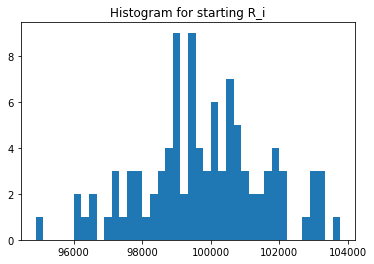

In [22]:
import matplotlib.pyplot as plt
a = starting_Ri.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_i")
plt.show()

In [23]:
experiments.UNI_Qi.unique()

array([201996.5577461 , 328852.09001246, 327852.09001246, ...,
       326390.4157378 , 208300.4157378 , 243259.94264833])

In [24]:
experiments.UNI_Si.unique()

array([10000., 15157., 15213., 15155., 15062., 14975., 15109., 15324.,
       15114., 15051., 15150., 14933., 15119., 15198., 15142., 15209.,
       15244., 15276., 14949., 15364., 15241., 15112., 15147., 15182.,
       14999., 15251., 15224., 15053., 15286., 15162., 15136., 15115.,
       15103., 15180., 15177., 15277., 14990., 15105., 15210., 15282.,
       15060., 15332., 15014., 15104., 15102., 15065., 15262., 15018.,
       15128., 15265., 15089., 15221., 15307., 15121., 15199., 15269.,
       15067., 14989., 15092., 14961., 15111., 15068., 15275., 15049.,
       14948., 15231., 15173., 15086., 15081., 15434., 14967., 15063.,
       15048., 15124., 15140., 15009., 15178., 15007., 15335., 15090.,
       15359., 15308., 15323., 15327., 15088., 15216., 15107., 15329.,
       15310., 15194., 15131., 15113., 15264., 15206., 15179., 15132.,
       15066., 15393., 15320., 14996., 15087., 14986., 15303., 15038.,
       15200., 15023., 15036., 15243., 14913., 15188., 15197., 15012.,
      

In [25]:
experiments.UNI_Qj.unique()

array([194418.4474541 , 245904.14952918, 244904.14952918, ...,
       244163.19100989, 245163.19100989, 246787.8221507 ])

In [26]:
experiments.UNI_Rj.unique()

array([97209.22372705, 82956.07476459, 83293.07476459, ...,
       79676.59550495, 79352.59550495, 76952.91107535])

In [27]:
starting_Rj = experiments[experiments.timestep == 0]
starting_Rj = starting_Rj['UNI_Rj']
starting_Rj.reset_index(drop=True)
starting_Rj.unique()

array([ 97209.22372705,  98998.20113728, 100952.07476459,  98300.46413933,
       101727.37587211,  98873.90621702,  97645.78559626, 100199.48150437,
        98581.59550495,  97898.01131135,  99111.03425438,  96946.57155313,
       103801.6581911 , 100137.2062818 , 102845.02743862,  97539.54654441,
        98197.84354311, 101586.46464126,  97235.50940288, 101594.48408897,
       102344.0095041 , 104477.83237737, 101321.63331229,  98038.615829  ,
       101259.0699654 , 101180.51050906,  98069.70501769,  97016.03465199,
       100429.06252756, 100595.67710429, 100950.8729639 ,  96836.4754268 ,
       100502.19239309, 100455.91051104, 102648.48940238, 101575.77585748,
       101438.1008063 ,  97393.91107535,  97556.69001982,  99554.11613914,
       100369.91329494, 101049.24513848, 100521.06647709, 100465.5412454 ,
       103148.09539139,  98320.83961603,  98445.85349378,  98178.13568982,
       100587.80719106,  97881.19793848, 100969.51802499, 100695.23274396,
       101640.17738244,  

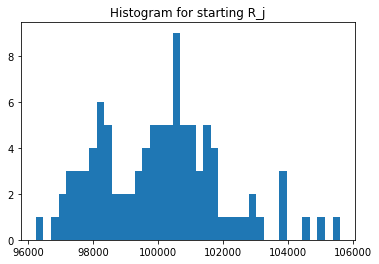

In [28]:
a = starting_Rj.unique()
_ = plt.hist(a, bins=40)  # arguments are passed to np.histogram
plt.title("Histogram for starting R_j")
plt.show()

In [29]:
experiments.UNI_Sj.unique()

array([10000], dtype=int64)

In [30]:
experiments.UNI_ij.unique()

array([100998.27887305,  99383.54500623,  98806.02781904,  99418.36888778,
       100716.70989512, 100194.32425272, 101955.97973737, 100754.1504107 ,
       100664.65974829,  97724.53133637, 101879.82436946, 101031.7181205 ,
        99973.01189183, 103773.6459511 ,  98335.73721185,  98803.91770933,
        99549.51030708,  99629.40756547, 100135.13413065,  99346.88336395,
        96103.21613609,  97190.99577765,  98605.84383074, 102974.38116142,
        97811.84641555, 100222.06920894,  99561.66365956, 101970.0495051 ,
        98917.24782412,  99046.32394905,  99083.04448048, 102083.1946731 ,
        97907.00331514, 101847.47977958,  96535.70193842, 100689.53428609,
        99768.99379084, 100650.2078689 , 101487.74385306,  98968.91569358,
       100394.45905789, 100343.29019185,  99001.60364256,  98396.17492283,
        98570.76742164, 102136.53705374,  99399.66208935,  97086.53581314,
       101230.74232906, 102999.60072183,  98946.17755173,  97588.11897026,
       101658.52873405, 1

In [31]:
experiments.UNI_ji.unique()

array([ 97209.22372705, 100952.07476459, 100199.48150437,  98998.20113728,
        98300.46413933,  99111.03425438, 101727.37587211,  98873.90621702,
        97645.78559626,  98038.615829  ,  98581.59550495,  97016.03465199,
        97898.01131135, 100137.2062818 , 103801.6581911 ,  96946.57155313,
        98197.84354311, 101586.46464126, 102845.02743862,  97539.54654441,
       105590.47096851,  97235.50940288, 100429.06252756, 101594.48408897,
       102344.0095041 , 104477.83237737, 101259.0699654 , 101321.63331229,
       101180.51050906,  98069.70501769,  97556.69001982, 100587.80719106,
       100951.58925445, 100950.8729639 , 100595.67710429, 101049.24513848,
        96836.4754268 , 100502.19239309, 100455.91051104, 100969.51802499,
        97568.56492513, 102648.48940238, 101438.1008063 ,  99554.11613914,
       101575.77585748,  97393.91107535, 100369.91329494, 100521.06647709,
       100465.5412454 ,  97881.19793848,  98320.83961603, 103148.09539139,
        98178.13568982,  

In [32]:
experiments.UNI_Sij.unique()

array([9.81796429e+09, 1.00329751e+10, 9.90031276e+09, 9.84223968e+09,
       9.90049933e+09, 9.93036310e+09, 1.03717143e+10, 9.96195642e+09,
       9.82947978e+09, 9.58077778e+09, 1.00434756e+10, 9.80169667e+09,
       9.78715905e+09, 1.03916030e+10, 1.02074126e+10, 9.57870108e+09,
       9.77554724e+09, 1.01209993e+10, 1.02984006e+10, 9.69024995e+09,
       1.01475839e+10, 9.45041598e+09, 9.90289246e+09, 1.04616291e+10,
       1.00104565e+10, 1.04709845e+10, 1.00815215e+10, 1.03317720e+10,
       1.00084976e+10, 9.71344377e+09, 9.66621386e+09, 1.02683247e+10,
       9.88386758e+09, 1.02815920e+10, 9.71107430e+09, 1.01746014e+10,
       9.66127772e+09, 1.01155666e+10, 1.01950437e+10, 9.99284372e+09,
       9.79534330e+09, 1.03000872e+10, 1.00425347e+10, 9.79574423e+09,
       1.00124022e+10, 9.94747681e+09, 9.97673547e+09, 9.75924212e+09,
       1.01702013e+10, 1.00817243e+10, 9.72847125e+09, 1.00660286e+10,
       9.98064483e+09, 9.88579074e+09, 9.99227694e+09, 9.89760437e+09,
      

In [33]:
def get_M(k, v):
    if k == 'sim_config':
        k, v = 'M', v['M']
    return k, v

config_ids = [
    dict(
        get_M(k, v) for k, v in config.__dict__.items() if k in ['simulation_id', 'run_id', 'sim_config', 'subset_id']
    ) for config in configs
]

# Agent sequences

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


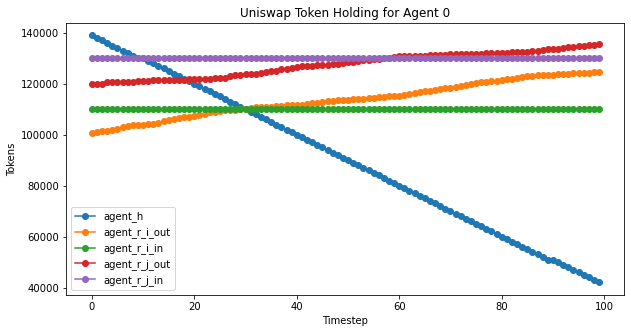

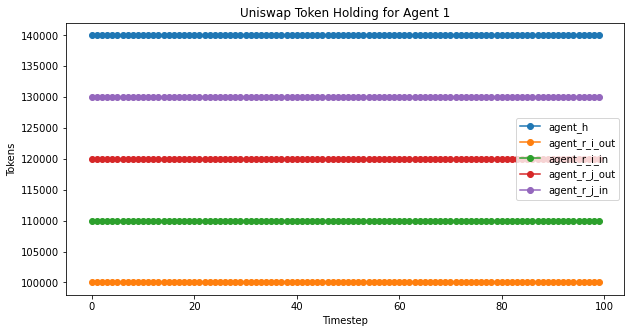

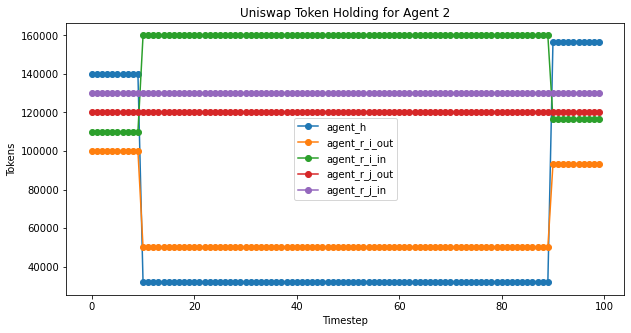

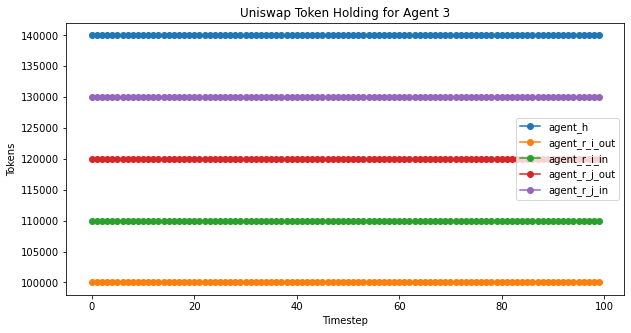

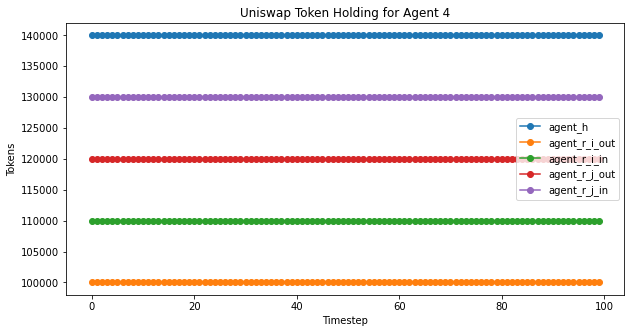

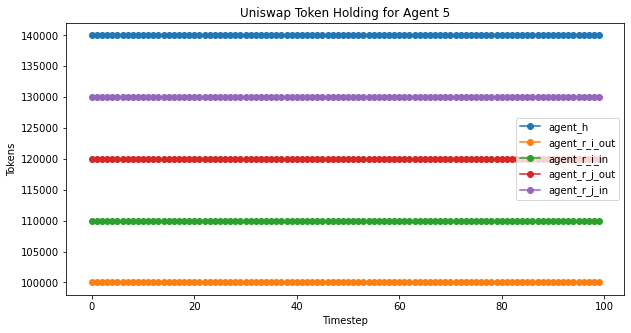

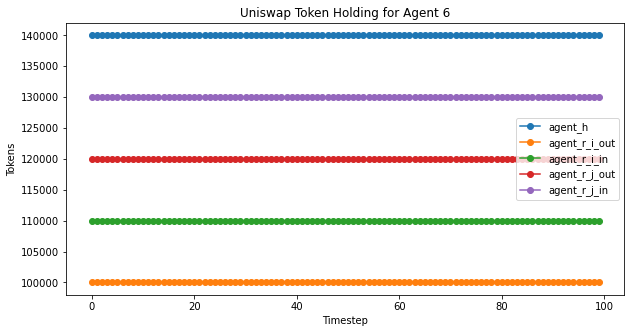

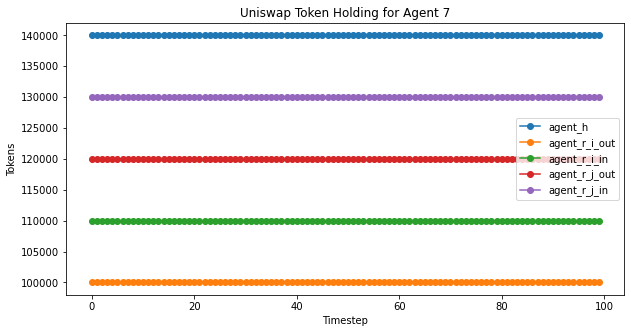

In [34]:
agent_plot(experiment2,'Uniswap Token Holding for Agent ', 100) #,4,'j')

C:\ProgramData\Anaconda3\lib\site-packages\pandas\core\frame.py:4459: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().fillna(


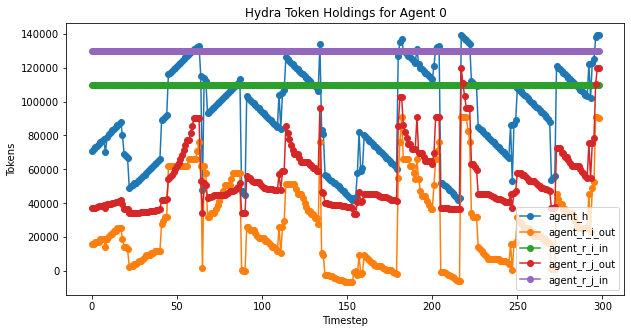

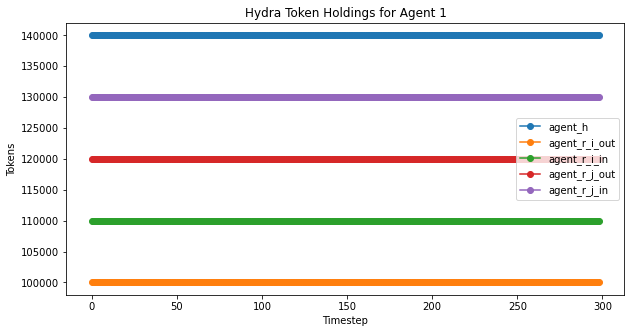

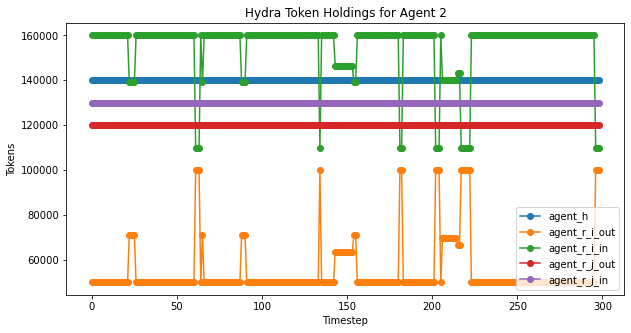

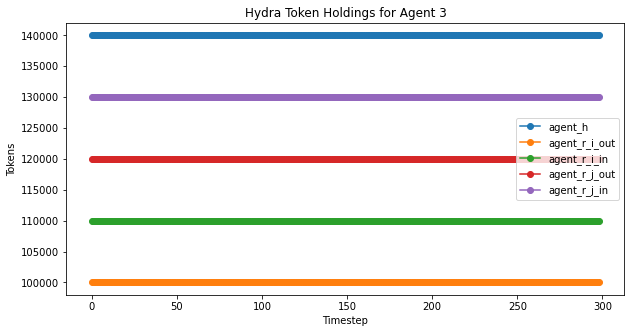

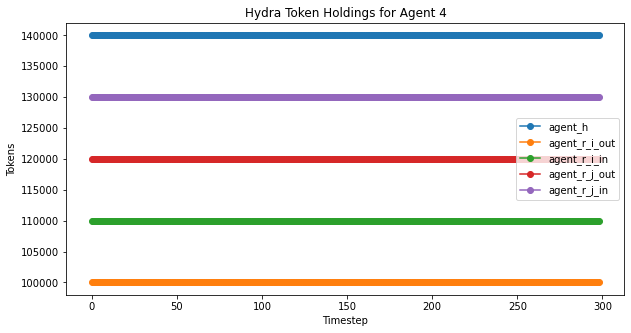

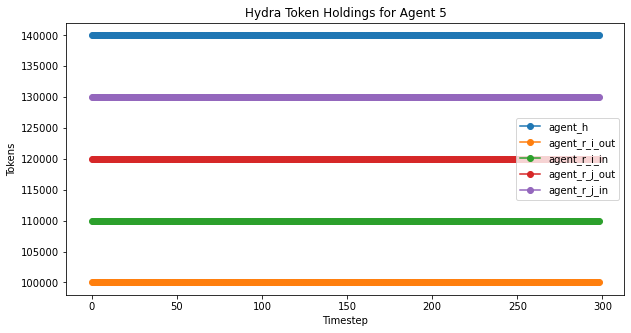

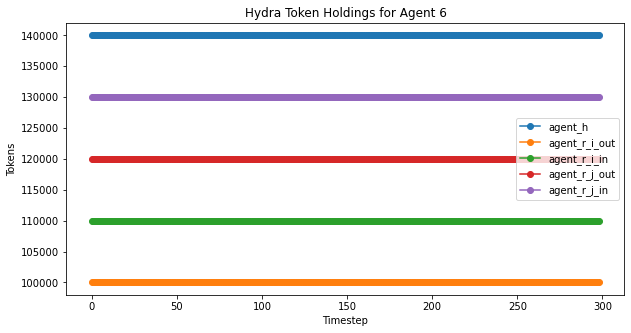

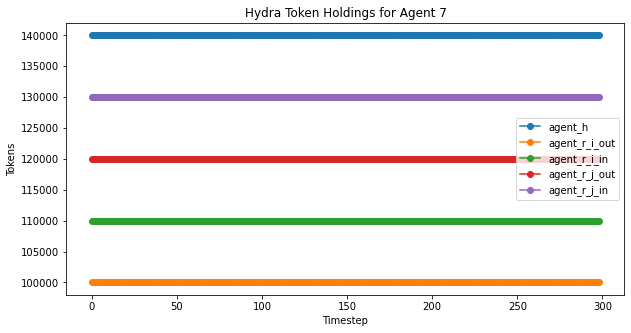

In [35]:
hydra_agent_plot(experiments,'Hydra Token Holdings for Agent ', 299)

# Liquidity dynamics

Movement of the Uniswap variables

- 'UNI_Ri', 'UNI_Qi', 'UNI_Si'
- 'UNI_Rj', 'UNI_Qj', 'UNI_Sj'
- 'UNI_ij', 'UNI_ji', 'UNI_Sij'

## Uniswap -- Ri-Q instance

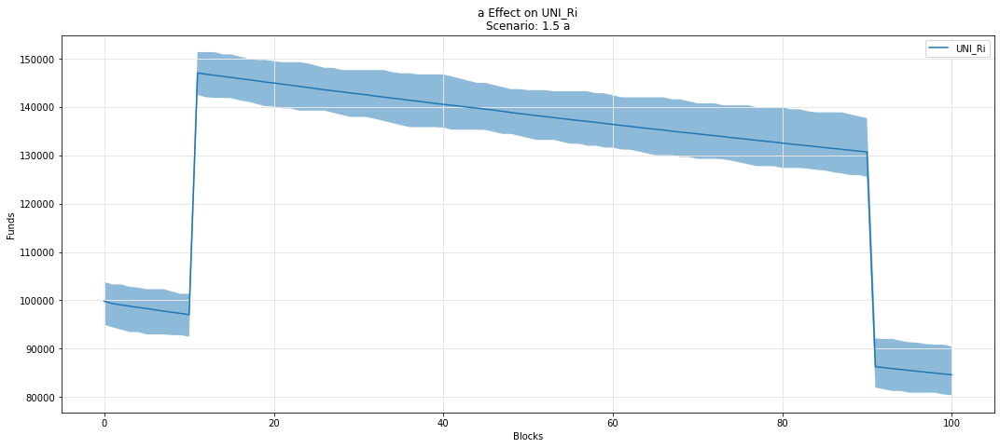

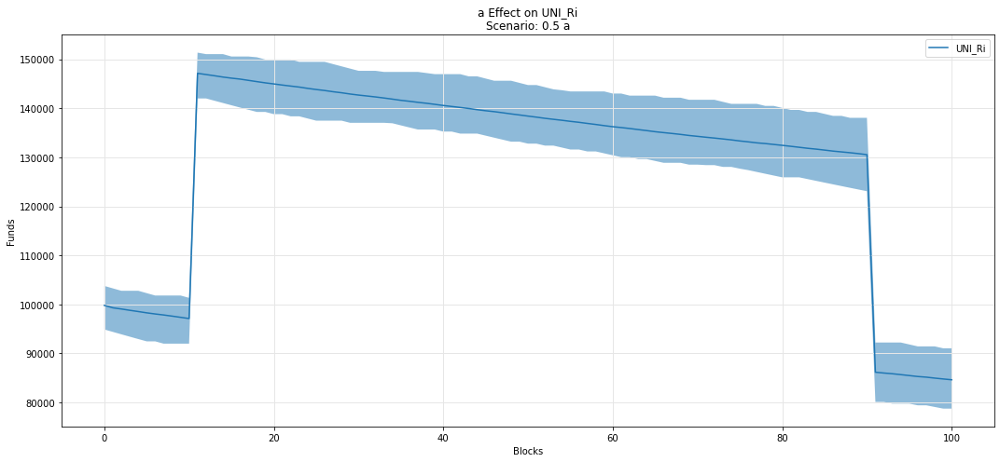

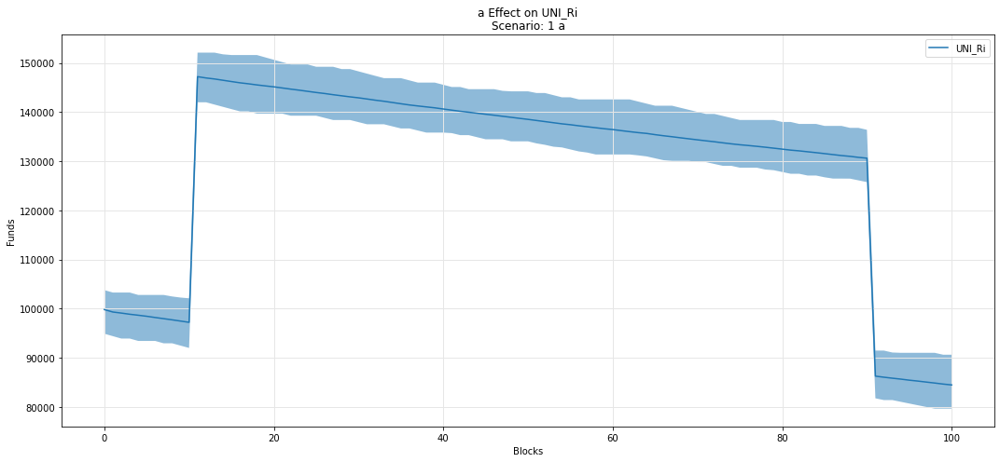

In [36]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Ri')

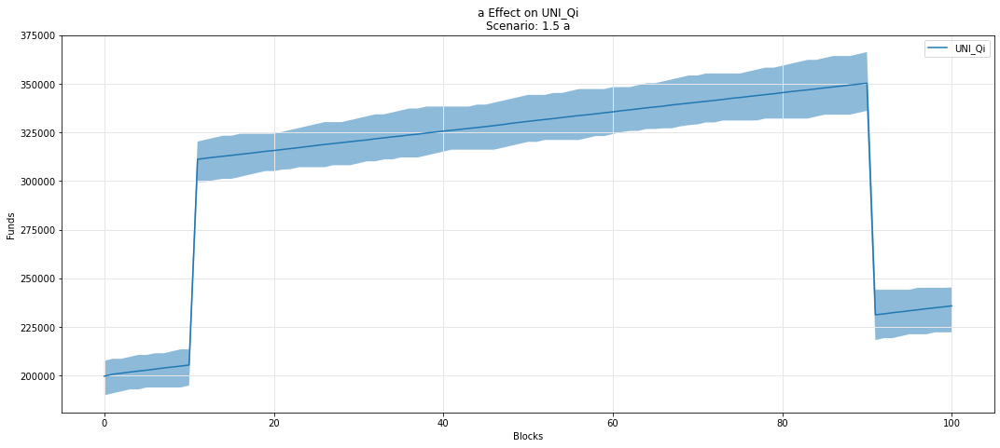

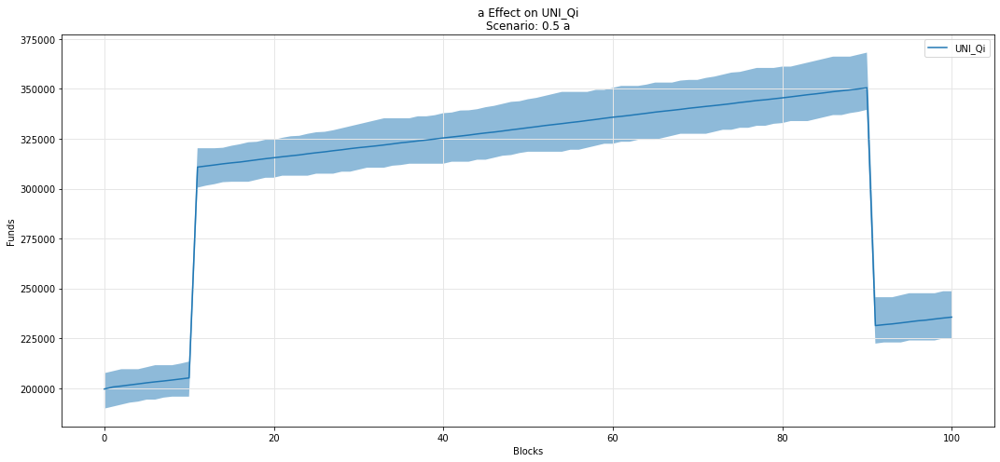

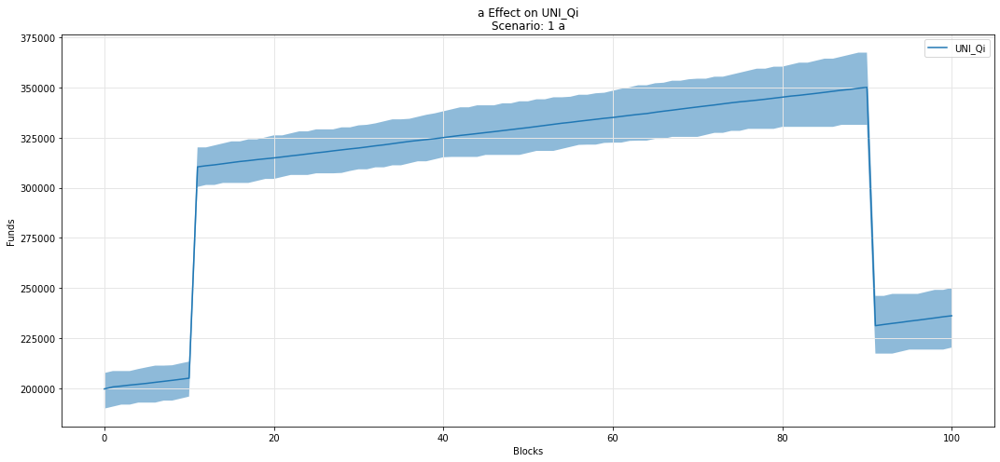

In [37]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qi')

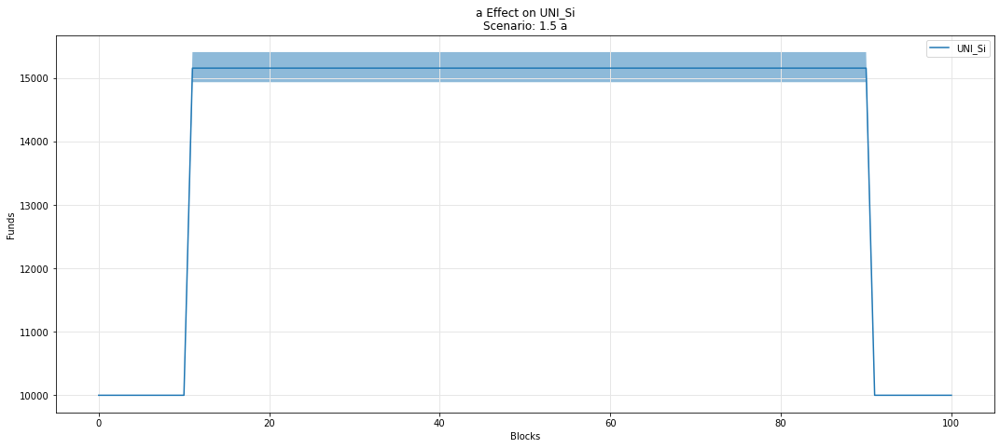

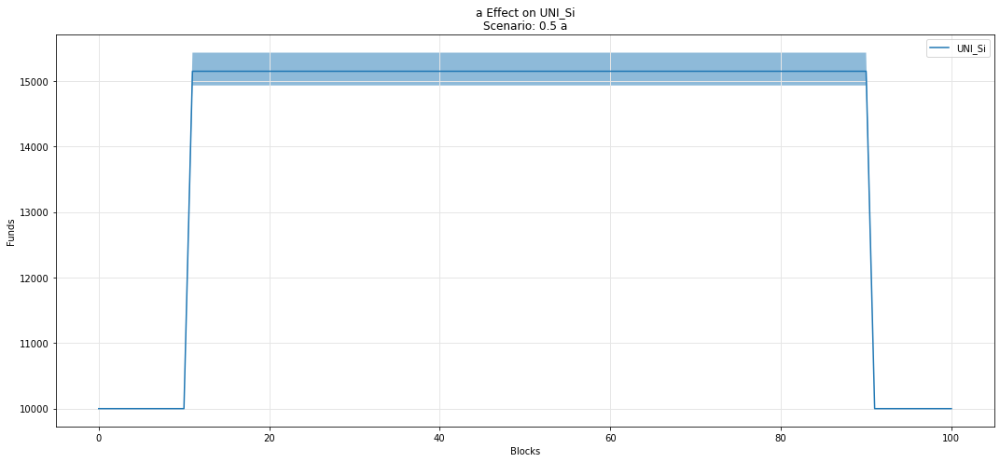

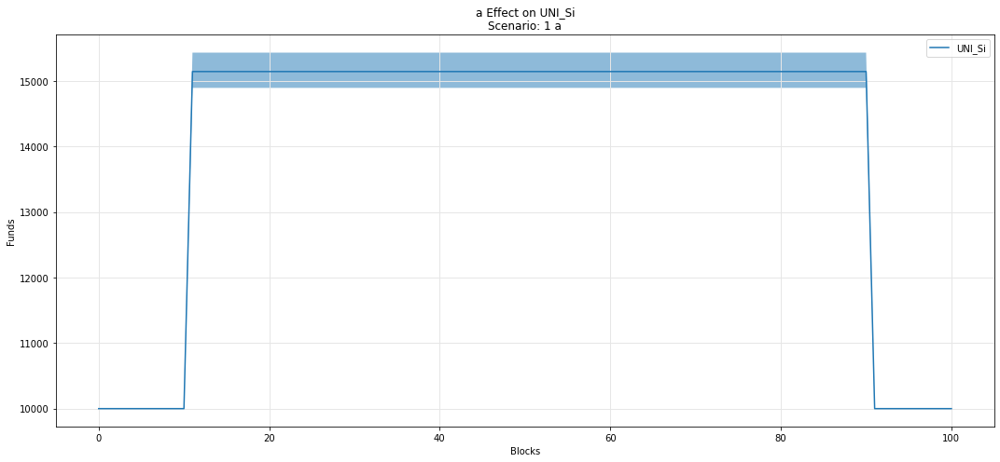

In [38]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Si')

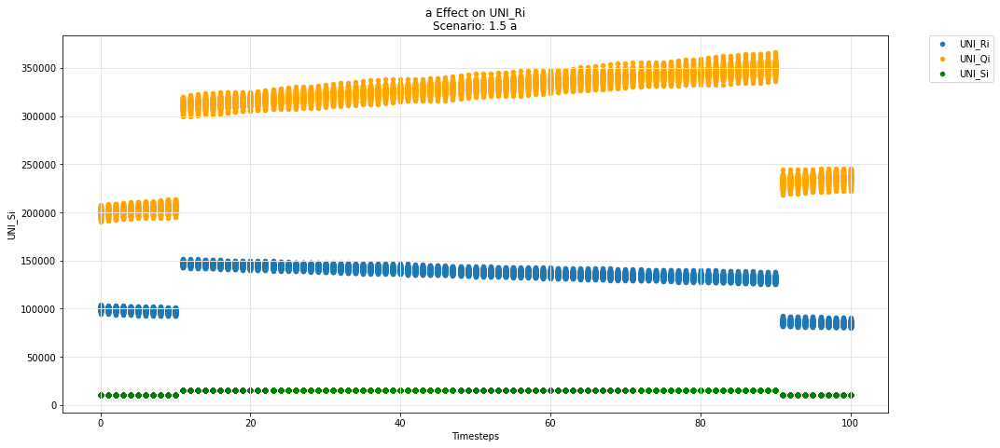

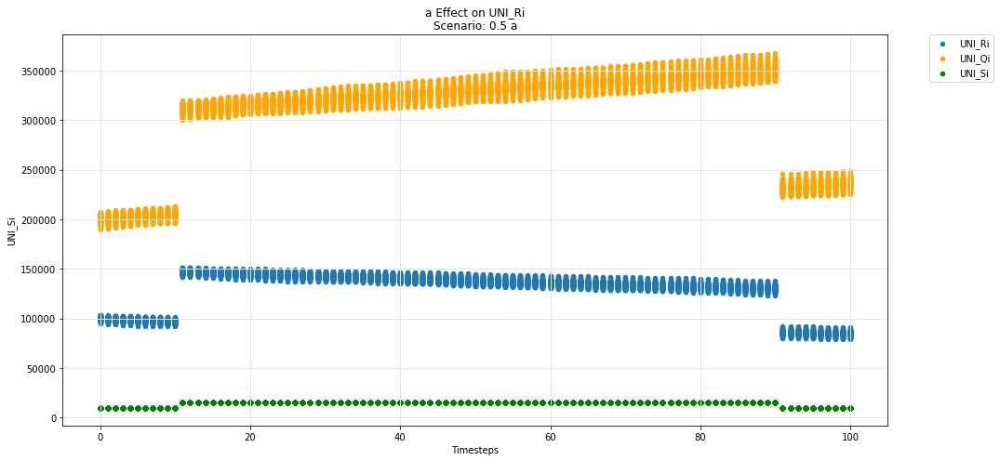

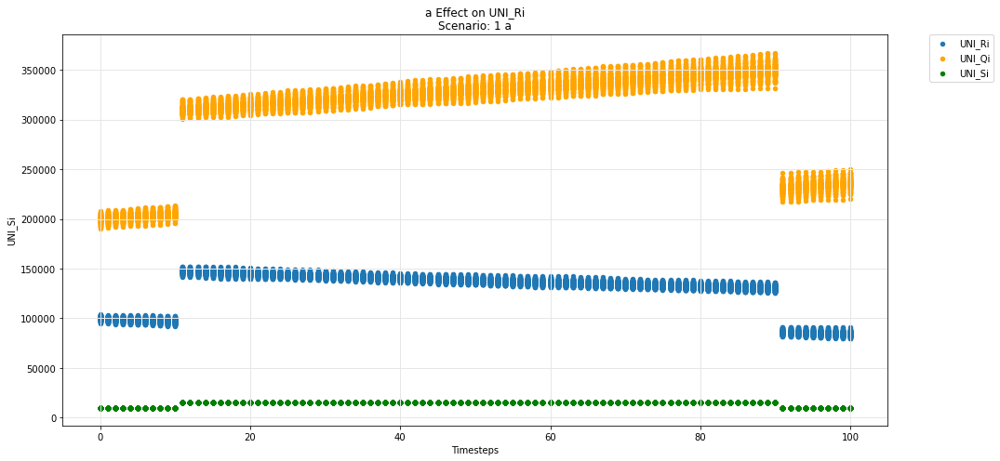

In [39]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Ri', 'UNI_Qi', 'UNI_Si')

## Uniswap -- Rj-Q instance

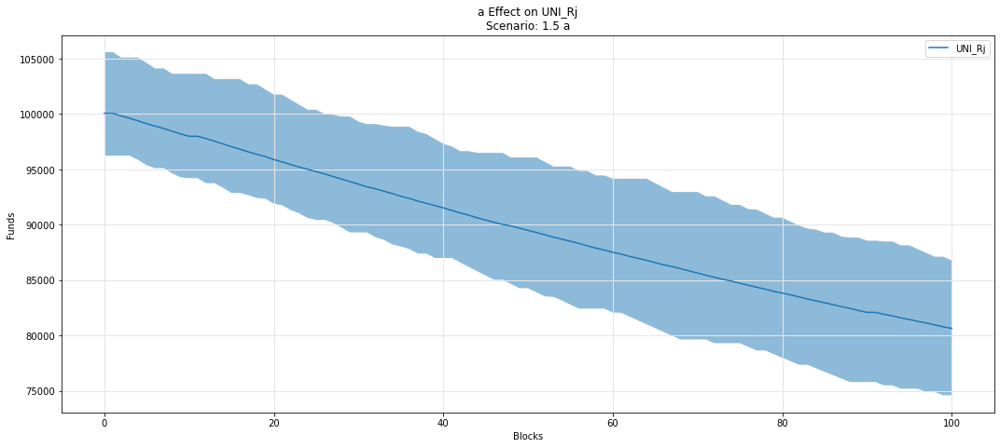

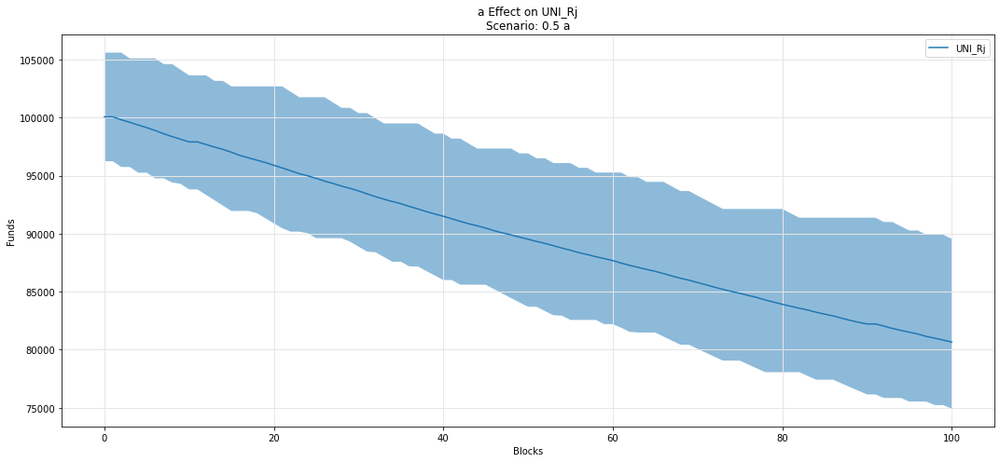

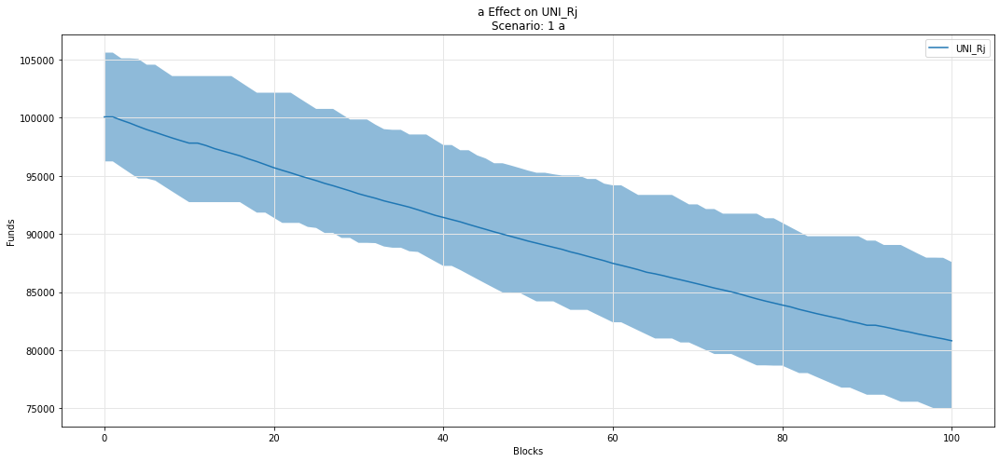

In [40]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Rj')

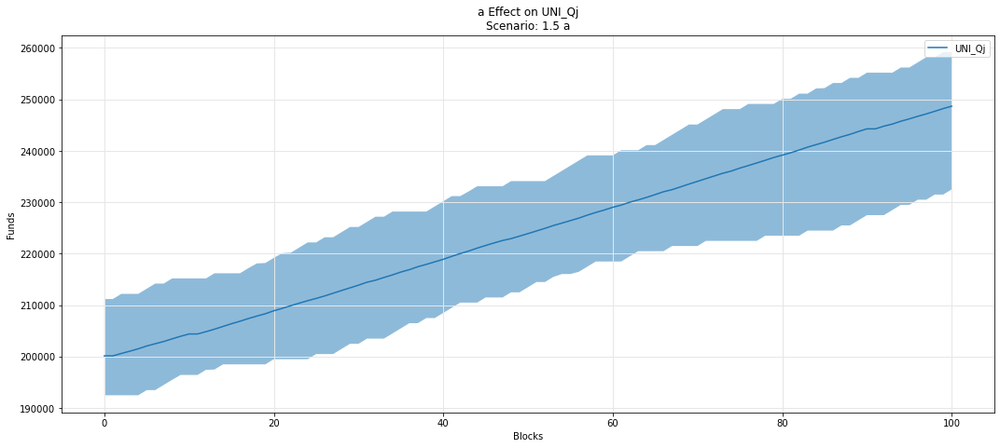

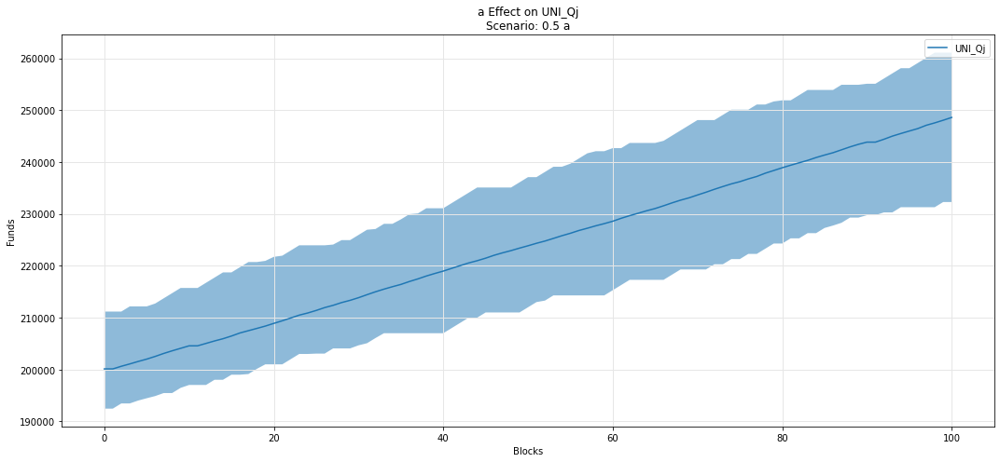

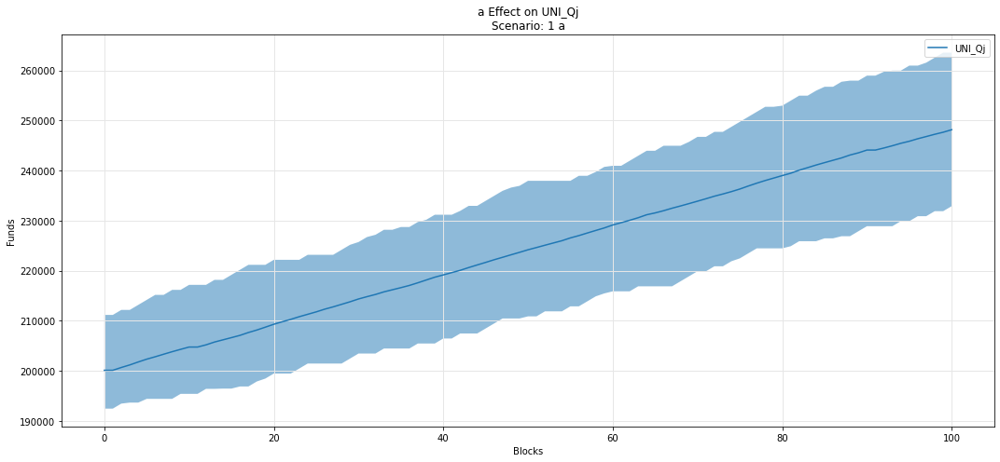

In [41]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Qj')

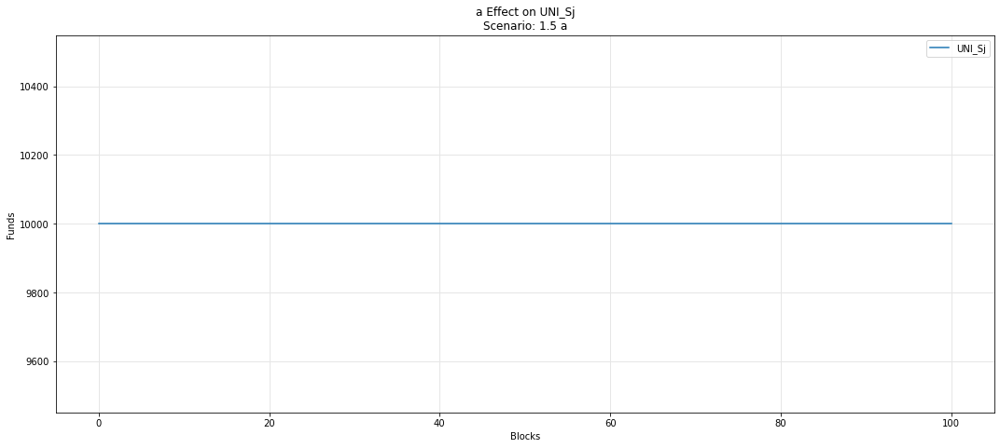

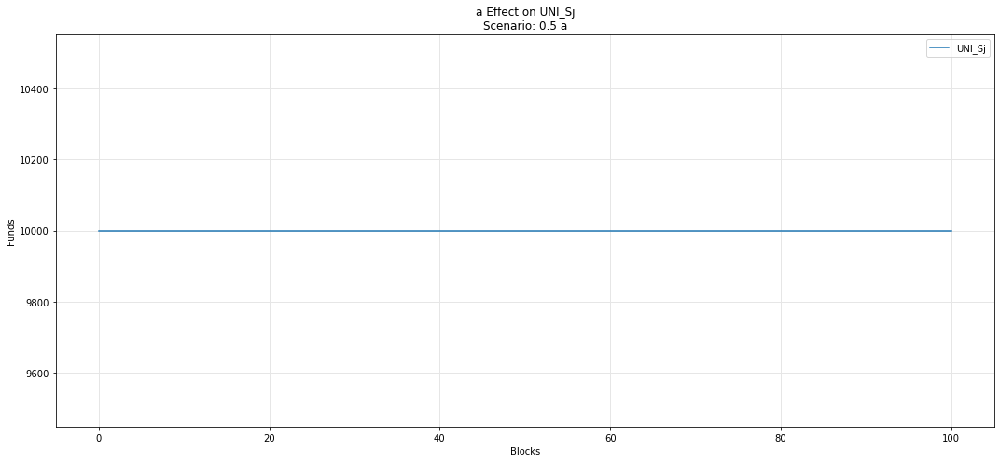

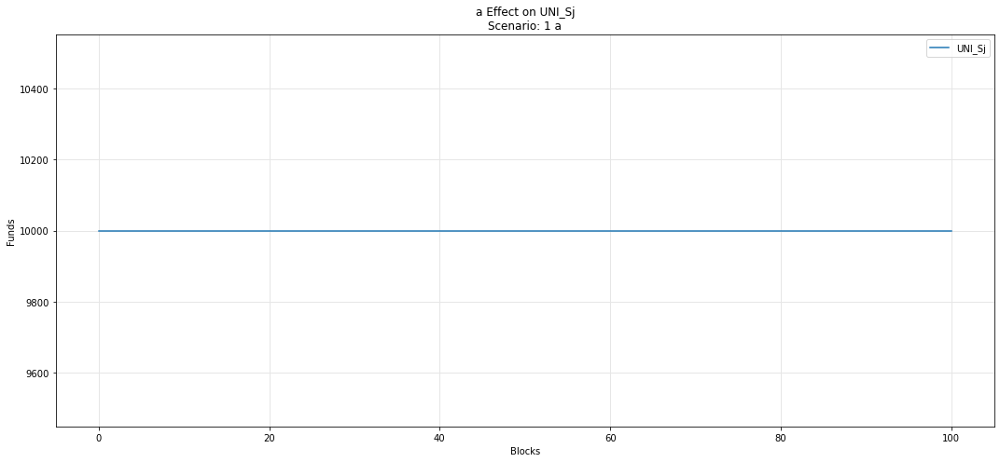

In [42]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sj')

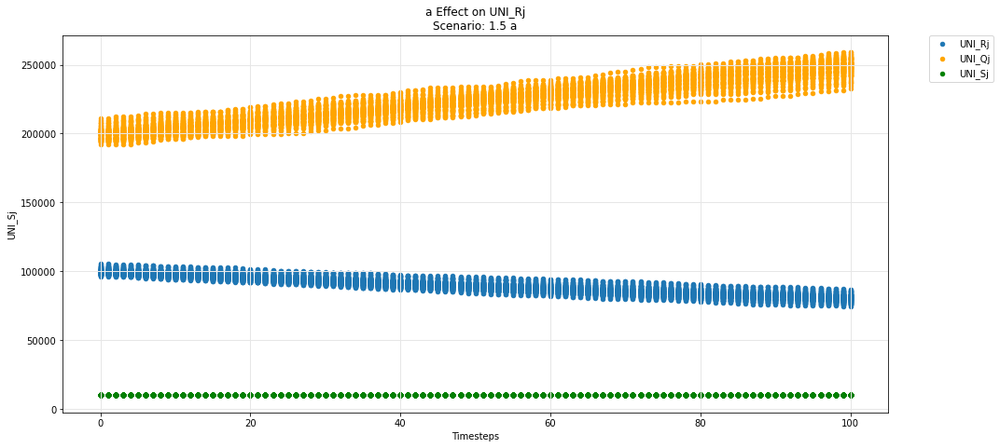

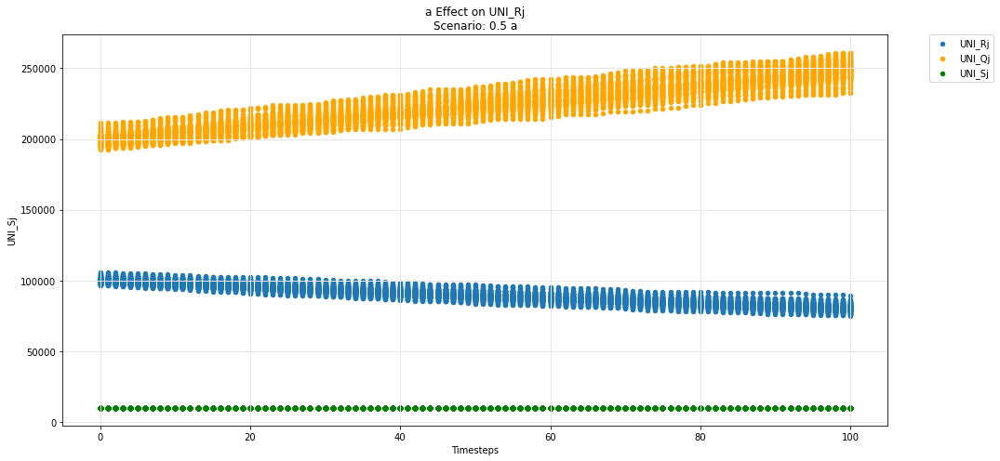

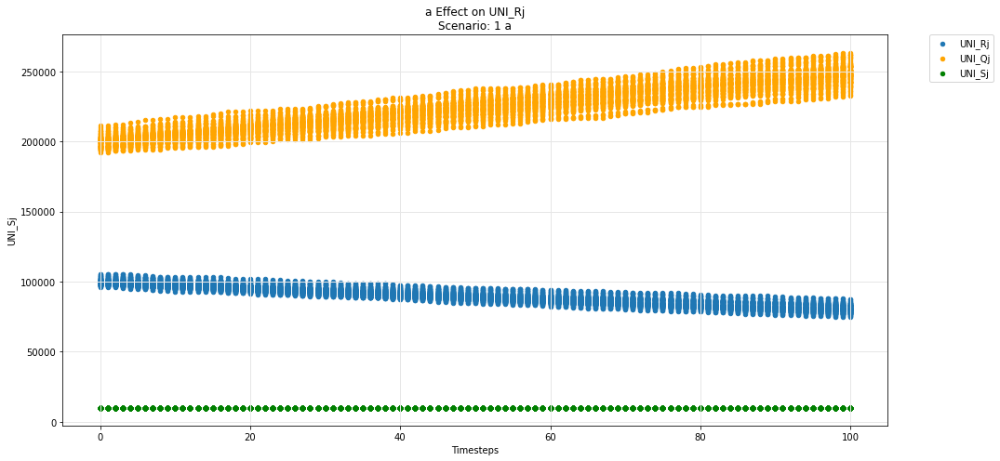

In [43]:
param_test_plot(experiments, config_ids, 'a', 'UNI_Rj', 'UNI_Qj', 'UNI_Sj')

## Uniswap -- ij-Q instance

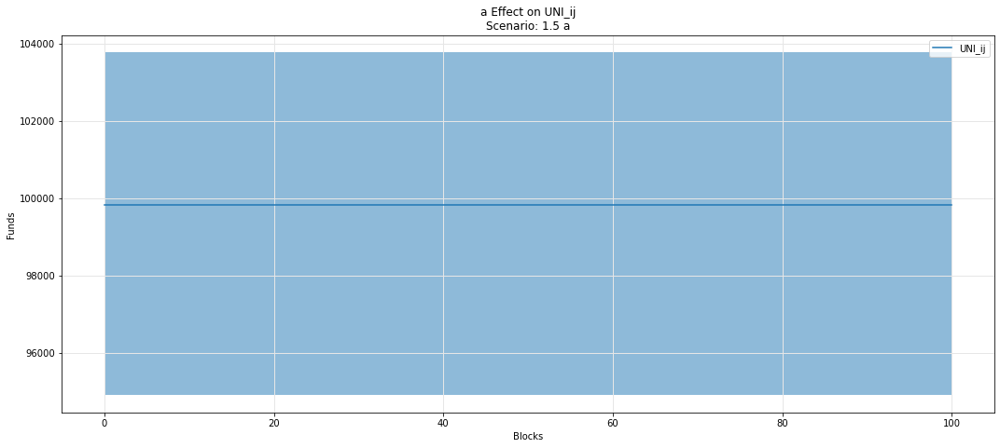

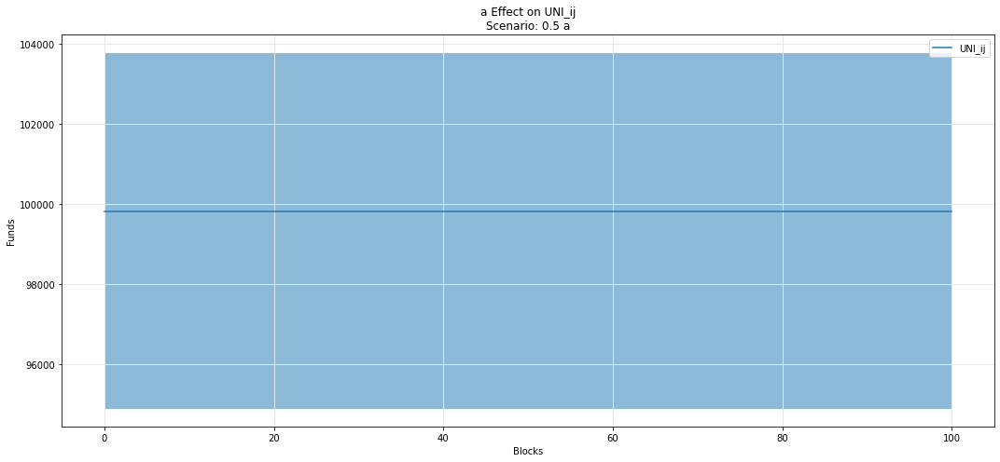

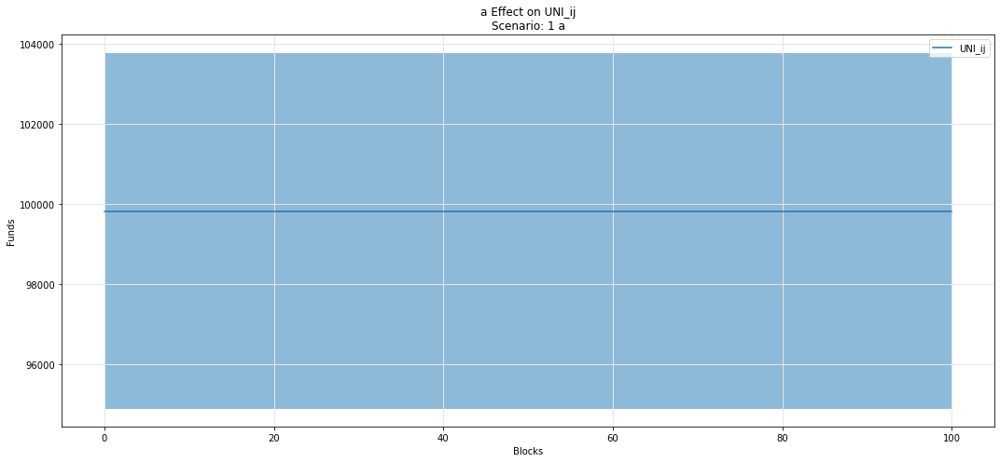

In [44]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ij')

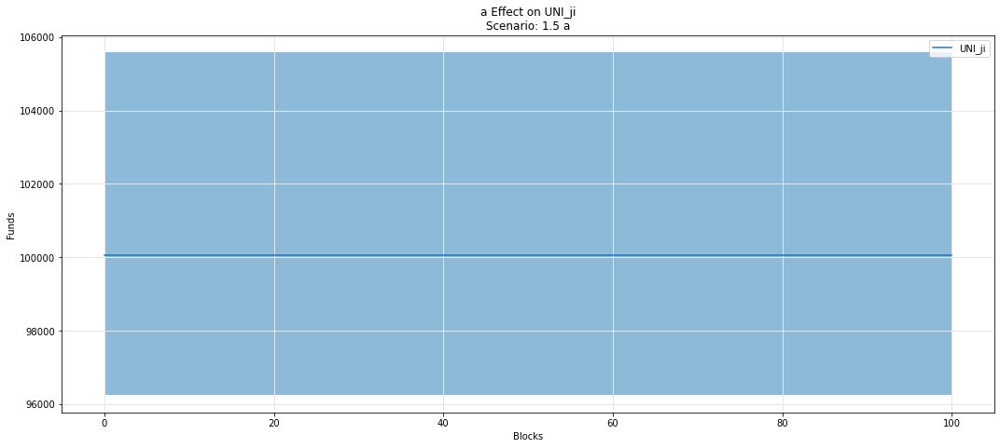

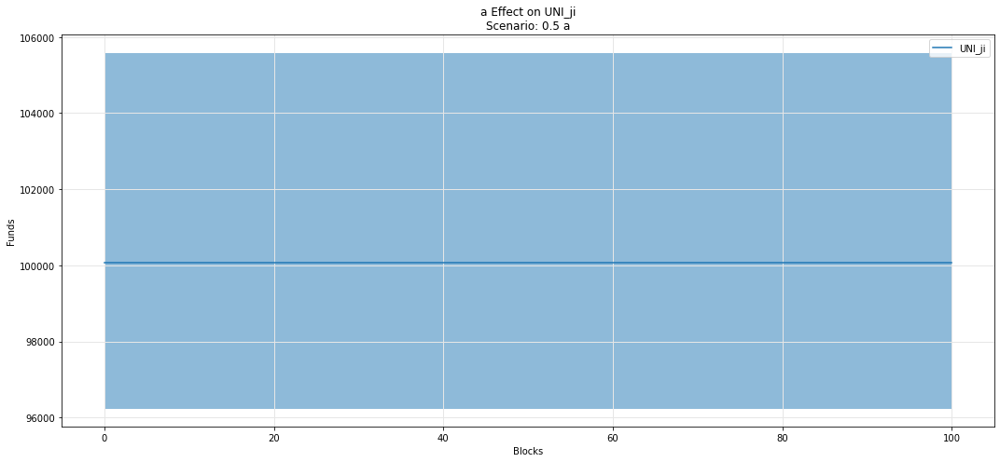

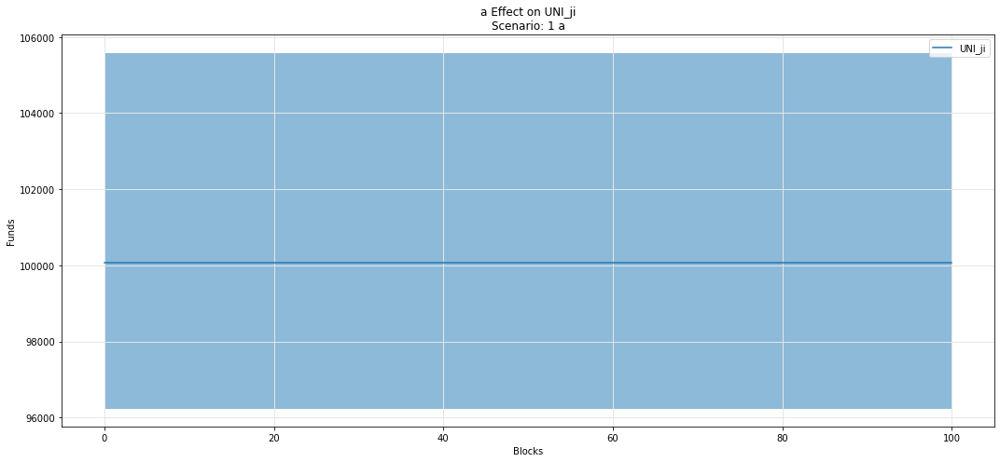

In [45]:
param_fan_plot3(experiments, config_ids, 'a','UNI_ji')

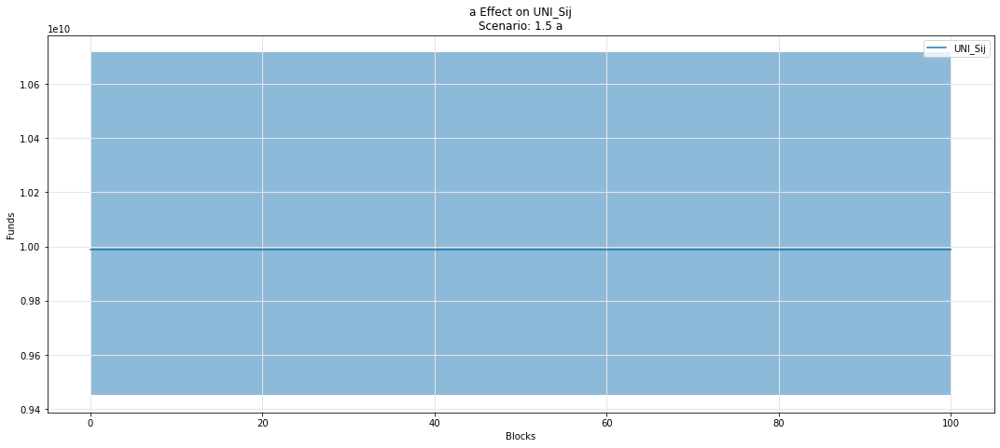

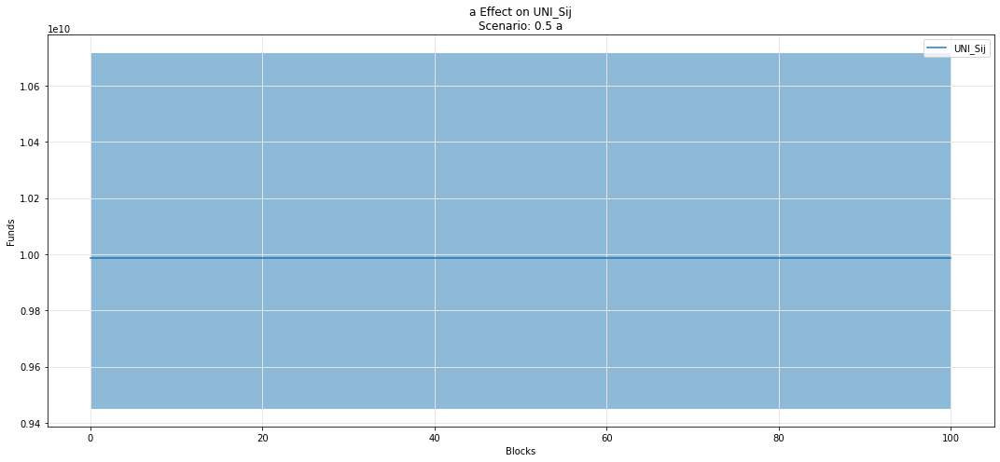

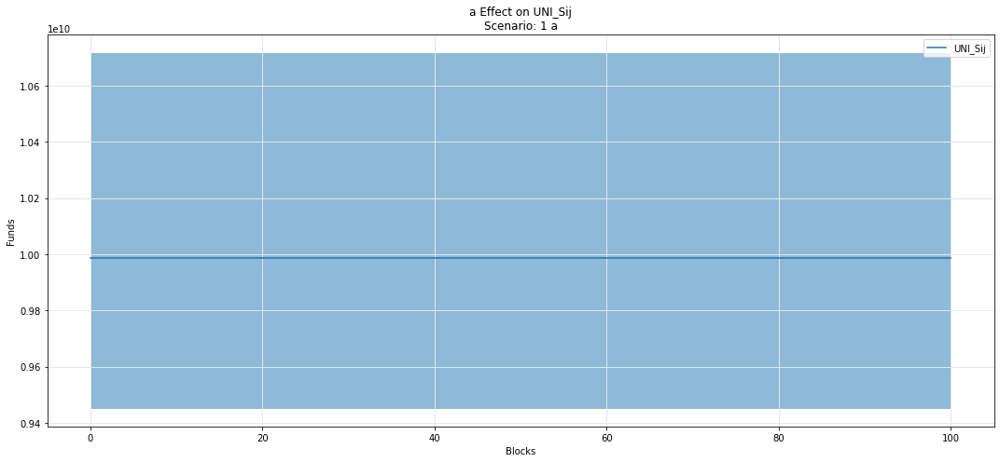

In [46]:
param_fan_plot3(experiments, config_ids, 'a','UNI_Sij')

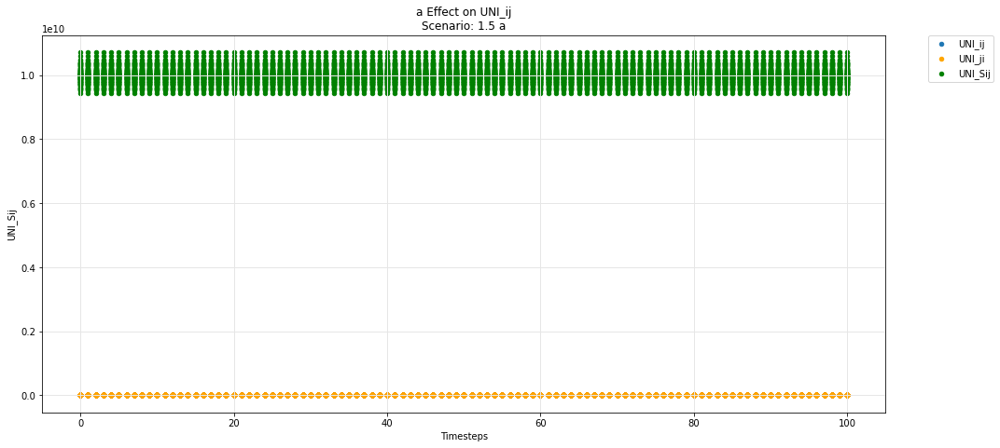

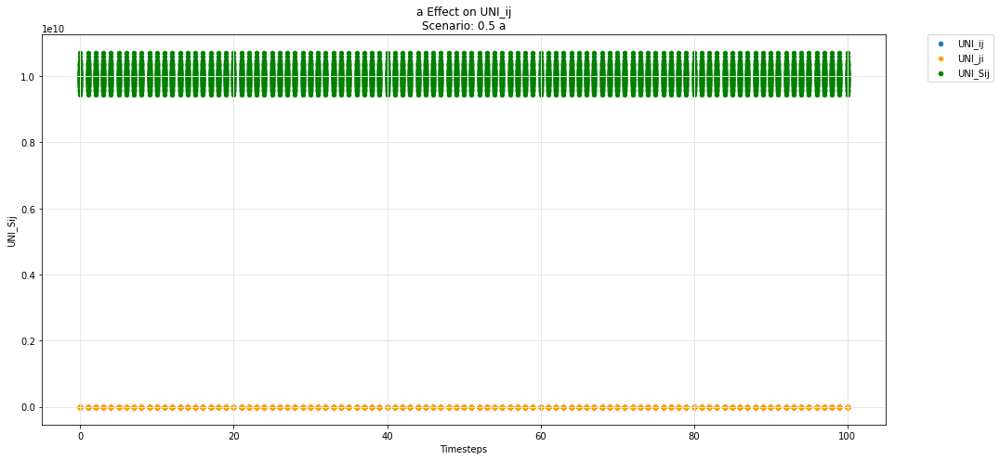

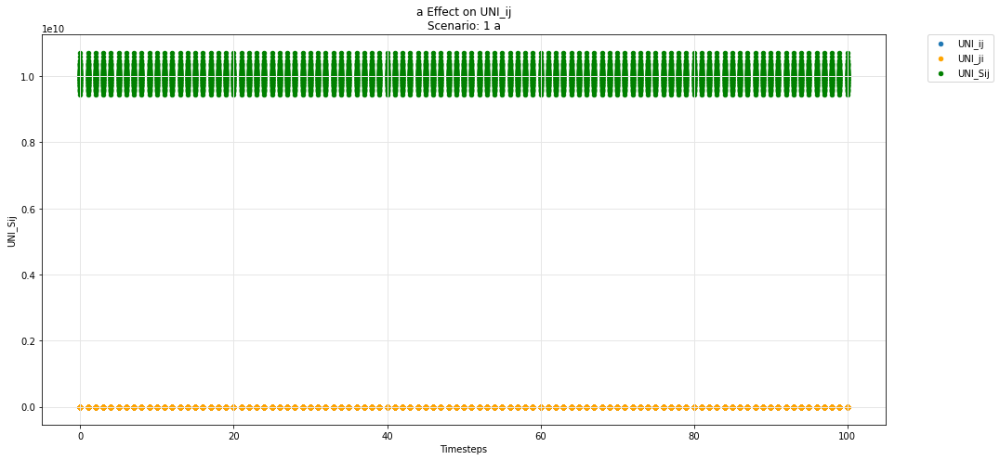

In [47]:
param_test_plot(experiments, config_ids, 'a', 'UNI_ij', 'UNI_ji', 'UNI_Sij')

## Hydra -- base

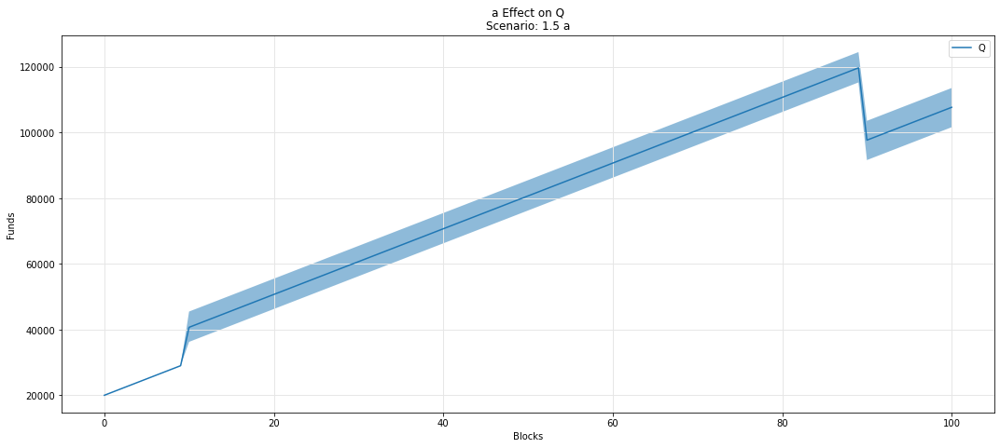

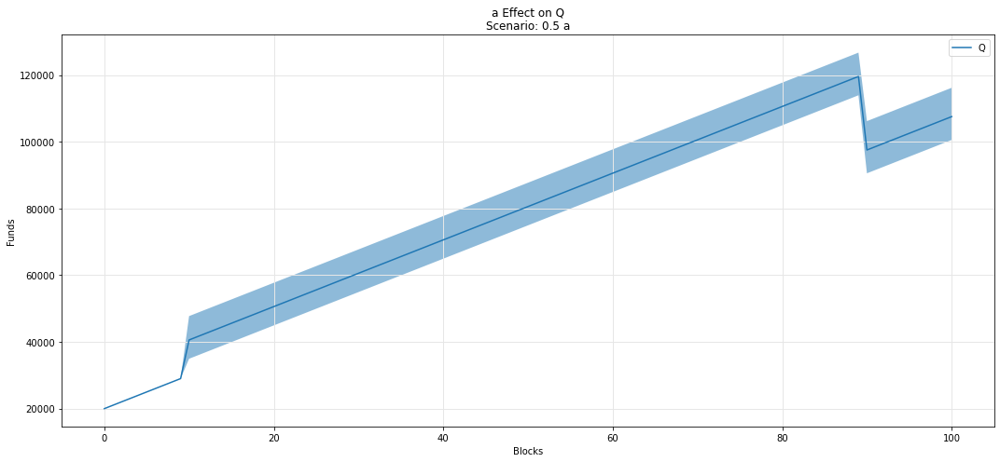

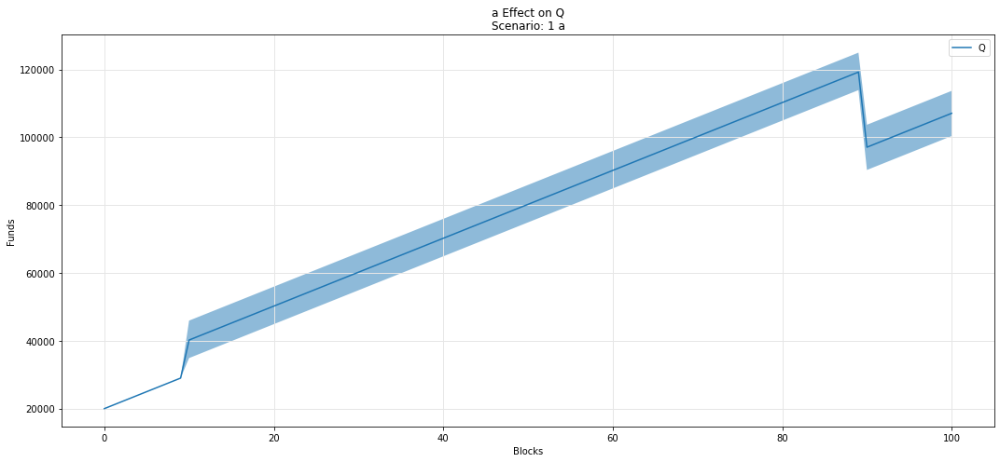

In [48]:
param_fan_plot3(experiments, config_ids, 'a','Q')

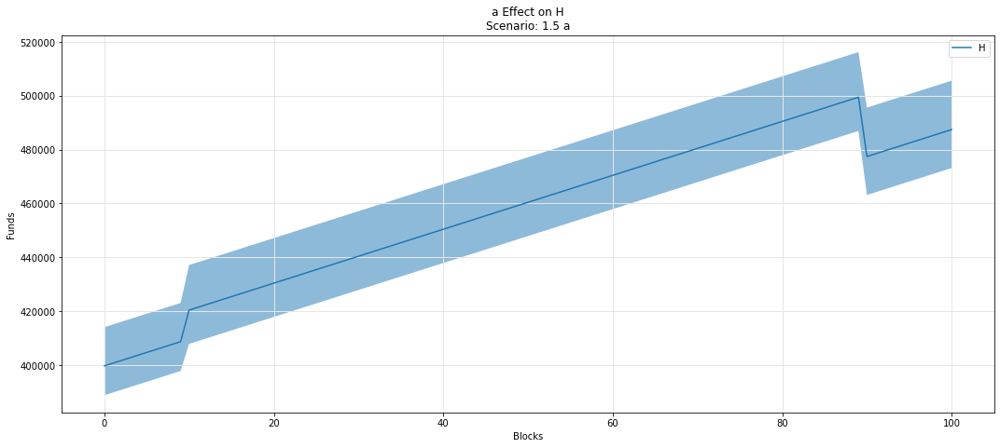

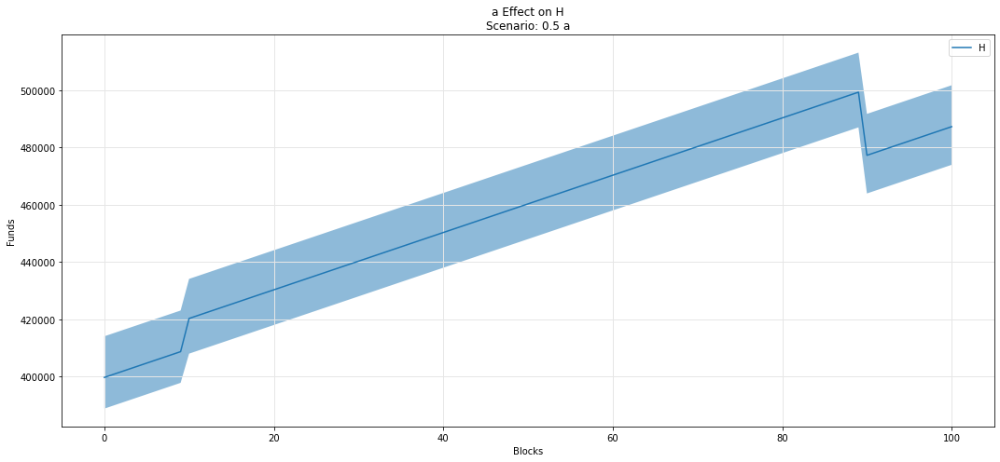

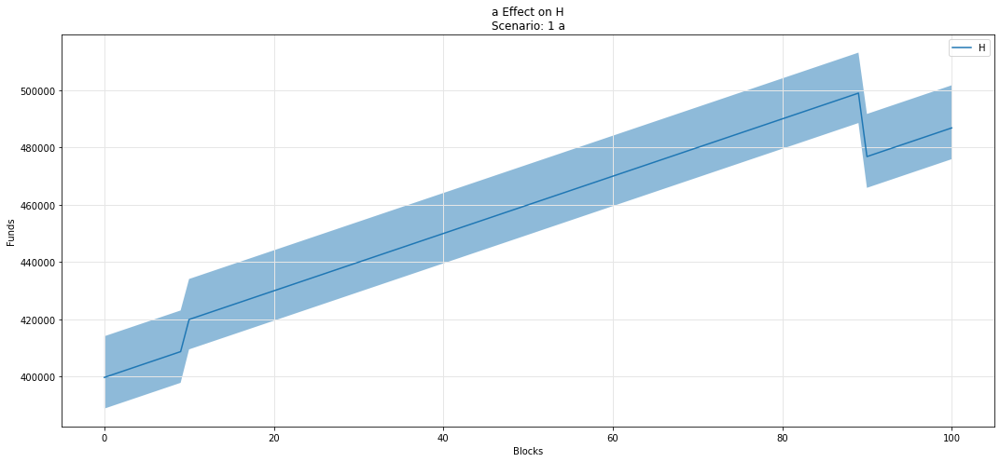

In [49]:
param_fan_plot3(experiments, config_ids, 'a','H')

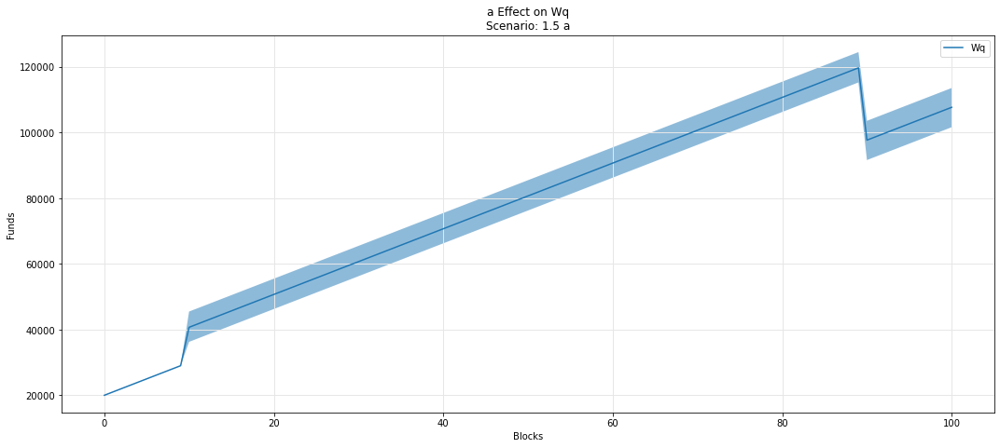

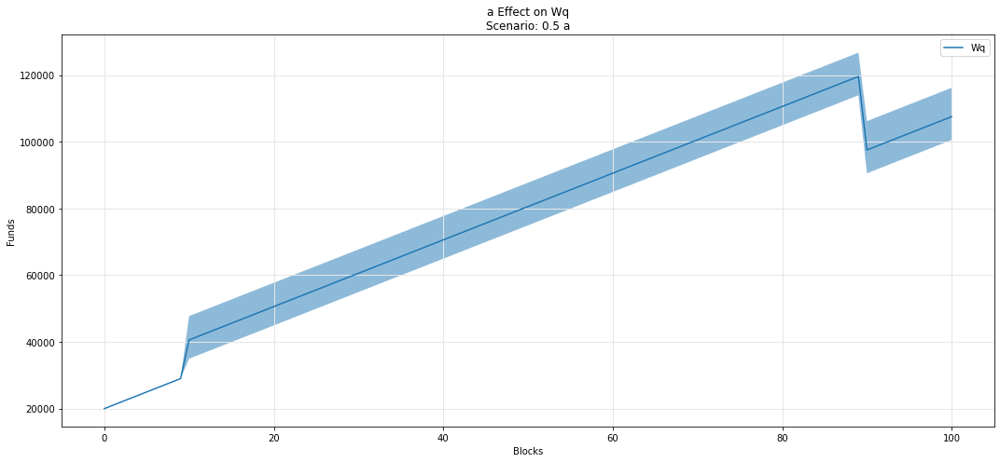

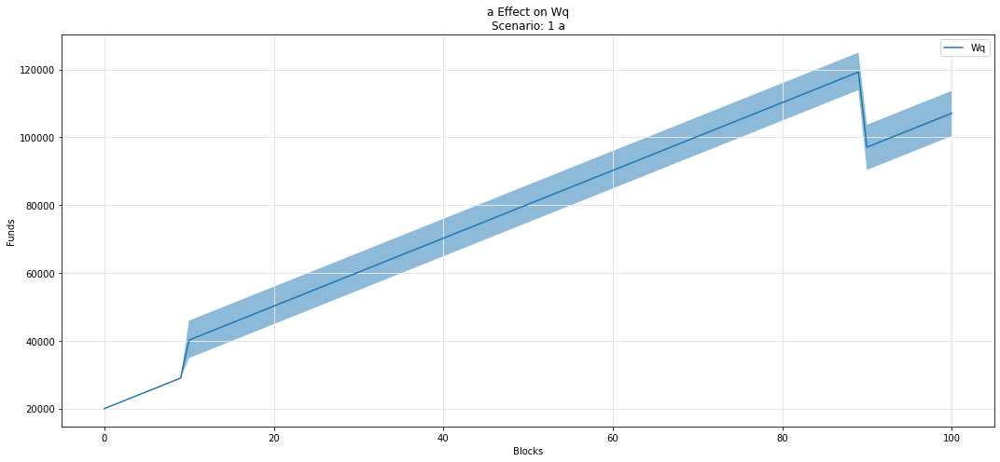

In [50]:
param_fan_plot3(experiments, config_ids, 'a','Wq')

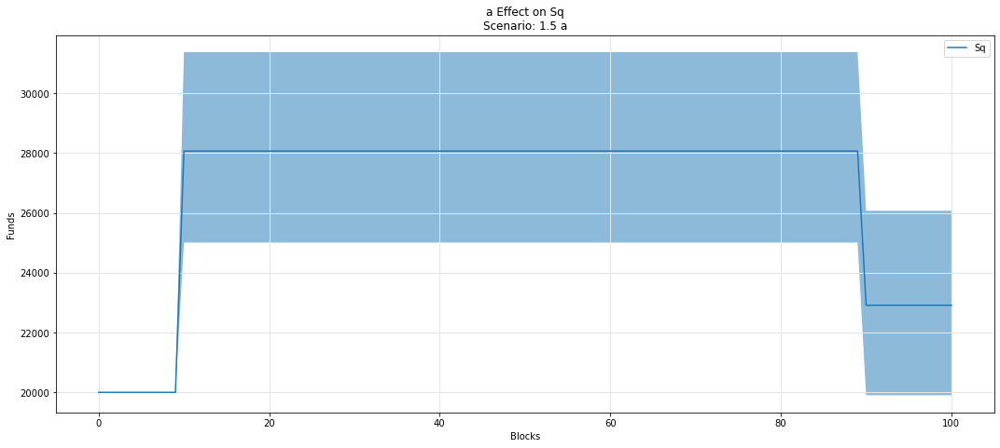

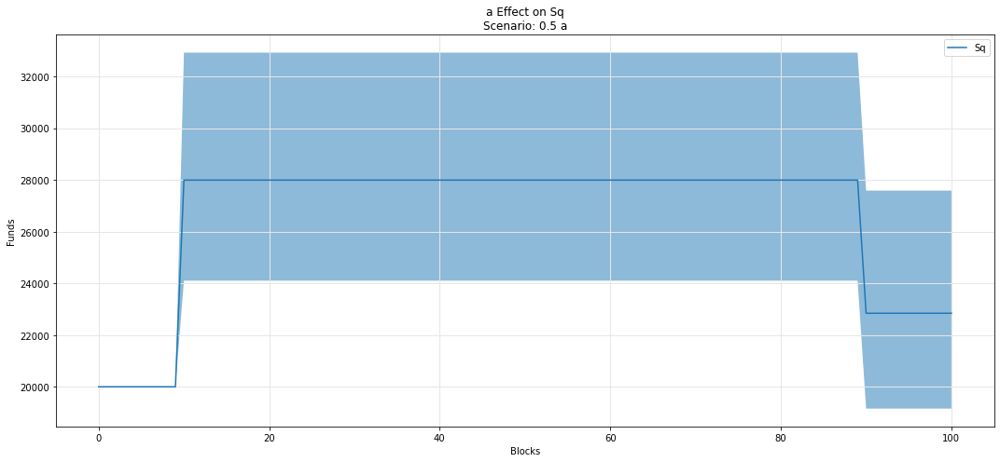

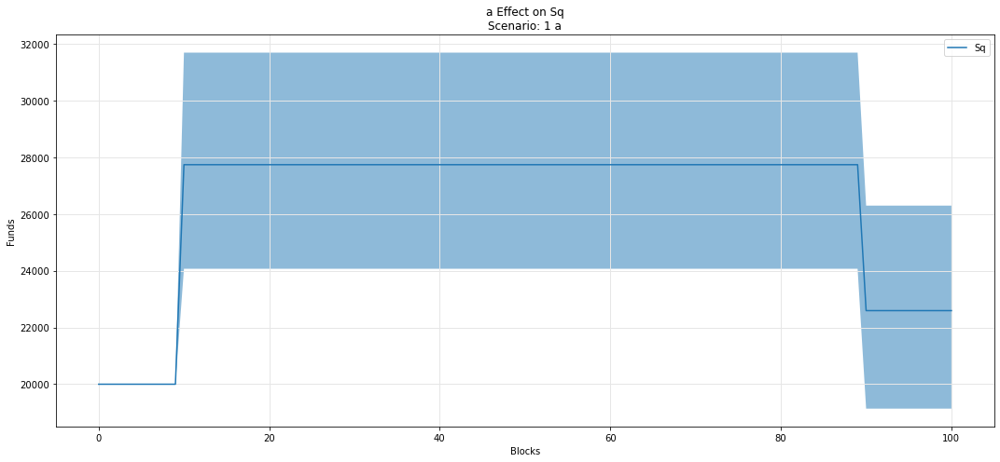

In [51]:
param_fan_plot3(experiments, config_ids, 'a','Sq')

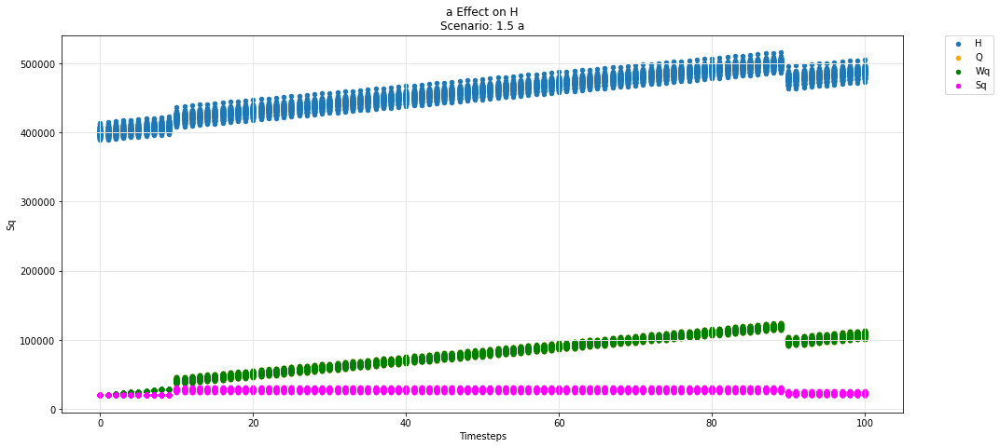

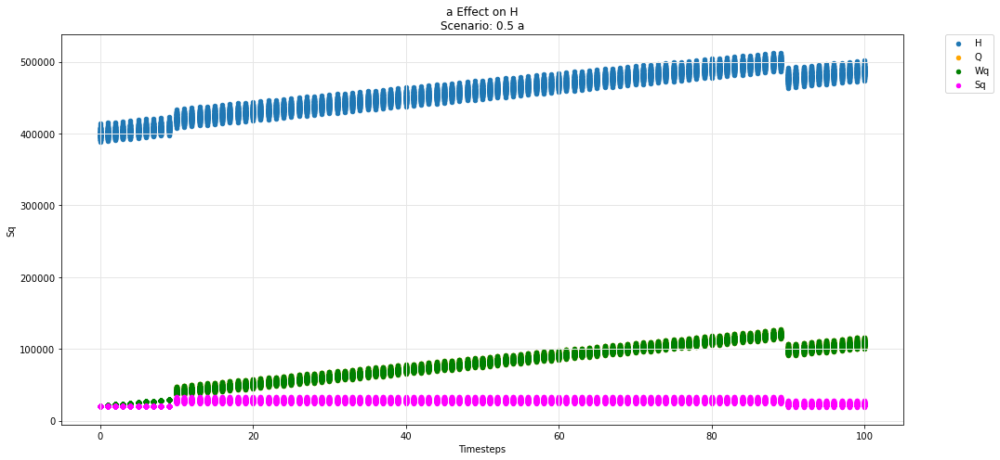

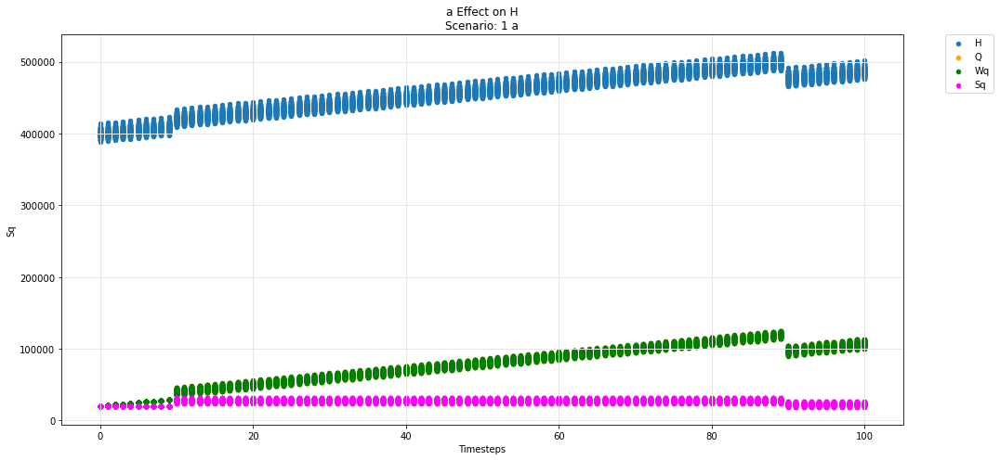

In [52]:
param_test_plot(experiments, config_ids, 'a', 'H', 'Q', 'Wq', 'Sq')

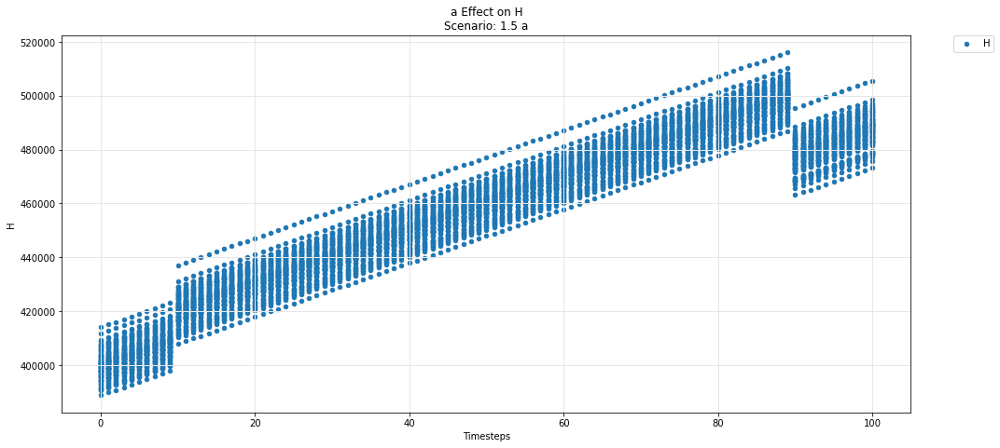

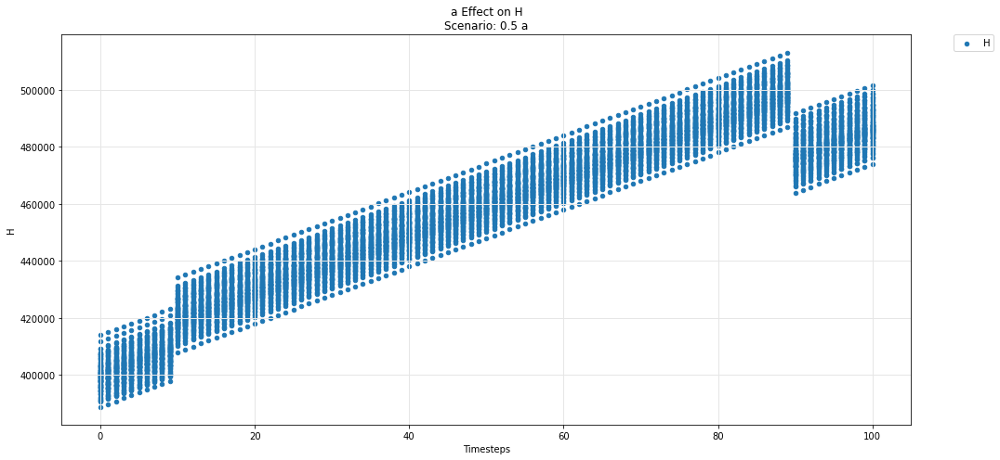

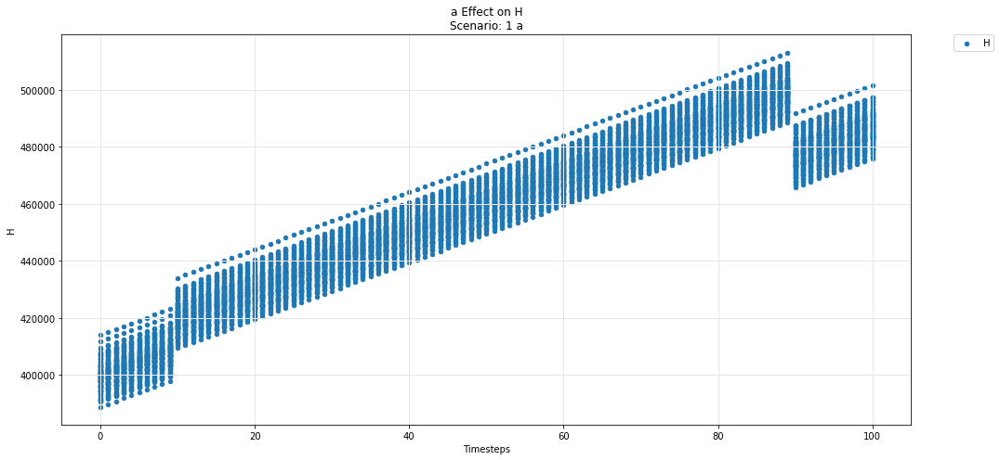

In [53]:
param_test_plot(experiments, config_ids, 'a', 'H')

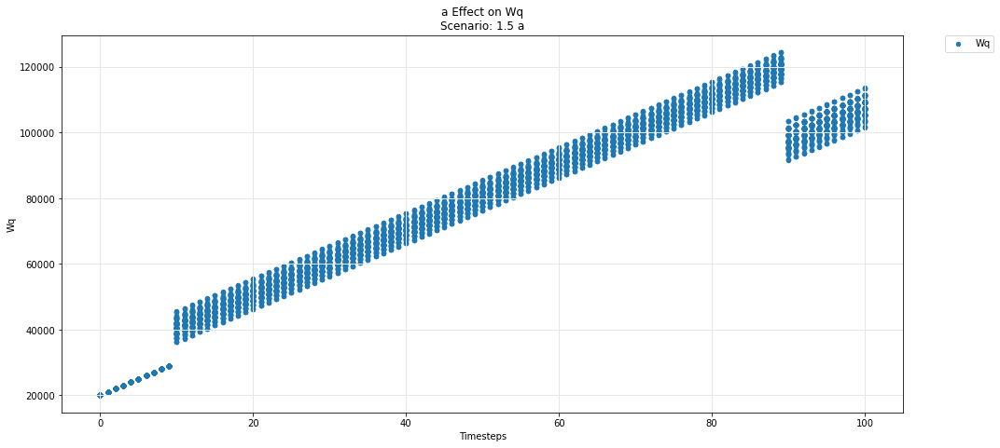

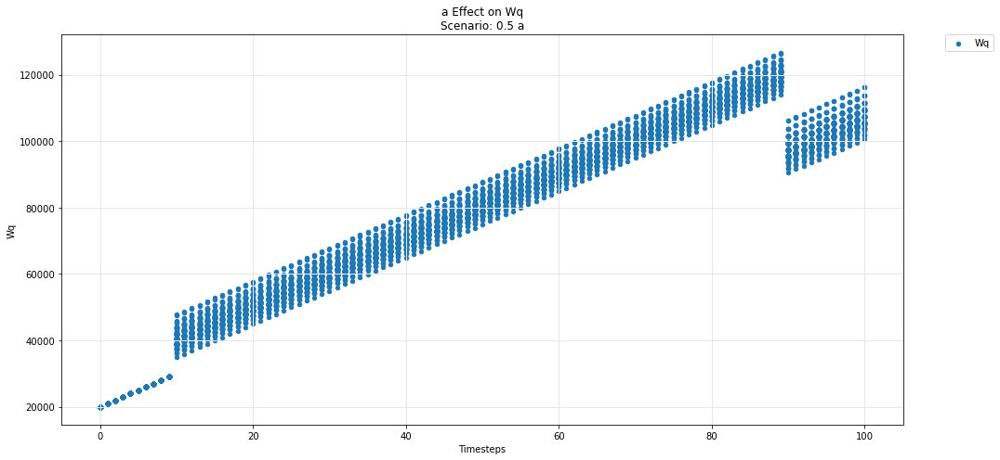

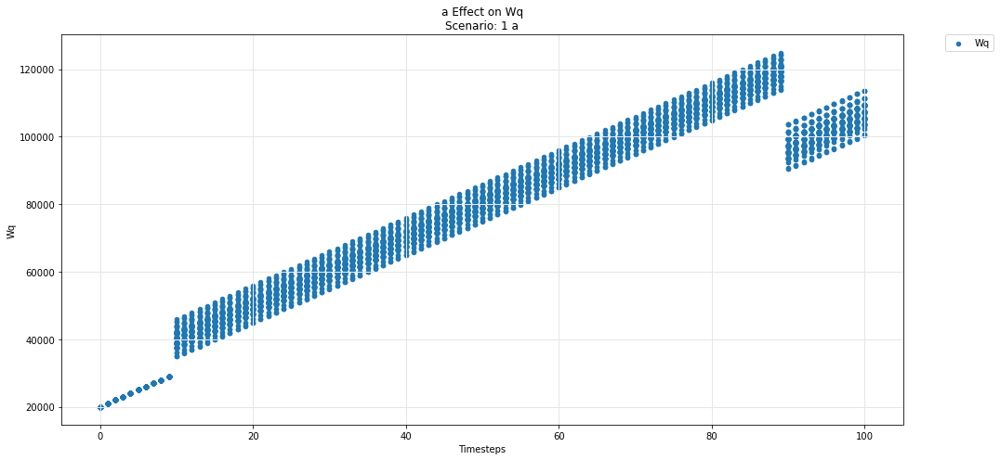

In [54]:
param_test_plot(experiments, config_ids, 'a', 'Wq')

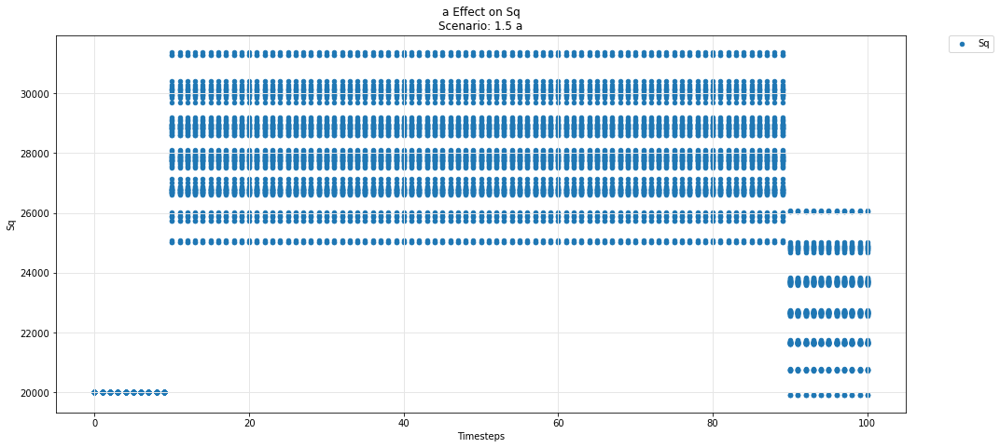

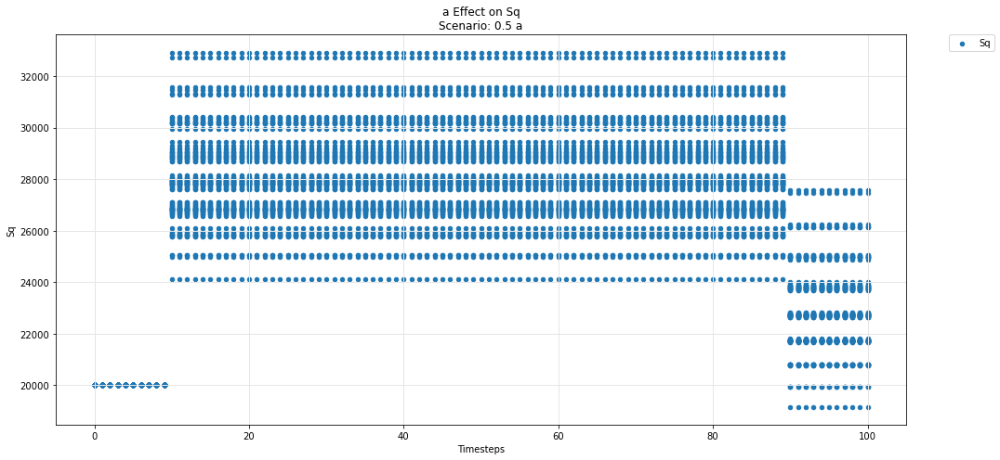

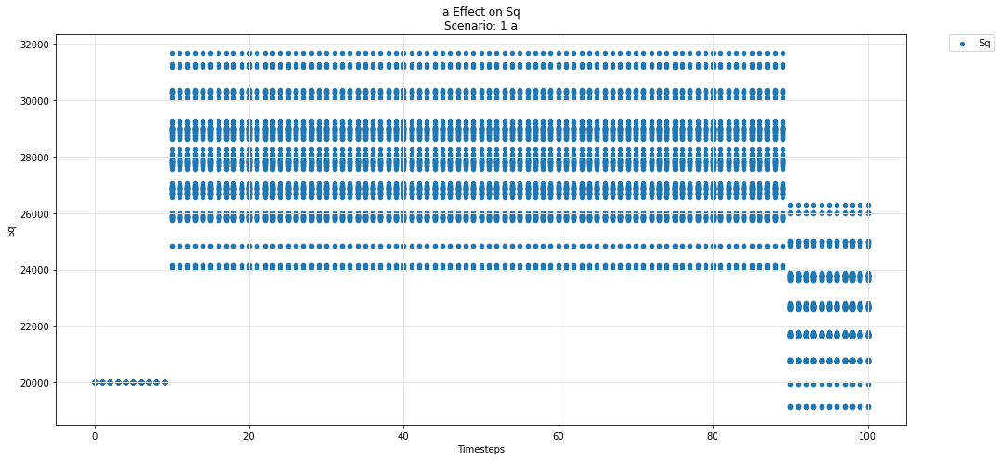

In [55]:
param_test_plot(experiments, config_ids, 'a', 'Sq')

## Hydra -- pool

Movement of the Omnipool variables
- Asset i
- Asset j
- Asset k

over the course of the simulation

In [56]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

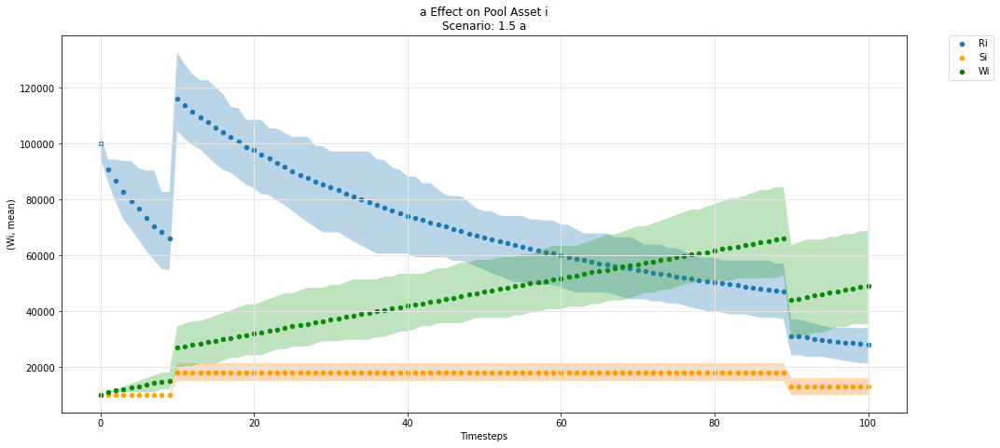

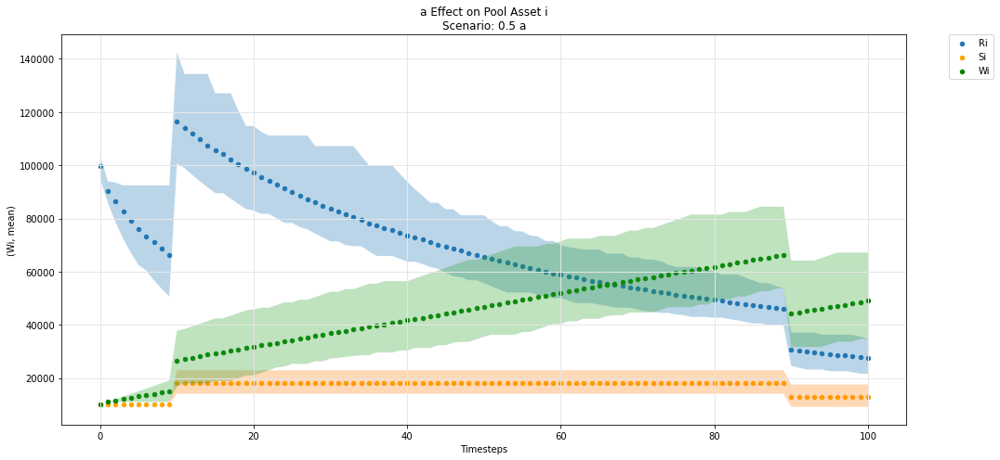

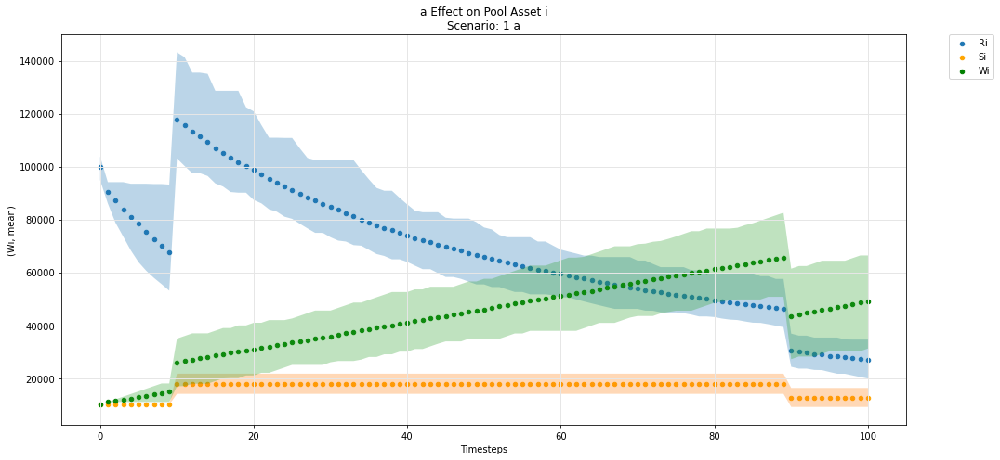

In [57]:
param_pool_simulation_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

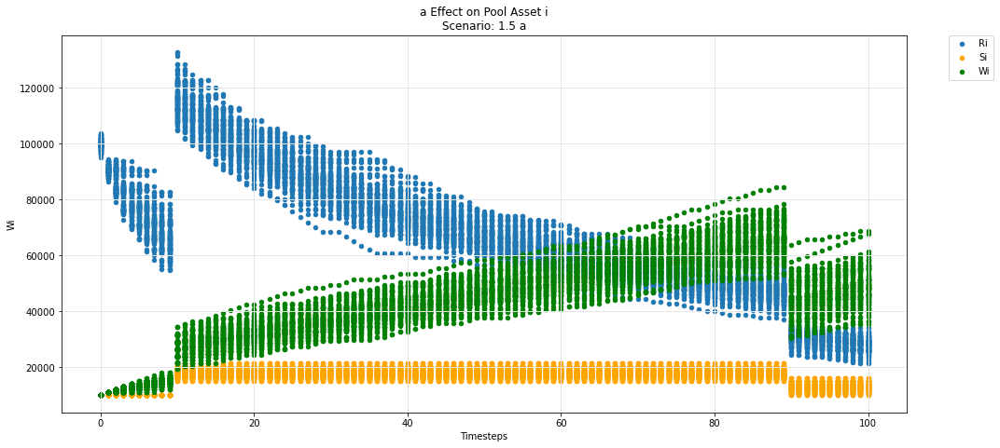

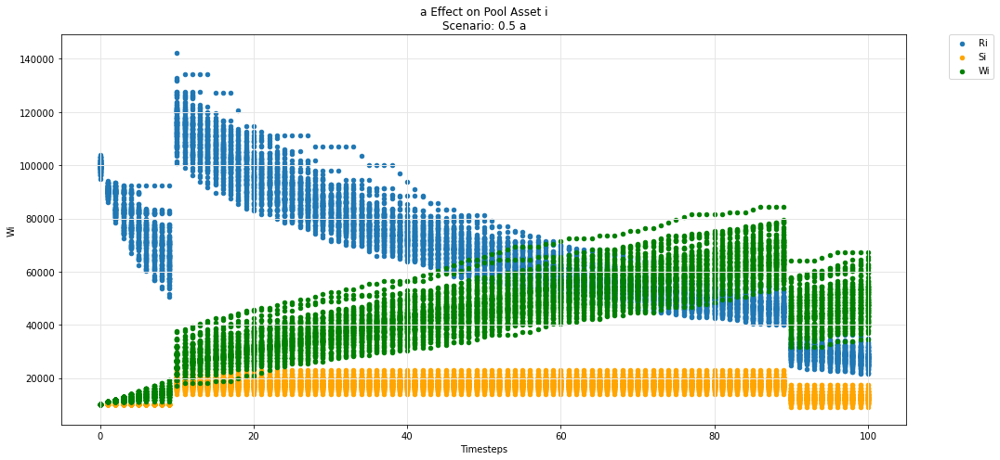

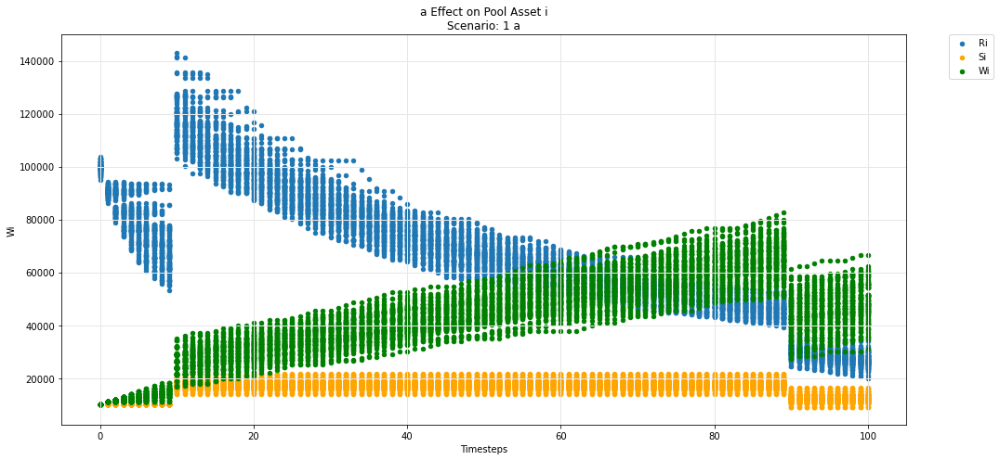

In [58]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

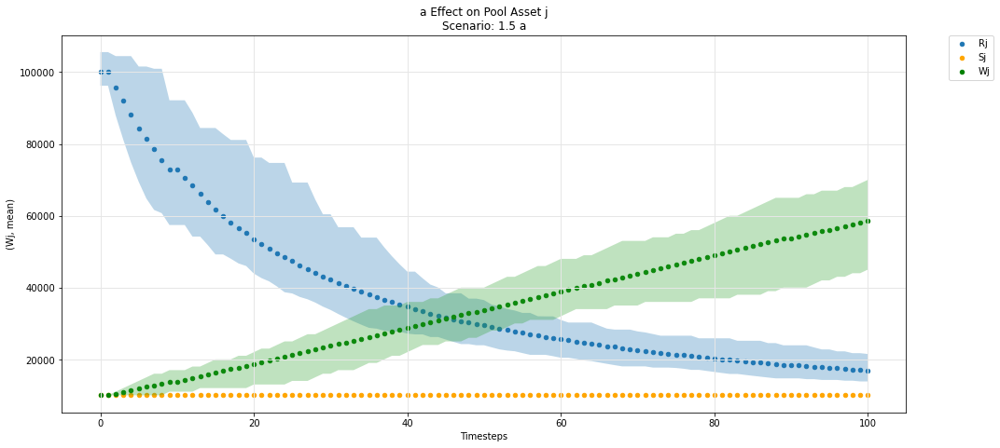

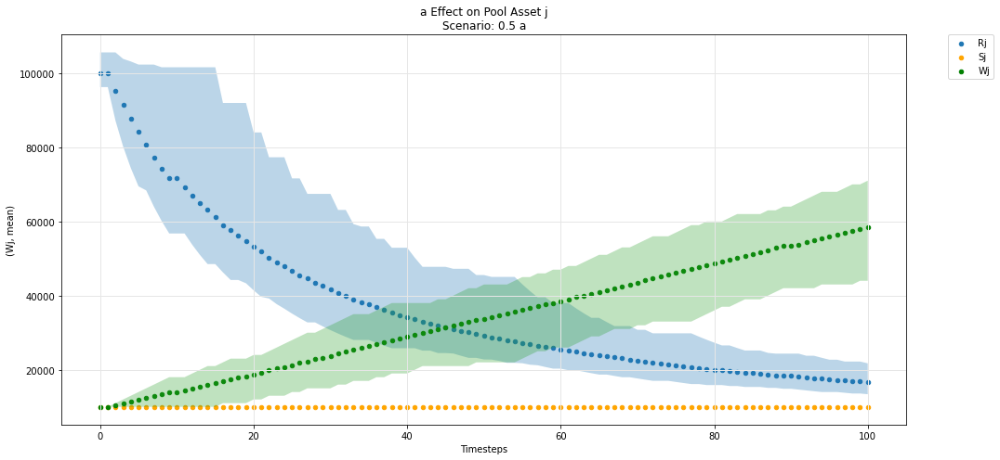

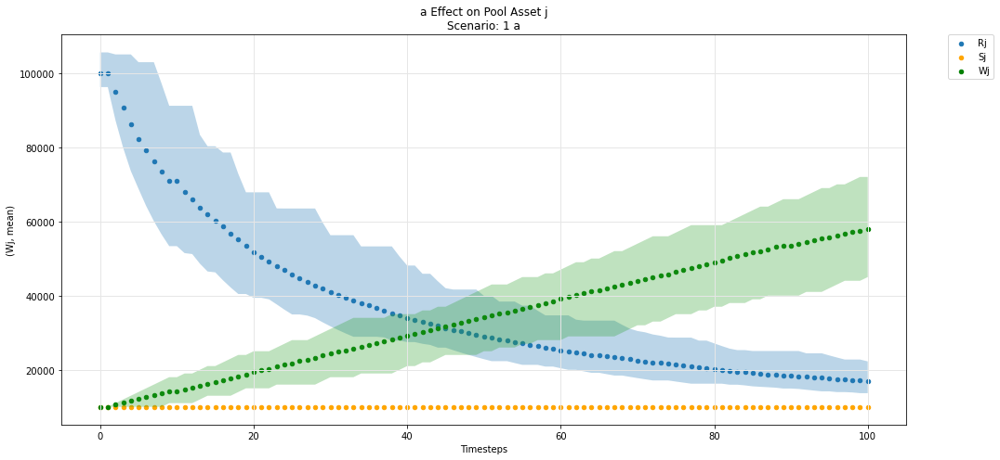

In [59]:
param_pool_simulation_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

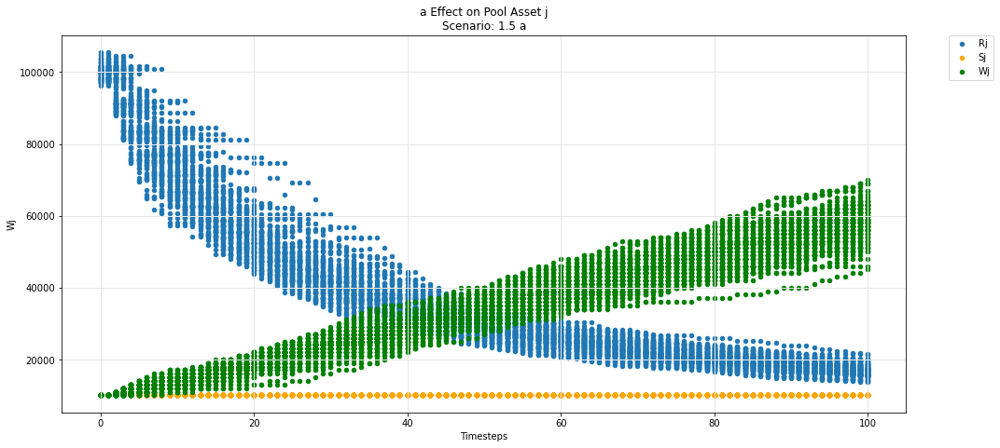

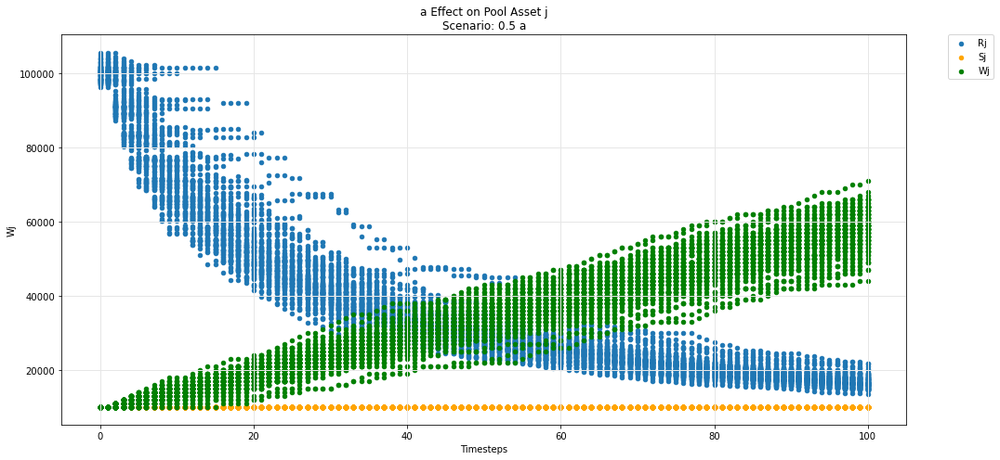

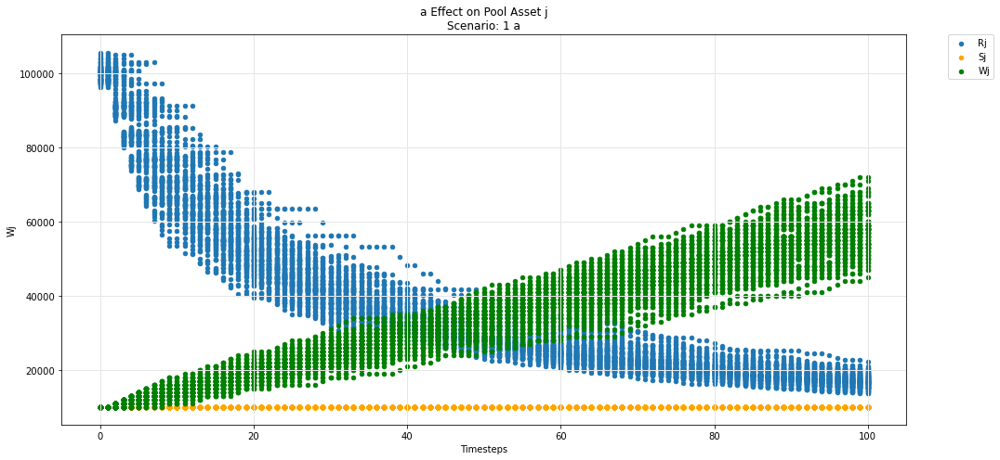

In [60]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

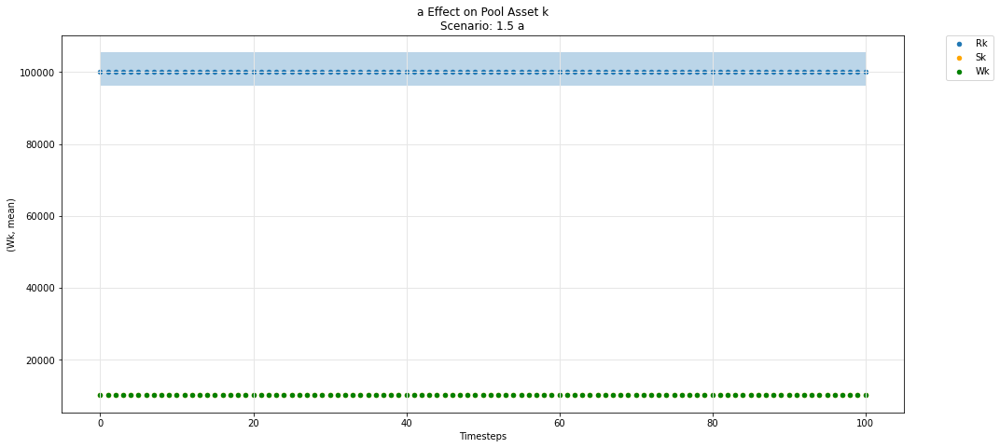

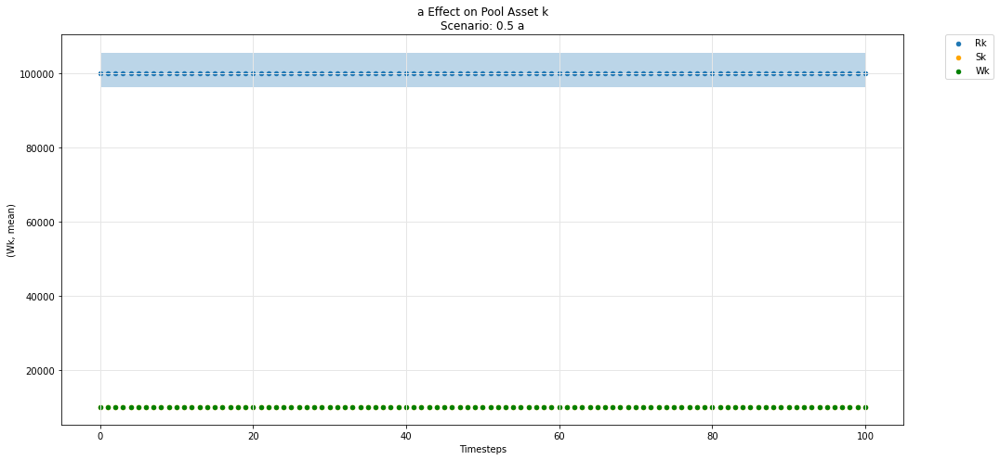

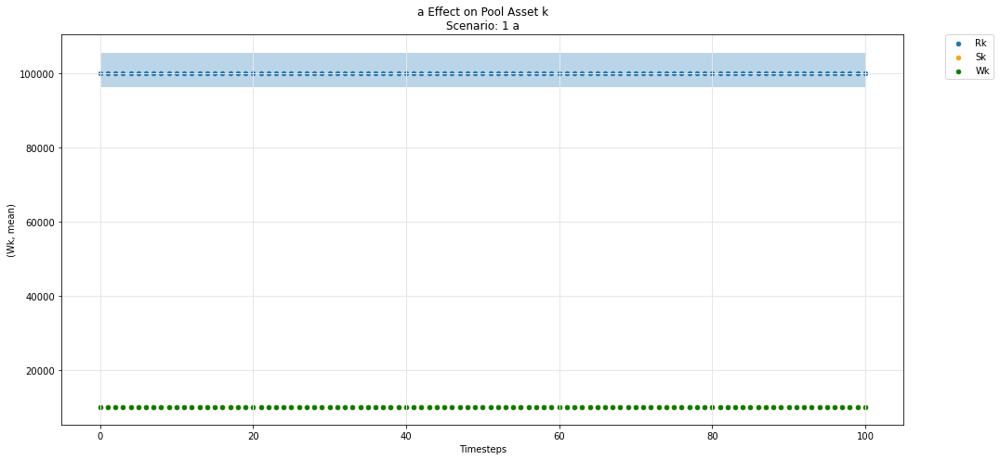

In [61]:
param_pool_simulation_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

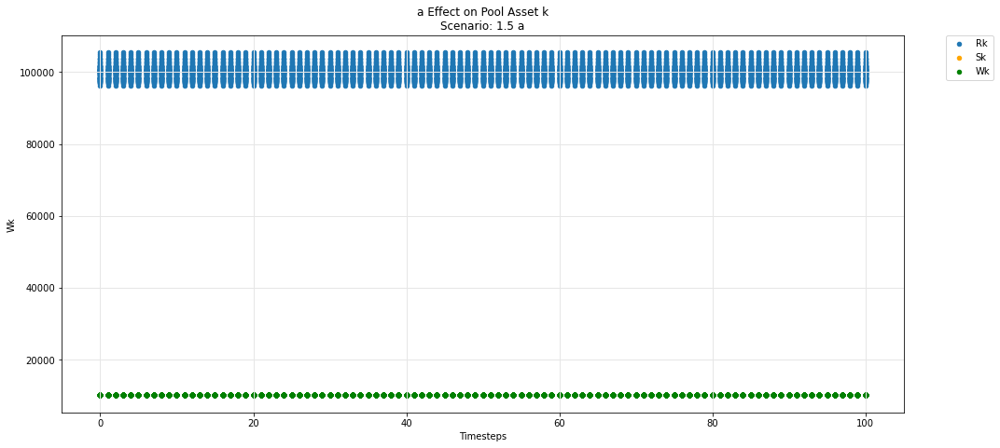

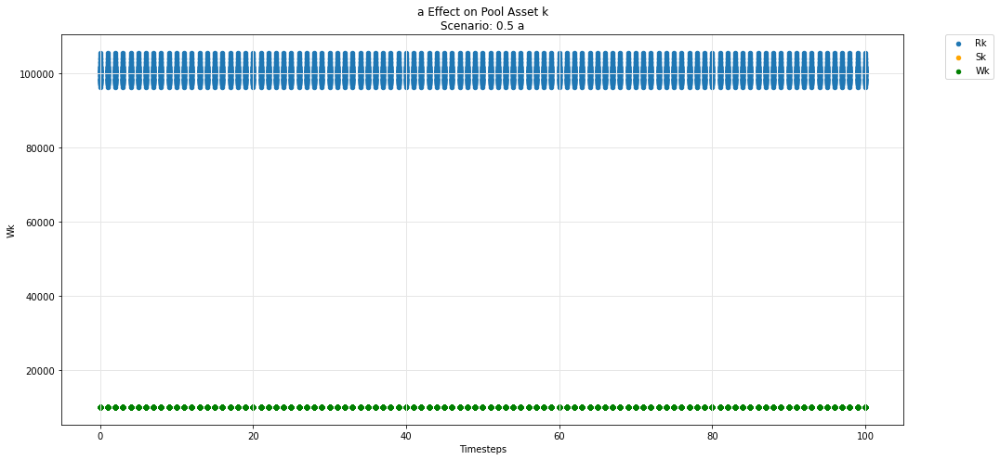

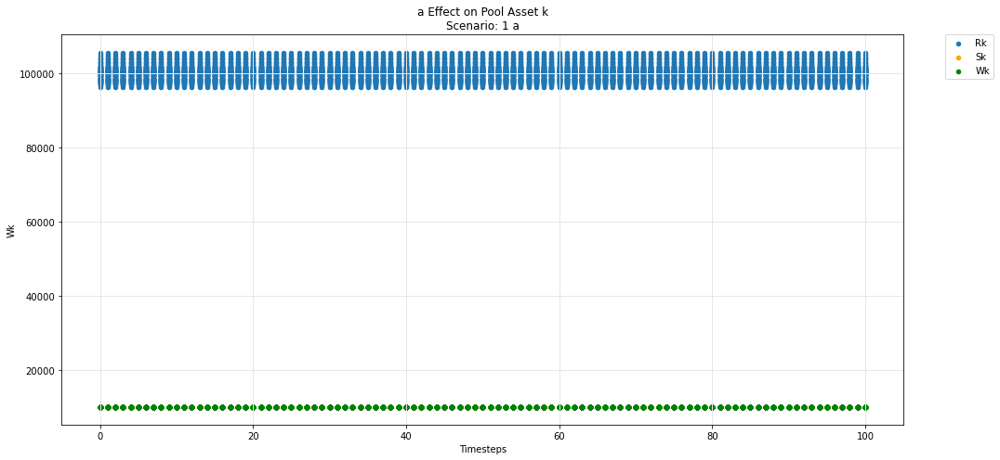

In [62]:
param_pool_plot(experiments, config_ids, 'a','k', 'R', 'S', 'W')

In [63]:
def param_pool_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=df_label, label=df_label, ax=ax, legend=True, kind ='scatter')

        for count, arg in enumerate(args):
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))

            df.plot(x='timestep', y=df_arg_label, label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

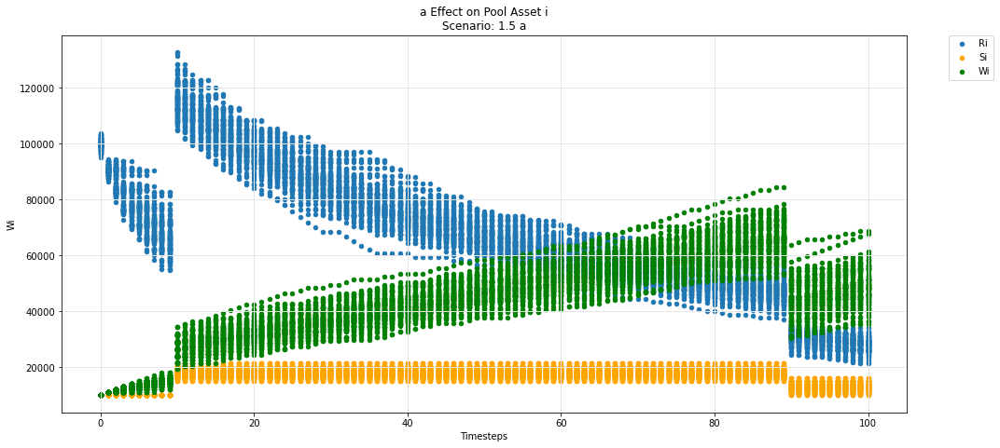

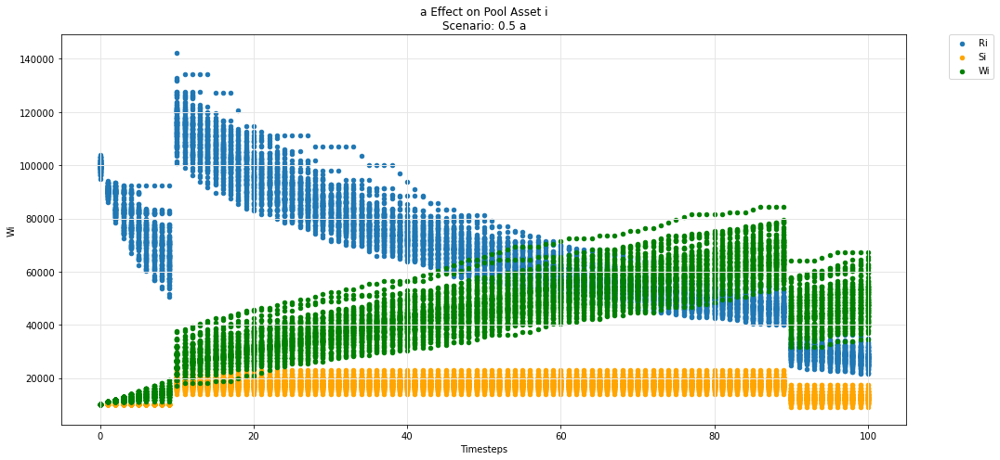

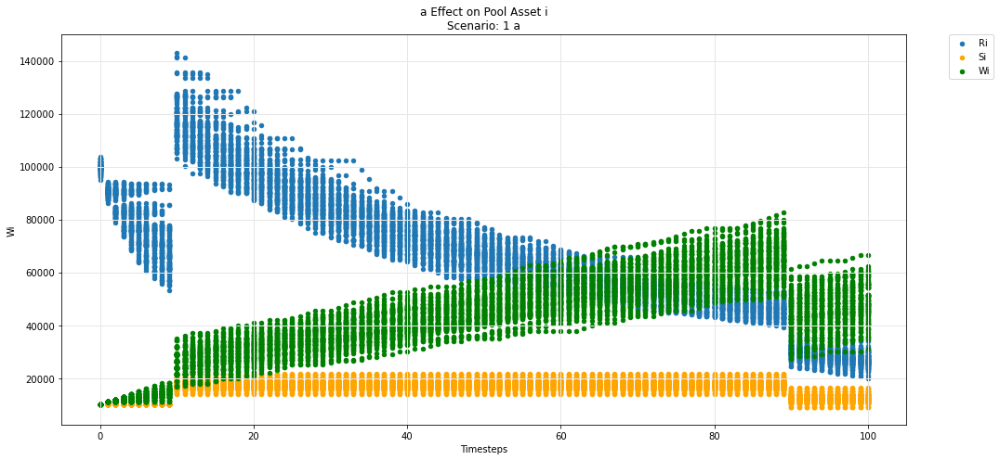

In [64]:
param_pool_plot(experiments, config_ids, 'a','i', 'R', 'S', 'W')

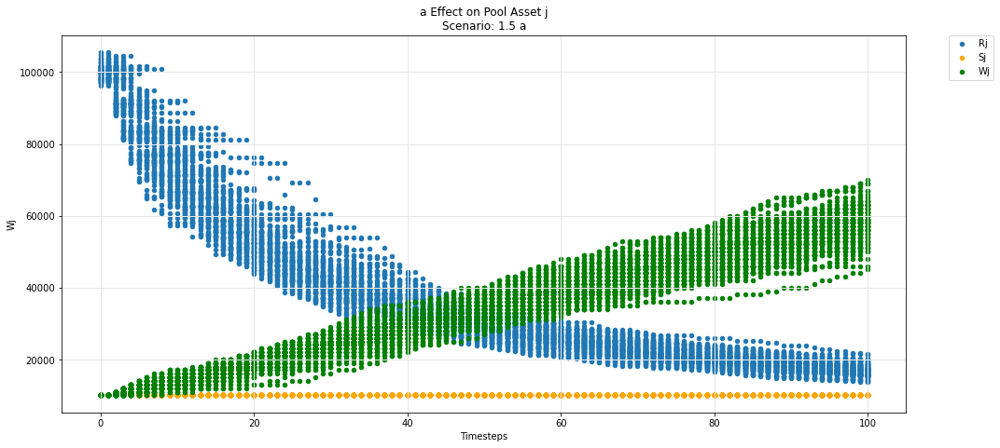

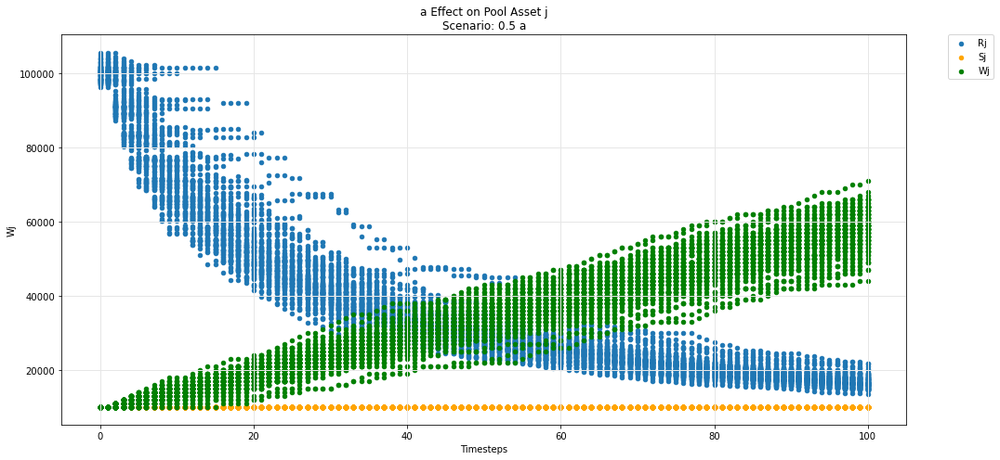

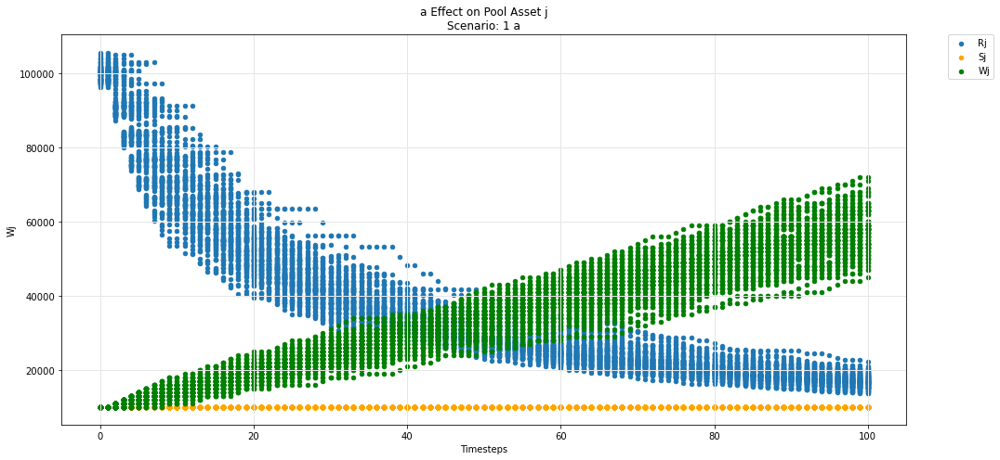

In [65]:
param_pool_plot(experiments, config_ids, 'a','j', 'R', 'S', 'W')

In [66]:
def param_pool_simulation_plot(experiments, config_ids, swept_variable, asset_id, y_variable, *args):
    """
    experiments is the simulation result dataframe.
    config_ids is the list configs executed upon in the simulation.
    swept_variable is the key (string) in config_ids that was being tested against.
    asset_id is the asset identifier in the pool (string) e.g i,j,k 
    y_variable is the state_variable (string) to be plotted against default timestep.

    *args for plotting more state_variables (string).
    """
    experiments = experiments.sort_values(by =['subset']).reset_index(drop=True)
    cols = 1
    rows = 1
    cc_idx = 0
    while cc_idx<len(experiments):
        cc = experiments.iloc[cc_idx]['subset']

        cc_label = experiments.iloc[cc_idx]['subset']

        secondary_label = [item['M'][swept_variable] for item in config_ids if  item["subset_id"]== cc_label]
        sub_experiments = experiments[experiments['subset']==cc]
        cc_idx += len(sub_experiments)
        fig, axs = plt.subplots(ncols=cols, nrows=rows, figsize=(15*cols,7*rows))

        df = sub_experiments.copy()

        df_label = y_variable + asset_id
        df[df_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][y_variable]))
        colors = ['orange', 'g', 'magenta', 'r', 'k' ]
        df = df.groupby('timestep').agg({df_label: ['min', 'mean', 'max']}).reset_index()
        ax = axs
        title = swept_variable + ' Effect on Pool Asset ' + asset_id + '\n' + 'Scenario: ' + str(secondary_label[0]) + ' ' + swept_variable
        # + 'Scenario: ' + str(cc_label)  + ' rules_price'
        ax.set_title(title)
        ax.set_ylabel('Funds')

        df.plot(x='timestep', y=(df_label,'mean'), label=df_label, ax=ax, legend=True, kind ='scatter')
        ax.fill_between(df.timestep, df[(df_label,'min')], df[(df_label,'max')], alpha=0.3)    
        for count, arg in enumerate(args):
            df = sub_experiments.copy()
            
            df_arg_label = arg + asset_id
            df[df_arg_label] = df.pool.apply(lambda x: np.array(x.pool[asset_id][arg]))
            df = df.groupby('timestep').agg({df_arg_label: ['min', 'mean', 'max']}).reset_index()

            df.plot(x='timestep', y=(df_arg_label,'mean'), label=df_arg_label, ax=ax, legend=True, color = colors[count], kind ='scatter')
            ax.fill_between(df.timestep, df[(df_arg_label,'min')], df[(df_arg_label,'max')], alpha=0.3)    

        ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

        ax.set_xlabel('Timesteps')
        ax.grid(color='0.9', linestyle='-', linewidth=1)

        plt.tight_layout()
            
    fig.tight_layout(rect=[0, 0, 1, .97])
    fig.patch.set_alpha(1)
    plt.close()
    return display(fig)

# Prices

## Uniswap

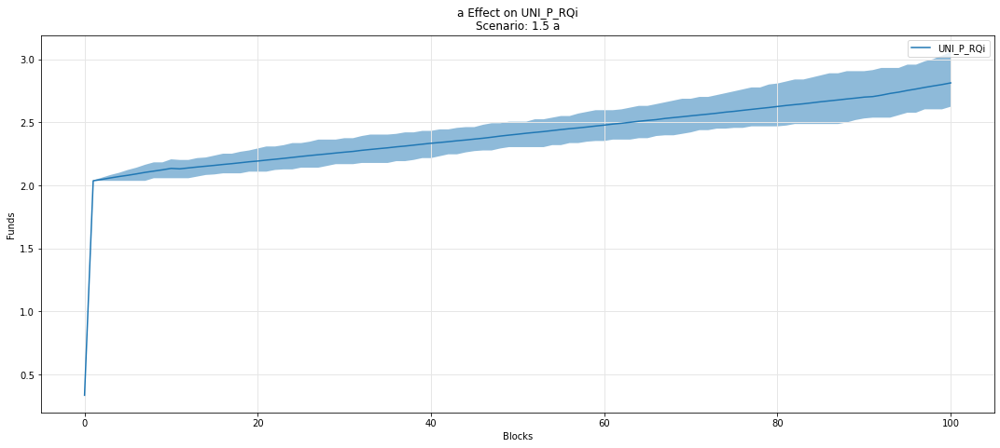

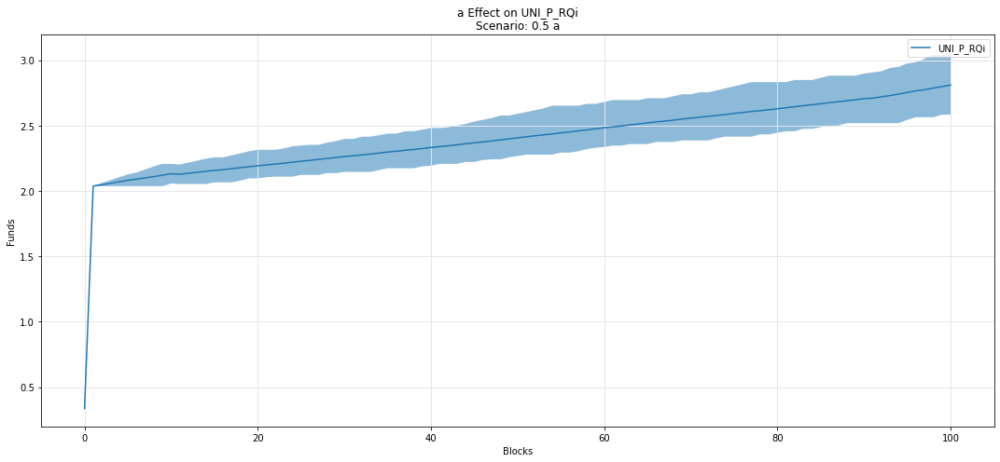

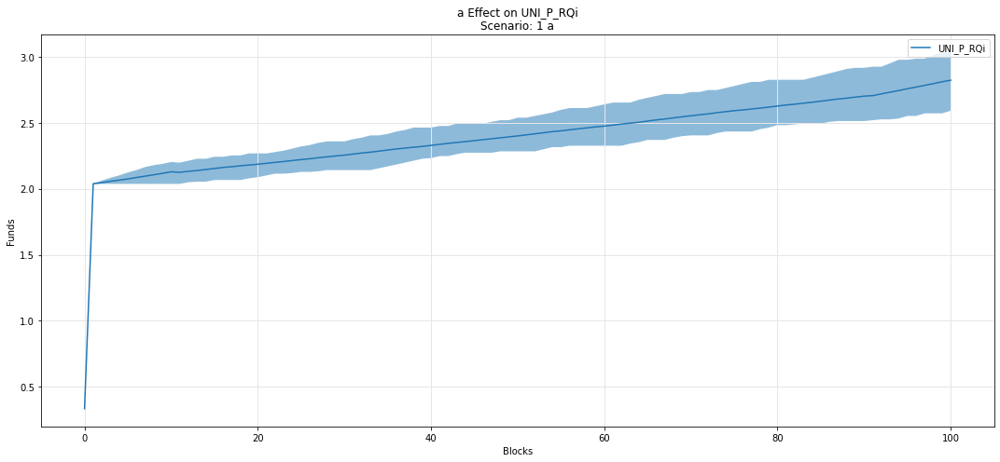

In [67]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQi')

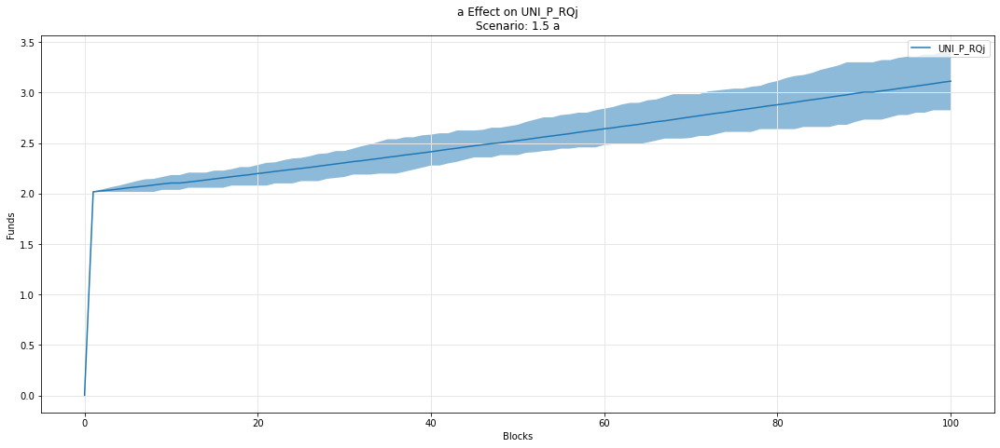

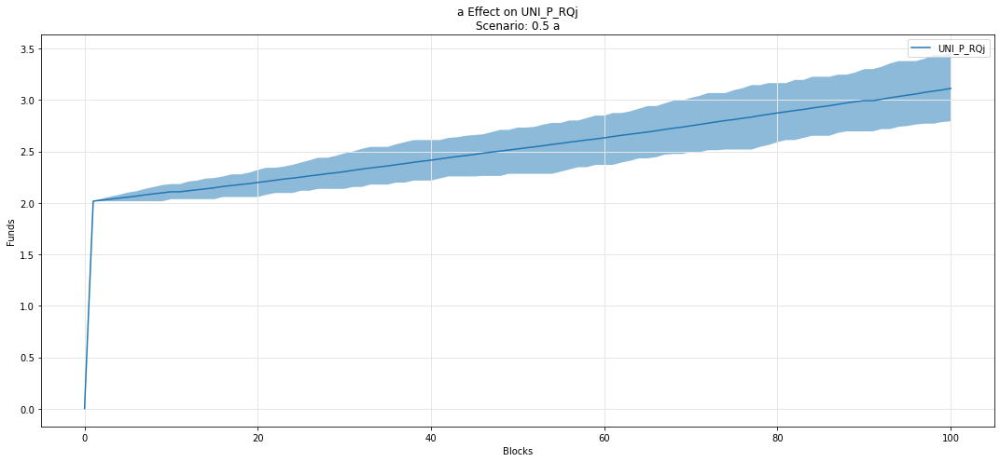

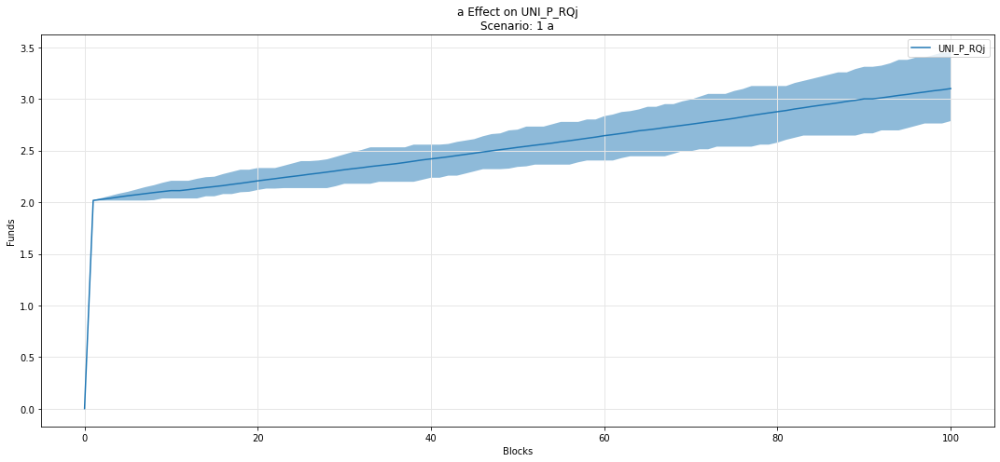

In [68]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_RQj')

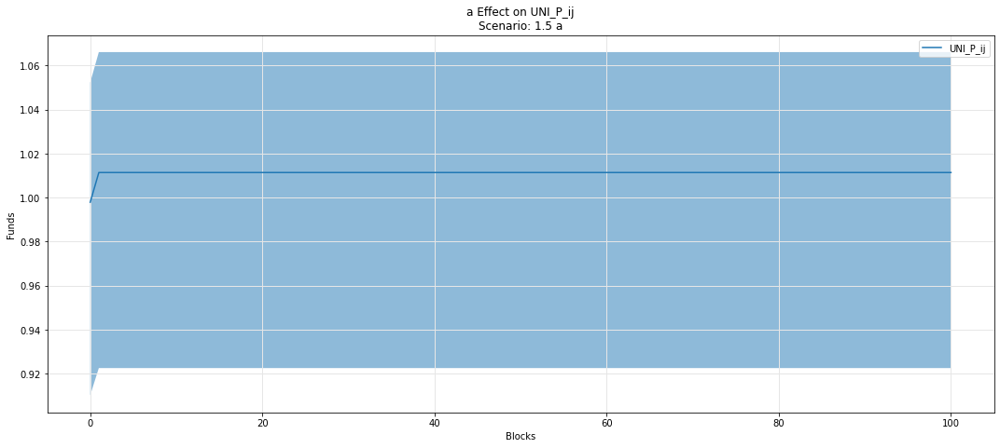

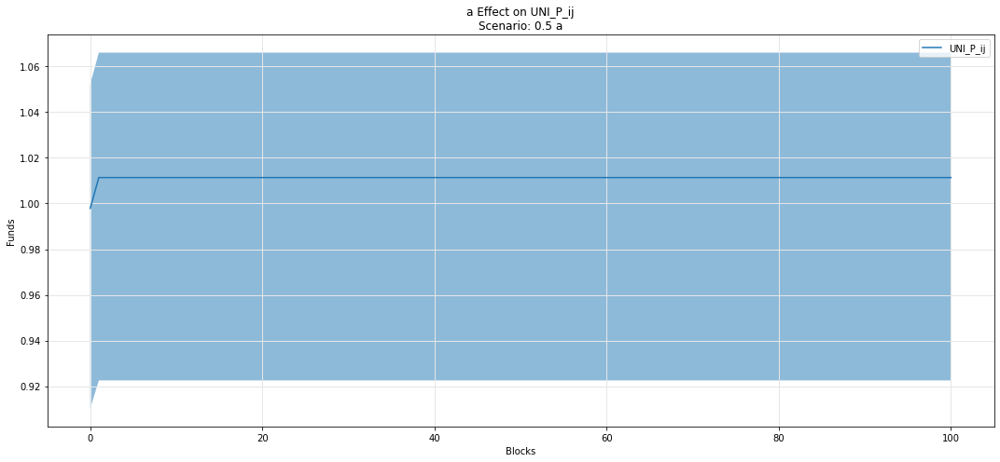

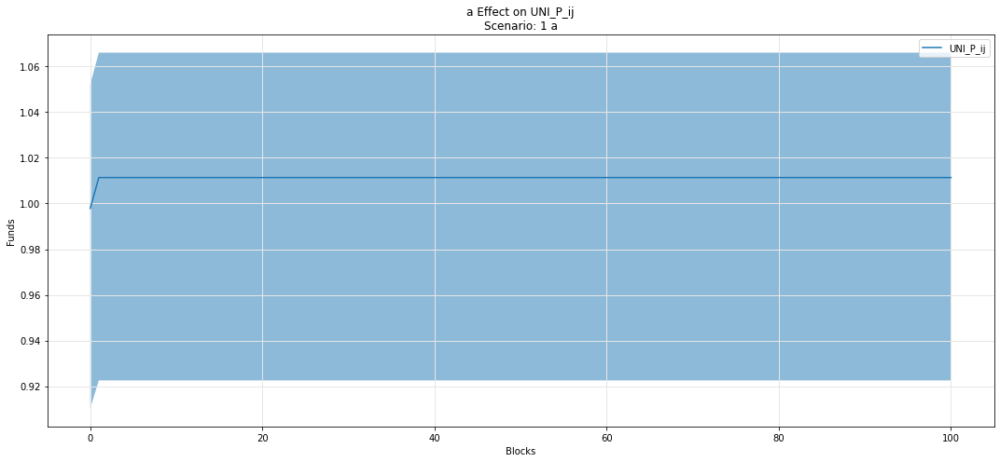

In [69]:
param_fan_plot3(experiments, config_ids, 'a', 'UNI_P_ij')

## Omnipool

## Asset i

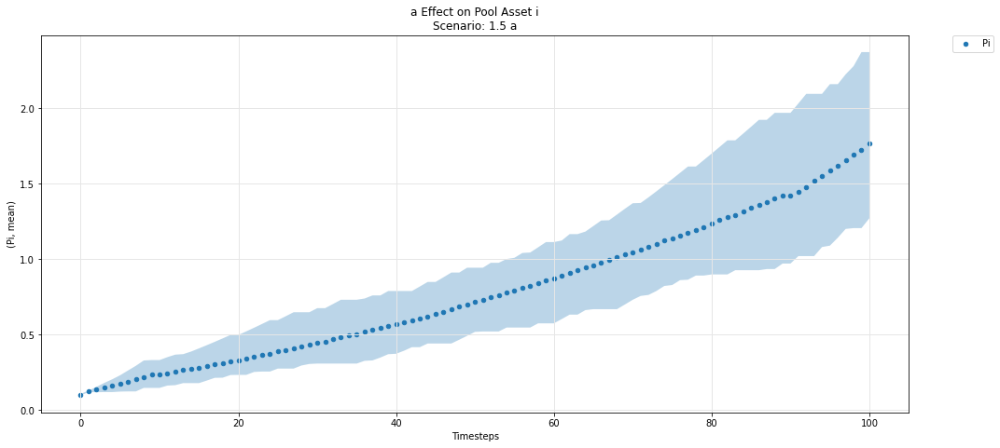

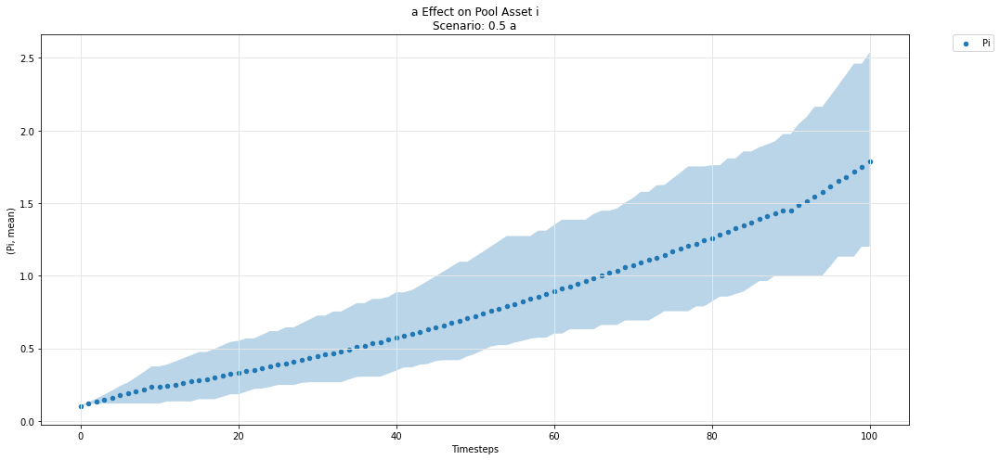

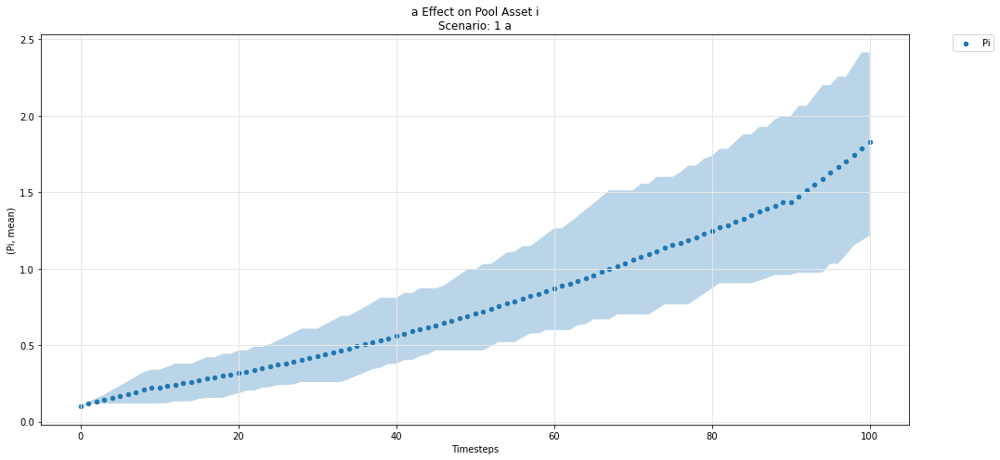

In [70]:
param_pool_simulation_plot(experiments, config_ids, 'a','i','P')

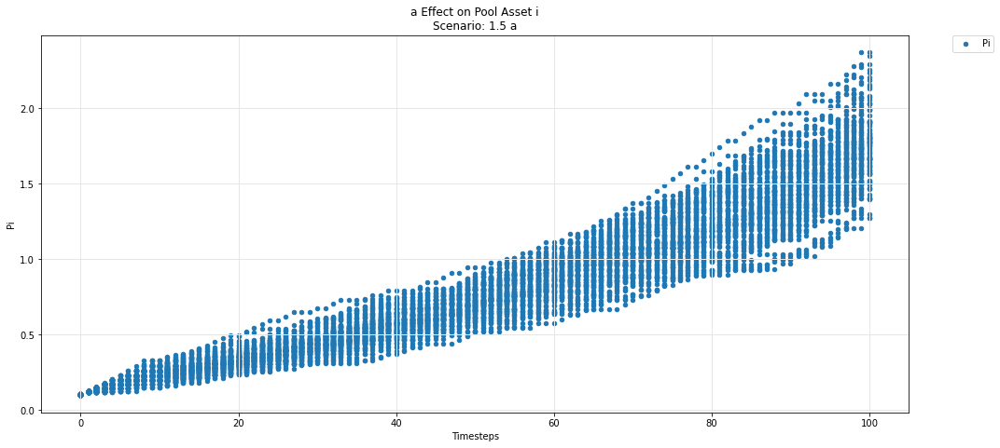

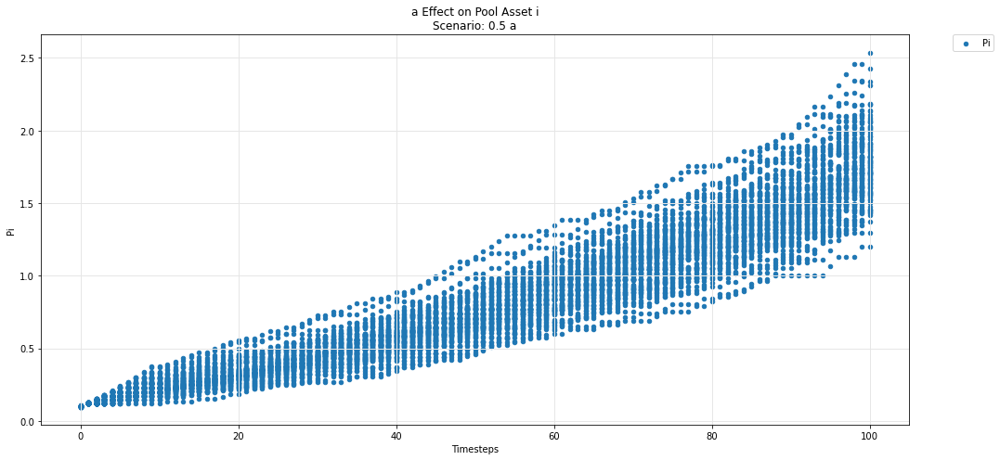

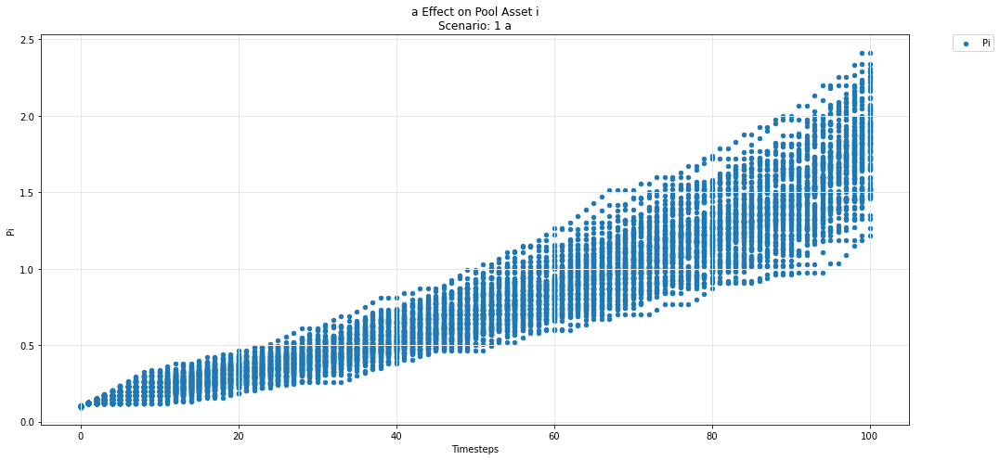

In [71]:
param_pool_plot(experiments, config_ids, 'a','i','P')

## Asset j

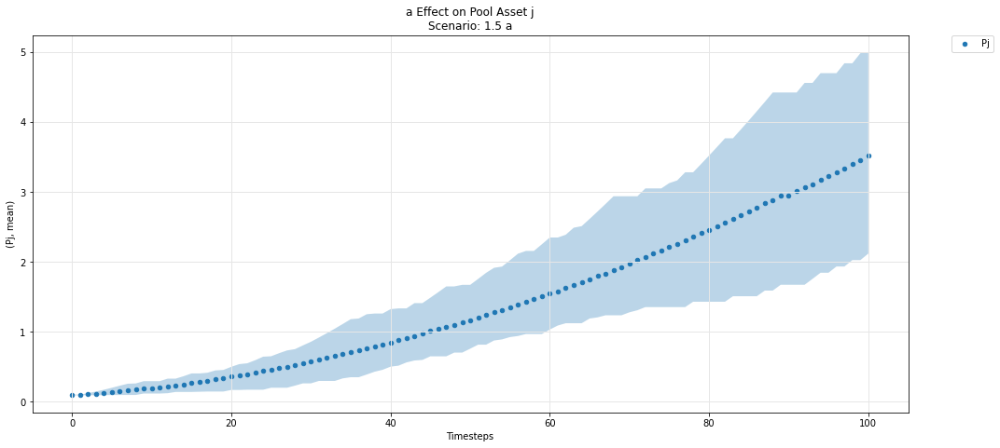

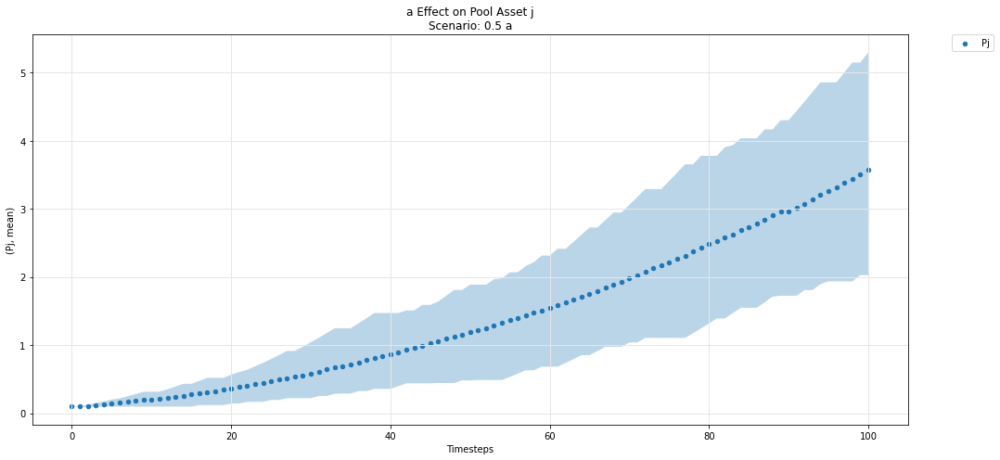

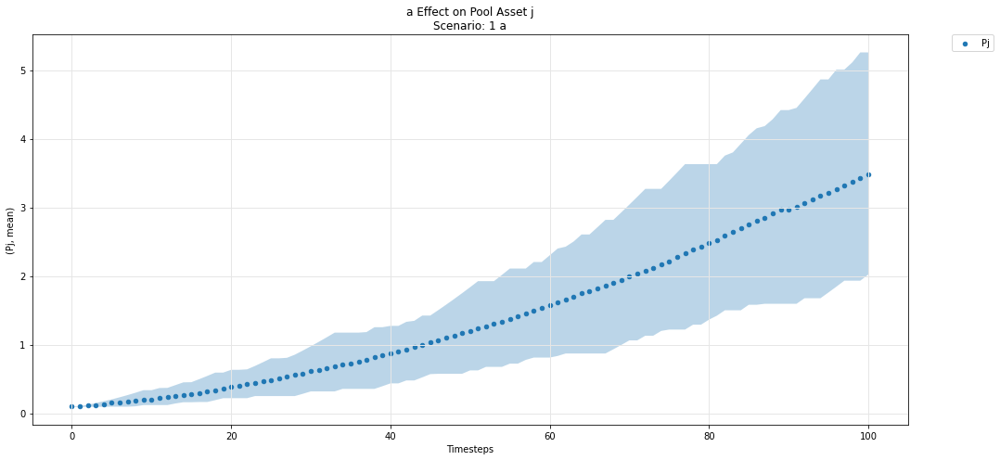

In [72]:
param_pool_simulation_plot(experiments, config_ids, 'a','j','P')

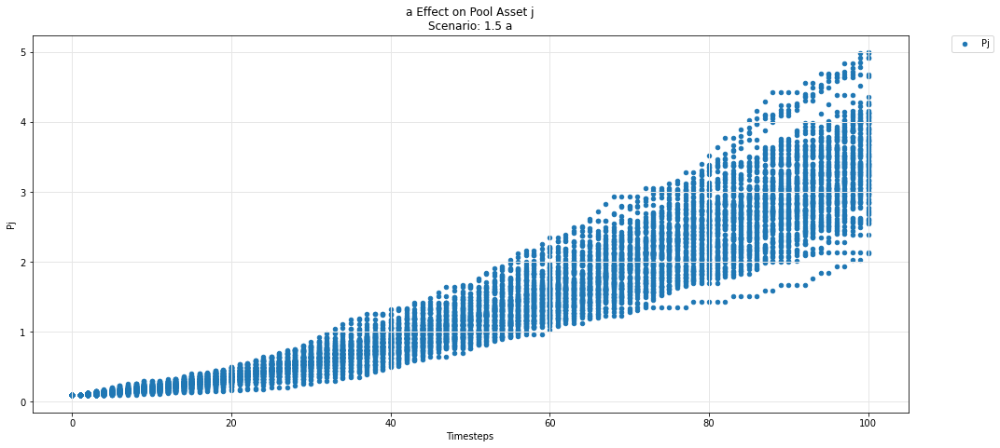

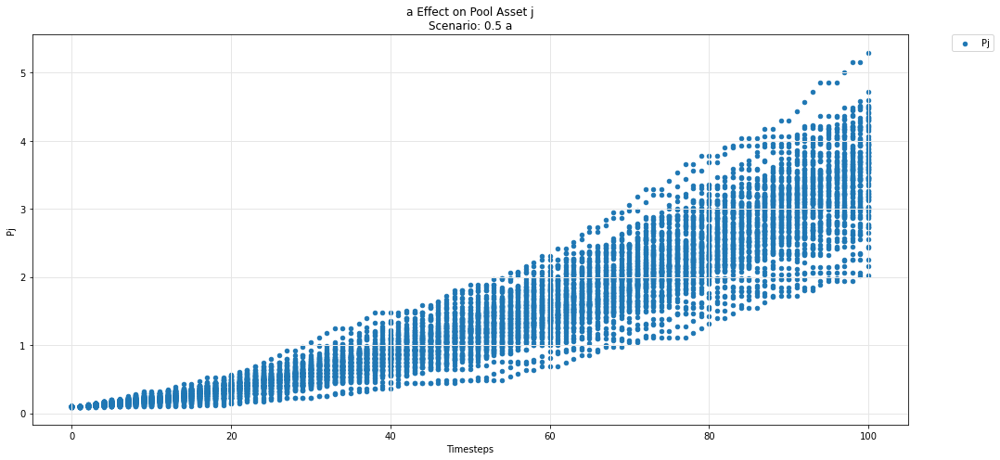

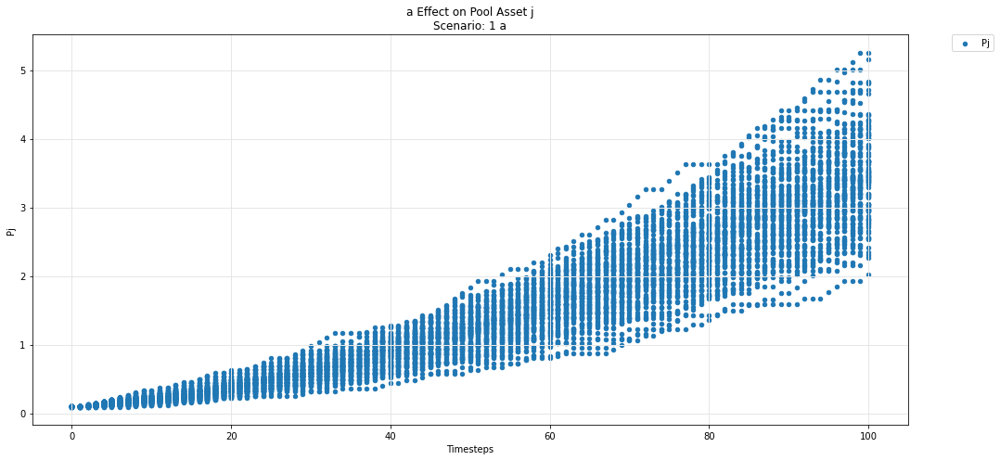

In [73]:
param_pool_plot(experiments, config_ids, 'a','j','P')

## Asset k

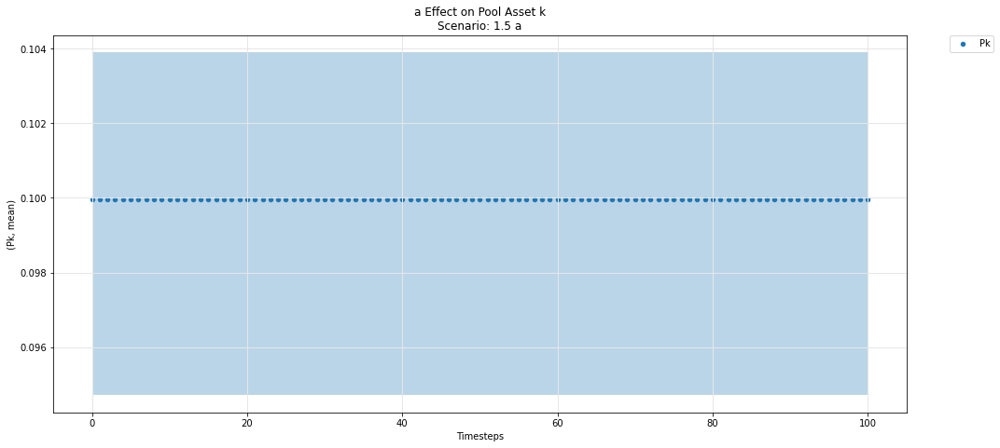

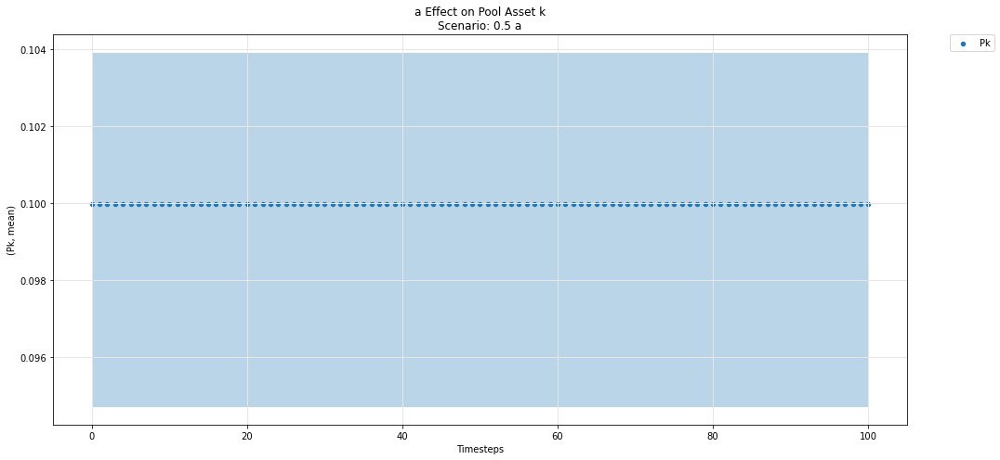

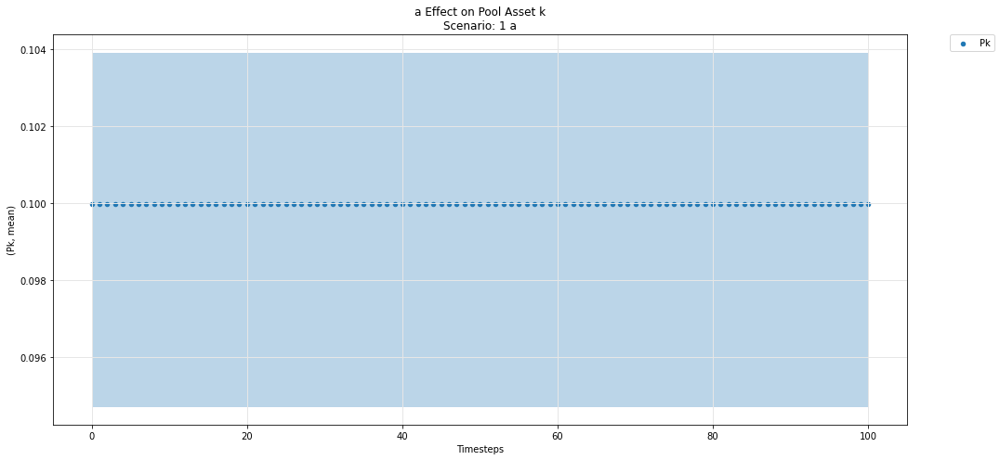

In [74]:
param_pool_simulation_plot(experiments, config_ids, 'a','k','P')

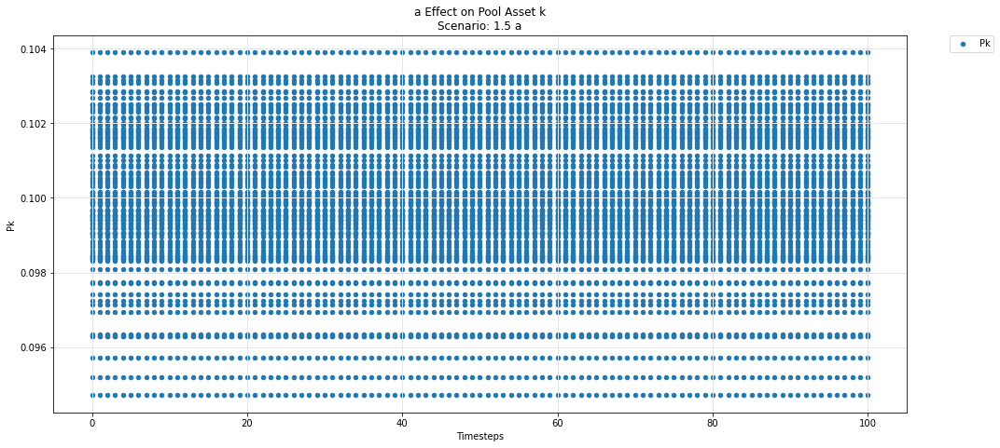

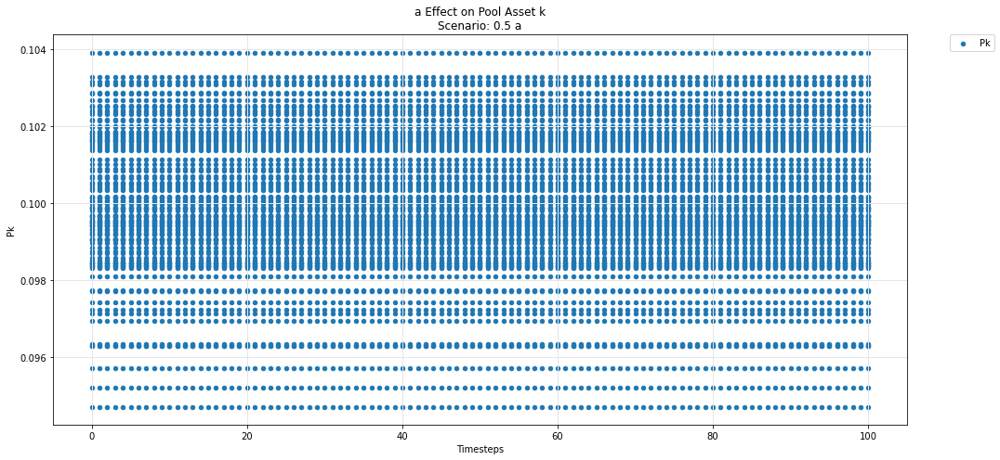

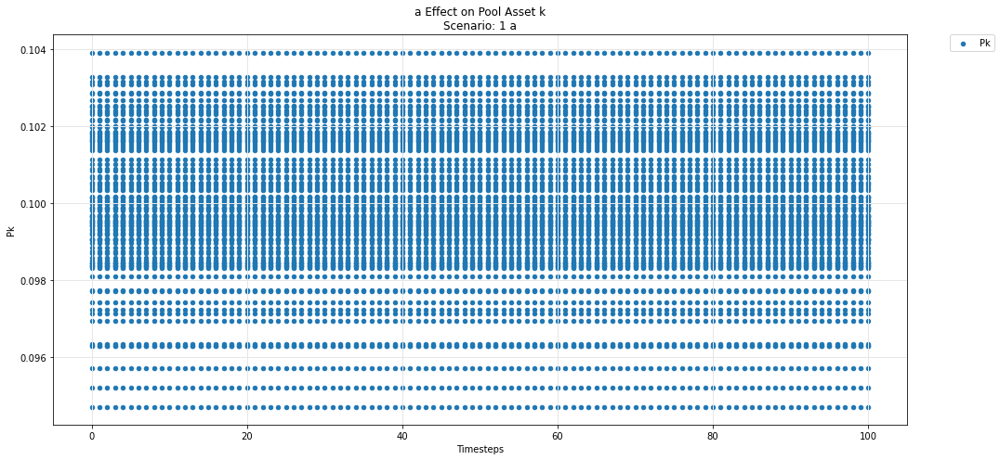

In [75]:
param_pool_plot(experiments, config_ids, 'a','k','P')